In [37]:
import matplotlib.pyplot as plt
import numpy as np
import itk
from itkwidgets import view
import SimpleITK as sitk
from skimage import img_as_ubyte
from skimage.io import imread, imsave, imshow
import math

In [39]:
input_skeleton = r"D:\Cecile\Results\Stade 4\cARIE STADE 4\skeleton_better.tif"
# input_skeleton = r"D:\Cecile\Saines\Data\P09A_VECAD_dent saine_corne.nd2"

#input_test = r"D:\Cecile\Test_orientation\test_ori.tif"
#input_test = r"D:\Cecile\Results\Stade 1\large image\skel_cap_tubeness of P24 B STD1 VECAD SMA LARGE IMAGE SMA-4.tif"
skeleton_itk = itk.imread(input_skeleton)
#test_itk = itk.imread(input_test)

In [40]:
size = itk.size(skeleton_itk)
width = size[0]
height = size[1]
print(width, height)

2064 1396


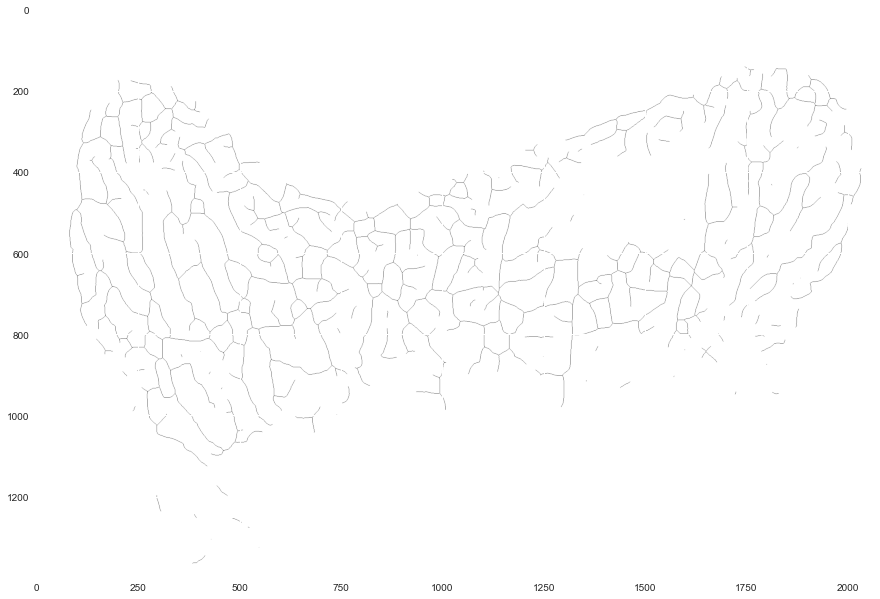

In [41]:
np_view_test = itk.array_view_from_image(skeleton_itk)
plt.figure(figsize=(15,15))
plt.imshow(np_view_test)
plt.show()

In [10]:
hess_matrix = itk.HessianRecursiveGaussianImageFilter(skeleton_itk, sigma=2)

In [11]:
hess_matrix_5 = itk.HessianRecursiveGaussianImageFilter(skeleton_itk, sigma=7)

In [42]:
hess_matrix_4 = itk.HessianRecursiveGaussianImageFilter(skeleton_itk, sigma=5)

In [91]:
print(hess_matrix)

Image (000001D2939FA2C0)
  RTTI typeinfo:   class itk::Image<class itk::SymmetricSecondRankTensor<double,2>,2>
  Reference Count: 1
  Modified Time: 2258
  Debug: Off
  Object Name: 
  Observers: 
    none
  Source: (none)
  Source output name: (none)
  Release Data: Off
  Data Released: False
  Global Release Data: Off
  PipelineMTime: 3591
  UpdateMTime: 2255
  RealTimeStamp: 0 seconds 
  LargestPossibleRegion: 
    Dimension: 2
    Index: [0, 0]
    Size: [577, 571]
  BufferedRegion: 
    Dimension: 2
    Index: [0, 0]
    Size: [577, 571]
  RequestedRegion: 
    Dimension: 2
    Index: [0, 0]
    Size: [577, 571]
  Spacing: [1, 1]
  Origin: [0, 0]
  Direction: 
1 0
0 1

  IndexToPointMatrix: 
1 0
0 1

  PointToIndexMatrix: 
1 0
0 1

  Inverse Direction: 
1 0
0 1

  PixelContainer: 
    ImportImageContainer (000001D28E9DC6E0)
      RTTI typeinfo:   class itk::ImportImageContainer<unsigned __int64,class itk::SymmetricSecondRankTensor<double,2> >
      Reference Count: 1
      Modifie

In [92]:
#image=hess_matrix.GetOutput()
t = hess_matrix.GetPixel([200,200])
#print("%f,%f,%f,%f"%(t[0],t[1],t[2],t[3]))
# print("%f,%f,%f,%f,%f,%f"%(t(0,0),t(0,1),t(0,2),t(1,1),t(1,2),t(2,2)))

# size=hess_matrix.GetOutput().GetBufferedRegion().GetSize()
# print("%d,%d,%d"%(size[0],size[1],size[2]))

v=itk.FixedArray[itk.D,2]()
e=itk.Matrix[itk.D,2,2]()
t.ComputeEigenAnalysis(v,e)
print("%f,%f"%(v[0],v[1]))
arr=itk.GetArrayFromVnlMatrix(e.GetVnlMatrix().as_matrix())
print(arr)


-0.000000,0.000001
[[ 0.67468789  0.73810315]
 [ 0.73810315 -0.67468789]]


In [14]:
array_test = itk.array_view_from_image(skeleton_itk)

#Faire le produit scalaire pour chaque point entre le vecteur propre associé à la valeur propre la plus petite et vecteur 
#unitaire qui lie le point à la caire

carie_x = 1815
carie_y = 95

angles = []
dists = []

for y in range(height):
    for x in range(width):
            test_intensity = array_test[y,x]
            if test_intensity != 0:
                print(x,y)
                diff_cariex = carie_x - x
                diff_cariey = carie_y - y
                diff_pointx = x - carie_x
                diff_pointy = y - carie_y
                print("diff:", diff_cariex,diff_cariey)
                dist = math.sqrt((diff_cariex)**2+(diff_cariey)**2)
                print("dist:", dist)
                v_carie = [diff_cariex/dist, diff_cariey/dist]
                v_point = [diff_pointx/dist, diff_pointy/dist]
                print("vector carie:", v_carie)
                t = hess_matrix.GetPixel([x,y])
                #array_t= itk.array_view_from_vnl_vector(t)
                #print(t[0], t[1], t[2])
                v=itk.FixedArray[itk.D,2]()
                e=itk.Matrix[itk.D,2,2]()
                t.ComputeEigenAnalysis(v,e)
                print("%f,%f"%(v[0],v[1]))
                arr=itk.GetArrayFromVnlMatrix(e.GetVnlMatrix().as_matrix())
                #print(arr)
                print("eigenvector 1:", arr[1])
                dot = np.dot(v_carie, arr[1])
                print(dot)
                angle = (math.acos(dot)*360)/(2*math.pi)
                if angle > 90:
                    dot = np.dot(v_point, arr[1])
                    angle = (math.acos(dot)*360)/(2*math.pi)
                    print("new dot:", dot, "new angle:", angle)
                print("angle:", angle)
                angles.append(angle)
                #print("angles:", angles)
                dists.append(dist)
                
print(len(angles), len(dists))



1745 141
diff: 70 -46
dist: 83.7615663654877
vector carie: [0.8357054797012741, -0.5491778866608372]
-5.876927,-0.913038
eigenvector 1: [0.72486184 0.68889427]
0.22744551256515216
angle: 76.85327510463583
1746 142
diff: 69 -47
dist: 83.48652585896721
vector carie: [0.8264806720615118, -0.5629650954621892]
-8.073361,-1.625935
eigenvector 1: [0.75935931 0.65067153]
0.26129042809479264
angle: 74.85335463951169
1747 143
diff: 68 -48
dist: 83.23460818673925
vector carie: [0.8169678632647616, -0.5766831975986553]
-9.419240,-1.135224
eigenvector 1: [0.80520912 0.59299096]
0.31586205358259273
angle: 71.58713698112932
1748 144
diff: 67 -49
dist: 83.00602387778854
vector carie: [0.8071703337898158, -0.5903186023238952]
-9.885371,-1.198093
eigenvector 1: [0.85184642 0.52379164]
0.37838121310031897
angle: 67.7665527384832
1749 144
diff: 66 -49
dist: 82.20097323024831
vector carie: [0.8029102017458027, -0.5960999982658233]
-10.567560,-1.038271
eigenvector 1: [0.85682852 0.51560149]
0.38060631313656

1758 162
diff: 57 -67
dist: 87.96590248499699
vector carie: [0.6479783460383599, -0.761658757624037]
-10.411822,-2.591078
eigenvector 1: [ 0.15387822 -0.98808982]
0.852297017429482
angle: 31.53760842461283
1789 162
diff: 26 -67
dist: 71.8679344353238
vector carie: [0.3617746941565186, -0.932265558018721]
-12.372140,-1.930227
eigenvector 1: [ 4.18689727e-05 -9.99999999e-01]
0.9322807043363945
angle: 21.20682721879129
1813 162
diff: 2 -67
dist: 67.02984409947557
vector carie: [0.029837455641876506, -0.999554764002863]
-9.250601,0.099524
eigenvector 1: [ 0.67383118 -0.73888534]
0.7586617702673769
angle: 40.65363587582928
1850 162
diff: -35 -67
dist: 75.59100475585703
vector carie: [-0.4630180550323759, -0.886348848204834]
-12.117703,-0.102794
eigenvector 1: [-0.14351673 -0.98964789]
0.9436241038895683
angle: 19.33063375780232
1757 163
diff: 58 -68
dist: 89.37561188601732
vector carie: [0.6489466060827497, -0.7608339519590858]
-9.045348,-2.310386
eigenvector 1: [ 0.34922095 -0.93704041]
0.

0.4322607188771998
angle: 64.38888317662904
1928 177
diff: -113 -82
dist: 139.61733416735902
vector carie: [-0.8093550895660787, -0.5873196225169774]
-11.015956,-0.212517
eigenvector 1: [0.89199523 0.45204481]
-0.9874356670093466
new dot: 0.9874356670093466 new angle: 9.092077284166233
angle: 9.092077284166233
1929 177
diff: -114 -82
dist: 140.42791745233566
vector carie: [-0.8118043909516363, -0.5839294741932822]
-10.897397,-0.500958
eigenvector 1: [0.88913514 0.45764474]
-0.9890360606836914
new dot: 0.9890360606836914 new angle: 8.492167272686286
angle: 8.492167272686286
201 178
diff: 1614 -83
dist: 1616.132729697657
vector carie: [0.9986803499128095, -0.051357167932319196]
-11.252078,-1.977458
eigenvector 1: [-0.2759969  -0.96115852]
-0.22627030525593803
new dot: 0.22627030525593803 new angle: 76.9224120766194
angle: 76.9224120766194
236 178
diff: 1579 -83
dist: 1581.1799391593609
vector carie: [0.9986213212643466, -0.052492444372983386]
-11.377946,-0.350555
eigenvector 1: [0.964755

1679 187
diff: 136 -92
dist: 164.19500601419034
vector carie: [0.828283413127963, -0.5603093677042104]
-11.099716,1.532194
eigenvector 1: [ 0.91829878 -0.39588805]
0.9824314319196757
angle: 10.75582428850145
1680 187
diff: 135 -92
dist: 163.36768346279504
vector carie: [0.8263568236905592, -0.5631468724409736]
-10.331679,2.131101
eigenvector 1: [ 0.91193726 -0.41032967]
0.9846614468506137
angle: 10.048159411758126
1684 187
diff: 131 -92
dist: 160.0781059358212
vector carie: [0.8183505122962959, -0.5747194437500703]
-9.111317,1.936838
eigenvector 1: [0.77959256 0.62628703]
0.2780406365728566
angle: 73.85670147697363
1711 187
diff: 104 -92
dist: 138.85243966167826
vector carie: [0.7489965624903806, -0.6625738822030289]
-9.642601,-0.115173
eigenvector 1: [ 0.7728637  -0.63457206]
0.9993231289065521
angle: 2.1082160425522454
1733 187
diff: 82 -92
dist: 123.23960402403117
vector carie: [0.665370524754448, -0.7465132716757221]
-11.094419,-0.254468
eigenvector 1: [-0.36265834 -0.93192217]
0.4

angle: 71.17176655220246
1665 195
diff: 150 -100
dist: 180.27756377319946
vector carie: [0.8320502943378437, -0.5547001962252291]
-9.818910,-0.442810
eigenvector 1: [ 0.57080254 -0.82108736]
0.9303937437705777
angle: 21.503724173496458
1699 195
diff: 116 -100
dist: 153.15351775261317
vector carie: [0.7574099616005768, -0.6529396220694628]
-9.680392,0.524021
eigenvector 1: [0.90584853 0.42360176]
0.4095123257149218
angle: 65.82579645173772
1701 195
diff: 114 -100
dist: 151.6443206981389
vector carie: [0.7517591128712748, -0.6594378183081359]
-6.565731,-3.019770
eigenvector 1: [ 0.66294876 -0.74866477]
0.9920756356975721
angle: 7.2178367736246605
1737 195
diff: 78 -100
dist: 126.82271089990152
vector carie: [0.615031798693877, -0.788502306017791]
-9.714251,0.454137
eigenvector 1: [-0.60733424 -0.79444643]
0.25289296923050264
angle: 75.35123052191001
1785 195
diff: 30 -100
dist: 104.4030650891055
vector carie: [0.28734788556634544, -0.9578262852211514]
-11.604149,-0.907103
eigenvector 1: 

0.9742070539776206
angle: 13.0414544399746
1950 202
diff: -135 -107
dist: 172.2614292289484
vector carie: [-0.7836925573198098, -0.621148915801627]
-11.773195,-0.286984
eigenvector 1: [-0.33697855 -0.94151232]
0.8489069436987056
angle: 31.907019151931905
201 203
diff: 1614 -108
dist: 1617.609347154003
vector carie: [0.9977687151966863, -0.06676519283843997]
-12.842743,-0.094269
eigenvector 1: [-5.25267769e-04 -9.99999862e-01]
0.06624108788059369
angle: 86.20188415920812
281 203
diff: 1534 -108
dist: 1537.7971257613924
vector carie: [0.9975308018868143, -0.07023033025017988]
-12.920133,1.614727
eigenvector 1: [-0.0916523  -0.99579107]
-0.02149125654862498
new dot: 0.02149125654862498 new angle: 88.76854689487179
angle: 88.76854689487179
336 203
diff: 1479 -108
dist: 1482.9379622897243
vector carie: [0.9973444861552779, -0.07282840061174443]
-11.337725,0.214362
eigenvector 1: [-0.40283037 -0.91527466]
-0.3351026567312224
new dot: 0.3351026567312224 new angle: 70.4212194338216
angle: 70.4

0.8263575305140429
angle: 34.27363362006017
204 212
diff: 1611 -117
dist: 1615.2430157719302
vector carie: [0.9973731409264739, -0.07243492084940871]
-10.545369,0.453754
eigenvector 1: [-0.53953155 -0.84196538]
-0.47712658385488754
new dot: 0.47712658385488754 new angle: 61.502097767373975
angle: 61.502097767373975
268 212
diff: 1547 -117
dist: 1551.4180610009669
vector carie: [0.9971522434139278, -0.07541487555231387]
-10.942638,-0.304249
eigenvector 1: [ 0.90183473 -0.43208115]
0.9318518687192512
angle: 21.27464761477382
269 212
diff: 1546 -117
dist: 1550.4209105917012
vector carie: [0.9971485739378902, -0.07546337849335909]
-11.292220,-0.020599
eigenvector 1: [ 0.91290197 -0.40817888]
0.9411014528862093
angle: 19.762638608803304
291 212
diff: 1524 -117
dist: 1528.4845435921163
vector carie: [0.9970660196657422, -0.07654640702158257]
-9.642129,-0.119438
eigenvector 1: [-0.63470341 -0.77275583]
-0.5736895219282846
new dot: 0.5736895219282846 new angle: 54.99208982073865
angle: 54.9920

1588 218
diff: 227 -123
dist: 258.18210627384695
vector carie: [0.8792243710306828, -0.47640791910473124]
-12.129498,-0.156188
eigenvector 1: [0.98729232 0.1589147 ]
0.7923432455790848
angle: 37.5949661874193
1589 218
diff: 226 -123
dist: 257.30332294783915
vector carie: [0.878340774657679, -0.47803502337563947]
-11.533026,0.258483
eigenvector 1: [0.9809006  0.19450968]
0.7685825525163335
angle: 39.773226617603406
1606 218
diff: 209 -123
dist: 242.5077318355025
vector carie: [0.8618281916956304, -0.5072003233424045]
-11.519776,0.272781
eigenvector 1: [ 0.98172588 -0.19030054]
0.9425995359424467
angle: 19.507200051470623
1607 218
diff: 208 -123
dist: 241.6464359348178
vector carie: [0.8607617124388557, -0.5090081280287464]
-12.120745,-0.107702
eigenvector 1: [ 0.98950899 -0.1444713 ]
0.9252685196526723
angle: 22.291119656198255
1608 218
diff: 207 -123
dist: 240.7862122298534
vector carie: [0.8596837754248103, -0.5108265911944525]
-12.490892,-0.285296
eigenvector 1: [ 0.99608053 -0.08845

eigenvector 1: [ 0.50107713 -0.86540263]
0.6907036240294958
angle: 46.31416735640871
1873 222
diff: -58 -127
dist: 139.61733416735902
vector carie: [-0.41542119641444747, -0.9096291714592212]
-9.907317,-0.420929
eigenvector 1: [0.8742826  0.48541727]
-0.8047452362129861
new dot: 0.8047452362129861 new angle: 36.41434144091274
angle: 36.41434144091274
1874 222
diff: -59 -127
dist: 140.03570973148243
vector carie: [-0.4213211052604519, -0.9069115316623287]
-10.941847,-0.324976
eigenvector 1: [0.90193208 0.43187791]
-0.771678073958014
new dot: 0.771678073958014 new angle: 39.495181504145606
angle: 39.495181504145606
1920 222
diff: -105 -127
dist: 164.78470802838473
vector carie: [-0.6371950483531117, -0.7707025822937636]
-11.524543,0.274602
eigenvector 1: [ 0.19056846 -0.98167391]
0.635149335669581
angle: 50.56893870558141
1954 222
diff: -139 -127
dist: 188.2817038376273
vector carie: [-0.7382554819021212, -0.6745211956947438]
-9.775555,4.258953
eigenvector 1: [ 0.63966201 -0.7686563 ]
0.

0.997772223903375
angle: 3.8251992238916634
224 228
diff: 1591 -133
dist: 1596.5494041839106
vector carie: [0.9965241262378929, -0.08330465668739143]
-11.473547,0.054680
eigenvector 1: [ 0.97948505 -0.20151684]
0.9928677750116033
angle: 6.847130569281088
258 228
diff: 1557 -133
dist: 1562.6701507355926
vector carie: [0.9963714986602108, -0.08511073174168789]
-12.692849,0.057400
eigenvector 1: [-0.04629058 -0.99892802]
0.03889687683323974
angle: 87.77081076509518
305 228
diff: 1510 -133
dist: 1515.8459684281909
vector carie: [0.9961434284551665, -0.08773978542022327]
-9.748138,-0.847568
eigenvector 1: [-0.59300374 -0.80519971]
-0.5200687252774024
new dot: 0.5200687252774024 new angle: 58.663138434119546
angle: 58.663138434119546
344 228
diff: 1471 -133
dist: 1477.0003385239963
vector carie: [0.9959374833116202, -0.09004737272633956]
-9.625918,3.834449
eigenvector 1: [ 0.69088022 -0.72296924]
0.75317499023739
angle: 41.13384105110946
353 228
diff: 1462 -133
dist: 1468.0371248711663
vecto

0.6389188343962723
angle: 50.28875313222975
391 234
diff: 1424 -139
dist: 1430.7679755991187
vector carie: [0.9952696903239782, -0.09715062286168046]
-12.720312,-0.228296
eigenvector 1: [ 0.03807498 -0.99927489]
0.13497504869626314
angle: 82.24282292142051
1529 234
diff: 286 -139
dist: 317.98899352021607
vector carie: [0.8994021989060373, -0.43712204772006713]
-10.204282,-0.564429
eigenvector 1: [ 0.90470482 -0.42603895]
0.9999245236069152
angle: 0.7039566739655201
1530 234
diff: 285 -139
dist: 317.08989261721985
vector carie: [0.8987987527689579, -0.4383614969645093]
-11.332743,-0.754908
eigenvector 1: [ 0.91573536 -0.40178196]
0.9991875443057953
angle: 2.3097601369415957
1531 234
diff: 284 -139
dist: 316.1913977324494
vector carie: [0.8981901532954142, -0.43960715249317805]
-10.959903,-0.689411
eigenvector 1: [ 0.92001988 -0.39187169]
0.9986223944701036
angle: 3.0078068132707325
1637 234
diff: 178 -139
dist: 225.84286572747877
vector carie: [0.788158613851411, -0.6154721759850906]
-1

1521 239
diff: 294 -144
dist: 327.37134877688976
vector carie: [0.898062707987213, -0.4398674488100635]
-10.898628,-0.490974
eigenvector 1: [ 0.88637119 -0.46297527]
0.9996646684551086
angle: 1.4838396504918523
1522 239
diff: 293 -144
dist: 326.47358239220523
vector carie: [0.8974692465254597, -0.4410770358350382]
-10.898444,-0.496245
eigenvector 1: [ 0.88637282 -0.46297217]
0.9996987361582945
angle: 1.4064426859515995
1643 239
diff: 172 -144
dist: 224.32119828495925
vector carie: [0.7667576729931038, -0.6419366564593427]
-8.833723,1.476488
eigenvector 1: [-0.10918704 -0.99402122]
0.5543786626787848
angle: 56.33207073097606
1658 239
diff: 157 -144
dist: 213.03755537463343
vector carie: [0.7369592639378086, -0.6759371592805379]
-11.565767,0.215749
eigenvector 1: [0.97840038 0.20671889]
0.581312242573685
angle: 54.45710818538023
1659 239
diff: 156 -144
dist: 212.30167215544958
vector carie: [0.7348034446274879, -0.6782801027330658]
-12.136125,-0.186229
eigenvector 1: [0.9824021  0.186778

0.9935044143092177
angle: 6.534045464207768
327 245
diff: 1488 -150
dist: 1495.54137355006
vector carie: [0.9949574290063548, -0.1002981279240277]
-12.714084,0.324477
eigenvector 1: [0.99930117 0.03737879]
0.9905130996467547
angle: 7.898483965139361
328 245
diff: 1487 -150
dist: 1494.5464194865276
vector carie: [0.9949506958177182, -0.10036489870387204]
-12.444007,0.724962
eigenvector 1: [0.99714165 0.07555485]
0.9845237212820785
angle: 10.093286540257445
329 245
diff: 1486 -150
dist: 1493.5514721629115
vector carie: [0.99494394916837, -0.10043175799142362]
-11.785753,0.874932
eigenvector 1: [0.99369562 0.11211161]
0.9774118786286838
angle: 12.201088703813596
330 245
diff: 1485 -150
dist: 1492.5565315926897
vector carie: [0.9949371890224981, -0.1004987059618685]
-10.328481,-0.132151
eigenvector 1: [0.99353484 0.11352759]
0.9770953880107467
angle: 12.286595152882075
332 245
diff: 1483 -150
dist: 1490.5666707665243
vector carie: [0.9949236280973375, -0.10063286865448458]
-6.869569,-2.704

0.9488408230269443
angle: 18.406386275022335
1491 251
diff: 324 -156
dist: 359.5997775305207
vector carie: [0.9010016697590998, -0.4338156187728999]
-12.430036,-0.374584
eigenvector 1: [ 0.99206659 -0.12571349]
0.9483901298116303
angle: 18.487992903994886
1492 251
diff: 323 -156
dist: 358.69903819218695
vector carie: [0.900476348160544, -0.434904985489303]
-12.124422,-0.135963
eigenvector 1: [ 0.98736327 -0.15847326]
0.9580180808982921
angle: 16.66095846174648
1493 251
diff: 322 -156
dist: 357.7988261579403
vector carie: [0.8999470553261739, -0.43599919450584823]
-11.526573,0.280325
eigenvector 1: [ 0.98111959 -0.19340203]
0.9672788183343195
angle: 14.697501309766013
1502 251
diff: 313 -156
dist: 349.72131762304684
vector carie: [0.8949983436164806, -0.4460694619941564]
-7.271554,-4.923692
eigenvector 1: [ 0.55315123 -0.83308086]
0.8666813633801456
angle: 29.924746949103607
1594 251
diff: 221 -156
dist: 270.51247660690257
vector carie: [0.8169678632647616, -0.5766831975986553]
-7.71401

0.6736253639409377
angle: 47.65250741270876
1765 257
diff: 50 -162
dist: 169.54055562018192
vector carie: [0.294914687622081, -0.9555235878955425]
-11.567162,0.569620
eigenvector 1: [ 0.96102155 -0.27647348]
0.5475963052108193
angle: 56.797734765542515
1766 257
diff: 49 -162
dist: 169.24833824885843
vector carie: [0.28951539794707853, -0.9571733564780963]
-11.905351,0.180473
eigenvector 1: [ 0.9535228  -0.30132088]
0.5644758517726178
angle: 55.63409856464252
1767 257
diff: 48 -162
dist: 168.96153408394468
vector carie: [0.284088329691374, -0.9587981127083872]
-11.436883,0.013308
eigenvector 1: [ 0.95006663 -0.31204712]
0.5690930339656908
angle: 55.312995557753574
1822 257
diff: -7 -162
dist: 162.15116404145854
vector carie: [-0.04316959450386833, -0.9990677585180955]
-10.080000,1.095305
eigenvector 1: [ 0.5775148  -0.81638022]
0.7906880744310837
angle: 37.750140316453404
1913 257
diff: -98 -162
dist: 189.33568073662187
vector carie: [-0.5175992164748087, -0.8556231945808062]
-11.390537

0.07027651487553895
angle: 85.97013053301801
298 264
diff: 1517 -169
dist: 1526.3846173229078
vector carie: [0.9938517348665585, -0.11071914514993302]
-11.263292,-0.581032
eigenvector 1: [ 0.35157488 -0.93615976]
0.4530641151700933
angle: 63.05955498910608
335 264
diff: 1480 -169
dist: 1489.6177361994587
vector carie: [0.9935434870532645, -0.11345192521081196]
-11.184949,1.033533
eigenvector 1: [-0.22419689 -0.97454387]
-0.11218547783153708
new dot: 0.11218547783153708 new angle: 83.55868582264678
angle: 83.55868582264678
1435 264
diff: 380 -169
dist: 415.88580163309257
vector carie: [0.9137123664905682, -0.4063615524655421]
-10.981916,0.133402
eigenvector 1: [ 0.87590064 -0.48249151]
0.9963872512329309
angle: 4.8717764016951435
1436 264
diff: 379 -169
dist: 414.97228823139505
vector carie: [0.9133139989065093, -0.4072561103303432]
-11.112136,0.441622
eigenvector 1: [ 0.89067255 -0.45464537]
0.9986208115253675
angle: 3.009534782301485
1500 264
diff: 315 -169
dist: 357.4716771997468
vec

1429 269
diff: 386 -174
dist: 423.4052432363114
vector carie: [0.911656164315767, -0.4109538150024442]
-10.154154,2.302418
eigenvector 1: [ 0.65744324 -0.75350407]
0.9090175552364348
angle: 24.63006393798978
1495 269
diff: 320 -174
dist: 364.24716882907956
vector carie: [0.8785243301373683, -0.477697604512194]
-10.144330,1.082979
eigenvector 1: [ 0.78578341 -0.61850176]
0.9857866552957475
angle: 9.671671080833535
1541 269
diff: 274 -174
dist: 324.57972826410463
vector carie: [0.844168554411541, -0.5360778411226574]
-9.962166,0.384259
eigenvector 1: [ 0.79608598 -0.60518354]
0.9964562343543024
angle: 4.825012731457884
1577 269
diff: 238 -174
dist: 294.8219801846531
vector carie: [0.8072668118263627, -0.5901866607470047]
-11.535497,0.265367
eigenvector 1: [0.98106156 0.19369619]
0.6776615344736315
angle: 47.33882374619764
1578 269
diff: 237 -174
dist: 294.0153057240388
vector carie: [0.8060804841991693, -0.5918059251082509]
-12.130962,-0.119687
eigenvector 1: [0.98794475 0.1548069 ]
0.70

0.8575048404833636
angle: 30.962429642104865
1684 274
diff: 131 -179
dist: 221.81523843054606
vector carie: [0.5905816071379524, -0.8069779212037671]
-11.052959,-0.005758
eigenvector 1: [ 0.44642625 -0.89482043]
0.9857514626188006
angle: 9.683665903687428
1752 274
diff: 63 -179
dist: 189.76301009416983
vector carie: [0.33199304737386004, -0.9432818330146181]
-11.413319,0.384663
eigenvector 1: [ 0.38052353 -0.92477124]
0.9986510750770881
angle: 2.9763249909199967
1812 274
diff: 3 -179
dist: 179.02513789968157
vector carie: [0.016757423204338366, -0.9998595845255226]
-11.068208,-0.305102
eigenvector 1: [ 0.35604706 -0.93446803]
0.940303244324871
angle: 19.897455160110642
1908 274
diff: -93 -179
dist: 201.71762441591463
vector carie: [-0.46104052766478404, -0.8873790801289929]
-11.312787,-0.344052
eigenvector 1: [ 0.34694486 -0.93788553]
0.6723043575799396
angle: 47.754833677922086
1932 274
diff: -117 -179
dist: 213.84573879317773
vector carie: [-0.5471233640673911, -0.8370519843424189]
-

1531 279
diff: 284 -184
dist: 338.3962174729499
vector carie: [0.839252879718438, -0.5437413023527908]
-9.720910,0.183916
eigenvector 1: [ 0.62591575 -0.77989068]
0.9493603696469013
angle: 18.311876860603157
1589 279
diff: 226 -184
dist: 291.43095237122634
vector carie: [0.7754838604518575, -0.6313673908103619]
-12.479120,-0.331767
eigenvector 1: [-0.09903549 -0.9950839 ]
0.5514630999410554
angle: 56.53255425141494
1645 279
diff: 170 -184
dist: 250.51147678300092
vector carie: [0.6786116236393357, -0.7344972867625751]
-6.094683,-0.564341
eigenvector 1: [ 0.63617522 -0.77154461]
0.9984133239000299
angle: 3.228042252756529
1682 279
diff: 133 -184
dist: 227.03523955544875
vector carie: [0.5858121420288036, -0.8104468731827058]
-11.053463,-0.005974
eigenvector 1: [ 0.44638306 -0.89484198]
0.986718497936798
angle: 9.348524608441682
1750 279
diff: 65 -184
dist: 195.143536915779
vector carie: [0.33308815155919314, -0.9428956905675622]
-11.911026,0.121320
eigenvector 1: [ 0.30370163 -0.9527671

-0.019800862181286447
new dot: 0.019800862181286447 new angle: 88.86542001814202
angle: 88.86542001814202
331 285
diff: 1484 -190
dist: 1496.1136320480473
vector carie: [0.9919032673798548, -0.1269957013491728]
-12.703457,-0.205186
eigenvector 1: [ 0.03812729 -0.99927289]
0.16472194017968383
angle: 80.51891820571812
387 285
diff: 1428 -190
dist: 1440.5846035550983
vector carie: [0.9912642384737128, -0.13189090007703463]
-10.113404,-0.110398
eigenvector 1: [0.82656535 0.56284076]
0.74511110177032
angle: 41.83135738399697
388 285
diff: 1427 -190
dist: 1439.593345358334
vector carie: [0.9912521508945991, -0.13198171595653385]
-9.900252,-0.253168
eigenvector 1: [0.82081149 0.57119918]
0.738243304459639
angle: 42.41801370829917
415 285
diff: 1400 -190
dist: 1412.834031300209
vector carie: [0.990916108321373, -0.1344814718436149]
-11.000594,-0.247623
eigenvector 1: [ 0.30946439 -0.95091103]
0.4345331660652978
angle: 64.24440776765935
1386 285
diff: 429 -190
dist: 469.19185841188676
vector ca

0.9905797401214248
angle: 7.870649871941999
403 290
diff: 1412 -195
dist: 1425.401346989682
vector carie: [0.9905981939627149, -0.13680357494527579]
-12.858454,0.003098
eigenvector 1: [9.99999925e-01 3.88090198e-04]
0.9905450272372229
angle: 7.885160775638611
404 290
diff: 1411 -195
dist: 1424.410755365179
vector carie: [0.9905850504746148, -0.13689871356665476]
-12.855863,0.002744
eigenvector 1: [0.99999947 0.00102499]
0.9904442099816014
angle: 7.927155404568114
405 290
diff: 1410 -195
dist: 1423.4201768978828
vector carie: [0.990571879536561, -0.1369939833401627]
-12.848027,-0.021767
eigenvector 1: [0.99999353 0.00359633]
0.9900727978774716
angle: 8.079993204980545
406 290
diff: 1409 -195
dist: 1422.4296116152814
vector carie: [0.9905586810724286, -0.13708938453450928]
-12.814385,-0.089335
eigenvector 1: [0.99991915 0.01271614]
0.9887353432479996
angle: 8.608057071569748
407 290
diff: 1408 -195
dist: 1421.4390595449388
vector carie: [0.9905454550058297, -0.13718491741913125]
-12.7129

dist: 1499.6666296213969
vector carie: [0.9908868882247203, -0.13469660257159724]
-10.064541,1.881625
eigenvector 1: [ 0.86567031 -0.50061453]
0.9252124384195578
angle: 22.29958928636805
333 297
diff: 1482 -202
dist: 1495.7031791100799
vector carie: [0.9908383031463281, -0.13505353389713784]
-10.086546,2.023115
eigenvector 1: [0.86870814 0.4953243 ]
0.7938540039775939
angle: 37.45285294450828
334 297
diff: 1481 -202
dist: 1494.7123469082605
vector carie: [0.9908260964481735, -0.13514305974512564]
-10.771226,1.747199
eigenvector 1: [0.86976201 0.49347143]
0.7950936564128345
angle: 37.335897376131676
1361 297
diff: 454 -202
dist: 496.9104547099004
vector carie: [0.9136454982921384, -0.40651187368945363]
-9.835001,-0.717748
eigenvector 1: [ 0.64226723 -0.76648079]
0.8983881087449122
angle: 26.053006395381768
1429 297
diff: 386 -202
dist: 435.6604182158393
vector carie: [0.886011177193435, -0.46366388029293754]
-10.353434,0.362226
eigenvector 1: [ 0.55635944 -0.83094174]
0.8782183535152666

-0.9236314287537144
new dot: 0.9236314287537144 new angle: 22.53711734159274
angle: 22.53711734159274
112 304
diff: 1703 -209
dist: 1715.776792009963
vector carie: [0.9925533483903839, -0.12181071627339415]
-11.403769,0.562125
eigenvector 1: [ 0.36743872 -0.93004774]
0.47799230852743396
angle: 61.44564158096645
156 304
diff: 1659 -209
dist: 1672.113034456702
vector carie: [0.9921578062089788, -0.12499155002873813]
-12.853547,0.000209
eigenvector 1: [ 8.50208300e-04 -9.99999639e-01]
0.1258350456554582
angle: 82.7710188401006
205 304
diff: 1610 -209
dist: 1623.5088543029262
vector carie: [0.9916792235120107, -0.1287335141080809]
-12.489108,-0.280301
eigenvector 1: [-0.0844114  -0.99643099]
0.04456503467984854
angle: 87.44576565316541
252 304
diff: 1563 -209
dist: 1576.9115384193242
vector carie: [0.9911779842556869, -0.13253755515639065]
-12.128291,-0.183328
eigenvector 1: [-0.18629667 -0.98249354]
-0.054435867431653295
new dot: 0.054435867431653295 new angle: 86.87951210806835
angle: 86

0.6827664489693462
angle: 46.939796801967105
311 310
diff: 1504 -215
dist: 1519.2896366394395
vector carie: [0.9899363253255258, -0.1415135039527846]
-9.963928,-0.158916
eigenvector 1: [ 0.61077058 -0.79180762]
0.7166754506361357
angle: 44.21932278130265
459 310
diff: 1356 -215
dist: 1372.9388187388395
vector carie: [0.9876623644785576, -0.15659838374844387]
-10.911607,-0.390374
eigenvector 1: [ 0.96609729 -0.25817828]
0.9946082366624447
angle: 5.952485806205458
460 310
diff: 1355 -215
dist: 1371.951165311652
vector carie: [0.987644483462499, -0.15671111730216772]
-11.903620,-0.624818
eigenvector 1: [ 0.98261577 -0.18565087]
0.9995686014672797
angle: 1.6830327855357339
461 310
diff: 1354 -215
dist: 1370.9635297848006
vector carie: [0.9876265637879781, -0.1568240112366435]
-12.374003,-0.635665
eigenvector 1: [ 0.99083908 -0.1350478 ]
0.999757738248868
angle: 1.2612141204305822
462 310
diff: 1353 -215
dist: 1369.9759121969992
vector carie: [0.9876086053441806, -0.1569370658898735]
-12.41

0.5332263058116979
angle: 57.776296381230814
447 315
diff: 1368 -220
dist: 1385.5771360700205
vector carie: [0.987314213252771, -0.15877860154649825]
-10.492423,0.724213
eigenvector 1: [ 0.87639555 -0.48159198]
0.9417442863150947
angle: 19.653419514285698
448 315
diff: 1367 -220
dist: 1384.5898309607794
vector carie: [0.9872959987373491, -0.15889182130374307]
-10.879865,0.300371
eigenvector 1: [ 0.88003977 -0.4749    ]
0.9443174659711941
angle: 19.21025977674357
478 315
diff: 1337 -220
dist: 1354.9793356357875
vector carie: [0.9867309152524077, -0.1623640997423558]
-11.085216,0.221228
eigenvector 1: [-0.43875303 -0.89860769]
-0.28702954808632863
new dot: 0.28702954808632863 new angle: 73.31979730358266
angle: 73.31979730358266
1325 315
diff: 490 -220
dist: 537.1219600798314
vector carie: [0.9122695335844624, -0.40959040283384024]
-11.450474,0.000819
eigenvector 1: [ 0.94905237 -0.31511838]
0.9948610295489457
angle: 5.811146865259267
1326 315
diff: 489 -220
dist: 536.2098469815712
vecto

110 321
diff: 1705 -226
dist: 1719.9130791990624
vector carie: [0.9913291669332457, -0.13140198928264724]
-11.125254,-0.426221
eigenvector 1: [-0.16797312 -0.98579158]
-0.036981676351476034
new dot: 0.036981676351476034 new angle: 87.88062274601154
angle: 87.88062274601154
139 321
diff: 1676 -226
dist: 1691.1688265811902
vector carie: [0.9910305663498689, -0.13363538663190355]
-11.430272,-0.117242
eigenvector 1: [ 0.94587768 -0.32452337]
0.9807614979693299
angle: 11.256982487828116
140 321
diff: 1675 -226
dist: 1690.1778012978398
vector carie: [0.9910199972534338, -0.13371374291300062]
-11.474699,-0.208181
eigenvector 1: [ 0.93190342 -0.36270652]
0.9720337679294709
angle: 13.582257826565932
141 321
diff: 1674 -226
dist: 1689.186786592886
vector carie: [0.991009409549362, -0.1337921902975841]
-10.361704,0.064856
eigenvector 1: [ 0.91632121 -0.40044404]
0.961659231049738
angle: 15.917156864516055
168 321
diff: 1647 -226
dist: 1662.4334573149085
vector carie: [0.990716345820039, -0.135945

eigenvector 1: [ 0.79507141 -0.60651583]
0.5243932486230197
angle: 58.37259397437314
1839 325
diff: -24 -230
dist: 231.24878378058554
vector carie: [-0.10378432961953124, -0.9945998255205077]
-8.582691,-3.257920
eigenvector 1: [ 0.8556545  -0.51754746]
0.42594908282507016
angle: 64.78924794282185
2009 325
diff: -194 -230
dist: 300.892007205243
vector carie: [-0.6447495957168103, -0.7643938505920947]
-12.853957,0.002136
eigenvector 1: [ 8.36259805e-05 -9.99999997e-01]
0.7643399301021541
angle: 40.151695028753714
112 326
diff: 1703 -231
dist: 1718.5953566794017
vector carie: [0.99092552146217, -0.13441209363344758]
-9.816960,2.150588
eigenvector 1: [-0.52827691 -0.84907214]
-0.40935750750053096
new dot: 0.40935750750053096 new angle: 65.83551918320731
angle: 65.83551918320731
129 326
diff: 1686 -231
dist: 1701.7511568969182
vector carie: [0.9907441479718809, -0.13574252561180575]
-9.896860,0.739508
eigenvector 1: [ 0.83001962 -0.5577342 ]
0.8980453277138971
angle: 26.097687966967854
173 

eigenvector 1: [ 0.60733064 -0.79444918]
0.7106896931800332
angle: 44.70894160056042
178 331
diff: 1637 -236
dist: 1653.9241215968766
vector carie: [0.9897672926007415, -0.14269094749772449]
-9.313884,0.613947
eigenvector 1: [-0.67477489 -0.73802361]
-0.562560828020243
new dot: 0.562560828020243 new angle: 55.76691827848729
angle: 55.76691827848729
211 331
diff: 1604 -236
dist: 1621.2686390601652
vector carie: [0.9893486874142118, -0.14556501884648004]
-12.435354,-0.088694
eigenvector 1: [-0.07071455 -0.99749659]
0.0752392606897006
angle: 85.68503022449174
259 331
diff: 1556 -236
dist: 1573.795412370998
vector carie: [0.9886926774400819, -0.1499559587891127]
-8.797895,-2.486508
eigenvector 1: [-0.37323083 -0.92773851]
-0.2298906702741722
new dot: 0.2298906702741722 new angle: 76.70936486298608
angle: 76.70936486298608
302 331
diff: 1513 -236
dist: 1531.2952034144168
vector carie: [0.9880524647542662, -0.15411789932716907]
-9.262599,3.005363
eigenvector 1: [ 0.78651307 -0.61757364]
0.87

-9.938553,-1.434916
eigenvector 1: [ 0.21587707 -0.97642055]
0.35855902526799455
angle: 68.98827282327522
254 336
diff: 1561 -241
dist: 1579.4942228447687
vector carie: [0.9882910474902152, -0.15258048843378724]
-9.923949,-0.567556
eigenvector 1: [ 0.52890769 -0.84867936]
0.6522066417264617
angle: 49.2918194504877
264 336
diff: 1551 -241
dist: 1569.6120539802184
vector carie: [0.988142258507112, -0.15354112462940941]
-9.059470,0.176612
eigenvector 1: [0.70761737 0.70659582]
0.590735113483322
angle: 53.790808547839184
296 336
diff: 1519 -241
dist: 1537.999349804804
vector carie: [0.9876467114194715, -0.15669707534699975]
-9.733779,-0.826832
eigenvector 1: [ 0.61221516 -0.79069121]
0.7285512945898226
angle: 43.23491893319646
348 336
diff: 1467 -241
dist: 1486.6640508198213
vector carie: [0.9867730367133196, -0.16210790855344923]
-11.762032,-0.004966
eigenvector 1: [-0.26335805 -0.96469816]
-0.10348942070590103
new dot: 0.10348942070590103 new angle: 84.05985740119053
angle: 84.0598574011

0.9974995052180088
angle: 4.052669089637234
475 340
diff: 1340 -245
dist: 1362.2132725825277
vector carie: [0.9836932490457864, -0.1798543626986699]
-11.412039,0.215106
eigenvector 1: [ 0.98321908 -0.18242875]
0.9999965738470208
angle: 0.14998268685971558
482 340
diff: 1333 -245
dist: 1355.328004580441
vector carie: [0.9835257557543401, -0.18076804963226806]
-10.791040,0.579980
eigenvector 1: [-0.55693857 -0.83055369]
-0.39762585963777364
new dot: 0.39762585963777364 new angle: 66.57015684394953
angle: 66.57015684394953
1227 340
diff: 588 -245
dist: 637.0
vector carie: [0.9230769230769231, -0.38461538461538464]
-10.701122,-0.427249
eigenvector 1: [ 0.49762898 -0.86738999]
0.7929613656841683
angle: 37.536876642012714
1451 340
diff: 364 -245
dist: 438.77215043801493
vector carie: [0.8295877476194152, -0.558376368589991]
-11.441230,0.094185
eigenvector 1: [-0.3112311  -0.95033426]
0.27245068421665675
angle: 74.18985097376842
1506 340
diff: 309 -245
dist: 394.342490736162
vector carie: [0.

0.8115572378175794
angle: 35.751642020424555
364 346
diff: 1451 -251
dist: 1472.5494898304776
vector carie: [0.9853658637761924, -0.1704526752638348]
-8.209808,-6.547438
eigenvector 1: [ 0.59953139 -0.80035124]
0.7271797786756371
angle: 43.34951693818095
418 346
diff: 1397 -251
dist: 1419.369578369214
vector carie: [0.9842397789059876, -0.17683907265955826]
-9.924460,-0.125404
eigenvector 1: [-0.56875604 -0.82250627]
-0.41434107806354176
new dot: 0.41434107806354176 new angle: 65.52217211539987
angle: 65.52217211539987
485 346
diff: 1330 -251
dist: 1353.4773732870453
vector carie: [0.9826540334176194, -0.185448242396859]
-11.390196,-0.455586
eigenvector 1: [-0.39460019 -0.91885292]
-0.21735580385317266
new dot: 0.21735580385317266 new angle: 77.44622605809067
angle: 77.44622605809067
1224 346
diff: 591 -251
dist: 642.0918937348454
vector carie: [0.920429000531902, -0.39090977856769443]
-8.903275,-0.982771
eigenvector 1: [ 0.51227791 -0.85881974]
0.8072364756966292
angle: 36.17320028361

diff: 68 -257
dist: 265.84393918237066
vector carie: [0.25578916791987333, -0.9667325905206977]
-11.560344,0.237954
eigenvector 1: [-0.20580929 -0.97859212]
0.8933931061114064
angle: 26.69723048181502
1806 352
diff: 9 -257
dist: 257.1575392633862
vector carie: [0.03499800171435771, -0.9993873822877702]
-8.160936,-1.453517
eigenvector 1: [-0.66990298 -0.74244865]
0.7185485426453783
angle: 44.06522491064979
1808 352
diff: 7 -257
dist: 257.09531306501873
vector carie: [0.02722725636865157, -0.999629269534779]
-8.160525,-1.452787
eigenvector 1: [ 0.66983463 -0.74251031]
0.7604728006567151
angle: 40.49410330445763
1944 352
diff: -129 -257
dist: 287.5586896617802
vector carie: [-0.44860407505586697, -0.8937305991423086]
-11.105568,-0.127056
eigenvector 1: [ 0.35221294 -0.93591989]
0.678456082134543
angle: 47.276886655915106
103 353
diff: 1712 -258
dist: 1731.331279680466
vector carie: [0.9888344420808745, -0.14901827456592617]
-11.577114,0.191168
eigenvector 1: [ 0.23597183 -0.9717599 ]
0.37

angle: 88.62997992624068
283 360
diff: 1532 -265
dist: 1554.7504622929043
vector carie: [0.9853671294238738, -0.17044535854916879]
-11.135917,0.337874
eigenvector 1: [-0.41699376 -0.90890935]
-0.2559725592798291
new dot: 0.2559725592798291 new angle: 75.16877850859531
angle: 75.16877850859531
337 360
diff: 1478 -265
dist: 1501.5688462404912
vector carie: [0.9843038524011063, -0.1764820844968154]
-11.037523,-0.125647
eigenvector 1: [ 0.4465722 -0.8947476]
0.5974696627919232
angle: 53.31111026988511
374 360
diff: 1441 -265
dist: 1465.1641546256856
vector carie: [0.9835075444963647, -0.18086710568461947]
-11.357938,0.113222
eigenvector 1: [0.92233032 0.38640237]
0.8372313468036277
angle: 33.15109878919574
375 360
diff: 1440 -265
dist: 1464.1806582522527
vector carie: [0.9834851948658327, -0.18098859488850394]
-10.937685,-0.216660
eigenvector 1: [0.90668843 0.421801  ]
0.8153734780715101
angle: 35.37569269411073
428 360
diff: 1387 -265
dist: 1412.0885241372087
vector carie: [0.982233037300

0.42542367515038176
angle: 64.82251638739133
1753 367
diff: 62 -272
dist: 278.9767015361677
vector carie: [0.22224078089174076, -0.9749918129444111]
-10.400206,-0.208640
eigenvector 1: [-0.55973796 -0.82866966]
0.6835495365305304
angle: 46.87835708398603
1806 367
diff: 9 -272
dist: 272.1488563268271
vector carie: [0.0330701371355086, -0.9994530334287044]
-11.723538,-0.331100
eigenvector 1: [ 0.32696753 -0.94503557]
0.9553315324051085
angle: 17.189694842240375
1938 367
diff: -123 -272
dist: 298.5180061570826
vector carie: [-0.41203544664999675, -0.9111678169821066]
-11.584567,0.183782
eigenvector 1: [ 0.23641473 -0.97165224]
0.7879270014509625
angle: 38.007793613153055
101 368
diff: 1714 -273
dist: 1735.605081808647
vector carie: [0.9875518445785302, -0.1572938468902793]
-12.124175,-0.125918
eigenvector 1: [ 0.14485526 -0.98945286]
0.2986869237499984
angle: 72.62124621415812
137 368
diff: 1678 -273
dist: 1700.0626459045561
vector carie: [0.9870224512268975, -0.16058231775026402]
-10.446

vector carie: [0.9870242451157135, -0.16057129118792074]
-11.547724,0.241374
eigenvector 1: [ 0.20570138 -0.97861481]
0.36016969653173736
angle: 68.88938196792074
136 374
diff: 1679 -279
dist: 1702.02291406432
vector carie: [0.9864732055755097, -0.16392258746609123]
-10.123756,2.067041
eigenvector 1: [-0.47353962 -0.88077252]
-0.32275563291855963
new dot: 0.32275563291855963 new angle: 71.17034399376548
angle: 71.17034399376548
188 374
diff: 1627 -279
dist: 1650.748315158916
vector carie: [0.9856136063015579, -0.1690142570117607]
-10.938670,-0.336058
eigenvector 1: [-0.43173689 -0.90199959]
-0.27307496463899217
new dot: 0.27307496463899217 new angle: 74.15267258360052
angle: 74.15267258360052
218 374
diff: 1597 -279
dist: 1621.187836125105
vector carie: [0.9850801766543489, -0.17209603587136088]
-11.890588,-0.797099
eigenvector 1: [-0.21203292 -0.97726252]
-0.0406864195440072
new dot: 0.0406864195440072 new angle: 87.66819623590428
angle: 87.66819623590428
252 374
diff: 1563 -279
dist:

dist: 283.28960446864266
vector carie: [0.09530882734169877, -0.9954477522355205]
-11.092669,1.163858
eigenvector 1: [0.92693863 0.37521297]
-0.2851594708937364
new dot: 0.2851594708937364 new angle: 73.43161883874811
angle: 73.43161883874811
1789 377
diff: 26 -282
dist: 283.1960451701259
vector carie: [0.09180919170103834, -0.9957766176804927]
-9.259563,-1.677439
eigenvector 1: [0.95230133 0.30515927]
-0.21644044571557086
new dot: 0.21644044571557086 new angle: 77.49995118555996
angle: 77.49995118555996
1791 377
diff: 24 -282
dist: 283.0194339616981
vector carie: [0.0847998304005088, -0.9963980072059785]
-9.912773,0.301025
eigenvector 1: [ 0.88215187 -0.47096505]
0.5440749695031911
angle: 57.038527071309844
1934 377
diff: -119 -282
dist: 306.08005488760614
vector carie: [-0.3887871754456438, -0.9213275922325339]
-9.356835,1.040931
eigenvector 1: [ 0.7226615  -0.69120211]
0.3558620489916569
angle: 69.15371338269021
1973 377
diff: -158 -282
dist: 323.24603632527345
vector carie: [-0.488

new dot: 0.13461363960182376 new angle: 82.2637208603479
angle: 82.2637208603479
359 384
diff: 1456 -289
dist: 1484.4045944418253
vector carie: [0.9808646547254145, -0.19469085523052526]
-11.568835,0.271594
eigenvector 1: [-0.23182139 -0.97275837]
-0.037998247858771095
new dot: 0.037998247858771095 new angle: 87.82233651157419
angle: 87.82233651157419
400 384
diff: 1415 -289
dist: 1444.2112033909723
vector carie: [0.9797735931404041, -0.20010923563079633]
-10.167596,-0.117111
eigenvector 1: [-0.55368002 -0.83272951]
-0.37584419789018114
new dot: 0.37584419789018114 new angle: 67.92350097052501
angle: 67.92350097052501
498 384
diff: 1317 -289
dist: 1348.336011534217
vector carie: [0.9767594937269671, -0.2143382639993117]
-12.037164,1.309771
eigenvector 1: [ 0.16143808 -0.98688284]
0.3692129360013917
angle: 68.33291479907612
1177 384
diff: 638 -289
dist: 700.4034551599528
vector carie: [0.9109035589413225, -0.41261932372106924]
-10.048058,-0.739876
eigenvector 1: [ 0.99818145 -0.06028087

vector carie: [0.9800591148062343, -0.19870614355177946]
-12.316964,-0.433544
eigenvector 1: [-0.1771334  -0.98418685]
0.021962767835297742
angle: 88.7415249091084
404 390
diff: 1411 -295
dist: 1441.5082379230444
vector carie: [0.9788358906869646, -0.20464676665673603]
-9.964649,0.415152
eigenvector 1: [-0.60488685 -0.79631143]
-0.4291223973457753
new dot: 0.4291223973457753 new angle: 64.58812183930478
angle: 64.58812183930478
498 390
diff: 1317 -295
dist: 1349.6347654087754
vector carie: [0.9758195578202292, -0.21857765342214702]
-12.870437,0.478295
eigenvector 1: [ 5.98757067e-04 -9.99999821e-01]
0.21916189309752293
angle: 77.34018827591909
1168 390
diff: 647 -295
dist: 711.079461101219
vector carie: [0.9098842469701182, -0.41486221461543255]
-9.016566,-1.896444
eigenvector 1: [ 0.11203577 -0.99370417]
0.5141898966744474
angle: 59.05667808691059
1214 390
diff: 601 -295
dist: 669.4968259820206
vector carie: [0.8976890952671073, -0.4406294228016583]
-11.534531,0.064764
eigenvector 1: 

-0.1555973924830011
new dot: 0.1555973924830011 new angle: 81.04855530833649
angle: 81.04855530833649
408 395
diff: 1407 -300
dist: 1438.627470890223
vector carie: [0.9780155241504932, -0.2085320947015977]
-9.823369,-0.570670
eigenvector 1: [-0.58861407 -0.80841418]
-0.4070933940497724
new dot: 0.4070933940497724 new angle: 65.97762333252655
angle: 65.97762333252655
497 395
diff: 1318 -300
dist: 1351.71150768202
vector carie: [0.9750601311815195, -0.2219408492825917]
-7.778441,-1.190353
eigenvector 1: [ 0.68702023 -0.72663829]
0.8311567523983937
angle: 33.78225155814094
499 395
diff: 1316 -300
dist: 1349.761460406986
vector carie: [0.9749870911288234, -0.22226149493818165]
-8.406973,-0.892254
eigenvector 1: [-0.6321802  -0.77482139]
-0.4441545742762259
new dot: 0.4441545742762259 new angle: 63.63073864739367
angle: 63.63073864739367
1169 395
diff: 646 -300
dist: 712.261188048317
vector carie: [0.9069706602575374, -0.42119380507315973]
-12.441157,-0.382469
eigenvector 1: [-0.12139759 -0

0.9607827025394824
angle: 16.099266855139106
1788 401
diff: 27 -306
dist: 307.18886698576824
vector carie: [0.08789381029635714, -0.9961298500253809]
-12.037940,-0.310440
eigenvector 1: [ 0.24764569 -0.96885066]
0.9868675909847864
angle: 9.295788986237543
1899 401
diff: -84 -306
dist: 317.32002773225645
vector carie: [-0.2647169817811697, -0.9643261479171182]
-9.937772,1.895611
eigenvector 1: [ 0.78201185 -0.62326357]
0.3940175385383319
angle: 66.79528546480046
1981 401
diff: -166 -306
dist: 348.12641382118653
vector carie: [-0.47683827888240937, -0.8789910442049234]
-12.689195,-0.292684
eigenvector 1: [-0.05118466 -0.99868921]
0.9022456722611459
angle: 25.545160919744852
2028 401
diff: -213 -306
dist: 372.83374310810444
vector carie: [-0.5713002214454604, -0.8207411632033376]
-10.974249,-0.576584
eigenvector 1: [ 0.1865531  -0.98244488]
0.6997551280223111
angle: 45.59263881196595
103 402
diff: 1712 -307
dist: 1739.308195806597
vector carie: [0.9842993922109744, -0.17650695876680442]
-

-10.930672,-0.274032
eigenvector 1: [ 0.89053842 -0.45490803]
0.970299599292275
angle: 13.999082701418939
471 407
diff: 1344 -312
dist: 1379.7391057732618
vector carie: [0.9740972002433517, -0.2261297071993495]
-11.052709,-0.003775
eigenvector 1: [ 0.89487389 -0.44631907]
0.9726201558243339
angle: 13.438445606534943
507 407
diff: 1308 -312
dist: 1344.696248228573
vector carie: [0.9727103810418787, -0.23202265969806282]
-9.657274,-0.030463
eigenvector 1: [-0.62808484 -0.77814487]
-0.43039739733204896
new dot: 0.43039739733204896 new angle: 64.50721738383254
angle: 64.50721738383254
1061 407
diff: 754 -312
dist: 816.0024509767112
vector carie: [0.9240168324218909, -0.3823517927262997]
-9.475757,-2.921467
eigenvector 1: [ 0.27394865 -0.96174432]
0.6208578276164766
angle: 51.62119531415756
1106 407
diff: 709 -312
dist: 774.6128065039978
vector carie: [0.9152959956857373, -0.4027818768038787]
-10.885703,-0.147041
eigenvector 1: [0.88305841 0.46926309]
0.61924915674372
angle: 51.738675369791

eigenvector 1: [-0.01352969 -0.99990847]
0.8351243153921795
angle: 33.37121501944032
105 413
diff: 1710 -318
dist: 1739.3171073728909
vector carie: [0.983144472477953, -0.18283037558361934]
-12.489134,-0.261198
eigenvector 1: [-0.0837559 -0.9964863]
0.09984381342334475
angle: 84.269823366045
160 413
diff: 1655 -318
dist: 1685.274161672219
vector carie: [0.9820360613360504, -0.18869333383979697]
-11.940883,0.205968
eigenvector 1: [-0.29777765 -0.95463526]
-0.11229508200126659
new dot: 0.11229508200126659 new angle: 83.55236603214837
angle: 83.55236603214837
206 413
diff: 1609 -318
dist: 1640.1234709618664
vector carie: [0.9810237024755132, -0.19388784175712442]
-10.892173,-0.753620
eigenvector 1: [-0.35967007 -0.93307955]
-0.1719320869962192
new dot: 0.1719320869962192 new angle: 80.09982628698306
angle: 80.09982628698306
368 413
diff: 1447 -318
dist: 1481.530627425569
vector carie: [0.9766925996760712, -0.2146428795418042]
-12.431952,-0.480973
eigenvector 1: [-0.12870931 -0.99168237]
0

new dot: 0.10000182835875004 new angle: 84.26072423773606
angle: 84.26072423773606
420 419
diff: 1395 -324
dist: 1432.131628028653
vector carie: [0.9740724753912703, -0.22623618783281116]
-12.075299,-0.380036
eigenvector 1: [-0.19611924 -0.98058005]
0.03080833816792114
angle: 88.23453289074952
518 419
diff: 1297 -324
dist: 1336.8563872009588
vector carie: [0.9701864855622914, -0.24235961551440433]
-9.251175,1.054486
eigenvector 1: [-0.65379015 -0.75667592]
-0.4509106829890751
new dot: 0.4509106829890751 new angle: 63.19787254999738
angle: 63.19787254999738
1024 419
diff: 791 -324
dist: 854.7847682311613
vector carie: [0.9253791473575816, -0.3790427860225745]
-7.571493,-1.579948
eigenvector 1: [0.99658458 0.08257829]
0.890917886337723
angle: 27.011184379722415
1025 419
diff: 790 -324
dist: 853.8594732155872
vector carie: [0.92521079262013, -0.3794535402644583]
-9.619092,-3.476178
eigenvector 1: [0.98413847 0.17740201]
0.8432197132038052
angle: 32.51830838265615
1026 419
diff: 789 -324
d

eigenvector 1: [ 2.02095363e-04 -9.99999980e-01]
0.4291068001036312
angle: 64.58911121776354
1185 425
diff: 630 -330
dist: 711.1961754677819
vector carie: [0.8858315352801553, -0.46400699467055756]
-10.105876,-1.374676
eigenvector 1: [0.86666841 0.49888462]
0.5362362530724665
angle: 57.572210047755064
1239 425
diff: 576 -330
dist: 663.8343166784917
vector carie: [0.867686387293184, -0.4971119927200534]
-12.493902,-0.260725
eigenvector 1: [ 0.08403678 -0.99646265]
0.5682711059171746
angle: 55.37024750402653
1655 425
diff: 160 -330
dist: 366.742416417845
vector carie: [0.4362735065193694, -0.8998141071961995]
-12.845607,0.000619
eigenvector 1: [-1.51301349e-04 -9.99999989e-01]
0.8997480881268781
angle: 25.875025722851472
1703 425
diff: 112 -330
dist: 348.4881633570931
vector carie: [0.3213882472250126, -0.9469475141451263]
-12.126145,-0.125571
eigenvector 1: [-0.14480562 -0.98946012]
0.8904279783213198
angle: 27.072924203849375
1753 425
diff: 62 -330
dist: 335.77373333838966
vector carie

-11.332438,-0.478375
eigenvector 1: [0.96374523 0.26682417]
0.8775350706148544
angle: 28.653564888095058
381 431
diff: 1434 -336
dist: 1472.8380766397913
vector carie: [0.9736304504508747, -0.2281309842060627]
-12.024556,-0.416332
eigenvector 1: [0.96855874 0.24878499]
0.8862627151141095
angle: 27.592685777580307
382 431
diff: 1433 -336
dist: 1471.8644638688713
vector carie: [0.9735950796945568, -0.2282818888886051]
-12.035076,-0.353784
eigenvector 1: [0.96863831 0.24847502]
0.8863391415705486
angle: 27.58323032298678
383 431
diff: 1432 -336
dist: 1470.8908865038222
vector carie: [0.9735596386783915, -0.22843298784632649]
-11.386664,-0.243128
eigenvector 1: [0.96403644 0.26577008]
0.877836318087097
angle: 28.61754884087328
422 431
diff: 1393 -336
dist: 1432.9497548762831
vector carie: [0.9721206171114267, -0.23448135488114816]
-11.383825,-0.220131
eigenvector 1: [-0.26442015 -0.96440758]
-0.030912681106128492
new dot: 0.030912681106128492 new angle: 88.22855163189817
angle: 88.22855163

0.6040904567729053
angle: 52.836579798422186
613 436
diff: 1202 -341
dist: 1249.4338717995442
vector carie: [0.9620357084355127, -0.2729236078007569]
-11.024902,0.098905
eigenvector 1: [ 0.3626145  -0.93193923]
0.6031963143571186
angle: 52.900838572780366
631 436
diff: 1184 -341
dist: 1232.1270226725815
vector carie: [0.9609398854282165, -0.27675717984039006]
-10.686226,0.416395
eigenvector 1: [0.87992946 0.47510436]
0.7140707708851391
angle: 44.43290286195694
1029 436
diff: 786 -341
dist: 856.7829363380202
vector carie: [0.9173852170299354, -0.398000456752173]
-10.075818,-1.340204
eigenvector 1: [ 0.60994857 -0.792441  ]
0.87494968298266
angle: 28.96097881420676
1056 436
diff: 759 -341
dist: 832.0829285594075
vector carie: [0.9121686961106911, -0.4098149214410351]
-11.058340,-0.421668
eigenvector 1: [-0.36627151 -0.93050802]
0.04723466808000509
angle: 87.29264549914741
1120 436
diff: 695 -341
dist: 774.148564553342
vector carie: [0.8977604969157205, -0.4404839272636844]
-12.700728,-0.

eigenvector 1: [-0.55102858 -0.83448637]
-0.33202356359256746
new dot: 0.33202356359256746 new angle: 70.60835633032198
angle: 70.60835633032198
502 442
diff: 1313 -347
dist: 1358.0787900560115
vector carie: [0.9668069405206215, -0.25550800332113915]
-11.090408,0.219422
eigenvector 1: [ 0.89837231 -0.43923478]
0.980780585693626
angle: 11.251378698720927
503 442
diff: 1312 -347
dist: 1357.112007168163
vector carie: [0.9667588180416319, -0.2556900227594865]
-11.089921,0.218911
eigenvector 1: [ 0.89837506 -0.43922915]
0.9808185248079498
angle: 11.240232315661302
553 442
diff: 1262 -347
dist: 1308.8365062145845
vector carie: [0.9642151590422512, -0.26512096686819425]
-9.115983,0.342514
eigenvector 1: [0.71581278 0.69829225]
0.5050656208892739
angle: 59.66429147941974
612 442
diff: 1203 -347
dist: 1252.0455263288152
vector carie: [0.9608276813442846, -0.2771464716761985]
-12.126911,-0.256635
eigenvector 1: [ 0.18934002 -0.98191158]
0.45405646359836555
angle: 62.99575814329316
639 442
diff: 

vector carie: [0.8860898687251739, -0.46351347827501643]
-12.810960,-0.104697
eigenvector 1: [ 0.99991038 -0.01338747]
0.8922157347301973
angle: 26.846990670650555
1145 446
diff: 670 -351
dist: 756.3735849433136
vector carie: [0.885805656539702, -0.464056396187217]
-12.708931,-0.212611
eigenvector 1: [ 0.99927059 -0.03818751]
0.9028806991774397
angle: 25.460655562539767
1146 446
diff: 669 -351
dist: 755.4879218094754
vector carie: [0.885520444056435, -0.4646004123524794]
-12.489626,-0.279798
eigenvector 1: [ 0.99642178 -0.08452003]
0.9216198965694614
angle: 22.835939446965455
1147 446
diff: 668 -351
dist: 754.6025443900915
vector carie: [0.8852342269000855, -0.4651455294040868]
-12.106556,-0.175738
eigenvector 1: [ 0.98925038 -0.14623163]
0.9437372822804733
angle: 19.311034253384694
1148 446
diff: 667 -351
dist: 753.7174536920318
vector carie: [0.8849470006734587, -0.4656917499795862]
-11.467294,0.067696
eigenvector 1: [ 0.97961857 -0.20086675]
0.9604525070909405
angle: 16.167351181494

-0.42376748070408854
new dot: 0.42376748070408854 new angle: 64.92732613214879
angle: 64.92732613214879
321 451
diff: 1494 -356
dist: 1535.8294176112138
vector carie: [0.9727642815461407, -0.23179657579011115]
-11.713576,-0.705023
eigenvector 1: [-0.32431895 -0.94594779]
-0.09621843488426207
new dot: 0.09621843488426207 new angle: 84.4785477260119
angle: 84.4785477260119
389 451
diff: 1426 -356
dist: 1469.7659677649365
vector carie: [0.9702224920668894, -0.24221543280211263]
-12.110222,-0.102677
eigenvector 1: [ 0.14341387 -0.9896628 ]
0.3788549633029462
angle: 67.73722552783458
444 451
diff: 1371 -356
dist: 1416.466377998433
vector carie: [0.9679015480320259, -0.25132965069248814]
-7.668265,-1.386079
eigenvector 1: [ 0.9996236  -0.02743469]
0.9744323785780623
angle: 12.984118936840186
445 451
diff: 1370 -356
dist: 1415.4984987628916
vector carie: [0.967856907794211, -0.2515015030472548]
-9.845938,-3.166682
eigenvector 1: [ 0.99743226 -0.07161627]
0.9833833014139188
angle: 10.459555294

eigenvector 1: [-0.04154107 -0.9991368 ]
0.3930031951147624
angle: 66.85850348508797
1119 455
diff: 696 -360
dist: 783.5917304310964
vector carie: [0.8882176431559489, -0.45942291887376663]
-12.132099,-0.169712
eigenvector 1: [ 0.18567536 -0.98261114]
0.616354209717624
angle: 51.94961439099489
1263 455
diff: 552 -360
dist: 659.0174504518071
vector carie: [0.8376105968386142, -0.5462677805469223]
-9.735964,0.311586
eigenvector 1: [ 0.6226627  -0.78249036]
0.9489981484066595
angle: 18.37781714812117
1650 455
diff: 165 -360
dist: 396.01136347332255
vector carie: [0.4166547104932136, -0.9090648228942843]
-12.416071,-0.499501
eigenvector 1: [ 0.09254558 -0.99570845]
0.9437230755553079
angle: 19.31349553244126
1709 455
diff: 106 -360
dist: 375.2812278811718
vector carie: [0.2824548421952073, -0.9592805961346662]
-11.522432,0.197727
eigenvector 1: [-0.19393002 -0.98101536]
0.886292529418005
angle: 27.588997517524177
1753 455
diff: 62 -360
dist: 365.2998768135571
vector carie: [0.1697235721534

diff: 815 -363
dist: 892.1849584026846
vector carie: [0.9134877161111615, -0.4068663079120879]
-12.398857,-0.150409
eigenvector 1: [0.99470679 0.10275411]
0.8668452468408919
angle: 29.905919077614165
1001 458
diff: 814 -363
dist: 891.2715635540046
vector carie: [0.9133018860762492, -0.4072832735204895]
-11.880003,0.219981
eigenvector 1: [0.98252748 0.18611757]
0.8215416301027271
angle: 34.76058408038693
1002 458
diff: 813 -363
dist: 890.3583548212483
vector carie: [0.9131154838921245, -0.4077010094130888]
-10.970600,0.891065
eigenvector 1: [0.95872534 0.28433382]
0.7595037684433742
angle: 40.579529279233334
1011 458
diff: 804 -363
dist: 882.1479467753694
vector carie: [0.9114117455455927, -0.41149560153364445]
-11.407285,0.830838
eigenvector 1: [ 0.92331815 -0.38403592]
0.9995521018235277
angle: 1.714918513016372
1012 458
diff: 803 -363
dist: 881.2366311042682
vector carie: [0.9112194973032036, -0.41192114261651674]
-11.357995,0.596206
eigenvector 1: [ 0.92140041 -0.38861458]
0.9996765

0.8062687311469487
angle: 36.267038018492904
675 462
diff: 1140 -367
dist: 1197.6180526361484
vector carie: [0.9518894588226006, -0.30644160648060914]
-11.887278,-0.038693
eigenvector 1: [0.94909448 0.31499152]
0.8069065262138584
angle: 36.205217550815014
676 462
diff: 1139 -367
dist: 1196.6662024140232
vector carie: [0.9518109542178982, -0.306685355748875]
-11.451894,0.016284
eigenvector 1: [0.94917105 0.31476072]
0.8068989037988069
angle: 36.205956917293356
964 462
diff: 851 -367
dist: 926.7631844219968
vector carie: [0.9182496826638094, -0.3960019195506675]
-11.063963,1.335338
eigenvector 1: [0.91354835 0.40673014]
0.6777995663676608
angle: 47.328068226329215
965 462
diff: 850 -367
dist: 925.8450194281978
vector carie: [0.9180802209477351, -0.39639463657390445]
-9.796173,-1.135752
eigenvector 1: [0.91446489 0.40466524]
0.6791450015360853
angle: 47.22313347708321
967 462
diff: 848 -367
dist: 924.0091990884074
vector carie: [0.9177397809855192, -0.3971821929501009]
-7.753893,-1.250115

eigenvector 1: [ 0.99999938 -0.00111457]
0.9747122244088251
angle: 12.912561783312308
206 466
diff: 1609 -371
dist: 1651.218338076464
vector carie: [0.9744320075044436, -0.22468258221513274]
-9.979701,-2.976031
eigenvector 1: [ 9.99999997e-01 -7.61477460e-05]
0.9744491137515279
angle: 12.97985061932606
207 466
diff: 1608 -371
dist: 1650.243921364354
vector carie: [0.9744014076843692, -0.22481525015603293]
-7.711425,-1.285659
eigenvector 1: [9.99999932e-01 3.67859262e-04]
0.9743186413842262
angle: 13.013091232827666
243 466
diff: 1572 -371
dist: 1615.1857478321185
vector carie: [0.973262674036047, -0.22969494406321467]
-11.050487,0.003292
eigenvector 1: [-0.44500929 -0.89552595]
-0.2274131436352151
new dot: 0.2274131436352151 new angle: 76.85517961621827
angle: 76.85517961621827
327 466
diff: 1488 -371
dist: 1533.5530639661608
vector carie: [0.9702957367198309, -0.24192185371173203]
-11.104188,0.182457
eigenvector 1: [-0.42160476 -0.9067797 ]
-0.18971147435071475
new dot: 0.189711474350

eigenvector 1: [ 0.85106226 -0.52506478]
0.9469307485688758
angle: 18.749889651338155
244 469
diff: 1571 -374
dist: 1614.9046411475817
vector carie: [0.9728128584011113, -0.23159262192362548]
-11.327743,0.124261
eigenvector 1: [-0.40504854 -0.91429518]
-0.18229240692859092
new dot: 0.18229240692859092 new angle: 79.4966854132235
angle: 79.4966854132235
328 469
diff: 1487 -374
dist: 1533.3117752107692
vector carie: [0.9697962436867067, -0.24391647285731563]
-11.792270,-0.156011
eigenvector 1: [-0.32739876 -0.94488627]
-0.08703675919844364
new dot: 0.08703675919844364 new angle: 85.00684326027107
angle: 85.00684326027107
384 469
diff: 1431 -374
dist: 1479.066259502934
vector carie: [0.9675022946442661, -0.25286223493847343]
-9.332501,1.131872
eigenvector 1: [ 0.67847219 -0.73462609]
0.8421825937740688
angle: 32.628681101520854
401 469
diff: 1414 -374
dist: 1462.625037389966
vector carie: [0.9667549534932501, -0.2557046340922741]
-11.434807,-0.080092
eigenvector 1: [0.94862228 0.31641076]

angle: 38.33968080326244
599 473
diff: 1216 -378
dist: 1273.3970315655679
vector carie: [0.9549260520145852, -0.2968437891953234]
-9.174233,2.323381
eigenvector 1: [ 0.71307339 -0.70108939]
0.8890463907103655
angle: 27.246339688692284
724 473
diff: 1091 -378
dist: 1154.6276456070157
vector carie: [0.9448933638051209, -0.3273782690360547]
-11.429099,-0.113449
eigenvector 1: [0.9459376  0.32434866]
0.7876254576305984
angle: 38.035842749815465
725 473
diff: 1090 -378
dist: 1153.6827986929509
vector carie: [0.9448004262825974, -0.3276463863622219]
-11.771596,-0.265252
eigenvector 1: [0.9416604  0.33656455]
0.7794069868223461
angle: 38.793688302061746
726 473
diff: 1089 -378
dist: 1152.7380448306544
vector carie: [0.9447072601477138, -0.32791491674548745]
-11.063537,-0.304264
eigenvector 1: [0.93447325 0.35603334]
0.7660550252501264
angle: 39.999056737572594
967 473
diff: 848 -378
dist: 928.4330885960495
vector carie: [0.9133668440041509, -0.4071375790490201]
-12.857789,0.007574
eigenvector

0.9466182898873151
angle: 18.805505435465676
1917 477
diff: -102 -382
dist: 395.3833582739668
vector carie: [-0.2579774739262616, -0.966150931763058]
-9.063301,0.090239
eigenvector 1: [ 0.70863231 -0.70557795]
0.49888361832613654
angle: 60.07383177284749
1987 477
diff: -172 -382
dist: 418.9367494025799
vector carie: [-0.41056317032410905, -0.9118321573477306]
-12.434791,-0.388771
eigenvector 1: [ 0.12566993 -0.99207211]
0.8530078037205935
angle: 31.459662486935322
2008 477
diff: -193 -382
dist: 427.98714933979034
vector carie: [-0.450948119114605, -0.8925501632216534]
-10.725307,-1.822322
eigenvector 1: [ 0.37922003 -0.92530653]
0.6548739312733773
angle: 49.089908551911606
108 478
diff: 1707 -383
dist: 1749.4393387597067
vector carie: [0.9757411772906657, -0.21892728230950495]
-10.955411,-0.041570
eigenvector 1: [ 0.41785022 -0.90851593]
0.6066125871138994
angle: 52.65502807836849
155 478
diff: 1660 -383
dist: 1703.6105775675378
vector carie: [0.9744010878179648, -0.224816636526675]
-1

0.7022911481736238
angle: 45.388886603549736
967 482
diff: 848 -387
dist: 932.1335741190744
vector carie: [0.9097408606930761, -0.41517654845309016]
-9.345478,-2.097970
eigenvector 1: [-0.16760816 -0.98585369]
0.256823346001984
angle: 75.11834612968991
1001 482
diff: 814 -387
dist: 901.3129312286604
vector carie: [0.9031269515798066, -0.4293736243997361]
-7.045718,-5.474388
eigenvector 1: [ 0.15162178 -0.98843859]
0.5613431713895874
angle: 55.851262021674835
1114 482
diff: 701 -387
dist: 800.7309161010332
vector carie: [0.8754501492378376, -0.48330842761061793]
-9.980960,-2.973331
eigenvector 1: [-4.38121170e-04 -9.99999904e-01]
0.4829248279812959
angle: 61.123397978061185
1195 482
diff: 620 -387
dist: 730.8686612518011
vector carie: [0.8483056298214923, -0.5295069011950282]
-9.912663,1.020633
eigenvector 1: [ 0.8279504  -0.56080134]
0.9993031613598973
angle: 2.1390895454839143
1201 482
diff: 614 -387
dist: 725.7857810676646
vector carie: [0.8459796485634886, -0.5332151856580946]
-9.14

0.8279230278596597
angle: 34.114029840568676
1886 485
diff: -71 -390
dist: 396.4101411417221
vector carie: [-0.17910742594906653, -0.9838295228188162]
-10.834903,0.752098
eigenvector 1: [-0.28499181 -0.95852995]
0.9940742141892602
angle: 6.240584955935945
1906 485
diff: -91 -390
dist: 400.47596681948346
vector carie: [-0.2272296156064184, -0.9738412097417932]
-11.049512,0.020323
eigenvector 1: [ 0.895892  -0.4442719]
0.22907708516465825
angle: 76.75725800771002
1907 485
diff: -92 -390
dist: 400.7043798113517
vector carie: [-0.22959569357168702, -0.9732860923147602]
-10.331641,0.117637
eigenvector 1: [ 0.87725163 -0.48003081]
0.26579411472080083
angle: 74.58585544463378
1985 485
diff: -170 -390
dist: 425.4409477236529
vector carie: [-0.3995854205139282, -0.9166959647084235]
-11.503184,0.644228
eigenvector 1: [ 0.35102119 -0.93636751]
0.7181013705797554
angle: 44.10205226289649
103 486
diff: 1712 -391
dist: 1756.0822873658285
vector carie: [0.9748973680316808, -0.22265471431097383]
-10.9

0.7492012161944543
angle: 41.478767926869835
181 489
diff: 1634 -394
dist: 1680.8307469819797
vector carie: [0.972138332746431, -0.23440789663530834]
-9.063112,0.086237
eigenvector 1: [-0.7055891  -0.70862121]
-0.5198238070864074
new dot: 0.5198238070864074 new angle: 58.67956643188702
angle: 58.67956643188702
253 489
diff: 1562 -394
dist: 1610.9252000015395
vector carie: [0.9696291298928761, -0.2445799469768202]
-11.677174,-0.447999
eigenvector 1: [-0.35809368 -0.93368566]
-0.11885727679465552
new dot: 0.11885727679465552 new angle: 83.1738426250958
angle: 83.1738426250958
332 489
diff: 1483 -394
dist: 1534.4461541546514
vector carie: [0.9664724930129635, -0.2567701700924529]
-12.845504,-0.029971
eigenvector 1: [-0.00363136 -0.99999341]
0.2532588668882372
angle: 75.32956070000267
379 489
diff: 1436 -394
dist: 1489.070851235763
vector carie: [0.9643597541435184, -0.2645945286438344]
-12.699333,-0.209023
eigenvector 1: [ 0.03839502 -0.99926264]
0.3014260397825363
angle: 72.4567254767972

eigenvector 1: [-0.19685118 -0.98043338]
0.11739640646102584
angle: 83.25813450590034
633 492
diff: 1182 -397
dist: 1246.8893294915952
vector carie: [0.9479590305596303, -0.31839233090708396]
-11.398458,-0.154034
eigenvector 1: [ 0.96465175 -0.26352799]
0.9983556285398708
angle: 3.286223713718337
634 492
diff: 1181 -397
dist: 1245.9414111425947
vector carie: [0.9478776364909166, -0.31863456535723444]
-12.046272,-0.260972
eigenvector 1: [ 0.96950458 -0.24507318]
0.9970604988542328
angle: 4.394210814830304
635 492
diff: 1180 -397
dist: 1244.9935742806065
vector carie: [0.9477960564429727, -0.3188771478032713]
-12.078120,-0.181172
eigenvector 1: [ 0.97085916 -0.23965076]
0.9965956362455528
angle: 4.729104319680813
636 492
diff: 1179 -397
dist: 1244.0458190918853
vector carie: [0.9477142898648486, -0.3191200789451611]
-11.542000,0.047589
eigenvector 1: [ 0.96959904 -0.24469921]
0.9969912963086927
angle: 4.445660442326807
676 492
diff: 1139 -397
dist: 1206.2047918989545
vector carie: [0.944

1885 495
diff: -70 -400
dist: 406.07881008493905
vector carie: [-0.17238033175224823, -0.9850304671557042]
-10.647628,0.912279
eigenvector 1: [ 0.52241168 -0.8526934 ]
0.7498754786081695
angle: 41.420407384359315
1981 495
diff: -166 -400
dist: 433.0773602949016
vector carie: [-0.3833033430492955, -0.9236225133717962]
-11.054527,-0.003385
eigenvector 1: [ 0.44631222 -0.89487731]
0.6554558630987183
angle: 49.04577504805894
92 496
diff: 1723 -401
dist: 1769.0477664551627
vector carie: [0.973970309152571, -0.226675620412177]
-9.315864,1.257940
eigenvector 1: [ 0.76623486 -0.64256062]
0.8919428258637028
angle: 26.881594031399946
100 496
diff: 1715 -401
dist: 1761.2569375306944
vector carie: [0.9737364057764637, -0.22767830828942387]
-9.267296,3.073720
eigenvector 1: [-0.67863364 -0.73447694]
-0.49358581501139664
new dot: 0.49358581501139664 new angle: 60.42345945910327
angle: 60.42345945910327
187 496
diff: 1628 -401
dist: 1676.6588800349343
vector carie: [0.9709786644055346, -0.23916612065

1648 499
diff: 167 -404
dist: 437.1555787131167
vector carie: [0.38201502653039165, -0.9241561120854984]
-11.511844,0.276610
eigenvector 1: [-0.19041625 -0.98170344]
0.8345053689734728
angle: 33.435631090735626
1710 499
diff: 105 -404
dist: 417.4218489729545
vector carie: [0.25154409204584577, -0.9678458398716352]
-11.097581,-0.247822
eigenvector 1: [ 0.36209061 -0.9321429 ]
0.9932523831862295
angle: 6.659741054479139
1775 499
diff: 40 -404
dist: 405.9753687109601
vector carie: [0.09852814501285315, -0.9951342646298168]
-12.720878,-0.217407
eigenvector 1: [ 0.0389954  -0.99923939]
0.9982195003971823
angle: 3.4195820622440363
1806 499
diff: 9 -404
dist: 404.1002350902558
vector carie: [0.022271701965206354, -0.9997519548825964]
-9.890238,-0.255494
eigenvector 1: [-0.62769019 -0.77846325]
0.7642904260550255
angle: 40.15609357786968
1832 499
diff: -17 -404
dist: 404.357515077932
vector carie: [-0.04204200334133417, -0.9991158441117062]
-9.127343,0.462679
eigenvector 1: [ 0.71498386 -0.699

0.9450497575205138
angle: 19.082334134837982
1035 502
diff: 780 -407
dist: 879.8005455783714
vector carie: [0.8865645786650842, -0.46260485066242213]
-10.116015,-0.135684
eigenvector 1: [-0.56361936 -0.82603464]
-0.11755732639722599
new dot: 0.11755732639722599 new angle: 83.24885018453132
angle: 83.24885018453132
1080 502
diff: 735 -407
dist: 840.1630794078017
vector carie: [0.87483015859025, -0.4844297612873902]
-12.106485,-0.394991
eigenvector 1: [ 0.1459534  -0.98929147]
0.6069266687983574
angle: 52.63238867811853
1173 502
diff: 642 -407
dist: 760.1401186623424
vector carie: [0.8445811295024928, -0.5354276007905211]
-9.870855,-0.846630
eigenvector 1: [ 0.48946857 -0.87202094]
0.8802999985314209
angle: 28.321426739067203
1648 502
diff: 167 -407
dist: 439.9295398129114
vector carie: [0.37960624347030664, -0.9251481502539808]
-12.699369,-0.208016
eigenvector 1: [-0.03812979 -0.9992728 ]
0.9100010705574391
angle: 24.494500527916458
1708 502
diff: 107 -407
dist: 420.8301320010249
vector

0.9996557387547697
angle: 1.5034678925281584
1814 505
diff: 1 -410
dist: 410.0012195103815
vector carie: [0.002439017135593372, -0.9999970255932825]
-9.659410,3.678845
eigenvector 1: [0.7229263  0.69092515]
-0.6891598633905425
new dot: 0.6891598633905425 new angle: 46.43635848249975
angle: 46.43635848249975
1821 505
diff: -6 -410
dist: 410.0439000887588
vector carie: [-0.014632579581603897, -0.9998929380762662]
-11.156600,0.916674
eigenvector 1: [ 0.90831383 -0.41828935]
0.404953594563223
angle: 66.11178082951724
1822 505
diff: -7 -410
dist: 410.0597517435721
vector carie: [-0.01707068291934537, -0.9998542852759432]
-11.337651,0.395137
eigenvector 1: [ 0.91497783 -0.40350411]
0.3878260163132558
angle: 67.18070474970366
1880 505
diff: -65 -410
dist: 415.12046444375636
vector carie: [-0.15658105433828037, -0.9876651119799223]
-11.677991,-1.143454
eigenvector 1: [ 0.30207688 -0.95328357]
0.8942254031374978
angle: 26.590892031116105
1976 505
diff: -161 -410
dist: 440.4781492877938
vector c

dist: 1299.699965376625
vector carie: [0.9479110816495198, -0.3185350550348224]
-11.802219,-0.043685
eigenvector 1: [ 0.94631871 -0.32323505]
0.9999876872093144
angle: 0.28432583560939506
584 509
diff: 1231 -414
dist: 1298.7520933573119
vector carie: [0.9478329284673792, -0.3187675324008895]
-11.567811,0.187677
eigenvector 1: [ 0.95554418 -0.29484795]
0.9996841949577876
angle: 1.4399870622993785
614 509
diff: 1201 -414
dist: 1270.3531005196942
vector carie: [0.9454064381853186, -0.3258936431379866]
-11.434074,0.006434
eigenvector 1: [-0.31294109 -0.94977254]
0.01366831217272152
angle: 89.21683901276229
695 509
diff: 1120 -414
dist: 1194.0669997952375
vector carie: [0.9379708175437904, -0.34671421291350824]
-12.046968,-0.230705
eigenvector 1: [-0.245321   -0.96944191]
0.1060153525905779
angle: 83.91433148979071
738 509
diff: 1077 -414
dist: 1153.8305768179312
vector carie: [0.9334126011551741, -0.3588048438980892]
-10.338564,0.034620
eigenvector 1: [ 0.51026856 -0.86001511]
0.7848686940

new dot: 0.06343394752167358 new angle: 86.36306065000684
angle: 86.36306065000684
543 513
diff: 1272 -418
dist: 1338.9204606697142
vector carie: [0.950019091771709, -0.312191808459571]
-11.190963,0.673330
eigenvector 1: [-0.40192739 -0.91567154]
-0.09597353878072035
new dot: 0.09597353878072035 new angle: 84.49264447795632
angle: 84.49264447795632
570 513
diff: 1245 -418
dist: 1313.2969961132173
vector carie: [0.9479957722317599, -0.31828291790592417]
-11.544820,0.041498
eigenvector 1: [ 0.96958988 -0.2447355 ]
0.9970622360065281
angle: 4.392911566454468
571 513
diff: 1244 -418
dist: 1312.3490389374315
vector carie: [0.9479185514603862, -0.3185128251691651]
-12.082694,-0.184721
eigenvector 1: [ 0.9708402  -0.23972759]
0.9966337421252414
angle: 4.702547874721817
572 513
diff: 1243 -418
dist: 1311.4011590661341
vector carie: [0.9478411631763056, -0.3187430460238904]
-12.050543,-0.263175
eigenvector 1: [ 0.96948019 -0.24516966]
0.9970593549167843
angle: 4.395066177510707
573 513
diff: 12

0.9457950409487218
angle: 18.951285528605805
556 516
diff: 1259 -421
dist: 1327.5247643641153
vector carie: [0.9483815547524354, -0.3171315604056992]
-12.800745,0.402269
eigenvector 1: [0.99963349 0.02707184]
0.9394486284936184
angle: 20.040834016971367
557 516
diff: 1258 -421
dist: 1326.576420716123
vector carie: [0.9483057141336014, -0.3173582715820717]
-12.674481,0.830950
eigenvector 1: [0.99764659 0.06856586]
0.9243140229712687
angle: 22.434858200931103
558 516
diff: 1257 -421
dist: 1325.6281529901212
vector carie: [0.9482297106957771, -0.3175852889442499]
-12.377506,1.148389
eigenvector 1: [0.99155103 0.12971721]
0.899021867549112
angle: 25.97020753173873
559 516
diff: 1256 -421
dist: 1324.6799613491555
vector carie: [0.9481535439856683, -0.3178126130716293]
-11.667721,0.712270
eigenvector 1: [0.98279218 0.18471476]
0.87313320473576
angle: 29.175194915197064
560 516
diff: 1255 -421
dist: 1323.7318459567255
vector carie: [0.9480772135484513, -0.3180402445449386]
-10.153680,-0.97893

-11.398289,0.303577
eigenvector 1: [-0.38249218 -0.92395873]
-0.10991767037306488
new dot: 0.10991767037306488 new angle: 83.68943034937308
angle: 83.68943034937308
374 520
diff: 1441 -425
dist: 1502.3667994201683
vector carie: [0.959153251094305, -0.28288697551358755]
-10.881700,-0.927245
eigenvector 1: [ 0.37302989 -0.92781932]
0.6202608374740122
angle: 51.66481528960525
431 520
diff: 1384 -425
dist: 1447.784859708099
vector carie: [0.9559431366612307, -0.29355190251519003]
-9.118209,0.380748
eigenvector 1: [0.71628287 0.69781004]
0.47988222885724763
angle: 61.32228952129268
487 520
diff: 1328 -425
dist: 1394.3489520202609
vector carie: [0.9524158196381699, -0.30480174950769745]
-11.055334,-0.002665
eigenvector 1: [-0.44627324 -0.89489675]
-0.15227159603278823
new dot: 0.15227159603278823 new angle: 81.24140810683176
angle: 81.24140810683176
540 520
diff: 1275 -425
dist: 1343.9680055715612
vector carie: [0.9486832980505138, -0.31622776601683794]
-9.307745,0.657832
eigenvector 1: [ 0.

0.2942104874536352
angle: 72.88979920963854
1684 523
diff: 131 -428
dist: 447.5991510268982
vector carie: [0.2926725837157087, -0.9562127162620101]
-12.854386,0.003926
eigenvector 1: [9.99999876e-01 4.98874856e-04]
0.29219551681461314
angle: 73.01055577653452
1685 523
diff: 130 -428
dist: 447.3075004960234
vector carie: [0.2906278116415258, -0.9568361798659465]
-12.857994,0.001857
eigenvector 1: [9.99999965e-01 2.64030401e-04]
0.290375167671282
angle: 73.1195819053199
1686 523
diff: 129 -428
dist: 447.017896733453
vector carie: [0.2885790500618813, -0.9574560730735285]
-12.861235,-0.003186
eigenvector 1: [ 9.99999988e-01 -1.56746763e-04]
0.2887291246568247
angle: 73.2181141378363
1687 523
diff: 128 -428
dist: 446.7303437197881
vector carie: [0.2865263168250064, -0.958072371883615]
-12.860829,-0.016358
eigenvector 1: [ 0.99999946 -0.00103689]
0.2875195797311608
angle: 73.29048499380345
1688 523
diff: 127 -428
dist: 446.4448454176619
vector carie: [0.2844696300193317, -0.9586850523486138

0.5854109686008506
angle: 54.167971634057196
1660 527
diff: 155 -432
dist: 458.9651402884537
vector carie: [0.3377162803749855, -0.9412479556257661]
-11.926796,-0.013583
eigenvector 1: [ 0.96599995 -0.25854226]
0.5695862864016915
angle: 55.278618716194174
1661 527
diff: 154 -432
dist: 458.62838987572496
vector carie: [0.33578383588885446, -0.9419390721037996]
-12.010624,-0.265703
eigenvector 1: [ 0.96735199 -0.25343663]
0.5635430288221409
angle: 55.69882231624307
1662 527
diff: 153 -432
dist: 458.29357403306454
vector carie: [0.3338471422445943, -0.9426272251612073]
-11.397547,-0.154232
eigenvector 1: [ 0.9638481  -0.26645234]
0.5729431601956032
angle: 55.04428266947178
1770 527
diff: 45 -432
dist: 434.33742643249155
vector carie: [0.10360608425945601, -0.9946184088907778]
-12.809133,-0.101948
eigenvector 1: [ 0.0130862  -0.99991437]
0.9958890515785189
angle: 5.197057676679028
1812 527
diff: 3 -432
dist: 432.010416541083
vector carie: [0.00694427700151232, -0.9999758882177741]
-11.0845

new dot: 0.1595074212940079 new angle: 80.82169364228156
angle: 80.82169364228156
259 532
diff: 1556 -437
dist: 1616.2007919809964
vector carie: [0.9627516628628751, -0.2703871958040337]
-12.844736,0.000007
eigenvector 1: [ 7.27307115e-07 -1.00000000e+00]
0.27038789602009655
angle: 74.31264977878523
311 532
diff: 1504 -437
dist: 1566.200817264504
vector carie: [0.9602855415609202, -0.27901913674343226]
-11.515204,0.278165
eigenvector 1: [-0.19078113 -0.9816326 ]
0.09068992430393089
angle: 84.79670083809175
359 532
diff: 1456 -437
dist: 1520.1661093446335
vector carie: [0.9577900671839761, -0.287468584724861]
-10.465702,-1.887765
eigenvector 1: [ 7.22974467e-04 -9.99999739e-01]
0.28816096735969216
angle: 73.25211219158122
440 532
diff: 1375 -437
dist: 1442.7730244220675
vector carie: [0.9530258583471816, -0.30288894552561335]
-10.172104,-0.081207
eigenvector 1: [-0.55342289 -0.83290042]
-0.2751499965735079
new dot: 0.2751499965735079 new angle: 74.02904682419181
angle: 74.02904682419181

0.8116369571115813
angle: 35.743823735817614
1069 536
diff: 746 -441
dist: 866.6008308327428
vector carie: [0.8608346235753619, -0.5088848109875799]
-12.680764,-0.317468
eigenvector 1: [0.99860157 0.05286684]
0.8327276739553225
angle: 33.620035796504965
1070 536
diff: 745 -441
dist: 865.7401457712355
vector carie: [0.8605353507504548, -0.5093907244039605]
-12.681963,-0.301332
eigenvector 1: [0.99862304 0.05245967]
0.832627963616181
angle: 33.63035254895774
1071 536
diff: 744 -441
dist: 864.8797604291593
vector carie: [0.8602351841726786, -0.5098974680378378]
-12.493043,-0.288998
eigenvector 1: [0.99611549 0.08805646]
0.811993823933198
angle: 35.70880666391285
1072 536
diff: 743 -441
dist: 864.0196757018905
vector carie: [0.8599341205932844, -0.5104050433131069]
-12.121358,-0.106890
eigenvector 1: [0.98953164 0.14431606]
0.7772723792533585
angle: 38.98848900343997
1073 536
diff: 742 -441
dist: 863.1598924880604
vector carie: [0.8596321567504523, -0.5109134516535707]
-11.520038,0.275820


angle: 61.942924299995504
1103 540
diff: 712 -445
dist: 839.6243207530378
vector carie: [0.847998304005088, -0.5299989400031799]
-10.730233,0.263796
eigenvector 1: [ 0.86427995 -0.50301111]
0.999503282504911
angle: 1.8059691904601434
1104 540
diff: 711 -445
dist: 838.776489894656
vector carie: [0.8476632435051872, -0.5305346601403773]
-11.854131,1.415742
eigenvector 1: [ 0.82667087 -0.56268576]
0.9992628135992883
angle: 2.2001534458537884
1105 540
diff: 710 -445
dist: 837.9289946051515
vector carie: [0.8473271656324124, -0.531071251699188]
-9.818296,0.213825
eigenvector 1: [ 0.79526616 -0.60626046]
0.9958181175511643
angle: 5.241734313379505
1161 540
diff: 654 -445
dist: 791.0379257658889
vector carie: [0.8267618766404813, -0.5625520414449758]
-11.905598,-0.443913
eigenvector 1: [ 0.26333885 -0.9647034 ]
0.7604143885758836
angle: 40.49925690032818
1268 540
diff: 547 -445
dist: 705.1482113711982
vector carie: [0.7757234453397102, -0.6310730039783747]
-9.599233,-1.725539
eigenvector 1: [

0.7173289941537189
angle: 44.16560472761118
1160 543
diff: 655 -448
dist: 793.5546610032607
vector carie: [0.8253999783353407, -0.5645483821285995]
-11.505857,0.660800
eigenvector 1: [ 0.35060012 -0.93652526]
0.8180991478887806
angle: 35.10503863178755
1265 543
diff: 550 -448
dist: 709.3687334524972
vector carie: [0.7753372457271275, -0.6315474292468238]
-9.858721,0.324508
eigenvector 1: [ 0.57163269 -0.82050964]
0.9613988669913354
angle: 15.97146194298314
1651 543
diff: 164 -448
dist: 477.07441767506253
vector carie: [0.3437618826832612, -0.9390568502567135]
-12.084413,-0.133130
eigenvector 1: [ 0.23711846 -0.97148074]
0.9937879359544439
angle: 6.389702984523298
1769 543
diff: 46 -448
dist: 450.35541520003954
vector carie: [0.10214154964600049, -0.9947698748132221]
-11.526653,0.268524
eigenvector 1: [ 0.19109747 -0.98157106]
0.995956317400882
angle: 5.154334674760699
1806 543
diff: 9 -448
dist: 448.0903926664797
vector carie: [0.020085233129956512, -0.9997982713578352]
-12.021292,-0.3

-0.2645074217335758
new dot: 0.2645074217335758 new angle: 74.66231422074057
angle: 74.66231422074057
760 547
diff: 1055 -452
dist: 1147.7495371377852
vector carie: [0.9191900897045182, -0.3938141426980495]
-10.770676,-1.027193
eigenvector 1: [ 0.95217486 -0.30555366]
0.9955610459444677
angle: 5.400559276241924
761 547
diff: 1054 -452
dist: 1146.8304146646967
vector carie: [0.9190548022814359, -0.39412976340721917]
-11.822526,-0.763160
eigenvector 1: [ 0.96392416 -0.26617704]
0.9908074212927924
angle: 7.774806003967386
762 547
diff: 1053 -452
dist: 1145.9114276417702
vector carie: [0.9189191892143206, -0.3944458438032981]
-12.017076,-0.342832
eigenvector 1: [ 0.96939839 -0.2454929 ]
0.9876324356807733
angle: 9.02045271917431
763 547
diff: 1052 -452
dist: 1144.9925763951485
vector carie: [0.9187832495054922, -0.39476238476851944]
-11.564685,0.169266
eigenvector 1: [ 0.97163204 -0.23649773]
0.9860796524761812
angle: 9.571230028802962
781 547
diff: 1034 -452
dist: 1128.4768495631622
vecto

361 551
diff: 1454 -456
dist: 1523.8280742918473
vector carie: [0.9541758840974905, -0.2992463570484565]
-9.284513,-3.067402
eigenvector 1: [-0.08506951 -0.99637502]
0.21699032358057527
angle: 77.46767853922228
452 551
diff: 1363 -456
dist: 1437.2560662595931
vector carie: [0.9483348388621926, -0.3172712300228612]
-10.350955,0.113901
eigenvector 1: [-0.5051847  -0.86301125]
-0.20527561228133734
new dot: 0.20527561228133734 new angle: 78.15436639884032
angle: 78.15436639884032
511 551
diff: 1304 -456
dist: 1381.4311419683575
vector carie: [0.9439486054599665, -0.33009245712403734]
-11.134178,0.320563
eigenvector 1: [0.90876573 0.41730667]
0.7200783566776268
angle: 43.93904991140176
512 551
diff: 1303 -456
dist: 1380.4872328275985
vector carie: [0.9438696490739111, -0.3303181580795882]
-11.341859,0.254293
eigenvector 1: [0.91579533 0.40164527]
0.7317206890740281
angle: 42.9691598912907
640 551
diff: 1175 -456
dist: 1260.3812915145957
vector carie: [0.9322575699199778, -0.3617952781987318

-12.838951,-0.034918
eigenvector 1: [-0.00372241 -0.99999307]
0.2526754915109244
angle: 75.36410934716343
117 555
diff: 1698 -460
dist: 1759.2055024925314
vector carie: [0.9652084407388378, -0.26148167416953205]
-11.421832,-0.178151
eigenvector 1: [-0.32560048 -0.94550745]
-0.06703945778975307
new dot: 0.06703945778975307 new angle: 86.15603902098375
angle: 86.15603902098375
216 555
diff: 1599 -460
dist: 1663.8512553711043
vector carie: [0.9610234056910093, -0.27646702102430537]
-12.711888,-0.229295
eigenvector 1: [-0.03876417 -0.99924839]
0.2390059538049679
angle: 76.1721216117453
259 555
diff: 1556 -460
dist: 1622.5707996879519
vector carie: [0.958972021621026, -0.2835007261861645]
-12.015181,-0.243985
eigenvector 1: [ 0.13081362 -0.99140698]
0.406511202812194
angle: 66.01413839469743
313 555
diff: 1502 -460
dist: 1570.8609104564287
vector carie: [0.9561635852047394, -0.29283305538893484]
-12.845105,-0.036291
eigenvector 1: [-0.00363692 -0.99999339]
0.28935362540976706
angle: 73.1807

dist: 1366.2067925464285
vector carie: [0.9405603946712418, -0.33962647714198924]
-11.023674,-0.159227
eigenvector 1: [0.89219328 0.45165379]
0.6857680820533283
angle: 46.703957574874266
531 559
diff: 1284 -464
dist: 1365.2662743948522
vector carie: [0.9404758793804724, -0.33986044239294333]
-10.358481,0.182477
eigenvector 1: [0.87634386 0.48168604]
0.6604742320019361
angle: 48.66394954709281
654 559
diff: 1161 -464
dist: 1250.286767105851
vector carie: [0.9285869694417939, -0.37111486117225867]
-10.009257,0.744059
eigenvector 1: [0.79518473 0.60636725]
0.5133662851288845
angle: 59.11168239719167
750 559
diff: 1065 -464
dist: 1161.6888567942794
vector carie: [0.916768714592739, -0.3994184822263201]
-11.049564,-0.460027
eigenvector 1: [ 0.36639284 -0.93046025]
0.7075405170661029
angle: 44.96484425826988
786 559
diff: 1029 -464
dist: 1128.7767715540572
vector carie: [0.9116062856106719, -0.41106444754455956]
-10.978365,2.040466
eigenvector 1: [-0.47737283 -0.87870085]
-0.0739733901710140

angle: 23.71784916541605
1244 562
diff: 571 -467
dist: 737.6516793175489
vector carie: [0.7740780859175572, -0.6330901333161107]
-11.518644,-0.104217
eigenvector 1: [ 0.96856654 -0.24875461]
0.9072302214769425
angle: 24.8746483002584
1647 562
diff: 168 -467
dist: 496.2993048554471
vector carie: [0.33850541065926326, -0.9409644451064044]
-12.491388,-0.265626
eigenvector 1: [ 0.08405888 -0.99646079]
0.9660885590257479
angle: 14.963932852131565
1766 562
diff: 49 -467
dist: 469.56362721147815
vector carie: [0.10435220523997654, -0.9945404050422254]
-10.429496,2.623029
eigenvector 1: [ 0.49058871 -0.87139125]
0.9178278226201655
angle: 23.38943776582787
1912 562
diff: -97 -467
dist: 476.96750413419153
vector carie: [-0.20336815225196078, -0.9791023412542854]
-11.382854,0.773397
eigenvector 1: [ 0.39821253 -0.91729318]
0.8171401573853351
angle: 35.20047123456288
1988 562
diff: -173 -467
dist: 498.01405602653426
vector carie: [-0.34737975345575894, -0.9377245367851991]
-10.287467,0.351488
eige

-0.11433241430793717
new dot: 0.11433241430793717 new angle: 83.43487876279492
angle: 83.43487876279492
883 567
diff: 932 -472
dist: 1044.704742977651
vector carie: [0.892118090077378, -0.45180229454562487]
-12.849814,0.000078
eigenvector 1: [ 1.54691036e-04 -9.99999988e-01]
0.45194029181156326
angle: 63.13176063383622
920 567
diff: 895 -472
dist: 1011.8344726287991
vector carie: [0.884532029902819, -0.46647946158003417]
-12.845636,0.000598
eigenvector 1: [-1.50126015e-04 -9.99999989e-01]
0.4663466650541516
angle: 62.20258923483195
952 567
diff: 863 -472
dist: 983.6427196904372
vector carie: [0.8773510775046404, -0.4798490250083317]
-11.585696,0.425435
eigenvector 1: [ 0.28052188 -0.95984763]
0.7066981224685077
angle: 45.03310342890328
1024 567
diff: 791 -472
dist: 921.1215989216624
vector carie: [0.8587356988762471, -0.512418773539303]
-12.435891,-0.404715
eigenvector 1: [-0.12610168 -0.99201732]
0.4000402821985982
angle: 66.41930326322482
1097 567
diff: 718 -472
dist: 859.24850887272

diff: 1605 -477
dist: 1674.3816769183782
vector carie: [0.9585628068708493, -0.28488128278965424]
-12.179156,-0.314881
eigenvector 1: [0.96302199 0.2694228 ]
0.8463635483689219
angle: 32.18167555299107
211 572
diff: 1604 -477
dist: 1673.4231383604088
vector carie: [0.9585142951779498, -0.2850444630921958]
-10.736744,-4.220649
eigenvector 1: [0.9733516  0.22931781]
0.8676056509569773
angle: 29.81841833922056
212 572
diff: 1603 -477
dist: 1672.4646483558329
vector carie: [0.9584657000528398, -0.2852078221616997]
-8.255759,-6.337772
eigenvector 1: [ 0.85169068 -0.52404483]
0.9657779909873359
angle: 15.032692069939188
260 572
diff: 1555 -477
dist: 1626.515908314456
vector carie: [0.9560312272699704, -0.29326488450660826]
-12.845090,0.000421
eigenvector 1: [ 7.38379055e-05 -9.99999997e-01]
0.29333547505053403
angle: 72.94224802192768
316 572
diff: 1499 -477
dist: 1573.0638893573268
vector carie: [0.9529174308440927, -0.3032298962726032]
-11.420248,0.503469
eigenvector 1: [-0.37091668 -0.928

0.9893182958642042
angle: 8.38195346916788
1697 576
diff: 118 -481
dist: 495.26255663031907
vector carie: [0.23825746247172738, -0.9712020292279735]
-10.657404,-2.975933
eigenvector 1: [ 0.35543042 -0.93470274]
0.9924691506399663
angle: 7.036108665740781
1762 576
diff: 53 -481
dist: 483.911148869294
vector carie: [0.1095242383314369, -0.9939841252343614]
-10.780257,0.276696
eigenvector 1: [ 0.24536073 -0.96943185]
0.9904728162672939
angle: 7.915262179652777
1910 576
diff: -95 -481
dist: 490.29174987959976
vector carie: [-0.19376218348224095, -0.9810485289995569]
-12.704696,-0.207631
eigenvector 1: [ 0.03788309 -0.99928218]
0.9730040013734036
angle: 13.343483364344397
1979 576
diff: -164 -481
dist: 508.1899251264236
vector carie: [-0.32271399311822513, -0.9464965285967456]
-10.938771,1.973935
eigenvector 1: [ 0.97757963 -0.21056605]
-0.11617858909297366
new dot: 0.11617858909297366 new angle: 83.32839107674873
angle: 83.32839107674873
1980 576
diff: -165 -481
dist: 508.51351997759116
ve

0.9976353840600656
angle: 3.940973840407972
852 580
diff: 963 -485
dist: 1078.2365232174247
vector carie: [0.8931250048240228, -0.44980854344719734]
-9.051173,-2.364629
eigenvector 1: [ 0.93468631 -0.35547364]
0.9946867918053304
angle: 5.908925659585484
884 580
diff: 931 -485
dist: 1049.7552095607814
vector carie: [0.8868734267958825, -0.46201247260580347]
-12.802505,-0.102918
eigenvector 1: [-0.01345557 -0.99990947]
0.4500372556153873
angle: 63.25392574309368
919 580
diff: 896 -485
dist: 1018.8429712178418
vector carie: [0.8794289456882592, -0.47603017707455997]
-12.113501,-0.097567
eigenvector 1: [ 0.14342693 -0.98966091]
0.5972422521851708
angle: 53.32735722054073
953 580
diff: 862 -485
dist: 989.0748202234248
vector carie: [0.8715215293877165, -0.49035724101281036]
-10.340850,-0.016878
eigenvector 1: [-0.43335575 -0.90122295]
0.06424233510084498
angle: 86.31664878434864
1026 580
diff: 789 -485
dist: 926.1457768623685
vector carie: [0.851917721498449, -0.523675658969262]
-9.946442,-

diff: 782 -488
dist: 921.7743758642893
vector carie: [0.8483637867094844, -0.5294137185603943]
-12.041139,-0.282027
eigenvector 1: [0.98801559 0.15435414]
0.7564794418829639
angle: 40.845191419488174
1034 583
diff: 781 -488
dist: 920.9261642498817
vector carie: [0.8480593019486473, -0.5299013307950575]
-12.467005,-0.329745
eigenvector 1: [0.9961993  0.08710309]
0.7986800439489304
angle: 36.99575994315552
1035 583
diff: 780 -488
dist: 920.0782575411724
vector carie: [0.8477539748460972, -0.5303896663139684]
-12.702688,-0.224542
eigenvector 1: [0.99923764 0.03904034]
0.8264010833011758
angle: 34.26920220576742
1036 583
diff: 779 -488
dist: 919.2306565819049
vector carie: [0.8474478025968555, -0.5308787261453985]
-12.811356,-0.107567
eigenvector 1: [0.99990701 0.01363745]
0.8401291623431636
angle: 32.846238641119854
1037 583
diff: 778 -488
dist: 918.3833622186326
vector carie: [0.8471407823858066, -0.531368511316547]
-12.847850,-0.038879
eigenvector 1: [0.99999382 0.00351567]
0.8452674328

0.9231512707767356
angle: 22.608786873170363
1227 586
diff: 588 -491
dist: 766.0450378404654
vector carie: [0.7675788902146187, -0.6409544814547241]
-11.910961,0.147478
eigenvector 1: [ 0.95173909 -0.3069083 ]
0.9272490835714972
angle: 21.99002112492961
1228 586
diff: 587 -491
dist: 765.2777273643864
vector carie: [0.767041792816349, -0.641597138454561]
-11.450832,0.240804
eigenvector 1: [ 0.94960576 -0.31344682]
0.9294938823978016
angle: 21.643942522671217
1236 586
diff: 579 -491
dist: 759.1587449275678
vector carie: [0.7626863338776965, -0.6467685491087202]
-10.149577,3.216863
eigenvector 1: [-0.62067228 -0.7840701 ]
0.03373361279047726
angle: 88.06683959897832
1450 586
diff: 365 -491
dist: 611.8055246563241
vector carie: [0.5965948087916259, -0.8025426057991459]
-9.725804,0.307034
eigenvector 1: [ 0.61102659 -0.79161007]
0.9998361016614581
angle: 1.0373632002844997
1481 586
diff: 334 -491
dist: 593.8324679570829
vector carie: [0.5624481954464953, -0.8268325268390094]
-9.646368,-0.08

eigenvector 1: [ 0.71645978 -0.6976284 ]
0.9401032973765018
angle: 19.93108890538595
790 590
diff: 1025 -495
dist: 1138.2662254499164
vector carie: [0.9004923251542966, -0.4348719033671969]
-10.951410,-0.324212
eigenvector 1: [-0.26928519 -0.96306048]
0.1763186926000517
angle: 79.84459299789128
837 590
diff: 978 -495
dist: 1096.133659733155
vector carie: [0.8922269572837371, -0.4515872636558792]
-11.430105,-0.039235
eigenvector 1: [ 0.31691184 -0.948455  ]
0.711067486382839
angle: 44.6781645448254
884 590
diff: 931 -495
dist: 1054.4126327012589
vector carie: [0.8829560374432419, -0.46945568048808245]
-12.802548,-0.102751
eigenvector 1: [ 0.01345211 -0.99990952]
0.48129082205084556
angle: 61.2302583807127
918 590
diff: 897 -495
dist: 1024.5164713170793
vector carie: [0.8755349719725355, -0.48315475041962663]
-9.036939,-2.302617
eigenvector 1: [ 0.34907831 -0.93709356]
0.7583914730876454
angle: 40.677401819298915
960 590
diff: 855 -495
dist: 987.9524280045067
vector carie: [0.86542628548

0.17878036722007548
angle: 79.7012722926702
467 594
diff: 1348 -499
dist: 1437.3952135721058
vector carie: [0.937807491824084, -0.3471557406678174]
-12.133305,-0.198707
eigenvector 1: [-0.18704239 -0.98235184]
0.16561933007884608
angle: 80.46678550768048
545 594
diff: 1270 -499
dist: 1364.5149321278973
vector carie: [0.9307336769261252, -0.36569772030404446]
-12.815397,-0.126227
eigenvector 1: [ 0.01378567 -0.99990497]
0.378493753826135
angle: 67.75958653109929
592 594
diff: 1223 -499
dist: 1320.8822809016706
vector carie: [0.9258962874156708, -0.37777779838137343]
-9.868793,-0.368617
eigenvector 1: [-0.48382381 -0.87516543]
-0.11735259735708342
new dot: 0.11735259735708342 new angle: 83.2606620537708
angle: 83.2606620537708
661 594
diff: 1154 -499
dist: 1257.265683934784
vector carie: [0.9178648671841579, -0.39689304048951024]
-10.779128,-1.028601
eigenvector 1: [ 0.30515101 -0.95230398]
0.6580502091195499
angle: 48.84866035697225
715 594
diff: 1100 -499
dist: 1207.8911374788706
vecto

dist: 529.365658123003
vector carie: [-0.31736097236773086, -0.948304810289291]
-11.309984,-0.151241
eigenvector 1: [ 0.21870476 -0.97579108]
0.8559390161859897
angle: 31.136371422197996
87 598
diff: 1728 -503
dist: 1799.7202560398102
vector carie: [0.9601492199695374, -0.2794878805814105]
-11.509729,0.225653
eigenvector 1: [ 0.19268419 -0.98126082]
0.4592560833805955
angle: 62.66088566500931
133 598
diff: 1682 -503
dist: 1755.6004670767206
vector carie: [0.9580767558126286, -0.286511657653836]
-12.064010,-0.347450
eigenvector 1: [-0.15717657 -0.98757052]
0.13236324778052255
angle: 82.39382321110048
219 598
diff: 1596 -503
dist: 1673.3872833268454
vector carie: [0.9537541105409906, -0.3005879182970666]
-10.171886,-1.480693
eigenvector 1: [ 0.25348011 -0.9673406 ]
0.5325285927318822
angle: 57.82353861121703
225 598
diff: 1590 -503
dist: 1667.6657338927366
vector carie: [0.9534284765140278, -0.30161919728714215]
-11.385561,0.764926
eigenvector 1: [0.98134684 0.19224561]
0.877659058216317

0.9363920826860775
angle: 20.545778006800628
1766 600
diff: 49 -505
dist: 507.3716586487661
vector carie: [0.09657614721818907, -0.9953255988813362]
-12.839719,-0.034773
eigenvector 1: [-0.00361707 -0.99999346]
0.9949697653379543
angle: 5.749286768902627
1895 600
diff: -80 -505
dist: 511.2973694436536
vector carie: [-0.15646472049533244, -0.9876835481267862]
-10.174857,-0.032050
eigenvector 1: [ 0.55243916 -0.83355322]
0.7368495648401282
angle: 42.53626616796373
1952 600
diff: -137 -505
dist: 523.2532847484094
vector carie: [-0.26182348777011943, -0.9651157760869365]
-9.310572,0.586662
eigenvector 1: [ 0.73572372 -0.67728178]
0.46102557957299584
angle: 62.54669390122297
1982 600
diff: -167 -505
dist: 531.8966064941569
vector carie: [-0.31397079425028174, -0.9494326412957621]
-11.586841,0.372407
eigenvector 1: [ 0.28303561 -0.9591094 ]
0.8217448561456743
angle: 34.740156093846785
87 601
diff: 1728 -506
dist: 1800.5610236812304
vector carie: [0.9597008805994922, -0.2810235217496198]
-12.

eigenvector 1: [ 0.38440234 -0.92316566]
0.9832290275333612
angle: 10.508133698771728
1507 604
diff: 308 -509
dist: 594.9327693109533
vector carie: [0.517705555800403, -0.8555588568259906]
-9.806343,-0.701056
eigenvector 1: [0.80624415 0.59158294]
-0.08873695167741502
new dot: 0.08873695167741502 new angle: 84.90905098399942
angle: 84.90905098399942
1508 604
diff: 307 -509
dist: 594.4156794701836
vector carie: [0.5164735901206984, -0.8563031184737311]
-9.738522,-0.937601
eigenvector 1: [0.80520963 0.59299027]
-0.09190990979802877
new dot: 0.09190990979802877 new angle: 84.72650764771264
angle: 84.72650764771264
1539 604
diff: 276 -509
dist: 579.0138167608783
vector carie: [0.47667256291741095, -0.8790809221918919]
-10.444976,0.091917
eigenvector 1: [ 0.83185666 -0.55499054]
0.8844048420789836
angle: 27.821630280582653
1635 604
diff: 180 -509
dist: 539.8898035710621
vector carie: [0.33340136970434153, -0.9427849843306102]
-10.940407,-1.162333
eigenvector 1: [ 0.4520943  -0.89197015]
0.9

403 608
diff: 1412 -513
dist: 1502.302566063175
vector carie: [0.9398905599290726, -0.34147581957763046]
-11.474145,0.060897
eigenvector 1: [-0.20166291 -0.97945499]
0.14491912787665553
angle: 81.66740390727206
470 608
diff: 1345 -513
dist: 1439.5117227726907
vector carie: [0.9343445966590334, -0.3563708387257131]
-11.535058,0.064469
eigenvector 1: [-0.24459414 -0.96962555]
0.11701105291444486
angle: 83.28036686570235
544 608
diff: 1271 -513
dist: 1370.6239455080304
vector carie: [0.9273148949173625, -0.3742820936999268]
-10.711578,-0.742775
eigenvector 1: [-0.24504216 -0.96951242]
0.13563989593059791
angle: 82.20437641286118
591 608
diff: 1224 -513
dist: 1327.156735280351
vector carie: [0.9222723793368987, -0.3865406295750237]
-9.056530,1.767215
eigenvector 1: [ 0.71105817 -0.70313319]
0.9275788538692815
angle: 21.939506118165657
598 608
diff: 1217 -513
dist: 1320.703600358536
vector carie: [0.9214785207442584, -0.3884293189332823]
-9.583785,0.972953
eigenvector 1: [-0.66639457 -0.745

0.5259624866555991
angle: 58.26693999348341
1979 610
diff: -164 -515
dist: 540.4821921210726
vector carie: [-0.3034327539199712, -0.9528528552974705]
-10.912110,-0.743234
eigenvector 1: [ 0.3739238  -0.92745943]
0.7702716361138837
angle: 39.62171219276566
87 611
diff: 1728 -516
dist: 1803.3967949400376
vector carie: [0.9581917883232434, -0.2861267145687463]
-12.845189,0.000678
eigenvector 1: [ 4.60476790e-05 -9.99999999e-01]
0.2861708367732785
angle: 73.37115216190647
137 611
diff: 1678 -516
dist: 1755.5454992679627
vector carie: [0.9558282600477754, -0.29392573431743274]
-11.795038,-0.153487
eigenvector 1: [-0.32737503 -0.94489449]
-0.0351854985644931
new dot: 0.0351854985644931 new angle: 87.9836032298009
angle: 87.9836032298009
221 611
diff: 1594 -516
dist: 1675.4378532192711
vector carie: [0.9513930922219572, -0.3079791942199058]
-12.119852,-0.167715
eigenvector 1: [-0.1859535  -0.98255855]
0.12569271709983412
angle: 82.77923893150744
261 611
diff: 1554 -516
dist: 1637.428471720215

0.05643855884753357
angle: 86.76458959216892
1414 613
diff: 401 -518
dist: 655.0763314301624
vector carie: [0.6121424035036298, -0.7907475436780055]
-10.173968,-0.065390
eigenvector 1: [0.83358209 0.5523956 ]
0.07346547653124241
angle: 85.78694267457871
1435 613
diff: 380 -518
dist: 642.4359890292573
vector carie: [0.5914986185225909, -0.8063060115650055]
-11.177404,-1.197291
eigenvector 1: [ 0.41066599 -0.91178586]
0.9780867804716697
angle: 12.016749177179637
1479 613
diff: 336 -518
dist: 617.4301579935985
vector carie: [0.5441911050990218, -0.8389612870276586]
-10.983495,-0.543530
eigenvector 1: [ 0.38952362 -0.92101648]
0.9846724570573041
angle: 10.044543148457588
1517 613
diff: 298 -518
dist: 597.6018741603812
vector carie: [0.4986597480449407, -0.8667978170714069]
-9.119470,1.632425
eigenvector 1: [0.72069762 0.69324955]
-0.2415243031721604
new dot: 0.2415243031721604 new angle: 76.02347655927564
angle: 76.02347655927564
1524 613
diff: 291 -518
dist: 594.1422388620422
vector carie

0.9926149739568406
angle: 6.96756905145234
1147 616
diff: 668 -521
dist: 847.1511081265254
vector carie: [0.7885252035817812, -0.6150024417157306]
-9.409124,-1.215212
eigenvector 1: [ 0.43762802 -0.89915612]
0.898063926875794
angle: 26.09526538826567
1150 616
diff: 665 -521
dist: 844.7875472567052
vector carie: [0.7871801640062844, -0.6167231059357506]
-7.891485,1.969808
eigenvector 1: [0.86657285 0.49905059]
0.37437293258297727
angle: 68.0144384505224
1176 616
diff: 639 -521
dist: 824.4768037974143
vector carie: [0.7750369653298474, -0.6319158981797348]
-10.804724,0.744565
eigenvector 1: [ 0.87450957 -0.48500826]
0.9842616729154332
angle: 10.178602475542814
1234 616
diff: 581 -521
dist: 780.3858020235889
vector carie: [0.7445035500305501, -0.6676185018346241]
-12.097476,0.142295
eigenvector 1: [-0.04068352 -0.99917208]
0.6367767456701591
angle: 50.448112712260524
1278 616
diff: 537 -521
dist: 748.2045174950496
vector carie: [0.7177182006302882, -0.6963336732372071]
-10.670710,1.844425

angle: 50.37751829491241
1424 618
diff: 391 -523
dist: 653.0007656963352
vector carie: [0.5987741830333881, -0.800917896998624]
-11.455691,0.300878
eigenvector 1: [0.94929782 0.3143782 ]
0.3166238948578378
angle: 71.5411252882472
1425 618
diff: 390 -523
dist: 652.4024831344528
vector carie: [0.5977904898924571, -0.8016523749070642]
-11.958708,0.973695
eigenvector 1: [0.95000519 0.31223411]
0.31760085329155724
angle: 71.48210345322832
1426 618
diff: 389 -523
dist: 651.8051856191388
vector carie: [0.5968040889863364, -0.8023869885343289]
-11.643901,1.947075
eigenvector 1: [0.94930292 0.31436278]
0.31430725948181787
angle: 71.68100124490658
1431 618
diff: 384 -523
dist: 648.8335687986558
vector carie: [0.5918312776433455, -0.8060618703319523]
-10.228738,1.818934
eigenvector 1: [ 0.70882111 -0.70538828]
0.9880891033134029
angle: 8.852009538019045
1477 618
diff: 338 -523
dist: 622.7142201684493
vector carie: [0.5427850995735544, -0.839871618570914]
-11.382842,-0.519150
eigenvector 1: [ 0.39

dist: 1150.3064808997644
vector carie: [0.8893282068617175, -0.45726943969624967]
-10.955452,-0.580134
eigenvector 1: [ 0.30299081 -0.95299348]
0.7052330697028804
angle: 45.15162352601096
879 621
diff: 936 -526
dist: 1073.6722032352332
vector carie: [0.8717744551638819, -0.4899074395472242]
-12.319603,0.054877
eigenvector 1: [ 0.14447186 -0.98950891]
0.6107146538054936
angle: 52.358804956049205
988 621
diff: 827 -526
dist: 980.1045862559771
vector carie: [0.8437875014534517, -0.5366774193041302]
-12.477230,-0.368633
eigenvector 1: [ 0.09014669 -0.9959285 ]
0.6105569870732273
angle: 52.37021233914556
1043 621
diff: 772 -526
dist: 934.1627267237759
vector carie: [0.8264084810014839, -0.5630710634802857]
-11.398696,-0.221793
eigenvector 1: [ 0.26716947 -0.96364956]
0.7633942958970737
angle: 40.23564776152252
1079 621
diff: 736 -526
dist: 904.6391545804327
vector carie: [0.8135840641801021, -0.5814473067374099]
-12.475571,0.503376
eigenvector 1: [ 0.08362472 -0.99649732]
0.6474464199293226

875 624
diff: 940 -529
dist: 1078.6292226710716
vector carie: [0.8714764816701553, -0.49043729659948104]
-11.508292,1.681077
eigenvector 1: [ 0.94005896 -0.34101197]
0.9864842574520826
angle: 9.430787369398862
876 624
diff: 939 -529
dist: 1077.7578577769684
vector carie: [0.8712532163178317, -0.49083381409172844]
-11.786959,2.064276
eigenvector 1: [ 0.93155958 -0.36358871]
0.9900859132121214
angle: 8.07464513732502
877 624
diff: 938 -529
dist: 1076.8867164191413
vector carie: [0.8710294088490879, -0.4912308713018843]
-10.677657,0.907526
eigenvector 1: [ 0.92684474 -0.37544483]
0.9917391211222386
angle: 7.369706333011999
880 624
diff: 935 -529
dist: 1074.2746390006607
vector carie: [0.8703547175513513, -0.4924252893953635]
-9.752323,1.259286
eigenvector 1: [0.75709337 0.65330668]
0.3372350576057694
angle: 70.29149191000789
987 624
diff: 828 -529
dist: 982.5604307115161
vector carie: [0.84269625981214, -0.5383892771022005]
-11.590683,0.436238
eigenvector 1: [ 0.27934843 -0.9601898 ]
0.75

0.3600462799710389
angle: 68.89696173800547
986 627
diff: 829 -532
dist: 985.0203043592553
vector carie: [0.8416070169632242, -0.540090389655531]
-11.325122,-0.161321
eigenvector 1: [ 0.22317094 -0.97477932]
0.7142911737642162
angle: 44.41486163793162
1041 627
diff: 774 -532
dist: 939.201788754685
vector carie: [0.8241040522572568, -0.5664384441871584]
-11.142709,0.402839
eigenvector 1: [ 0.41510069 -0.90977548]
0.8574179633617061
angle: 30.972103549384908
1079 627
diff: 736 -532
dist: 908.140958221795
vector carie: [0.8104468731827058, -0.5858121420288036]
-12.794489,0.802451
eigenvector 1: [ 0.00143658 -0.99999897]
0.5869758103515174
angle: 54.057305063757624
1144 627
diff: 671 -532
dist: 856.3089395773
vector carie: [0.7835956965849568, -0.6212711037007407]
-11.550858,0.167327
eigenvector 1: [ 0.20881478 -0.97795521]
0.771201676268952
angle: 39.53807869892521
1276 627
diff: 539 -532
dist: 757.327538123367
vector carie: [0.711713192597782, -0.7024701641224861]
-11.498870,0.017724
eig

0.08250226151023893
angle: 85.26758960281389
144 631
diff: 1671 -536
dist: 1754.8609631534916
vector carie: [0.9522121895042938, -0.3054373031563743]
-11.886421,-0.063563
eigenvector 1: [-0.31553459 -0.94891408]
-0.010622125838598007
new dot: 0.010622125838598007 new angle: 89.3913855746762
angle: 89.3913855746762
163 631
diff: 1652 -536
dist: 1736.7786272291585
vector carie: [0.9511862790686147, -0.30861733993993795]
-11.667779,0.300189
eigenvector 1: [-0.09788432 -0.9951978 ]
0.21402907289158918
angle: 77.64142861163123
223 631
diff: 1592 -536
dist: 1679.8095130103293
vector carie: [0.9477265056958936, -0.31908379840012496]
-12.060839,-0.329758
eigenvector 1: [-0.15377433 -0.98810599]
0.16955260636533662
angle: 80.23819232755707
271 631
diff: 1544 -536
dist: 1634.390406237139
vector carie: [0.9446947278372461, -0.3279510195082668]
-10.090044,-0.322499
eigenvector 1: [-0.5674836 -0.8233847]
-0.26606891117401205
new dot: 0.26606891117401205 new angle: 74.56952265526057
angle: 74.569522

0.9796423348512238
angle: 11.580868955976431
382 634
diff: 1433 -539
dist: 1531.0160025290395
vector carie: [0.935979766137565, -0.3520537989868441]
-10.587660,-0.819387
eigenvector 1: [ 0.85649213 -0.51616009]
0.9833754202892107
angle: 10.462042342224498
408 634
diff: 1407 -539
dist: 1506.708332757206
vector carie: [0.9338237331078242, -0.3577334698970272]
-11.429541,-0.343196
eigenvector 1: [-0.36329676 -0.93167348]
-0.005964348366772565
new dot: 0.005964348366772565 new angle: 89.65826598490803
angle: 89.65826598490803
463 634
diff: 1352 -539
dist: 1455.4810201441996
vector carie: [0.9289025286403615, -0.3703243069061796]
-11.481541,0.062643
eigenvector 1: [-0.20081976 -0.97962821]
0.17623815488239086
angle: 79.84928087981385
512 634
diff: 1303 -539
dist: 1410.0815579249308
vector carie: [0.9240600252353406, -0.38224739340126523]
-10.087367,-0.346813
eigenvector 1: [0.82326366 0.56765918]
0.5437587989889694
angle: 57.06011495392941
513 634
diff: 1302 -539
dist: 1409.1575497438178
ve

diff: 1437 -542
dist: 1535.816720836181
vector carie: [0.9356585199942478, -0.3529066929971345]
-9.127839,0.462949
eigenvector 1: [ 0.7178139  -0.69623502]
0.9173346882279807
angle: 23.46050976176596
410 637
diff: 1405 -542
dist: 1505.9179924551004
vector carie: [0.9329857316529079, -0.35991335697927124]
-10.464644,0.446561
eigenvector 1: [-0.49214534 -0.87051304]
-0.14585531075184394
new dot: 0.14585531075184394 new angle: 81.61318853000138
angle: 81.61318853000138
464 637
diff: 1351 -542
dist: 1455.6665140065563
vector carie: [0.9280971891573753, -0.3723380285146539]
-12.035909,-0.258546
eigenvector 1: [-0.24499025 -0.96952554]
0.13361646680782485
angle: 82.32137552103735
516 637
diff: 1299 -542
dist: 1407.5386317966552
vector carie: [0.9228876356607627, -0.3850693599138825]
-9.116416,0.341147
eigenvector 1: [0.71588648 0.69821669]
0.3918209282454403
angle: 66.93214958247934
611 637
diff: 1204 -542
dist: 1320.3711599395074
vector carie: [0.9118648123571262, -0.41049063812089903]
-12.

eigenvector 1: [ 0.26459466 -0.96435972]
0.9556246355078318
angle: 17.132779385135528
1927 639
diff: -112 -544
dist: 555.409758646713
vector carie: [-0.20165292067048707, -0.9794570432566515]
-12.069330,-0.427532
eigenvector 1: [ 0.19580272 -0.98064331]
0.9210138032110305
angle: 22.925254071523593
1962 639
diff: -147 -544
dist: 563.5113131073767
vector carie: [-0.2608643279748835, -0.9653754722335826]
-11.039892,-0.539677
eigenvector 1: [ 0.36841889 -0.9296599 ]
0.8013635162580957
angle: 36.73949345677001
92 640
diff: 1723 -545
dist: 1807.139728963978
vector carie: [0.9534403855908724, -0.3015815497080821]
-12.048770,-0.258288
eigenvector 1: [-0.24510821 -0.96949573]
0.058685953759974124
angle: 86.6356094617856
149 640
diff: 1666 -545
dist: 1752.8779193087007
vector carie: [0.9504369823182189, -0.31091726012210646]
-9.113043,0.940057
eigenvector 1: [-0.68759558 -0.72609388]
-0.42776114796455367
new dot: 0.42776114796455367 new angle: 64.67443934561753
angle: 64.67443934561753
161 640
d

dist: 1283.8321541385385
vector carie: [0.904323821659569, -0.4268470751674796]
-12.849475,-0.002424
eigenvector 1: [-4.46676111e-05 -9.99999999e-01]
0.42680668075684236
angle: 64.7349258939207
700 643
diff: 1115 -548
dist: 1242.3884255739024
vector carie: [0.8974648966847407, -0.44108588644236585]
-12.849413,-0.000078
eigenvector 1: [ 1.63416243e-04 -9.99999987e-01]
0.44123254089480135
angle: 63.81745143378651
783 643
diff: 1032 -548
dist: 1168.4725071648027
vector carie: [0.8832043489872591, -0.4689883558575756]
-9.710081,0.227006
eigenvector 1: [-0.61153662 -0.79121613]
-0.16904064567897753
new dot: 0.16904064567897753 new angle: 80.26795513639055
angle: 80.26795513639055
816 643
diff: 999 -548
dist: 1139.4318759803064
vector carie: [0.8767527230537707, -0.4809414336671335]
-9.028383,-2.562198
eigenvector 1: [ 0.37557531 -0.92679188]
0.7750192916199106
angle: 39.19321834861295
855 643
diff: 960 -548
dist: 1105.3976660007927
vector carie: [0.8684657381928211, -0.4957491922184021]
-12

0.6173099605897383
angle: 51.88004144652847
898 646
diff: 917 -551
dist: 1069.8083940594222
vector carie: [0.8571628387775255, -0.5150455007267356]
-9.550979,1.243461
eigenvector 1: [-0.5691499  -0.82223378]
-0.0643663401463796
new dot: 0.0643663401463796 new angle: 86.30952908319546
angle: 86.30952908319546
903 646
diff: 912 -551
dist: 1065.5256918535563
vector carie: [0.8559155419457906, -0.5171156399255817]
-8.674789,2.843036
eigenvector 1: [ 0.79517074 -0.6063856 ]
0.9941704711297648
angle: 6.189642452037933
982 646
diff: 833 -551
dist: 998.7442114976186
vector carie: [0.8340473871191855, -0.5516928094870003]
-12.083233,-0.114974
eigenvector 1: [ 0.23651595 -0.97162761]
0.733305477023473
angle: 42.835775596386725
1035 646
diff: 780 -551
dist: 954.9874344723077
vector carie: [0.816764673381279, -0.5769709423501087]
-11.249103,-1.018189
eigenvector 1: [ 0.384308   -0.92320494]
0.846551623420705
angle: 32.161437441155876
1064 646
diff: 751 -551
dist: 931.45155536936
vector carie: [0.8

900 649
diff: 915 -554
dist: 1069.6452683015991
vector carie: [0.8554237812437132, -0.51792871563827]
-11.808924,-2.464124
eigenvector 1: [-0.03102357 -0.99951865]
0.4911411110425654
angle: 60.58438888037654
981 649
diff: 834 -554
dist: 1001.23523709466
vector carie: [0.8329710832192285, -0.5533165229058185]
-11.508236,0.033978
eigenvector 1: [ 0.21644341 -0.97629517]
0.7204913465723138
angle: 43.904938168577225
1033 649
diff: 782 -554
dist: 958.3527534264197
vector carie: [0.8159834645479946, -0.5780752421478121]
-9.349557,0.895506
eigenvector 1: [ 0.65391423 -0.75656869]
0.9709368272391614
angle: 13.847348521627794
1062 649
diff: 753 -554
dist: 934.8395584270062
vector carie: [0.8054858111342915, -0.5926150589221747]
-6.595193,-0.997850
eigenvector 1: [ 0.53010018 -0.84793502]
0.9294872336492186
angle: 21.644975325873087
1098 649
diff: 717 -554
dist: 906.0932623080254
vector carie: [0.7913092722636941, -0.6114160904241095]
-5.812469,-1.274195
eigenvector 1: [0.70739661 0.70681684]
0.

981 652
diff: 834 -557
dist: 1002.8982999287615
vector carie: [0.8315898033322434, -0.5553903122974335]
-12.122948,-0.239808
eigenvector 1: [ 0.18876149 -0.98202296]
0.7023781692392339
angle: 45.38188237313008
1030 652
diff: 785 -557
dist: 962.5351941617512
vector carie: [0.8155545945347357, -0.5786801390520353]
-9.318631,0.660423
eigenvector 1: [ 0.67058445 -0.7418332 ]
0.9761823666595598
angle: 12.53004730478717
1140 652
diff: 675 -557
dist: 875.1422741474669
vector carie: [0.7713031582865328, -0.6364679395045908]
-12.483285,-0.259958
eigenvector 1: [ 0.08400551 -0.99646529]
0.6990119250622192
angle: 45.6522157321955
1233 652
diff: 582 -557
dist: 805.5886046860395
vector carie: [0.7224531188928892, -0.6914199093184523]
-9.811206,-0.656661
eigenvector 1: [ 0.81752716 -0.57589005]
0.9888068892844839
angle: 8.580625665663769
1234 652
diff: 581 -557
dist: 804.8664485490746
vector carie: [0.7218588885738292, -0.6920402769976297]
-10.087001,-0.350428
eigenvector 1: [ 0.82320808 -0.56773978

-0.3095081393597918
new dot: 0.3095081393597918 new angle: 71.97040880657599
angle: 71.97040880657599
232 655
diff: 1583 -560
dist: 1679.1334074456383
vector carie: [0.9427482015310027, -0.33350536503939454]
-10.322412,-0.058696
eigenvector 1: [-0.50685027 -0.86203411]
-0.1903391772863668
new dot: 0.1903391772863668 new angle: 79.02742114638816
angle: 79.02742114638816
284 655
diff: 1531 -560
dist: 1630.2027481267476
vector carie: [0.9391469875506341, -0.34351555390486943]
-11.136672,0.342632
eigenvector 1: [-0.41685087 -0.90897489]
-0.07923722589705251
new dot: 0.07923722589705251 new angle: 85.45527718589624
angle: 85.45527718589624
343 655
diff: 1472 -560
dist: 1574.9234902051592
vector carie: [0.934648577632332, -0.3555728284470828]
-11.011815,-0.412557
eigenvector 1: [-0.30335285 -0.9528783 ]
0.05528932375727058
angle: 86.8305389032346
358 655
diff: 1457 -560
dist: 1560.912873929868
vector carie: [0.9334281396063769, -0.3587644187917441]
-9.054338,-0.009064
eigenvector 1: [ 0.7069

0.12918332079813807
angle: 82.57759789038556
529 658
diff: 1286 -563
dist: 1403.839378276589
vector carie: [0.9160592158190821, -0.4010430314977786]
-8.302841,-6.287084
eigenvector 1: [ 0.56578986 -0.82454948]
0.8489768341414479
angle: 31.899441986468613
530 658
diff: 1285 -563
dist: 1402.923376382331
vector carie: [0.9159445352700474, -0.4013048819899118]
-10.063726,-4.478314
eigenvector 1: [0.90401565 0.42749937]
0.6564706056161207
angle: 48.96874665753763
531 658
diff: 1284 -563
dist: 1402.0074892809953
vector carie: [0.9158296298819957, -0.4015670417629]
-11.399351,0.083035
eigenvector 1: [0.92250964 0.38597405]
0.6898672065127145
angle: 46.380401967632785
617 658
diff: 1198 -563
dist: 1323.6967175301147
vector carie: [0.9050411503893036, -0.42532401307944734]
-12.131244,-0.233434
eigenvector 1: [-0.16154686 -0.98686504]
0.27353084054301213
angle: 74.12551902851854
654 658
diff: 1161 -563
dist: 1290.3061652181625
vector carie: [0.8997864470435204, -0.43633055097803786]
-12.374917,2

new dot: 0.30229008564356946 new angle: 72.40479697845227
angle: 72.40479697845227
352 661
diff: 1463 -566
dist: 1568.6698186680333
vector carie: [0.9326373100250261, -0.36081525459614816]
-8.961748,1.775193
eigenvector 1: [ 0.74394508 -0.66824077]
0.934942397651776
angle: 20.78115910966179
424 661
diff: 1391 -566
dist: 1501.7446520630597
vector carie: [0.9262560037014805, -0.3768949662796822]
-10.708017,-0.462061
eigenvector 1: [-0.50312689 -0.86421255]
-0.14030693869714161
new dot: 0.14030693869714161 new angle: 81.9343921499855
angle: 81.9343921499855
471 661
diff: 1344 -566
dist: 1458.318209445387
vector carie: [0.921609557704924, -0.38811831075966297]
-11.398714,-0.167596
eigenvector 1: [-0.26429902 -0.96444079]
0.1307366264274831
angle: 82.48783879873534
526 661
diff: 1289 -566
dist: 1407.7915328627319
vector carie: [0.9156185201503731, -0.40204816323127324]
-9.897956,0.837999
eigenvector 1: [ 0.59982985 -0.80012758]
0.8709051448044056
angle: 29.436005880563037
538 661
diff: 1277

0.989480943111268
angle: 8.317780698496913
1636 663
diff: 179 -568
dist: 595.5375722823876
vector carie: [0.3005687774055725, -0.9537601428288558]
-9.327647,0.944281
eigenvector 1: [0.75929455 0.65074709]
-0.3924364052376508
new dot: 0.3924364052376508 new angle: 66.89381515796033
angle: 66.89381515796033
1649 663
diff: 166 -568
dist: 591.7600865215564
vector carie: [0.2805190883619235, -0.9598484469251359]
-10.646979,0.906666
eigenvector 1: [ 0.85454648 -0.51937492]
0.7382378138508328
angle: 42.41848008518475
1735 663
diff: 80 -568
dist: 573.6061366477873
vector carie: [0.13946852184589265, -0.9902265051058378]
-11.497354,0.697713
eigenvector 1: [ 0.34742219 -0.93770882]
0.9769985831962806
angle: 12.31263218441398
1783 663
diff: 32 -568
dist: 568.9006943219529
vector carie: [0.05624883273897101, -0.9984167811167354]
-9.116262,0.341204
eigenvector 1: [ 0.71587432 -0.69822916]
0.7373908078384632
angle: 42.49037581225503
1824 663
diff: -9 -568
dist: 568.0712983420303
vector carie: [-0.01

0.32362835347812036
angle: 71.11750510393288
178 666
diff: 1637 -571
dist: 1733.7271988406942
vector carie: [0.9442085243252955, -0.32934823908964184]
-10.402442,0.082651
eigenvector 1: [-0.41002491 -0.91207432]
-0.0867589470147968
new dot: 0.0867589470147968 new angle: 85.02282116673925
angle: 85.02282116673925
240 666
diff: 1575 -571
dist: 1675.3107174491543
vector carie: [0.9401241116621707, -0.3408322969899044]
-9.825671,-0.546378
eigenvector 1: [-0.58839687 -0.80857227]
-0.2775785388409913
new dot: 0.2775785388409913 new angle: 73.88426264025765
angle: 73.88426264025765
287 666
diff: 1528 -571
dist: 1631.2035433997805
vector carie: [0.9367316581567239, -0.3500482832509747]
-12.136432,-0.171288
eigenvector 1: [-0.15933919 -0.9872239 ]
0.19631796742801347
angle: 78.67827412970068
349 666
diff: 1466 -571
dist: 1573.2758817194142
vector carie: [0.9318136869916459, -0.3629369817682332]
-12.156648,0.310556
eigenvector 1: [-0.0827204  -0.99657279]
0.28461312111547366
angle: 73.4642756301

eigenvector 1: [ 0.7071079  -0.70710566]
0.7512008618849524
angle: 41.30549240875512
1824 668
diff: -9 -573
dist: 573.0706762695156
vector carie: [-0.015704869177021533, -0.9998766709370375]
-11.468715,0.065726
eigenvector 1: [ 0.20084616 -0.97962279]
0.9763477156917985
angle: 12.486304350804039
1930 668
diff: -115 -573
dist: 584.4262143333408
vector carie: [-0.19677419865770623, -0.9804488333118754]
-11.415073,-0.176017
eigenvector 1: [ 0.94550743 -0.32560052]
0.1331831830416869
angle: 82.3464247346804
1931 668
diff: -116 -573
dist: 584.6238106680227
vector carie: [-0.19841819283318643, -0.9801174525294468]
-11.724050,-0.442688
eigenvector 1: [ 0.94044095 -0.33995707]
0.14659726780695614
angle: 81.57021561240686
1932 668
diff: -117 -573
dist: 584.8230501613288
vector carie: [-0.20006051397550847, -0.9797835428031312]
-10.915001,-0.652637
eigenvector 1: [ 0.9316627 -0.3633244]
0.16959034907175916
angle: 80.23599805203476
100 669
diff: 1715 -574
dist: 1808.5079485587007
vector carie: [0

0.7284832476758095
angle: 43.24061038552962
1361 671
diff: 454 -576
dist: 733.411207986352
vector carie: [0.6190251731310444, -0.785371144765378]
-12.502770,-0.309684
eigenvector 1: [ 0.9960713  -0.08855485]
0.6861416373030144
angle: 46.67454327714206
1362 671
diff: 453 -576
dist: 732.792603674464
vector carie: [0.6181830953649211, -0.7860341345037407]
-12.691607,-0.305905
eigenvector 1: [ 0.99862217 -0.05247621]
0.6585794369346779
angle: 48.80837763926113
1363 671
diff: 452 -576
dist: 732.1748425068974
vector carie: [0.6173388837731637, -0.7866973386135891]
-12.687442,-0.317586
eigenvector 1: [ 0.99861019 -0.05270373]
0.6579427838864623
angle: 48.85683411649866
1364 671
diff: 451 -576
dist: 731.5579266196219
vector carie: [0.6164925340690078, -0.7873607530460056]
-12.484033,-0.366363
eigenvector 1: [ 0.99592766 -0.09015599]
0.68496725174641
angle: 46.766968260976036
1365 671
diff: 450 -576
dist: 730.9418581528903
vector carie: [0.6156440419723151, -0.7880243737245634]
-12.062623,-0.32

624 674
diff: 1191 -579
dist: 1324.2816920882053
vector carie: [0.8993554823837828, -0.4372181564233503]
-12.000573,1.866817
eigenvector 1: [0.95781087 0.28739925]
0.7357562912598286
angle: 42.628839585759195
625 674
diff: 1190 -579
dist: 1323.382408829738
vector carie: [0.8992109854719259, -0.43751526099852533]
-11.486804,1.813743
eigenvector 1: [0.956502   0.29172577]
0.7324626315087515
angle: 42.90675560978014
631 674
diff: 1184 -579
dist: 1317.9897571680897
vector carie: [0.8983377856774942, -0.43930538674600433]
-8.911421,2.396555
eigenvector 1: [ 0.70711235 -0.70710121]
0.9458591140774195
angle: 18.93997832198471
693 674
diff: 1122 -579
dist: 1262.586630691138
vector carie: [0.8886518934433979, -0.4585823942100957]
-10.796813,-0.839268
eigenvector 1: [ 0.30679928 -0.95177424]
0.7091046725899222
angle: 44.83788435408685
723 674
diff: 1092 -579
dist: 1236.003640771337
vector carie: [0.8834925432084727, -0.4684452220858111]
-9.364752,1.053928
eigenvector 1: [-0.67942789 -0.73374228]

0.94893558772295
angle: 18.38918283794309
1390 676
diff: 425 -581
dist: 719.8513735487347
vector carie: [0.5903996513958545, -0.8071110528493917]
-8.920815,-2.896455
eigenvector 1: [0.90606564 0.42313715]
0.1934221680394474
angle: 78.8474342376439
1391 676
diff: 424 -581
dist: 719.2614267427386
vector carie: [0.5894935891670636, -0.807773054967132]
-7.213824,-1.395235
eigenvector 1: [0.94809999 0.31797234]
0.302049373592388
angle: 72.41926508730869
1419 676
diff: 396 -581
dist: 703.1194777560924
vector carie: [0.5632044233275669, -0.8263176008922131]
-11.465224,0.722806
eigenvector 1: [-0.3431505  -0.93928044]
0.5828800790203855
angle: 54.34663193125344
1455 676
diff: 360 -581
dist: 683.4917702503813
vector carie: [0.5267071465514829, -0.8500468115178098]
-10.517646,0.438463
eigenvector 1: [-0.53358823 -0.84574441]
0.4378776062461848
angle: 64.03145771379505
1555 676
diff: 260 -581
dist: 636.522584045531
vector carie: [0.40846940315538277, -0.9127720124356823]
-12.801213,-0.135825
eige

eigenvector 1: [ 0.83981397 -0.54287428]
0.9504932882825666
angle: 18.104138604553174
1420 680
diff: 395 -585
dist: 705.868259663232
vector carie: [0.5595945059046196, -0.8287665467194998]
-11.564450,-1.029862
eigenvector 1: [ 0.13319627 -0.99108968]
0.8959178735955449
angle: 26.373427777368477
1458 680
diff: 357 -585
dist: 685.3276588610736
vector carie: [0.5209187100273875, -0.8536062895406772]
-9.311974,0.596492
eigenvector 1: [-0.67354191 -0.73914904]
0.2800816843244836
angle: 73.73492005718086
1555 680
diff: 260 -585
dist: 640.1757571167468
vector carie: [0.4061384660534476, -0.9138115486202572]
-11.514258,0.275878
eigenvector 1: [ 0.19003041 -0.9817782 ]
0.9743389216888374
angle: 13.00792987302664
1612 680
diff: 203 -585
dist: 619.2204776975645
vector carie: [0.3278315354731338, -0.9447361982846467]
-6.239320,-4.149809
eigenvector 1: [-0.3251851  -0.94565038]
0.78678421841266
angle: 38.11400090520386
1614 680
diff: 201 -585
dist: 618.5677004176665
vector carie: [0.324944221730752

diff: -4 -588
dist: 588.0136052847757
vector carie: [-0.006802563689088104, -0.9999768622959512]
-9.791110,-1.159115
eigenvector 1: [ 0.43842819 -0.89876622]
0.8957629893250081
angle: 26.393397843335975
1908 683
diff: -93 -588
dist: 595.3091633764761
vector carie: [-0.1562213480345613, -0.9877220714443231]
-12.487581,-0.270068
eigenvector 1: [-0.0849347  -0.99638652]
0.9974215706244047
angle: 4.115367381638549
101 684
diff: 1714 -589
dist: 1812.3788235355212
vector carie: [0.9457183993445656, -0.32498724458223405]
-12.114645,-0.240075
eigenvector 1: [-0.1888858  -0.98199906]
0.14050439515378116
angle: 81.92296553702624
144 684
diff: 1671 -589
dist: 1771.768043509082
vector carie: [0.943125713392197, -0.3324362927516481]
-12.698473,-0.206942
eigenvector 1: [ 0.03815149 -0.99927197]
0.3681759176651995
angle: 68.39683469217458
184 684
diff: 1631 -589
dist: 1734.093999758952
vector carie: [0.9405487823766864, -0.33965863446956973]
-9.480843,0.737425
eigenvector 1: [ 0.6806489  -0.73260977]

0.4661789350757503
angle: 62.21345258252927
1472 686
diff: 343 -591
dist: 683.3227641459049
vector carie: [0.5019589833637705, -0.8648914261457388]
-12.779630,-0.192829
eigenvector 1: [0.99962064 0.02754241]
0.47794736193724874
angle: 61.44857341105814
1473 686
diff: 342 -591
dist: 682.8213529174377
vector carie: [0.5008630713418132, -0.8655265355643614]
-12.710018,-0.242137
eigenvector 1: [0.99910074 0.04239938]
0.46371487477065343
angle: 62.37291738471194
1474 686
diff: 341 -591
dist: 682.3210388079793
vector carie: [0.49976474504689156, -0.8661611856971053]
-12.496869,-0.289720
eigenvector 1: [0.99633439 0.08554401]
0.42383790419488376
angle: 64.92287131724427
1475 686
diff: 340 -591
dist: 681.821824232695
vector carie: [0.4986640026998657, -0.8667953693988842]
-12.113362,-0.182437
eigenvector 1: [0.98923646 0.14632579]
0.36646209665346774
angle: 68.50240963779896
1476 686
diff: 339 -591
dist: 681.3237116085129
vector carie: [0.4975608425540731, -0.8674290794969239]
-11.471722,0.060

1908 689
diff: -93 -594
dist: 601.2362264534631
vector carie: [-0.15468129814562726, -0.9879644204140063]
-12.494114,-0.258246
eigenvector 1: [-0.08384906 -0.99647847]
0.9974551524364708
angle: 4.08846854618861
103 690
diff: 1712 -595
dist: 1812.4483440914944
vector carie: [0.9445786444513292, -0.32828521813582995]
-11.493036,0.539318
eigenvector 1: [-0.35981787 -0.93302256]
-0.03357875548246908
new dot: 0.03357875548246908 new angle: 88.07571729864465
angle: 88.07571729864465
144 690
diff: 1671 -595
dist: 1773.771687675728
vector carie: [0.9420603630163951, -0.33544339676526336]
-12.850844,-0.010089
eigenvector 1: [-0.00106992 -0.99999943]
0.33443527396568534
angle: 70.46179908701147
178 690
diff: 1637 -595
dist: 1741.7789756453028
vector carie: [0.9398437016921256, -0.34160476634503034]
-9.816495,-0.480064
eigenvector 1: [ 0.56470223 -0.82529473]
0.8126564486109691
angle: 35.64370841805806
200 690
diff: 1615 -595
dist: 1721.11882216191
vector carie: [0.9383431168171101, -0.3457053588

0.901594120114981
angle: 25.63159516075226
1334 692
diff: 481 -597
dist: 766.6615941861181
vector carie: [0.6273954553711873, -0.7787008042756732]
-12.708037,-0.200430
eigenvector 1: [ 0.03846702 -0.99925987]
0.8022584967897235
angle: 36.65368262794883
1415 692
diff: 400 -597
dist: 718.6160309929079
vector carie: [0.5566254894805536, -0.8307635430497262]
-11.419683,-0.195019
eigenvector 1: [ 0.32607017 -0.94534557]
0.9668576020977383
angle: 14.792324061653304
1461 692
diff: 354 -597
dist: 694.0641180755565
vector carie: [0.5100393332269386, -0.8601510789166167]
-12.836538,-0.020002
eigenvector 1: [ 0.00579452 -0.99998321]
0.8630920712803096
angle: 30.3344463705589
1501 692
diff: 314 -597
dist: 674.5405843980035
vector carie: [0.4655020131668291, -0.8850468212120922]
-11.522169,0.258684
eigenvector 1: [0.98160258 0.19093554]
0.28795108023089594
angle: 73.26467012435042
1502 692
diff: 313 -597
dist: 674.0756634087898
vector carie: [0.4643395645188614, -0.885657252452908]
-12.119541,-0.10

0.3847626768475846
angle: 67.37099225611122
1549 694
diff: 266 -599
dist: 655.4059810529653
vector carie: [0.40585531363727934, -0.9139373416117681]
-12.338246,1.528940
eigenvector 1: [0.99920437 0.03988277]
0.36908204742181205
angle: 68.34098408961991
1550 694
diff: 265 -599
dist: 655.0007633583338
vector carie: [0.4045796811614179, -0.9145027510026011]
-11.430033,1.312736
eigenvector 1: [0.99906357 0.04326646]
0.364633519700954
angle: 68.61496937497775
1551 694
diff: 264 -599
dist: 654.5968224793029
vector carie: [0.40330168270614725, -0.9150670755340234]
-9.594190,-1.110819
eigenvector 1: [0.99998432 0.00559989]
0.3981710852942815
angle: 66.53610612807606
1553 694
diff: 262 -599
dist: 653.7927806270118
vector carie: [0.4007385944958465, -0.9161924355076796]
-8.084266,-2.885458
eigenvector 1: [ 0.26908026 -0.96311776]
0.9902320484302903
angle: 8.014815470664297
1600 694
diff: 215 -599
dist: 636.4165302692884
vector carie: [0.33782906284509384, -0.9412074820660987]
-9.055027,0.010956


new dot: 0.1940137270951529 new angle: 78.81288596098892
angle: 78.81288596098892
748 698
diff: 1067 -603
dist: 1225.6010770230255
vector carie: [0.8705932297250699, -0.4920034840901754]
-10.325931,0.725824
eigenvector 1: [ 0.85249189 -0.52274045]
0.9993637900960205
angle: 2.0439057757561327
749 698
diff: 1066 -603
dist: 1224.7305826180711
vector carie: [0.8703955099424746, -0.4923531824533885]
-10.307926,0.623953
eigenvector 1: [ 0.85000319 -0.52677754]
0.9991995584038318
angle: 2.292616575992129
819 698
diff: 996 -603
dist: 1164.3131022195018
vector carie: [0.8554399998603034, -0.517901927626268]
-11.333368,0.199641
eigenvector 1: [-0.40283008 -0.91527478]
0.12942561122050011
angle: 82.56359814299832
848 698
diff: 967 -603
dist: 1139.6043172961395
vector carie: [0.8485401339074725, -0.5291310245565728]
-8.947260,2.140453
eigenvector 1: [ 0.71779122 -0.6962584 ]
0.9774865816843292
angle: 12.180819915383342
854 698
diff: 961 -603
dist: 1134.51751859546
vector carie: [0.847056113500763,

0.9004175053822834
angle: 25.786999163492013
821 702
diff: 994 -607
dist: 1164.6823601308643
vector carie: [0.8534515796120701, -0.521172141674574]
-10.688055,-0.570365
eigenvector 1: [-0.50352437 -0.86398102]
0.02054917395391187
angle: 88.82253618238748
844 702
diff: 971 -607
dist: 1145.1157146769056
vector carie: [0.8479492400241557, -0.5300774342890449]
-9.742484,-0.880269
eigenvector 1: [ 0.60249233 -0.79812467]
0.9339507905737805
angle: 20.940706346389078
859 702
diff: 956 -607
dist: 1132.4243904120044
vector carie: [0.8442064724976325, -0.5360181263661746]
-9.979333,0.508981
eigenvector 1: [0.79828136 0.60228471]
0.35107877027831685
angle: 69.44668827916855
896 702
diff: 919 -607
dist: 1101.3673320014536
vector carie: [0.8344173404253351, -0.5511331073320767]
-11.590839,0.424511
eigenvector 1: [ 0.28034589 -0.95989905]
0.7629576144368518
angle: 40.27436699086396
961 702
diff: 854 -607
dist: 1047.7428119533915
vector carie: [0.8150855250515332, -0.5793406483680101]
-11.176476,-1.2

0.9995104339380265
angle: 1.7929203710793682
841 706
diff: 974 -611
dist: 1149.78128354918
vector carie: [0.8471176335323768, -0.531405414875033]
-9.922945,-0.355391
eigenvector 1: [ 0.84166498 -0.54000006]
0.9999482002805846
angle: 0.5831807883030697
865 706
diff: 950 -611
dist: 1129.5224654693682
vector carie: [0.8410633954104061, -0.540936562732377]
-10.505179,0.167325
eigenvector 1: [0.83878784 0.54445841]
0.4109562877034595
angle: 65.73507853355356
895 706
diff: 920 -611
dist: 1104.4097971314814
vector carie: [0.8330241205660663, -0.5532366713759419]
-11.999332,-0.457206
eigenvector 1: [ 0.25629851 -0.96659768]
0.7482601203725099
angle: 41.56011191257469
959 706
diff: 856 -611
dist: 1051.6924455371923
vector carie: [0.8139261659931056, -0.5809683264273219]
-11.134269,0.500149
eigenvector 1: [ 0.41757564 -0.90864217]
0.8677680553519025
angle: 29.799700017836088
1025 706
diff: 790 -611
dist: 998.7096675210469
vector carie: [0.7910206796745076, -0.6117894117482584]
-12.035916,0.70428

new dot: 0.186905868731449 new angle: 79.22773097624138
angle: 79.22773097624138
830 710
diff: 985 -615
dist: 1161.2277984960574
vector carie: [0.8482401138482083, -0.5296118477326377]
-9.912939,-0.130722
eigenvector 1: [ 0.92293259 -0.3849616 ]
0.9867486701984389
angle: 9.337876218510075
831 710
diff: 984 -615
dist: 1160.3796792429623
vector carie: [0.8479983040050879, -0.5299989400031799]
-10.870579,1.673957
eigenvector 1: [ 0.92530333 -0.37922783]
0.9856460031662555
angle: 9.719522159780398
870 710
diff: 945 -615
dist: 1127.4972283779682
vector carie: [0.8381395325995514, -0.5454558862949462]
-9.724673,0.195145
eigenvector 1: [0.78014365 0.62560042]
0.3126318081190405
angle: 71.78209274080153
894 710
diff: 921 -615
dist: 1107.4592543294764
vector carie: [0.8316333051527298, -0.5553251711931909]
-11.091468,0.196730
eigenvector 1: [ 0.41224389 -0.91107353]
0.8487778118248339
angle: 31.92101473917014
958 710
diff: 857 -615
dist: 1054.8336361720742
vector carie: [0.8124503908597377, -0.

0.8353931379324411
angle: 33.34320338247381
1324 713
diff: 491 -618
dist: 789.3066577699697
vector carie: [0.622064941637796, -0.7829656495563297]
-12.023315,-0.412453
eigenvector 1: [ 0.24865752 -0.96859147]
0.9130549739514853
angle: 24.068999676952973
1345 713
diff: 470 -618
dist: 776.4174135089964
vector carie: [0.6053444858685593, -0.7959636005675949]
-9.117267,0.367708
eigenvector 1: [0.71643761 0.69765116]
-0.12161337417209378
new dot: 0.12161337417209378 new angle: 83.01477586174242
angle: 83.01477586174242
1387 713
diff: 428 -618
dist: 751.7366560172518
vector carie: [0.5693483170922794, -0.8220964017827772]
-11.476388,0.061149
eigenvector 1: [ 0.97943158 -0.20177658]
0.7235175214222022
angle: 43.65433759547032
1388 713
diff: 427 -618
dist: 751.1677575615183
vector carie: [0.568448253671258, -0.8227190181939987]
-12.118086,-0.196193
eigenvector 1: [ 0.98861643 -0.1504578 ]
0.6857617751831061
angle: 46.70445406508792
1389 713
diff: 426 -618
dist: 750.5997601918082
vector carie: 

0.9855825841055427
angle: 9.741021724113462
936 716
diff: 879 -621
dist: 1076.2351044265374
vector carie: [0.8167360425103096, -0.5770114703059184]
-11.026579,-1.062894
eigenvector 1: [ 0.95003048 -0.31215717]
0.9560423957871615
angle: 17.051339225473264
937 716
diff: 878 -621
dist: 1075.4185231806266
vector carie: [0.8164263317719809, -0.5774496036792712]
-11.937763,-0.656130
eigenvector 1: [ 0.97242801 -0.23320327]
0.9285789701220943
angle: 21.785625063725146
938 716
diff: 877 -621
dist: 1074.6022519983846
vector carie: [0.8161159148597413, -0.5778882361777644]
-12.035636,-0.225585
eigenvector 1: [ 0.97793674 -0.20890123]
0.9188313035569591
angle: 23.244179884921678
939 716
diff: 876 -621
dist: 1073.7862915869246
vector carie: [0.8158047898948116, -0.5783273681788562]
-11.537233,0.181528
eigenvector 1: [ 0.97655132 -0.21528474]
0.921180301677015
angle: 22.90075150024023
961 716
diff: 854 -621
dist: 1055.9152428107097
vector carie: [0.8087770356707443, -0.5881153854233399]
-9.731935,-

dist: 744.4541624573
vector carie: [0.5453660150946998, -0.838198013347519]
-12.072784,-0.373155
eigenvector 1: [-0.19633069 -0.98053774]
0.7148127030246639
angle: 44.37214840130775
1464 719
diff: 351 -624
dist: 715.944830276747
vector carie: [0.49026123963255896, -0.8715755371245493]
-12.114635,-0.065194
eigenvector 1: [-0.13251696 -0.99118074]
0.7989209569180202
angle: 36.972815480949286
1548 719
diff: 267 -624
dist: 678.7230657639388
vector carie: [0.3933857761257566, -0.9193734992601951]
-11.514646,0.169891
eigenvector 1: [ 0.2588962  -0.96590515]
0.9898736803429382
angle: 8.160760125782346
1586 719
diff: 229 -624
dist: 664.6931622937008
vector carie: [0.34451986719672956, -0.9387790267718744]
-12.128377,-0.204713
eigenvector 1: [ 0.15046476 -0.98861537]
0.979929476937044
angle: 11.498628417023264
1631 719
diff: 184 -624
dist: 650.5628332451831
vector carie: [0.28283201959472276, -0.9591694577560164]
-12.007696,-0.441874
eigenvector 1: [ 0.25591504 -0.96669928]
0.9996093889237085
a

0.8682954624522464
angle: 29.738838613330742
966 722
diff: 849 -627
dist: 1055.428822801424
vector carie: [0.8044123693215993, -0.5940713257534073]
-9.304043,0.500781
eigenvector 1: [0.73728176 0.67558538]
0.19173266150960128
angle: 78.94608236150697
1024 722
diff: 791 -627
dist: 1009.3611841159734
vector carie: [0.7836639772241487, -0.6211849730967652]
-11.512109,0.277066
eigenvector 1: [-0.19043395 -0.98170001]
0.46058106871875615
angle: 62.57539083751261
1072 722
diff: 743 -627
dist: 972.2026537713215
vector carie: [0.7642439537865797, -0.6449272665197652]
-10.311464,0.423565
eigenvector 1: [ 0.69075567 -0.72308824]
0.9942451670162846
angle: 6.149821163925453
1115 722
diff: 700 -627
dist: 939.7494346899072
vector carie: [0.7448794052544249, -0.6671991244207491]
-9.654788,-0.051059
eigenvector 1: [ 0.77800292 -0.62826066]
0.9986933141068752
angle: 2.929345068669581
1142 722
diff: 673 -627
dist: 919.8141116551757
vector carie: [0.7316695748328522, -0.681659470163742]
-11.933378,-0.069

diff: 885 -630
dist: 1086.3355835099944
vector carie: [0.8146653883328843, -0.5799312933895108]
-10.969339,-0.621038
eigenvector 1: [ 0.39162354 -0.92012554]
0.8526517348206363
angle: 31.49873119100533
970 725
diff: 845 -630
dist: 1054.0042694410683
vector carie: [0.8017045324191125, -0.597720538963362]
-9.978642,0.513862
eigenvector 1: [0.79824322 0.60233526]
0.2799270465904316
angle: 73.74414932934546
1025 725
diff: 790 -630
dist: 1010.4454463255303
vector carie: [0.7818334011725454, -0.6234873958717767]
-12.482276,-0.260965
eigenvector 1: [-0.08392127 -0.99647239]
0.55567551904314
angle: 56.242744533367585
1069 725
diff: 746 -630
dist: 976.4302330427914
vector carie: [0.7640074782150944, -0.6452073877687794]
-11.512355,-0.781570
eigenvector 1: [ 0.43435702 -0.90074079]
0.913016628384876
angle: 24.07438616865888
1112 725
diff: 703 -630
dist: 943.9856990442175
vector carie: [0.744714671749567, -0.6673829917528126]
-9.074294,0.188700
eigenvector 1: [ 0.70697655 -0.70723699]
0.998493746

angle: 46.11114084295207
1268 728
diff: 547 -633
dist: 836.5990676542737
vector carie: [0.6538376877872029, -0.7566348379694687]
-12.684545,-0.297112
eigenvector 1: [ 0.99863405 -0.05224966]
0.6924784911555328
angle: 46.17337544131808
1269 728
diff: 546 -633
dist: 835.9455723909302
vector carie: [0.6531525712114938, -0.7572263325583801]
-12.496671,-0.287191
eigenvector 1: [ 0.99613039 -0.08788764]
0.7171759612197008
angle: 44.17818792650026
1270 728
diff: 545 -633
dist: 835.2927630477832
vector carie: [0.6524658468384492, -0.7578181303646576]
-12.127332,-0.107152
eigenvector 1: [ 0.98954731 -0.14420859]
0.7549297111474053
angle: 40.9807715347258
1271 728
diff: 544 -633
dist: 834.640641234298
vector carie: [0.651777511331718, -0.7584102291782674]
-11.528537,0.271953
eigenvector 1: [ 0.98172935 -0.19028266]
0.7841814245498954
angle: 38.35496669913705
1320 728
diff: 495 -633
dist: 803.5633142447457
vector carie: [0.6160062203253285, -0.7877412878099656]
-12.055951,-1.214447
eigenvector 1:

0.6058788673613831
angle: 52.70788894185729
582 732
diff: 1233 -637
dist: 1387.8249169113517
vector carie: [0.8884405986484812, -0.45899161503575225]
-12.043684,-0.311744
eigenvector 1: [ 0.2477236  -0.96883075]
0.6647728931694414
angle: 48.33509526362944
626 732
diff: 1189 -637
dist: 1348.884724503914
vector carie: [0.8814689486807588, -0.4722419851216513]
-12.061494,-0.857578
eigenvector 1: [ 0.19720898 -0.98036147]
0.6368014376525468
angle: 50.44627785287224
664 732
diff: 1151 -637
dist: 1315.5113074390506
vector carie: [0.8749449689191116, -0.48422236768155874]
-11.062502,0.526751
eigenvector 1: [-0.44581281 -0.89512621]
0.043378461480664265
angle: 87.51381711466139
679 732
diff: 1136 -637
dist: 1302.407386342691
vector carie: [0.8722309255247838, -0.4890942777810627]
-9.057309,0.034495
eigenvector 1: [ 0.70679597 -0.70741745]
0.9624831338028695
angle: 15.744110340890277
786 732
diff: 1029 -637
dist: 1210.2107254523899
vector carie: [0.8502651466878619, -0.5263546146162954]
-7.8092

eigenvector 1: [ 0.68502527 -0.72851931]
0.9541661980789733
angle: 17.414197670601627
782 736
diff: 1033 -641
dist: 1215.7178949081897
vector carie: [0.8497037053797843, -0.5272604793305341]
-9.932719,-0.630582
eigenvector 1: [ 0.52245752 -0.85266532]
0.893510810906053
angle: 26.682215772745923
825 736
diff: 990 -641
dist: 1179.398575546028
vector carie: [0.8394108832475553, -0.5434973496582656]
-11.302679,-0.148893
eigenvector 1: [ 0.21891777 -0.97574331]
0.7140758637872231
angle: 44.43248604448141
897 736
diff: 918 -641
dist: 1119.645033035024
vector carie: [0.8199027128370995, -0.5725028746498702]
-9.305801,0.516002
eigenvector 1: [-0.6748324  -0.73797103]
-0.13080637907873033
new dot: 0.13080637907873033 new angle: 82.48380764884858
angle: 82.48380764884858
922 736
diff: 893 -641
dist: 1099.240646992277
vector carie: [0.8123789840226623, -0.5831298194384396]
-9.053694,-0.004241
eigenvector 1: [ 0.70709532 -0.70711824]
0.9867711114534363
angle: 9.329948443126487
985 736
diff: 830 -6

663 740
diff: 1152 -645
dist: 1320.276107486612
vector carie: [0.8725447604994105, -0.4885341758004512]
-9.167718,1.641293
eigenvector 1: [ 0.69629511 -0.71775561]
0.9581967982789583
angle: 16.62520624655773
675 740
diff: 1140 -645
dist: 1309.8186897429734
vector carie: [0.8703494681570798, -0.4924345675099267]
-11.144380,2.546953
eigenvector 1: [-0.45055002 -0.89275119]
0.04748557451143631
angle: 87.2782534699501
780 740
diff: 1035 -645
dist: 1219.5285974506708
vector carie: [0.8486885852152927, -0.5288928864385157]
-11.054296,-0.317774
eigenvector 1: [ 0.35276174 -0.93571318]
0.7942769041903243
angle: 37.41298931438406
825 740
diff: 990 -645
dist: 1181.5773355984786
vector carie: [0.837863058280952, -0.5458804773648627]
-12.811673,-0.108599
eigenvector 1: [ 0.01346049 -0.9999094 ]
0.5571090662089532
angle: 56.14389476229205
901 740
diff: 914 -645
dist: 1118.6692987652784
vector carie: [0.8170421777095516, -0.5765779044011605]
-9.305381,0.514079
eigenvector 1: [0.73793809 0.67486842]


0.11814487287000747
angle: 83.21495000995584
384 744
diff: 1431 -649
dist: 1571.293098056502
vector carie: [0.9107148766643044, -0.4130356079351038]
-11.593567,0.357953
eigenvector 1: [-0.28356184 -0.95895395]
0.13783814371140285
angle: 82.07723180972556
454 744
diff: 1361 -649
dist: 1507.820281068006
vector carie: [0.9026274663423339, -0.4304226492697831]
-9.765689,0.010427
eigenvector 1: [-0.61220169 -0.79070165]
-0.21225416253402124
new dot: 0.21225416253402124 new angle: 77.74551527471375
angle: 77.74551527471375
480 744
diff: 1335 -649
dist: 1484.394152508019
vector carie: [0.8993568168834376, -0.43721541135382097]
-11.389577,-0.235999
eigenvector 1: [ 0.96419829 -0.26518231]
0.9831000969307117
angle: 10.54856221970571
481 744
diff: 1334 -649
dist: 1483.4948601191713
vector carie: [0.8992279217555481, -0.43748045068916847]
-12.041808,-0.331866
eigenvector 1: [ 0.96874683 -0.24805158]
0.9796419117735028
angle: 11.580989704882747
482 744
diff: 1333 -649
dist: 1482.5956967427094
vect

diff: 1342 -652
dist: 1492.0013404819715
vector carie: [0.8994629988512507, -0.43699692641655397]
-10.936717,0.523022
eigenvector 1: [ 0.88881835 -0.4582597 ]
0.9997172930020162
angle: 1.3624360977513648
474 747
diff: 1341 -652
dist: 1491.1019415184194
vector carie: [0.8993348896282922, -0.4372605130780362]
-11.050022,0.309317
eigenvector 1: [ 0.89407097 -0.44792532]
0.9999292765490214
angle: 0.6814310393271138
504 747
diff: 1311 -652
dist: 1464.1806582522527
vector carie: [0.8953813128257686, -0.4453002410086965]
-10.648608,-1.092334
eigenvector 1: [0.96704208 0.2546166 ]
0.7524905738026465
angle: 41.19341789330982
505 747
diff: 1310 -652
dist: 1463.2853446952854
vector carie: [0.8952457596524309, -0.4455726986972404]
-11.801352,-0.890477
eigenvector 1: [0.98574621 0.16823916]
0.807522336369744
angle: 36.14544146053172
506 747
diff: 1309 -652
dist: 1462.390166815956
vector carie: [0.8951099574541516, -0.44584544863262554]
-12.399587,-0.599851
eigenvector 1: [0.99585907 0.09091045]
0.8

0.7360318071242422
angle: 42.60552549105093
1505 750
diff: 310 -655
dist: 724.6550903705845
vector carie: [0.42778972247537483, -0.9038782845850661]
-10.801892,0.665259
eigenvector 1: [ 0.87281181 -0.4880569 ]
0.8145239581480774
angle: 35.45968088805904
1579 750
diff: 236 -655
dist: 696.2190747171468
vector carie: [0.33897376353252, -0.9407958267533925]
-12.118528,-0.178937
eigenvector 1: [ 0.18681126 -0.98239582]
0.9875580059249762
angle: 9.04761155951576
1622 750
diff: 193 -655
dist: 682.8425880098575
vector carie: [0.28264200767339054, -0.9592254664563253]
-11.274908,1.366002
eigenvector 1: [ 0.01908204 -0.99981792]
0.964444197840937
angle: 15.324564783819028
1630 750
diff: 185 -655
dist: 680.6247130394253
vector carie: [0.2718091136800727, -0.9623511862726898]
-9.075096,0.531046
eigenvector 1: [ 0.71811016 -0.69592945]
0.8649174156514267
angle: 30.12672346174354
1738 750
diff: 77 -655
dist: 659.5104244816756
vector carie: [0.11675327203586823, -0.993160950434983]
-12.490456,-0.3620

eigenvector 1: [0.94289959 0.33307711]
-0.05603306330525132
new dot: 0.05603306330525132 new angle: 86.78785959996077
angle: 86.78785959996077
1624 754
diff: 191 -659
dist: 686.1209805857856
vector carie: [0.27837656244957126, -0.9604720138966882]
-9.759937,0.692231
eigenvector 1: [0.9345339  0.35587413]
-0.0816548077428424
new dot: 0.0816548077428424 new angle: 85.31630951609083
angle: 85.31630951609083
1626 754
diff: 189 -659
dist: 685.5669186884677
vector carie: [0.27568424736941627, -0.9612482487642608]
-5.812227,-3.174199
eigenvector 1: [ 0.97935533 -0.20214631]
0.4643056252867591
angle: 62.33470743590235
1738 754
diff: 77 -659
dist: 663.4832326442018
vector carie: [0.11605417621953962, -0.9932428847880078]
-11.404804,-0.550440
eigenvector 1: [ 0.1916581  -0.98146175]
0.9970726260268886
angle: 4.385132656966908
1780 754
diff: 35 -659
dist: 659.9287840365807
vector carie: [0.05303602577525987, -0.9985925995970358]
-9.042052,-2.464929
eigenvector 1: [ 0.37168678 -0.92835819]
0.94676

eigenvector 1: [0.82155445 0.57013005]
0.07404951600765908
angle: 85.7533882817828
1279 758
diff: 536 -663
dist: 852.5637806052988
vector carie: [0.6286919667399588, -0.7776544290085684]
-10.049212,-0.645867
eigenvector 1: [0.82206473 0.56939404]
0.07403369833513068
angle: 85.7542970621233
1320 758
diff: 495 -663
dist: 827.40195793822
vector carie: [0.5982581927089909, -0.8013033975071939]
-12.850793,-0.009349
eigenvector 1: [ 5.66942318e-04 -9.99999839e-01]
0.801642446614778
angle: 36.712768072824765
1377 758
diff: 438 -663
dist: 794.615001116893
vector carie: [0.5512103337897687, -0.8343663271749238]
-11.579204,0.178694
eigenvector 1: [-0.23669515 -0.97158397]
0.6801881364302401
angle: 47.14165356256278
1416 758
diff: 399 -663
dist: 773.802300332585
vector carie: [0.5156355826656335, -0.8568079982639474]
-12.482230,-0.338355
eigenvector 1: [-0.09879438 -0.99510787]
0.8016744806215057
angle: 36.70969770203595
1495 758
diff: 320 -663
dist: 736.185438595467
vector carie: [0.434673090805

825 762
diff: 990 -667
dist: 1193.7290312294494
vector carie: [0.8293339393617459, -0.5587532702568531]
-12.705325,-0.208414
eigenvector 1: [ 0.03804193 -0.99927614]
0.5898982796308841
angle: 53.85020985223868
915 762
diff: 900 -667
dist: 1120.2182823003739
vector carie: [0.8034148471062671, -0.5954196700220891]
-11.576564,0.189137
eigenvector 1: [-0.23600692 -0.97175137]
0.38898841630515135
angle: 67.10842965532484
1036 762
diff: 779 -667
dist: 1025.5388827343409
vector carie: [0.7596006481226659, -0.6503897718842339]
-9.869159,-0.519234
eigenvector 1: [-0.64477831 -0.76436963]
0.007364172351857712
angle: 89.57806019086765
1139 762
diff: 676 -667
dist: 949.6657306652694
vector carie: [0.7118294134152252, -0.7023523945975669]
-12.800749,0.791390
eigenvector 1: [-2.4692572e-04 -9.9999997e-01]
0.7021766041950741
angle: 45.39810483566877
1198 762
diff: 617 -667
dist: 908.6132290474313
vector carie: [0.6790568090746909, -0.7340857239105654]
-12.495321,-0.265251
eigenvector 1: [ 0.08474068 

0.7299420590572699
angle: 43.11846311914934
1694 765
diff: 121 -670
dist: 680.8384536731162
vector carie: [0.17772204161972094, -0.9840807263240746]
-9.230237,-2.810893
eigenvector 1: [ 0.10506939 -0.99446489]
0.9973068809844872
angle: 4.205938507255206
1777 765
diff: 38 -670
dist: 671.076746728718
vector carie: [0.05662541607236088, -0.9983954939074154]
-11.107980,-0.082521
eigenvector 1: [ 0.34910357 -0.93708415]
0.9553487246883547
angle: 17.18636145091362
1873 765
diff: -58 -670
dist: 672.5057620570994
vector carie: [-0.08624461420610918, -0.9962739916912612]
-12.853353,-0.005256
eigenvector 1: [ 2.30348504e-04 -9.99999973e-01]
0.9962540989420126
angle: 4.960796856218175
115 766
diff: 1700 -671
dist: 1827.6326217268065
vector carie: [0.9301650560350498, -0.3671416191761873]
-11.083736,0.149293
eigenvector 1: [-0.4412161  -0.89740089]
-0.08093058463380798
new dot: 0.08093058463380798 new angle: 85.35794223759522
angle: 85.35794223759522
151 766
diff: 1664 -671
dist: 1794.195362829811

0.6549645237028483
angle: 49.08303999093502
1481 768
diff: 334 -673
dist: 751.3221679146703
vector carie: [0.44454964097097327, -0.895754216687021]
-10.690844,1.555164
eigenvector 1: [0.90601891 0.42323722]
0.023653855206373975
angle: 88.64460751597069
1482 768
diff: 333 -673
dist: 750.8781525653812
vector carie: [0.44348074166534585, -0.896283901323657]
-8.936702,-1.764691
eigenvector 1: [0.90831284 0.41829151]
0.02791130878278375
angle: 88.40059209277227
1484 768
diff: 331 -673
dist: 749.9933333037035
vector carie: [0.4413372563486032, -0.8973413097359818]
-8.962396,-0.097599
eigenvector 1: [ 0.77554296 -0.6312948 ]
0.9087629005043512
angle: 24.665050520972837
1578 768
diff: 237 -673
dist: 713.5110370554894
vector carie: [0.33216024376868697, -0.9432229707017988]
-10.651399,1.968827
eigenvector 1: [ 0.40068425 -0.9162162 ]
0.9972875472458367
angle: 4.221015405391341
1598 768
diff: 217 -673
dist: 707.1195089940596
vector carie: [0.3068788192659283, -0.9517485961565426]
-8.517788,2.479

0.634014603184417
angle: 50.65306231533011
1456 771
diff: 359 -676
dist: 765.4129604337778
vector carie: [0.46902785627845406, -0.883183372825167]
-11.353163,-0.193902
eigenvector 1: [ 0.97193998 -0.23522898]
0.6636172477040071
angle: 48.42366834392909
1483 771
diff: 332 -676
dist: 753.1268153505092
vector carie: [0.4408288129343601, -0.8975911974205646]
-12.168793,0.965799
eigenvector 1: [-0.05641458 -0.99840743]
0.8712925493747927
angle: 29.390808764580697
1577 771
diff: 238 -676
dist: 716.6728681902225
vector carie: [0.33209014958388094, -0.9432476517592585]
-11.387874,-0.021955
eigenvector 1: [ 0.31613375 -0.94871463]
0.9998577526352999
angle: 0.9664177393016321
1601 771
diff: 214 -676
dist: 709.0641719900957
vector carie: [0.3018062517520476, -0.9533692812354401]
-9.301287,0.739994
eigenvector 1: [-0.66734189 -0.74475151]
0.5086152543952485
angle: 59.42836352071747
1774 771
diff: 41 -676
dist: 677.2422018746322
vector carie: [0.06053964133733905, -0.9981657937571023]
-10.887750,-0

diff: 378 -679
dist: 777.1261158911082
vector carie: [0.48640753703992856, -0.8737320572754272]
-12.842257,-0.034050
eigenvector 1: [ 0.99999362 -0.00357157]
0.4895250264704927
angle: 60.69063227557775
1438 774
diff: 377 -679
dist: 776.6401998351618
vector carie: [0.485424267350591, -0.8742787202415154]
-12.808653,-0.102825
eigenvector 1: [ 0.99991087 -0.01335093]
0.4970534346109277
angle: 60.19475247565775
1439 774
diff: 376 -679
dist: 776.1552679715574
vector carie: [0.48443915221068723, -0.8748249583804697]
-12.708000,-0.209526
eigenvector 1: [ 0.99927442 -0.03808707]
0.517407176094412
angle: 58.84150985289597
1440 774
diff: 375 -679
dist: 775.6713221461781
vector carie: [0.4834521907583556, -0.8753707667331292]
-12.492012,-0.265303
eigenvector 1: [ 0.99645697 -0.08410417]
0.5553616398765949
angle: 56.26437275054102
1441 774
diff: 374 -679
dist: 775.1883642057587
vector carie: [0.48246338215253315, -0.8759161403250535]
-12.118977,-0.119844
eigenvector 1: [ 0.98955713 -0.14414117]
0.

0.9621841763776355
angle: 15.807114563259445
1145 778
diff: 670 -683
dist: 956.7596354361946
vector carie: [0.7002803788796352, -0.7138679086190908]
-12.040818,-0.306633
eigenvector 1: [-0.24779552 -0.96881235]
0.5180777061824346
angle: 58.79660406042344
1190 778
diff: 625 -683
dist: 925.8045150030324
vector carie: [0.6750885201698902, -0.7377367348416559]
-9.116896,0.355469
eigenvector 1: [ 0.71564606 -0.69846311]
0.9984063338571714
angle: 3.235146834631049
1319 778
diff: 496 -683
dist: 844.1001125458994
vector carie: [0.5876080249580931, -0.8091457279160837]
-12.702299,-0.194979
eigenvector 1: [-0.03917964 -0.99923218]
0.7855021787936692
angle: 38.23285245907863
1381 778
diff: 434 -683
dist: 809.224937826313
vector carie: [0.5363156518208427, -0.8440174889254277]
-12.431947,-0.384685
eigenvector 1: [-0.12689737 -0.99191585]
0.7691372831683075
angle: 39.7235192783543
1416 778
diff: 399 -683
dist: 791.0056889808062
vector carie: [0.5044211508947589, -0.86345775955168]
-9.638999,-0.0098

eigenvector 1: [ 0.99927183 -0.03815517]
0.8928544785230321
angle: 26.76583955220107
576 781
diff: 1239 -686
dist: 1416.2333847216003
vector carie: [0.8748558065121164, -0.48438344089371416]
-12.802471,-0.102948
eigenvector 1: [ 0.99990959 -0.01344643]
0.881289943168763
angle: 28.20163788139949
577 781
diff: 1238 -686
dist: 1415.3586118012636
vector carie: [0.8746899829326313, -0.48468281768318666]
-12.838600,-0.035356
eigenvector 1: [ 0.99999334 -0.00364964]
0.8764530732043776
angle: 28.78258439893091
578 781
diff: 1237 -686
dist: 1414.4840048583087
vector carie: [0.8745238516316148, -0.48498250785714453]
-12.847862,-0.008994
eigenvector 1: [ 9.99999715e-01 -7.54944068e-04]
0.8748897370854665
angle: 28.968071264862434
579 781
diff: 1236 -686
dist: 1413.6095642008086
vector carie: [0.8743574119058674, -0.48528251178594256]
-12.849466,-0.002385
eigenvector 1: [ 9.99999999e-01 -4.54946060e-05]
0.8743794887377041
angle: 29.028376819569864
580 781
diff: 1235 -686
dist: 1412.7352901375402
v

0.760234951094868
angle: 40.51508496253764
1382 784
diff: 433 -689
dist: 813.7628647216584
vector carie: [0.5320960426820466, -0.8466840032515706]
-10.223799,0.792397
eigenvector 1: [-0.29594061 -0.95520634]
0.6512891045281181
angle: 49.36113451486608
1400 784
diff: 415 -689
dist: 804.3295344571154
vector carie: [0.5159576793112607, -0.8566140748083341]
-11.520490,0.278112
eigenvector 1: [ 0.98174355 -0.19020935]
0.6694741320013986
angle: 47.973508975174234
1401 784
diff: 414 -689
dist: 803.8140332191272
vector carie: [0.5150445039408011, -0.8571634377179034]
-12.119673,-0.102571
eigenvector 1: [ 0.9895458  -0.14421899]
0.6332793707000843
angle: 50.70751488466792
1402 784
diff: 413 -689
dist: 803.2994460349141
vector carie: [0.5141295715297302, -0.8577125297433029]
-12.491500,-0.284387
eigenvector 1: [ 0.99613361 -0.08785122]
0.5874928357938594
angle: 54.020706650670085
1403 784
diff: 412 -689
dist: 802.7857746622071
vector carie: [0.5132128807007817, -0.8582613466088317]
-12.682947,-0

-0.08894267470420025
new dot: 0.08894267470420025 new angle: 84.89721713086882
angle: 84.89721713086882
433 788
diff: 1382 -693
dist: 1546.0184345602092
vector carie: [0.8939091340092157, -0.44824821263993236]
-9.065301,0.092249
eigenvector 1: [ 0.70863486 -0.70557539]
0.94972808393534
angle: 18.24470121203534
481 788
diff: 1334 -693
dist: 1503.2647804029734
vector carie: [0.8874018851438804, -0.4609966314877879]
-11.395575,0.500528
eigenvector 1: [-0.36895055 -0.92944903]
0.10106546038045366
angle: 84.19947228568718
523 788
diff: 1292 -693
dist: 1466.1217548348432
vector carie: [0.8812364974050482, -0.4726756135462062]
-10.647547,0.136423
eigenvector 1: [ 0.8614063  -0.50791651]
0.9991824211372088
angle: 2.317032104243551
546 788
diff: 1269 -693
dist: 1445.8941869998648
vector carie: [0.8776575847732616, -0.4792881845924904]
-9.450437,-3.786139
eigenvector 1: [0.86739515 0.49761999]
0.5227725486928478
angle: 58.481586990198934
547 788
diff: 1268 -693
dist: 1445.016608901088
vector car

547 792
diff: 1268 -697
dist: 1446.9391832416454
vector carie: [0.87633261624669, -0.48170649331541243]
-12.272784,1.434880
eigenvector 1: [-0.16310633 -0.9866085 ]
0.33232032633523834
angle: 70.59032949299981
634 792
diff: 1181 -697
dist: 1371.3387619403165
vector carie: [0.8612022300959357, -0.5082624507848156]
-12.714805,-0.230904
eigenvector 1: [-0.03843949 -0.99926093]
0.47478263835544315
angle: 61.65480142170673
695 792
diff: 1120 -697
dist: 1319.1698146940748
vector carie: [0.8490188204160328, -0.5283626052053347]
-10.939381,-0.392161
eigenvector 1: [-0.27044403 -0.9627357 ]
0.27906146721825675
angle: 73.79580186606164
744 792
diff: 1071 -697
dist: 1277.8301921616971
vector carie: [0.8381395325995515, -0.5454558862949462]
-11.004289,-0.291167
eigenvector 1: [-0.45190276 -0.8920672 ]
0.10782573517209837
angle: 83.81000615588422
816 792
diff: 999 -697
dist: 1218.1173999249827
vector carie: [0.8201179952453869, -0.5721944371231579]
-11.048418,-0.477177
eigenvector 1: [ 0.36671939 -

0.21802798314184868
angle: 77.40676668816035
1179 796
diff: 636 -701
dist: 946.5183569271121
vector carie: [0.6719362549552497, -0.7406089854145126]
-9.678569,-1.388000
eigenvector 1: [ 0.7084686  -0.70574234]
0.9987248525340351
angle: 2.893769908686172
1320 796
diff: 495 -701
dist: 858.1526670703762
vector carie: [0.5768204411574771, -0.8168709681846292]
-12.713938,0.610968
eigenvector 1: [-0.0406728  -0.99917252]
0.792734122462293
angle: 37.55824135425121
1359 796
diff: 456 -701
dist: 836.2637143867955
vector carie: [0.5452825372608324, -0.8382523215347447]
-11.451199,0.048815
eigenvector 1: [ 0.95002336 -0.31217881]
0.7797157651991093
angle: 38.76544150526099
1360 796
diff: 455 -701
dist: 835.718852246376
vector carie: [0.5444414694929758, -0.8387988354166506]
-11.914233,0.091915
eigenvector 1: [ 0.95197921 -0.30616267]
0.7751058504164766
angle: 39.18536967720461
1361 796
diff: 454 -701
dist: 835.1748319962713
vector carie: [0.5435987563404292, -0.8393452162877553]
-11.568961,0.1904

0.3059190833730937
angle: 72.18653329847164
968 800
diff: 847 -705
dist: 1102.0136115311825
vector carie: [0.7685930474335465, -0.6397380146878988]
-9.058076,0.060858
eigenvector 1: [ 0.70780141 -0.70641147]
0.9959295133956536
angle: 5.17140107112587
1102 800
diff: 713 -705
dist: 1002.6933728712881
vector carie: [0.7110847835348415, -0.7031062726396399]
-12.110332,-0.066915
eigenvector 1: [ 0.13265506 -0.99116226]
0.7912214022267099
angle: 37.70019963496418
1161 800
diff: 654 -705
dist: 961.6345459684776
vector carie: [0.6800920398937479, -0.7331267402524346]
-11.043674,1.734832
eigenvector 1: [0.87282625 0.48803108]
0.23581355023275558
angle: 76.36041638295167
1162 800
diff: 653 -705
dist: 960.9547335853026
vector carie: [0.6795325286173161, -0.7336453792882203]
-10.711741,1.927288
eigenvector 1: [0.8627826 0.5055751]
0.21537601227965159
angle: 77.56241195334029
1167 800
diff: 648 -705
dist: 957.5640970713135
vector carie: [0.6767171012174457, -0.7362431425282394]
-10.639824,2.421911


0.2605884211114958
angle: 74.89502017297917
635 804
diff: 1180 -709
dist: 1376.6194100040868
vector carie: [0.8571722811873594, -0.5150297858998626]
-12.357619,-0.621851
eigenvector 1: [-0.13445086 -0.99092026]
0.3951059010990514
angle: 66.72742099548483
701 804
diff: 1114 -709
dist: 1320.4836235258656
vector carie: [0.843630303437973, -0.536924492942121]
-11.096906,0.091875
eigenvector 1: [-0.42422094 -0.90555872]
0.1283310121492916
angle: 82.62684147647093
808 804
diff: 1007 -709
dist: 1231.5559264605079
vector carie: [0.8176648565965805, -0.5756945216752488]
-9.742340,0.406514
eigenvector 1: [ 0.62007881 -0.78453953]
0.9586717572745658
angle: 16.529826024032015
864 804
diff: 951 -709
dist: 1186.2048726927403
vector carie: [0.8017164841358185, -0.5977045081517302]
-12.484083,-0.260100
eigenvector 1: [ 0.08430632 -0.99643988]
0.6631663777943163
angle: 48.45819180189486
900 804
diff: 915 -709
dist: 1157.5430877509484
vector carie: [0.7904673352400228, -0.6125041974701378]
-11.524241,0.

0.43120615565154463
angle: 64.45586981157527
1246 807
diff: 569 -712
dist: 911.430194803749
vector carie: [0.6242935588967603, -0.7811898311678266]
-11.520653,0.266883
eigenvector 1: [ 0.98099531 -0.19403145]
0.7640044483054821
angle: 40.18149553368322
1247 807
diff: 568 -712
dist: 910.8062362544516
vector carie: [0.6236233101958231, -0.7817249944708204]
-12.115775,-0.148703
eigenvector 1: [ 0.98727015 -0.15905235]
0.7400198779765358
angle: 42.266891103604124
1248 807
diff: 567 -712
dist: 910.182948642744
vector carie: [0.6229516833352073, -0.782260314875957]
-12.418543,-0.381800
eigenvector 1: [ 0.99204094 -0.12591575]
0.7164924663962323
angle: 44.23435390971894
1249 807
diff: 566 -712
dist: 909.5603333479313
vector carie: [0.6222786760243312, -0.7827957903344943]
-12.419587,-0.382785
eigenvector 1: [ 0.99203538 -0.12595957]
0.7159230832995856
angle: 44.28109965339946
1250 807
diff: 565 -712
dist: 908.9383917516083
vector carie: [0.6216042859749744, -0.7833314187861624]
-12.118381,-0.

eigenvector 1: [ 0.98704952 -0.16041587]
0.9512970442324433
angle: 17.955349434286195
422 811
diff: 1393 -716
dist: 1566.2391260596194
vector carie: [0.8893916496036858, -0.45714603095207396]
-10.833298,0.246461
eigenvector 1: [ 0.98888853 -0.14865891]
0.9474680327805088
angle: 18.653882537874175
424 811
diff: 1391 -716
dist: 1564.4606099227938
vector carie: [0.8891243353635129, -0.45766572546389306]
-7.755129,-2.598981
eigenvector 1: [0.90801363 0.41894062]
0.6156022536245143
angle: 52.00430584723364
483 811
diff: 1332 -716
dist: 1512.243366657629
vector carie: [0.8808106085093935, -0.4734687655350794]
-12.864286,0.003206
eigenvector 1: [-0.0013352  -0.99999911]
0.4722922873479042
angle: 61.81680296035564
517 811
diff: 1298 -716
dist: 1482.3832163108161
vector carie: [0.8756170372937115, -0.4830060082452215]
-11.569525,0.193903
eigenvector 1: [ 0.23613622 -0.97171996]
0.6761114813766674
angle: 47.45947729756766
552 811
diff: 1263 -716
dist: 1451.8350457266142
vector carie: [0.86993353

diff: 651 -720
dist: 970.6703868976327
vector carie: [0.6706705064740527, -0.7417553988653117]
-12.844994,-0.001514
eigenvector 1: [-4.72667251e-05 -9.99999999e-01]
0.7417236976382433
angle: 42.121544108857925
1318 815
diff: 497 -720
dist: 874.8765627218505
vector carie: [0.5680801397328221, -0.8229732406592193]
-11.526313,0.261321
eigenvector 1: [ 0.1945514  -0.98089232]
0.9177689230629205
angle: 23.39793725821539
1562 815
diff: 253 -720
dist: 763.1572577129828
vector carie: [0.3315175181039178, -0.9434490633787384]
-11.011748,-0.267719
eigenvector 1: [ 0.45286391 -0.89157965]
0.9912923082687923
angle: 7.566670096247939
1690 815
diff: 125 -720
dist: 730.7701416998372
vector carie: [0.1710524183558441, -0.9852619297296619]
-10.791183,-1.237010
eigenvector 1: [-0.44413719 -0.89595879]
0.8067833453292029
angle: 36.217164374805016
1844 815
diff: -29 -720
dist: 720.5837911027419
vector carie: [-0.04024514616908048, -0.9991898359219981]
-9.327129,-3.228729
eigenvector 1: [ 0.32717803 -0.944

dist: 1558.853745545104
vector carie: [0.8852658589324158, -0.4650853244391315]
-9.303316,0.487871
eigenvector 1: [-0.67540113 -0.73745055]
-0.25493213910228685
new dot: 0.25493213910228685 new angle: 75.23043588744206
angle: 75.23043588744206
482 820
diff: 1333 -725
dist: 1517.4037036991838
vector carie: [0.8784741969130314, -0.4777897920194657]
-8.535341,2.097994
eigenvector 1: [ 0.72137297 -0.69254678]
0.9645993197862095
angle: 15.290899159827191
486 820
diff: 1329 -725
dist: 1513.8910132502933
vector carie: [0.8778703277633335, -0.4788984105556183]
-10.271064,1.370428
eigenvector 1: [0.92856144 0.37117874]
0.6373996209879605
angle: 50.401812050461444
487 820
diff: 1328 -725
dist: 1513.01321871291
vector carie: [0.8777187030326827, -0.4791762497731137]
-11.353454,0.666785
eigenvector 1: [0.92643709 0.37644961]
0.6327654505804472
angle: 50.74555154975406
488 820
diff: 1327 -725
dist: 1512.1355759322641
vector carie: [0.8775668141938106, -0.4794543634442447]
-10.969373,0.045044
eigenv

-12.462802,-0.338616
eigenvector 1: [ 0.08738344 -0.99617475]
0.5037178160869571
angle: 59.753724927817686
309 825
diff: 1506 -730
dist: 1673.5997131930922
vector carie: [0.899856750767885, -0.4361855432009004]
-12.845840,-0.000814
eigenvector 1: [ 8.38139415e-05 -9.99999996e-01]
0.4362609622099309
angle: 64.13444196372997
439 825
diff: 1376 -730
dist: 1557.6507952683105
vector carie: [0.8833815667670105, -0.46865446492726576]
-10.048612,0.785018
eigenvector 1: [-0.58744798 -0.80926193]
-0.139676506353353
new dot: 0.139676506353353 new angle: 81.970872497074
angle: 81.970872497074
476 825
diff: 1339 -730
dist: 1525.064260941158
vector carie: [0.8779957896158863, -0.478668354308885]
-9.798063,0.330063
eigenvector 1: [ 0.73808907 -0.67470328]
0.9709982081826846
angle: 13.832646588803517
501 825
diff: 1314 -730
dist: 1503.162000584102
vector carie: [0.8741572761215377, -0.48564293117863205]
-11.587984,0.231138
eigenvector 1: [0.97205678 0.23474585]
0.7357278422939295
angle: 42.63124634421

0.3044269138278381
angle: 72.27631099920876
714 831
diff: 1101 -736
dist: 1324.3477639955452
vector carie: [0.8313526325429003, -0.5557452657144183]
-11.431269,-0.116533
eigenvector 1: [-0.32439863 -0.94592047]
0.2560011628910601
angle: 75.16708315360711
800 831
diff: 1015 -736
dist: 1253.7627367249356
vector carie: [0.809563061868764, -0.5870329197393206]
-10.831809,0.803828
eigenvector 1: [ 0.46570336 -0.88494089]
0.8965056751000313
angle: 26.297511258871953
859 831
diff: 956 -736
dist: 1206.495752168237
vector carie: [0.7923774271744745, -0.6100311573226079]
-10.824433,-0.857310
eigenvector 1: [ 0.31190387 -0.95011366]
0.8267445255732573
angle: 34.23423995873411
910 831
diff: 905 -736
dist: 1166.4994642090496
vector carie: [0.7758254742222616, -0.6309475679862813]
-10.232197,-0.314653
eigenvector 1: [-0.41371471 -0.91040658]
0.25344841011678587
angle: 75.31833440067992
970 831
diff: 845 -736
dist: 1120.589576963841
vector carie: [0.7540673386321051, -0.6567971138854785]
-10.175376,-

diff: 498 -740
dist: 891.9663670789387
vector carie: [0.5583170155068495, -0.8296276937250374]
-12.109254,-0.101146
eigenvector 1: [ 0.14363489 -0.98963075]
0.9012188789286518
angle: 25.681251156241128
1380 835
diff: 435 -740
dist: 858.3851117068608
vector carie: [0.5067655462185519, -0.8620839177051227]
-11.033060,-0.139330
eigenvector 1: [ 0.44654399 -0.89476168]
0.9976527643508641
angle: 3.926458054648078
1640 835
diff: 175 -740
dist: 760.4110730387873
vector carie: [0.2301386792023655, -0.9731578434842885]
-8.462028,-2.270933
eigenvector 1: [0.81436567 0.5803521 ]
-0.37735715948687176
new dot: 0.37735715948687176 new angle: 67.82992519030087
angle: 67.82992519030087
1655 835
diff: 160 -740
dist: 757.099729229908
vector carie: [0.21133279252753887, -0.9774141654398673]
-10.029008,-0.614423
eigenvector 1: [ 0.70719672 -0.70701683]
0.8405021215089007
angle: 32.80681954693978
1801 835
diff: 14 -740
dist: 740.1324205843168
vector carie: [0.018915534045849978, -0.9998210852806417]
-11.03

-0.4616706832703073
new dot: 0.4616706832703073 new angle: 62.50503371076688
angle: 62.50503371076688
1651 840
diff: 164 -745
dist: 762.8374663058967
vector carie: [0.21498681861312283, -0.9766169504071738]
-8.440213,3.253987
eigenvector 1: [ 0.70297294 -0.7112166 ]
0.845716098136321
angle: 32.25125877245292
1790 840
diff: 25 -745
dist: 745.4193450669227
vector carie: [0.03353816903927485, -0.9994374373703905]
-11.007232,-0.861347
eigenvector 1: [ 0.93188374 -0.36275708]
0.3938066794518369
angle: 66.80842952245726
1791 840
diff: 24 -745
dist: 745.3864769366292
vector carie: [0.0321980620021906, -0.9994815079846666]
-11.615076,-0.790773
eigenvector 1: [ 0.93193241 -0.36263203]
0.39245042864648716
angle: 66.89294159525545
1792 840
diff: 23 -745
dist: 745.3549490008099
vector carie: [0.030857781290421146, -0.999523785276685]
-10.905472,-0.793379
eigenvector 1: [ 0.92720949 -0.37454315]
0.40297640970997517
angle: 66.23561942550371
169 841
diff: 1646 -746
dist: 1807.161309900143
vector cari

0.9299293220356875
angle: 21.576199733230762
1172 844
diff: 643 -749
dist: 987.142340293435
vector carie: [0.6513751601505247, -0.7587558241877808]
-9.731292,-0.979201
eigenvector 1: [-0.59620561 -0.80283178]
0.22079976323989964
angle: 77.24398873142114
1316 844
diff: 499 -749
dist: 900.0011111104252
vector carie: [0.5544437599463979, -0.8322211947892827]
-12.843377,-0.037747
eigenvector 1: [ 0.00369385 -0.99999318]
0.83426354709854
angle: 33.46076861586673
1649 844
diff: 166 -749
dist: 767.1746867565431
vector carie: [0.2163783592780073, -0.9763095849351052]
-9.012463,-4.750399
eigenvector 1: [ 0.09333375 -0.99563488]
0.9922432782117542
angle: 7.140980757987671
1650 844
diff: 165 -749
dist: 766.9589298000252
vector carie: [0.21513537894789445, -0.9765842353452906]
-8.768323,-3.460617
eigenvector 1: [-0.48035011 -0.87707683]
0.7531991026473148
angle: 41.13174082936959
167 845
diff: 1648 -750
dist: 1810.6363522253716
vector carie: [0.9101772412635576, -0.4142190114973715]
-11.923907,-0.

diff: 639 -755
dist: 989.1137447230223
vector carie: [0.6460328788363332, -0.7633095829756362]
-11.365252,-0.288640
eigenvector 1: [-0.33618802 -0.94179489]
0.5016925519382546
angle: 59.88795834589536
1315 850
diff: 500 -755
dist: 905.5523176492896
vector carie: [0.5521492135296422, -0.8337453124297597]
-11.511994,0.277016
eigenvector 1: [ 0.1903955  -0.98170747]
0.9236207242044981
angle: 22.53871748216506
1643 850
diff: 172 -755
dist: 774.3442386949101
vector carie: [0.22212343219585523, -0.9750185541155273]
-9.931160,-0.686900
eigenvector 1: [ 0.52567838 -0.85068339]
0.94619757948563
angle: 18.880139917568165
1656 850
diff: 159 -755
dist: 771.5607558708517
vector carie: [0.20607579998096007, -0.9785360313561311]
-9.117040,0.331912
eigenvector 1: [0.71578132 0.6983245 ]
-0.535830472699609
new dot: 0.535830472699609 new angle: 57.59975043089989
angle: 57.59975043089989
218 851
diff: 1597 -756
dist: 1766.9026571942213
vector carie: [0.9038415294116877, -0.4278673739732222]
-11.545590,0.

angle: 60.588066122494716
460 857
diff: 1355 -762
dist: 1554.5639259933957
vector carie: [0.8716270700377466, -0.49016961429429]
-11.433978,0.075078
eigenvector 1: [ 0.31188204 -0.95012083]
0.7375651900373092
angle: 42.47558192592377
509 857
diff: 1306 -762
dist: 1512.0449728761378
vector carie: [0.8637309229736672, -0.5039532643996435]
-11.511969,0.276433
eigenvector 1: [ 0.19024455 -0.98173673]
0.6590695352907823
angle: 48.77105118323246
576 857
diff: 1239 -762
dist: 1454.5669458639572
vector carie: [0.8517999144165078, -0.5238672597137844]
-12.330231,-0.083522
eigenvector 1: [-0.17772481 -0.98408023]
0.36414143701166984
angle: 68.64524517602126
721 857
diff: 1094 -762
dist: 1333.2216619902333
vector carie: [0.8205687255087626, -0.5715478691386445]
-12.084658,-0.120129
eigenvector 1: [-0.23659169 -0.97160917]
0.36118140808854615
angle: 68.82723192580188
800 857
diff: 1015 -762
dist: 1269.200141821612
vector carie: [0.7997162673991095, -0.600378123899627]
-12.059779,-0.368364
eigenvec

angle: 33.10571711975721
1670 862
diff: 145 -767
dist: 780.5856775524388
vector carie: [0.18575795607043927, -0.9825955331450132]
-9.818934,0.386491
eigenvector 1: [0.76237566 0.64713472]
-0.4942543424330991
new dot: 0.4942543424330991 new angle: 60.37940715347186
angle: 60.37940715347186
298 863
diff: 1517 -768
dist: 1700.3273214296123
vector carie: [0.8921811588162489, -0.4516777389392743]
-9.379061,1.473989
eigenvector 1: [ 0.61277731 -0.79025564]
0.903649247266445
angle: 25.358030601886036
314 863
diff: 1501 -768
dist: 1686.0679108505683
vector carie: [0.8902369770164196, -0.4554976671209928]
-9.055163,0.090607
eigenvector 1: [0.7083354  0.70587602]
0.30906148861706834
angle: 71.99731945302938
458 863
diff: 1357 -768
dist: 1559.2539882905544
vector carie: [0.8702879775781173, -0.49254323270449085]
-9.691107,-3.234798
eigenvector 1: [ 0.16360945 -0.98652519]
0.6282936447690551
angle: 51.07565735774773
509 863
diff: 1306 -768
dist: 1515.0775557706609
vector carie: [0.8620020770723441

1004 870
diff: 811 -775
dist: 1121.760223933796
vector carie: [0.7229709011752797, -0.6908784813943795]
-8.568247,-7.154606
eigenvector 1: [ 0.74940639 -0.66211031]
0.9992367788632353
angle: 2.23867191363872
1005 870
diff: 810 -775
dist: 1121.0374659216345
vector carie: [0.7225449858931143, -0.6913239062557575]
-10.621569,-5.291133
eigenvector 1: [ 0.99622943 -0.08675786]
0.7797983586127326
angle: 38.75788298656174
1006 870
diff: 809 -775
dist: 1120.3151342367914
vector carie: [0.7221182462657053, -0.6917696425907559]
-11.219739,-2.795202
eigenvector 1: [ 0.99998073 -0.00620881]
0.7263993927964614
angle: 43.414614361893214
1007 870
diff: 808 -775
dist: 1119.5932297044315
vector carie: [0.7216906806531056, -0.6922156899828674]
-10.097280,-1.299109
eigenvector 1: [0.9998407  0.01784851]
0.709220699343324
angle: 44.82845538937002
1008 870
diff: 807 -775
dist: 1118.871753151361
vector carie: [0.7212622874132287, -0.692662048011465]
-7.839307,0.172670
eigenvector 1: [0.99981239 0.01936992]


0.7785097842709247
angle: 38.87566556697632
574 877
diff: 1241 -782
dist: 1466.8350282155113
vector carie: [0.8460392451288455, -0.5331206202181766]
-12.118940,-0.045859
eigenvector 1: [ 0.1280711  -0.99176499]
0.637083544420975
angle: 50.42531107360571
624 877
diff: 1191 -782
dist: 1424.7824395324362
vector carie: [0.8359170965013049, -0.5488557258304118]
-10.746382,-0.198250
eigenvector 1: [0.86915735 0.49453565]
0.455114764287421
angle: 62.927681392648466
625 877
diff: 1190 -782
dist: 1423.946628213291
vector carie: [0.835705479701274, -0.5491778866608372]
-10.055478,-0.077686
eigenvector 1: [0.85472414 0.5190825 ]
0.4292290221826447
angle: 64.58135809818533
727 877
diff: 1088 -782
dist: 1339.8761136761862
vector carie: [0.8120153713427134, -0.5836360481525753]
-8.776987,-4.069366
eigenvector 1: [-0.4789667  -0.87783307]
0.12340670333338777
angle: 82.91124579127464
800 877
diff: 1015 -782
dist: 1281.3075352935375
vector carie: [0.7921595495553466, -0.610314056898799]
-9.734654,-1.02

0.9888775125941985
angle: 8.55346241074115
341 884
diff: 1474 -789
dist: 1671.884266329461
vector carie: [0.8816399733434264, -0.4719226180243985]
-11.432305,-0.104323
eigenvector 1: [ 0.94600383 -0.32415546]
0.987011080491965
angle: 9.244753827396073
381 884
diff: 1434 -789
dist: 1636.7275277210927
vector carie: [0.876138499360757, -0.4820594672215044]
-11.594137,0.307383
eigenvector 1: [-0.28638832 -0.95811363]
0.21095191244775002
angle: 77.82185742986984
505 884
diff: 1310 -789
dist: 1529.2550474005309
vector carie: [0.856626239178856, -0.5159374829863492]
-12.812694,-0.123871
eigenvector 1: [ 0.0138933  -0.99990348]
0.5277890524367687
angle: 58.14380863164218
574 884
diff: 1241 -789
dist: 1470.578797616775
vector carie: [0.8438854157364221, -0.5365234432038977]
-11.413562,0.066265
eigenvector 1: [-0.30742421 -0.95157257]
0.2511101820835929
angle: 75.45678324003165
651 884
diff: 1164 -789
dist: 1406.206599330269
vector carie: [0.8277588802060635, -0.5610839832324606]
-10.330990,-0.2

eigenvector 1: [ 0.96242617 -0.27154347]
0.9399746939159553
angle: 19.95269298004873
710 890
diff: 1105 -795
dist: 1361.2677914356161
vector carie: [0.8117432932389065, -0.5840144055429237]
-11.901230,-0.713335
eigenvector 1: [ 0.97602233 -0.21767041]
0.9194022356564062
angle: 23.16115126724747
711 890
diff: 1104 -795
dist: 1360.4561734947583
vector carie: [0.8114925136941602, -0.5843628155678056]
-12.194690,-0.870837
eigenvector 1: [ 0.98088821 -0.19457216]
0.90968417274893
angle: 24.53825703062275
712 890
diff: 1103 -795
dist: 1359.644806557948
vector carie: [0.8112412849884925, -0.5847115336045798]
-11.834652,-0.994698
eigenvector 1: [ 0.97586662 -0.21836742]
0.919345244134216
angle: 23.169451970032174
713 890
diff: 1102 -795
dist: 1358.8336910748128
vector carie: [0.8109896061881848, -0.5850605598181551]
-10.714786,-1.115010
eigenvector 1: [ 0.96160477 -0.2744381 ]
0.9404143814730186
angle: 19.878736801486827
736 890
diff: 1079 -795
dist: 1340.2484844236908
vector carie: [0.8050745

diff: 558 -801
dist: 976.1992624459414
vector carie: [0.5716046113391734, -0.8205292001481682]
-11.213737,-0.104431
eigenvector 1: [ 0.98752753 -0.15744643]
0.6936646835576893
angle: 46.079094969384165
1258 896
diff: 557 -801
dist: 975.6280028781462
vector carie: [0.5709143222179203, -0.8210096446975838]
-11.471548,-0.657573
eigenvector 1: [ 0.99800647 -0.06311168]
0.6215914881099285
angle: 51.56755326473583
1259 896
diff: 556 -801
dist: 975.057434205801
vector carie: [0.5702228202104529, -0.8214900701233324]
-11.468027,-0.671085
eigenvector 1: [0.99795427 0.06393184]
0.5165369232366677
angle: 58.89975948801847
1260 896
diff: 555 -801
dist: 974.487557642477
vector carie: [0.5695301039478434, -0.8219704743463471]
-11.198232,-0.174778
eigenvector 1: [0.98702538 0.16056434]
0.43016151666359487
angle: 64.52218916925361
1300 896
diff: 515 -801
dist: 952.2741201985907
vector carie: [0.5408106647827413, -0.8411443543514094]
-9.638487,-0.128963
eigenvector 1: [ 0.77383023 -0.63339306]
0.951270

dist: 1690.1106472654387
vector carie: [0.8786406987037783, -0.4774835312147805]
-12.116262,-0.165883
eigenvector 1: [-0.18588464 -0.98257158]
0.3058359391394664
angle: 72.19153693193259
386 902
diff: 1429 -807
dist: 1641.1246144031843
vector carie: [0.8707443587516198, -0.4917359674685495]
-11.403623,-0.150878
eigenvector 1: [-0.26397175 -0.96453041]
0.24444238676244057
angle: 75.85111707601448
481 902
diff: 1334 -807
dist: 1559.1039093017503
vector carie: [0.8556196877201316, -0.5176050134858667]
-10.511074,0.218765
eigenvector 1: [0.83951455 0.5433372 ]
0.43707112236579376
angle: 64.08284398858167
506 902
diff: 1309 -807
dist: 1537.7678628453646
vector carie: [0.8512338120904214, -0.5247866205935601]
-12.837121,-0.072429
eigenvector 1: [ 6.35737620e-04 -9.99999798e-01]
0.5253276759019283
angle: 58.30969514682538
578 902
diff: 1237 -807
dist: 1476.9624233540947
vector carie: [0.8375297708596038, -0.5463916936812452]
-12.713255,-0.207952
eigenvector 1: [-0.03776004 -0.99928684]
0.5143

0.2993081668802293
angle: 72.58394522857593
388 911
diff: 1427 -816
dist: 1643.8324123827222
vector carie: [0.8680933586968118, -0.49640096755192603]
-10.889813,-0.822237
eigenvector 1: [-0.362231   -0.93208836]
0.14823923696858488
angle: 81.47509847109279
503 911
diff: 1312 -816
dist: 1545.0566332662372
vector carie: [0.8491598118487363, -0.5281359805400677]
-9.587601,-3.344520
eigenvector 1: [0.93598098 0.35205057]
0.6088668645638078
angle: 52.49238508230732
504 911
diff: 1311 -816
dist: 1544.2075637685498
vector carie: [0.8489791338675869, -0.5284263716521366]
-9.598836,-4.872591
eigenvector 1: [-0.60465495 -0.79648753]
-0.09245442444542334
new dot: 0.09245442444542334 new angle: 84.69517585033714
angle: 84.69517585033714
580 911
diff: 1235 -816
dist: 1480.2300496882233
vector carie: [0.8343297720919289, -0.5512656631797684]
-11.582938,0.375564
eigenvector 1: [-0.28281781 -0.95917365]
0.2927961782088705
angle: 72.97456648590165
800 911
diff: 1015 -816
dist: 1302.3367460069612
vector

0.709359420095014
angle: 44.81718013770315
1299 922
diff: 516 -827
dist: 974.7743328586365
vector carie: [0.5293532898909754, -0.848401493681854]
-12.849058,-0.000919
eigenvector 1: [ 1.83947825e-04 -9.99999983e-01]
0.8484988527143293
angle: 31.95123020518088
1453 922
diff: 362 -827
dist: 902.7585502225942
vector carie: [0.4009931558230506, -0.9160810493526599]
-11.037751,-0.540658
eigenvector 1: [ 0.92962789 -0.36849965]
0.7103499658110692
angle: 44.736603354816175
1454 922
diff: 361 -827
dist: 902.3580220732789
vector carie: [0.40006293640583807, -0.9164876687191914]
-11.624108,-0.687072
eigenvector 1: [ 0.93153247 -0.36365816]
0.7059598321488194
angle: 45.09286031438943
1455 922
diff: 360 -827
dist: 901.9584247624721
vector carie: [0.3991314789202228, -0.9168937029639563]
-10.908417,-0.776503
eigenvector 1: [ 0.92720219 -0.3745612 ]
0.7135083874857171
angle: 44.478910898871106
300 923
diff: 1515 -828
dist: 1726.5019548207874
vector carie: [0.8774968344343742, -0.4795824283245293]
-1

angle: 22.209218408560762
260 933
diff: 1555 -838
dist: 1766.4283172549062
vector carie: [0.8803074457142571, -0.4744036266935997]
-8.986433,-0.809590
eigenvector 1: [0.74398216 0.66819948]
0.33793677835599656
angle: 70.2487787853464
285 933
diff: 1530 -838
dist: 1744.4609482588023
vector carie: [0.8770617660012039, -0.48037762085556135]
-9.873328,-0.653030
eigenvector 1: [ 0.95113761 -0.30876729]
0.9825313321200867
angle: 10.725110389572846
286 933
diff: 1529 -838
dist: 1743.5839526676082
vector carie: [0.8769293831023715, -0.48061924332229383]
-11.365034,-1.003826
eigenvector 1: [ 0.97946098 -0.20163379]
0.9558271935021996
angle: 17.093338785818226
287 933
diff: 1528 -838
dist: 1742.7070895592294
vector carie: [0.8767968003082298, -0.48086107242035114]
-12.204912,-0.846332
eigenvector 1: [ 0.99432327 -0.10640133]
0.9229837168189291
angle: 22.633745758299693
288 933
diff: 1527 -838
dist: 1741.8303591337476
vector carie: [0.8766640172464397, -0.4811031083513533]
-12.626399,-0.503772
ei

diff: 1231 -847
dist: 1494.24562907174
vector carie: [0.8238270710316387, -0.5668412097187636]
-12.851865,0.011163
eigenvector 1: [ 1.55735649e-04 -9.99999988e-01]
0.566969502088277
angle: 55.460830874012004
621 942
diff: 1194 -847
dist: 1463.9142734463655
vector carie: [0.8156215303434879, -0.578585792463094]
-10.634685,0.684248
eigenvector 1: [ 0.52816237 -0.8491434 ]
0.9220829052248007
angle: 22.767486570023536
769 942
diff: 1046 -847
dist: 1345.929047164077
vector carie: [0.7771583518492012, -0.6293050898817146]
-12.710306,-0.173598
eigenvector 1: [-0.03432909 -0.99941058]
0.6022550265562775
angle: 52.96842667974933
935 942
diff: 880 -847
dist: 1221.3963320724358
vector carie: [0.7204868533597422, -0.6934685963587518]
-7.603095,-1.390756
eigenvector 1: [ 0.9987868  -0.04924356]
0.7537616187500883
angle: 41.08271991110639
936 942
diff: 879 -847
dist: 1220.6760421995673
vector carie: [0.7200927761440353, -0.6938777945324208]
-9.734260,-3.049879
eigenvector 1: [ 0.9966153  -0.08220668

new dot: 0.08117351778990518 new angle: 85.34397724637563
angle: 85.34397724637563
1823 947
diff: -8 -852
dist: 852.0375578576334
vector carie: [-0.009389257464324967, -0.999955919950609]
-11.427609,-1.016397
eigenvector 1: [ 0.99824476 -0.05922328]
0.0498478896666386
angle: 87.14274217885952
1824 947
diff: -9 -852
dist: 852.0475338852874
vector carie: [-0.010562790973598059, -0.9999442121672829]
-11.087982,-0.948213
eigenvector 1: [ 0.9879627  -0.15469226]
0.14424798406913392
angle: 81.70626595495209
271 948
diff: 1544 -853
dist: 1763.9571990272327
vector carie: [0.8753046847460175, -0.4835718238914203]
-12.127716,-0.045919
eigenvector 1: [ 0.14419404 -0.98954943]
0.604731940698391
angle: 52.790445002282496
309 948
diff: 1506 -853
dist: 1730.7931707746018
vector carie: [0.8701212978128418, -0.49283762751285126]
-10.236764,-0.412595
eigenvector 1: [-0.42700346 -0.90424999]
0.07410361808091898
angle: 85.75027992127805
338 948
diff: 1477 -853
dist: 1705.6195355354018
vector carie: [0.865

0.8532429555487371
angle: 31.43383719470974
318 956
diff: 1497 -861
dist: 1726.9423846787708
vector carie: [0.8668499964337012, -0.49856903602499447]
-12.848337,0.056289
eigenvector 1: [0.99996729 0.00808784]
0.8627892952009273
angle: 30.36877768740883
319 956
diff: 1496 -861
dist: 1726.0756066870304
vector carie: [0.8667059508890057, -0.4988194008793007]
-12.866333,0.013643
eigenvector 1: [0.99999753 0.00222358]
0.8655946430556762
angle: 30.04932477579388
320 956
diff: 1495 -861
dist: 1725.2089728493763
vector carie: [0.8665616881941204, -0.49906997560878774]
-12.870631,0.000977
eigenvector 1: [9.99999820e-01 6.00448364e-04]
0.8662618662293248
angle: 29.97289229185935
321 956
diff: 1494 -861
dist: 1724.342483383159
vector carie: [0.8664172079486047, -0.49932076040411555]
-12.868821,-0.002699
eigenvector 1: [ 9.99999779e-01 -6.64765196e-04]
0.8667489475712784
angle: 29.916983792545757
322 956
diff: 1493 -861
dist: 1723.4761385061297
vector carie: [0.8662725097511932, -0.499571755455979

0.4445431478049835
angle: 63.60588679911528
427 968
diff: 1388 -873
dist: 1639.7173536923979
vector carie: [0.8464873515392345, -0.5324088313355559]
-11.472373,0.608309
eigenvector 1: [0.90103007 0.43375664]
0.5317746889464147
angle: 57.874557988920046
474 968
diff: 1341 -873
dist: 1600.128119870406
vector carie: [0.838057892582131, -0.545581312620582]
-11.334969,-0.749290
eigenvector 1: [-0.40145175 -0.91588017]
0.16324729695739265
angle: 80.60456850417356
531 968
diff: 1284 -873
dist: 1552.670280516762
vector carie: [0.8269624376224018, -0.5622571713741097]
-10.581785,-0.881001
eigenvector 1: [-0.51766397 -0.85558402]
0.05296958657548495
angle: 86.96364522715574
585 968
diff: 1230 -873
dist: 1508.3199262755895
vector carie: [0.8154768617538393, -0.5787896750496762]
-11.340800,-0.687832
eigenvector 1: [-0.39962025 -0.91668078]
0.2046843053776593
angle: 78.1889807853838
756 968
diff: 1059 -873
dist: 1372.44672027733
vector carie: [0.7716146531254838, -0.6360902664575518]
-11.243124,-0.

0.8696706663758524
angle: 29.579608660585702
1007 980
diff: 808 -885
dist: 1198.3693086857656
vector carie: [0.6742495774412998, -0.7385035594499385]
-12.714681,-0.284678
eigenvector 1: [-0.03825244 -0.99926811]
0.7121713616142997
angle: 44.58814098180699
240 981
diff: 1575 -886
dist: 1807.102930106639
vector carie: [0.8715607582502551, -0.4902875122601435]
-10.842371,-0.976067
eigenvector 1: [ 0.40536738 -0.91415386]
0.8015005236583295
angle: 36.72636834180796
273 981
diff: 1542 -886
dist: 1778.4150246778731
vector carie: [0.8670641996399602, -0.498196420804802]
-12.120483,-0.121796
eigenvector 1: [-0.14768977 -0.98903374]
0.3646765574261555
angle: 68.61232114495925
362 981
diff: 1453 -886
dist: 1701.8240214546274
vector carie: [0.853789805339599, -0.5206178716661285]
-9.835306,-0.741065
eigenvector 1: [-0.64126469 -0.76731975]
-0.1480248801680612
new dot: 0.1480248801680612 new angle: 81.48751721983147
angle: 81.48751721983147
438 981
diff: 1377 -886
dist: 1637.4141198853758
vector c

482 995
diff: 1333 -900
dist: 1608.3808628555614
vector carie: [0.8287837979080135, -0.5595689558268658]
-10.996229,0.528568
eigenvector 1: [-0.39454568 -0.91887633]
0.18718159637381798
angle: 79.21164912687497
544 995
diff: 1271 -900
dist: 1557.382740369239
vector carie: [0.816112807118088, -0.5778926250246099]
-11.350182,-0.669066
eigenvector 1: [-0.40094789 -0.91610086]
0.2021892231078084
angle: 78.33499188400577
686 995
diff: 1129 -900
dist: 1443.8285909345334
vector carie: [0.781948776391277, -0.6233426915430906]
-9.640156,-0.178211
eigenvector 1: [ 0.63173244 -0.77518651]
0.9771892544182845
angle: 12.261296463226056
275 996
diff: 1540 -901
dist: 1784.2087882307944
vector carie: [0.8631276844718663, -0.5049857426682802]
-11.502714,0.039244
eigenvector 1: [-0.21648352 -0.97628627]
0.30615772685872156
angle: 72.17217091475747
375 996
diff: 1440 -901
dist: 1698.646814379022
vector carie: [0.8477336123144728, -0.5304222115939861]
-9.302736,0.489092
eigenvector 1: [0.7373733  0.6754854

eigenvector 1: [-0.23580145 -0.97180125]
0.4245031020209464
angle: 64.88078455441233
279 1008
diff: 1536 -913
dist: 1786.8589759687247
vector carie: [0.8596089678354586, -0.5109524659074047]
-10.048225,0.987715
eigenvector 1: [-0.57722264 -0.81658681]
-0.07894871185329294
new dot: 0.07894871185329294 new angle: 85.47185977218845
angle: 85.47185977218845
311 1008
diff: 1504 -913
dist: 1759.4274636938005
vector carie: [0.8548235326749148, -0.5189188067368332]
-9.115889,0.339153
eigenvector 1: [ 0.69827196 -0.71583257]
0.968358287271259
angle: 14.45171789110288
384 1008
diff: 1431 -913
dist: 1697.4480846258598
vector carie: [0.8430302010181427, -0.5378662288815963]
-11.476631,-0.911293
eigenvector 1: [-0.31417325 -0.94936567]
0.24577419415957896
angle: 75.77240919770462
486 1008
diff: 1329 -913
dist: 1612.3926320843816
vector carie: [0.824240928390976, -0.5662392532889098]
-12.785718,-0.205846
eigenvector 1: [-0.02725    -0.99962865]
0.5435684176140981
angle: 57.073111507713584
553 1008
d

0.47983447451854344
angle: 61.325408156512324
572 1023
diff: 1243 -928
dist: 1551.2037261430235
vector carie: [0.8013131860446507, -0.5982450817775027]
-11.330349,0.306766
eigenvector 1: [0.92950957 0.36879799]
0.5241966947019998
angle: 58.38581913534625
578 1023
diff: 1237 -928
dist: 1546.4000129332644
vector carie: [0.7999223937237404, -0.6001034610959023]
-10.364570,-1.972091
eigenvector 1: [ 0.93175086 -0.36309824]
0.9632248904505056
angle: 15.586715871140987
579 1023
diff: 1236 -928
dist: 1545.6002070393235
vector carie: [0.7996893338721929, -0.6004139982470833]
-9.035312,-2.298787
eigenvector 1: [ 0.93756787 -0.34780237]
0.9585884373198672
angle: 16.546596803581355
680 1023
diff: 1135 -928
dist: 1466.0862866830178
vector carie: [0.7741699859753194, -0.632977750647662]
-11.540950,0.172500
eigenvector 1: [-0.20888267 -0.97794071]
0.4573040158050501
angle: 62.78672307033239
295 1024
diff: 1520 -929
dist: 1781.415448456648
vector carie: [0.853254080241008, -0.5214954214104582]
-9.347

angle: 55.05214422669316
295 1041
diff: 1520 -946
dist: 1790.3396325837173
vector carie: [0.8490009226944396, -0.5283913637295657]
-11.218076,-0.393852
eigenvector 1: [-0.22499664 -0.97435954]
0.32382081000622603
angle: 71.10585057665814
406 1041
diff: 1409 -946
dist: 1697.1143155368172
vector carie: [0.8302328176133007, -0.5574167817332736]
-9.898775,-0.314626
eigenvector 1: [-0.57316383 -0.8194408 ]
-0.019089370034919118
new dot: 0.019089370034919118 new angle: 88.90619322530601
angle: 88.90619322530601
493 1041
diff: 1322 -946
dist: 1625.607578722491
vector carie: [0.813234397589924, -0.581936263328342]
-10.171250,1.666510
eigenvector 1: [ 0.38653319 -0.9222755 ]
0.8510476429873142
angle: 31.6741997163445
533 1041
diff: 1282 -946
dist: 1593.2482543533508
vector carie: [0.804645475993522, -0.593755554048262]
-10.324359,0.086142
eigenvector 1: [ 0.87724348 -0.48004571]
0.9908998005356275
angle: 7.735581820528176
534 1041
diff: 1281 -946
dist: 1592.4437195706478
vector carie: [0.804424

338 1059
diff: 1477 -964
dist: 1763.75310063512
vector carie: [0.8374187971480467, -0.5465617606301402]
-11.413698,0.384991
eigenvector 1: [0.92475416 0.38056502]
0.5664042316544889
angle: 55.500139412426165
339 1059
diff: 1476 -964
dist: 1762.9157665640182
vector carie: [0.8372493048132262, -0.5468213616801829]
-11.405991,0.336954
eigenvector 1: [0.92427964 0.38171606]
0.565121986575958
angle: 55.58923729690379
419 1059
diff: 1396 -964
dist: 1696.4999263188902
vector carie: [0.8228706517123624, -0.5682287308386228]
-9.640823,-0.165555
eigenvector 1: [-0.63203568 -0.77493929]
-0.07974083868521198
new dot: 0.07974083868521198 new angle: 85.42633070413629
angle: 85.42633070413629
490 1059
diff: 1325 -964
dist: 1638.5728546512664
vector carie: [0.8086305080905277, -0.5883168375843537]
-11.418510,0.217368
eigenvector 1: [ 0.30531593 -0.95225111]
0.8071131417539715
angle: 36.18517108664849
518 1059
diff: 1297 -964
dist: 1616.015160819972
vector carie: [0.8025914802320898, -0.596529057011360

diff: 1453 -982
dist: 1753.7197609652462
vector carie: [0.8285246208323899, -0.5599526343134252]
-10.889877,-0.784796
eigenvector 1: [-0.35915291 -0.93327873]
0.22502485800990324
angle: 76.99566009290777
445 1077
diff: 1370 -982
dist: 1685.593070702416
vector carie: [0.8127703084523817, -0.5825842648906853]
-10.963691,-0.077931
eigenvector 1: [0.90684502 0.42146425]
0.49151826460898534
angle: 60.55957836244569
446 1077
diff: 1369 -982
dist: 1684.7804011205733
vector carie: [0.8125688066465262, -0.5828652798589399]
-11.364289,0.162417
eigenvector 1: [0.92242065 0.38618667]
0.5244354437435769
angle: 58.36975462405999
478 1077
diff: 1337 -982
dist: 1658.8830579640025
vector carie: [0.8059639849724793, -0.5919645723582458]
-10.265427,0.315099
eigenvector 1: [ 0.68007495 -0.73314259]
0.9821103582494654
angle: 10.853955428194615
363 1078
diff: 1452 -983
dist: 1753.4517387142425
vector carie: [0.8280809605086201, -0.5606085290495686]
-10.901404,-0.429917
eigenvector 1: [-0.45535886 -0.8903079

391 1099
diff: 1424 -1004
dist: 1742.352432775872
vector carie: [0.8172858563013677, -0.5762324436282116]
-9.072790,0.185425
eigenvector 1: [-0.70709627 -0.70711729]
-0.17043586118506548
new dot: 0.17043586118506548 new angle: 80.1868380943731
angle: 80.1868380943731
392 1100
diff: 1423 -1005
dist: 1742.1119367021167
vector carie: [0.8168246655228093, -0.576886007625034]
-9.117160,0.354322
eigenvector 1: [-0.69838666 -0.71572066]
-0.1575702155352005
new dot: 0.1575702155352005 new angle: 80.93410912273718
angle: 80.93410912273718
393 1101
diff: 1422 -1006
dist: 1741.872555613642
vector carie: [0.8163628248330979, -0.5775393824065376]
-9.304716,0.515789
eigenvector 1: [-0.67491567 -0.73789487]
-0.12481271412905848
new dot: 0.12481271412905848 new angle: 82.830059608876
angle: 82.830059608876
394 1102
diff: 1421 -1007
dist: 1741.6342899701992
vector carie: [0.815900334635875, -0.5781925664872105]
-9.654608,-0.051001
eigenvector 1: [-0.62827388 -0.77799225]
-0.06277953136603959
new dot: 0

angle: 66.98379134631891
302 1225
diff: 1513 -1130
dist: 1888.4038233386418
vector carie: [0.8012057491628358, -0.5983889600489124]
-11.513392,0.029583
eigenvector 1: [-0.21676504 -0.9762238 ]
0.41048814842740367
angle: 65.76449679021857
302 1226
diff: 1513 -1131
dist: 1889.002382211309
vector carie: [0.8009518750467894, -0.59872873144608]
-12.126213,-0.256332
eigenvector 1: [-0.18958947 -0.98186345]
0.43601781428893055
angle: 64.14992332050782
302 1227
diff: 1513 -1132
dist: 1889.601280693893
vector carie: [0.8006980178614196, -0.5990681799201103]
-12.318765,-0.432562
eigenvector 1: [-0.17727172 -0.98416195]
0.44763899137851826
angle: 63.40769530429394
302 1228
diff: 1513 -1133
dist: 1890.2005184635836
vector carie: [0.8004441778641641, -0.5994073056973549]
-12.072203,-0.401299
eigenvector 1: [-0.19649027 -0.98050578]
0.43044283514105636
angle: 64.50433314720098
302 1229
diff: 1513 -1134
dist: 1890.8000951977974
vector carie: [0.8001903553118472, -0.5997461090043852]
-11.336949,-0.264

vector carie: [0.7389056715516904, -0.6738088813222525]
-7.974586,-5.115802
eigenvector 1: [0.88449204 0.46655529]
0.3391870834456281
angle: 70.17264545153512
522 1276
diff: 1293 -1181
dist: 1751.1738919935965
vector carie: [0.7383618531041508, -0.6744047552327936]
-7.974586,-5.115802
eigenvector 1: [0.88449204 0.46655529]
0.33842807223466725
angle: 70.21886735484587
523 1276
diff: 1292 -1181
dist: 1750.4356600572328
vector carie: [0.7381019648318615, -0.6746891799275763]
-6.841905,-2.903773
eigenvector 1: [0.94355543 0.33121466]
0.47297316673830625
angle: 61.772535049189266
429 1305
diff: 1386 -1210
dist: 1839.8630383808465
vector carie: [0.7533169432110206, -0.657657648835018]
-2.569458,-2.569458
eigenvector 1: [0. 1.]
-0.657657648835018
new dot: 0.657657648835018 new angle: 48.87852450284771
angle: 48.87852450284771
547 1325
diff: 1268 -1230
dist: 1766.557103520857
vector carie: [0.717780363551678, -0.6962695955588044]
-2.569458,-2.569458
eigenvector 1: [0. 1.]
-0.6962695955588044
n

In [43]:
array_test = itk.array_view_from_image(skeleton_itk)

angles_4 = []
dists_4 = []

carie_x = 288
carie_y = 285
lin_ves = np.zeros((height, width))

for y in range(height):
    for x in range(width):
            test_intensity = array_test[y,x]
            if test_intensity != 0:
                print(x,y)
                diff_cariex = carie_x - x
                diff_cariey = carie_y - y
                diff_pointx = x - carie_x
                diff_pointy = y - carie_y
                print("diff:", diff_cariex,diff_cariey)
                dist = math.sqrt((diff_cariex)**2+(diff_cariey)**2)
                print("dist:", dist)
                v_carie = [diff_cariex/dist, diff_cariey/dist]
                v_point = [diff_pointx/dist, diff_pointy/dist]
                print("vector carie:", v_carie)
                t_4 = hess_matrix_4.GetPixel([x,y])

                #array_t= itk.array_view_from_vnl_vector(t)
                #print(t[0], t[1], t[2])
                v_4=itk.FixedArray[itk.D,2]()
                e_4=itk.Matrix[itk.D,2,2]()
                t_4.ComputeEigenAnalysis(v_4,e_4)
                print("%f,%f"%(v_4[0],v_4[1]))
                lin_ves[y,x] = abs(v_4[0])/abs(v_4[1])               

                arr_4=itk.GetArrayFromVnlMatrix(e_4.GetVnlMatrix().as_matrix())
                #print(arr)
                print("eigenvector 1:", arr_4[1])
                dot = np.dot(v_carie, arr_4[1])
                print(dot)
                angle = (math.acos(dot)*360)/(2*math.pi)
                if angle > 90:
                    dot = np.dot(v_point, arr_4[1])
                    angle = (math.acos(dot)*360)/(2*math.pi)
                    print("new dot:", dot, "new angle:", angle)
                print("angle:", angle)
                angles_4.append(angle)
                #print("angles:", angles)
                dists_4.append(dist)
                
print(len(angles_4), len(dists_4))                

1745 141
diff: -1457 144
dist: 1464.0986988587895
vector carie: [-0.995151488855005, 0.09835402497949261]
-0.358415,0.003421
eigenvector 1: [0.80076046 0.59898472]
-0.7379654033300415
new dot: 0.7379654033300415 new angle: 42.44161364812249
angle: 42.44161364812249
1746 142
diff: -1458 143
dist: 1464.9959044311352
vector carie: [-0.9952246252634736, 0.09761119438455193]
-0.434725,-0.054734
eigenvector 1: [0.82915609 0.55901715]
-0.7706302311864772
new dot: 0.7706302311864772 new angle: 39.58948316029806
angle: 39.58948316029806
1747 143
diff: -1459 142
dist: 1465.8939252210578
vector carie: [-0.9952971186369995, 0.09686921922306643]
-0.504266,-0.088875
eigenvector 1: [0.85239401 0.52290003]
-0.7977323883957752
new dot: 0.7977323883957752 new angle: 37.08589625539057
angle: 37.08589625539057
1748 144
diff: -1460 141
dist: 1466.7927597312444
vector carie: [-0.9953689710518554, 0.09612809925911754]
-0.561477,-0.088955
eigenvector 1: [0.86738288 0.49764138]
-0.815528686016674
new dot: 0.81

diff: -1561 127
dist: 1566.157718749935
vector carie: [-0.9967067692556203, 0.08109017277095694]
-0.796862,0.032308
eigenvector 1: [-0.19153696 -0.9814854 ]
0.11131736498887662
angle: 83.60873854695575
1758 159
diff: -1470 126
dist: 1475.390117901025
vector carie: [-0.9963466490417509, 0.0854011413464358]
-0.707106,-0.044208
eigenvector 1: [ 0.14264642 -0.98977371]
-0.22665308639188775
new dot: 0.22665308639188775 new angle: 76.89989534994662
angle: 76.89989534994662
1789 159
diff: -1501 126
dist: 1506.2791905885176
vector carie: [-0.9964952110993083, 0.08364983117822307]
-0.444593,-0.034474
eigenvector 1: [ 0.01698497 -0.99985575]
-0.10056320202869468
new dot: 0.10056320202869468 new angle: 84.22839693342658
angle: 84.22839693342658
1815 159
diff: -1527 126
dist: 1532.189609676296
vector carie: [-0.9966129455235032, 0.08223525287227335]
-0.627203,-0.088017
eigenvector 1: [ 0.57671683 -0.81694412]
-0.6419450684118136
new dot: 0.6419450684118136 new angle: 50.062988269053086
angle: 50.0

-0.22781475998091827
new dot: 0.22781475998091827 new angle: 76.83154840955771
angle: 76.83154840955771
1850 175
diff: -1562 110
dist: 1565.8684491361334
vector carie: [-0.9975295184354295, 0.07024855763629785]
-0.810485,0.000415
eigenvector 1: [ 0.06986984 -0.99755612]
-0.13977410834829312
new dot: 0.13977410834829312 new angle: 81.96522491361358
angle: 81.96522491361358
1908 175
diff: -1620 110
dist: 1623.730273167314
vector carie: [-0.9977026522021804, 0.06774524181619744]
-0.657796,-0.308888
eigenvector 1: [ 0.24791282 -0.96878235]
-0.3129736752015427
new dot: 0.3129736752015427 new angle: 71.7614703280615
angle: 71.7614703280615
1924 175
diff: -1636 110
dist: 1639.6938738679241
vector carie: [-0.9977472173758809, 0.0670856930998453]
-0.745935,-0.011766
eigenvector 1: [0.94955985 0.31358586]
-0.9263835740399257
new dot: 0.9263835740399257 new angle: 22.122080453673497
angle: 22.122080453673497
1925 175
diff: -1637 110
dist: 1640.6916224568224
vector carie: [-0.9977499595863759, 0.0

0.3413211538894912
angle: 70.0426136456316
264 184
diff: 24 101
dist: 103.81233067415451
vector carie: [0.2311864095926239, 0.9729094737022923]
-0.813234,-0.007606
eigenvector 1: [0.99462952 0.10349938]
0.3306403579239745
angle: 70.69235279046589
265 184
diff: 23 101
dist: 103.58571330062848
vector carie: [0.22203834165092776, 0.9750379350758133]
-0.812519,-0.007945
eigenvector 1: [0.99439839 0.10569696]
0.32385311245195536
angle: 71.10389436846643
266 184
diff: 22 101
dist: 103.36827366266692
vector carie: [0.21283126069992253, 0.977088969576917]
-0.809308,-0.008737
eigenvector 1: [0.99361135 0.11285603]
0.3217419345112962
angle: 71.23169754191767
267 184
diff: 21 101
dist: 103.16006979447037
vector carie: [0.2035671364108136, 0.9790609894043891]
-0.803109,-0.010403
eigenvector 1: [0.99209167 0.12551537]
0.32484446681566054
angle: 71.0438476728797
268 184
diff: 20 101
dist: 102.96115772464877
vector carie: [0.1942480100455594, 0.980952450730075]
-0.793263,-0.013456
eigenvector 1: [0.9

new dot: 0.9988948356324693 new angle: 2.693959563202087
angle: 2.693959563202087
1899 191
diff: -1611 94
dist: 1613.7400658098566
vector carie: [-0.9983020401687297, 0.05824977763864717]
-0.819958,0.045829
eigenvector 1: [ 0.99352126 -0.11364644]
-0.9984541769515567
new dot: 0.9984541769515567 new angle: 3.1862032810098797
angle: 3.1862032810098797
1900 191
diff: -1612 94
dist: 1614.7383689006713
vector carie: [-0.998304140811037, 0.058213765034886775]
-0.800294,-0.029773
eigenvector 1: [ 0.99258775 -0.12153011]
-0.9979791815844866
new dot: 0.9979791815844866 new angle: 3.6431280702395252
angle: 3.6431280702395252
1901 191
diff: -1613 94
dist: 1615.7366740901812
vector carie: [-0.998306237560819, 0.0581777968572331]
-0.767976,-0.128805
eigenvector 1: [ 0.99227107 -0.12408918]
-0.9978096328471355
new dot: 0.9978096328471355 new angle: 3.7929349384890396
angle: 3.7929349384890396
1902 191
diff: -1614 94
dist: 1616.7349813744986
vector carie: [-0.9983083304276787, 0.05814187302366902]
-0

-0.6640949124845502
new dot: 0.6640949124845502 new angle: 48.38707303911379
angle: 48.38707303911379
281 199
diff: 7 86
dist: 86.28441342444185
vector carie: [0.081127050902766, 0.9967037682339823]
-0.821479,0.128006
eigenvector 1: [-0.10573656 -0.99439418]
-0.9996945188667218
new dot: 0.9996945188667218 new angle: 1.4162531314541267
angle: 1.4162531314541267
334 199
diff: -46 86
dist: 97.52948272189288
vector carie: [-0.47165225033716063, 0.8817846419346916]
-0.727625,-0.095617
eigenvector 1: [-0.3766637  -0.92635007]
-0.6391869821162254
new dot: 0.6391869821162254 new angle: 50.268778513982866
angle: 50.268778513982866
1663 199
diff: -1375 86
dist: 1377.6868294354854
vector carie: [-0.9980497531238022, 0.0624234754681069]
-0.711730,-0.020417
eigenvector 1: [ 0.46346704 -0.88611416]
-0.5178774892688853
new dot: 0.5178774892688853 new angle: 58.81001493510196
angle: 58.81001493510196
1701 199
diff: -1413 86
dist: 1415.614707468102
vector carie: [-0.9981529525976891, 0.0607509935763632

diff: 6 79
dist: 79.22752047110903
vector carie: [0.07573126060644482, 0.9971282646515235]
-0.577746,-0.472131
eigenvector 1: [0.73256704 0.68069489]
0.7342183352999547
angle: 42.7587923341125
283 206
diff: 5 79
dist: 79.1580697086532
vector carie: [0.06316475399669104, 0.9980031131477184]
-0.636295,-0.356736
eigenvector 1: [0.77010255 0.63792011]
0.68528959376429
angle: 46.74161368604924
337 206
diff: -49 79
dist: 92.9623579735368
vector carie: [-0.5270950637240572, 0.8498063272285821]
-0.728926,-0.007233
eigenvector 1: [-0.41462652 -0.90999168]
-0.554769092569355
new dot: 0.554769092569355 new angle: 56.305188074872795
angle: 56.305188074872795
1660 206
diff: -1372 79
dist: 1374.2725348343392
vector carie: [-0.998346372515832, 0.05748495876731103]
-0.756893,-0.014276
eigenvector 1: [ 0.35635028 -0.93435244]
-0.4094722213464689
new dot: 0.4094722213464689 new angle: 65.82831511537455
angle: 65.82831511537455
1703 206
diff: -1415 79
dist: 1417.2035845283485
vector carie: [-0.9984451178

diff: -1266 72
dist: 1268.0457404999238
vector carie: [-0.9983866981808422, 0.056780286152464964]
-0.685341,-0.039323
eigenvector 1: [ 0.93239292 -0.36144632]
-0.9514117161676133
new dot: 0.9514117161676133 new angle: 17.93402439186197
angle: 17.93402439186197
1555 213
diff: -1267 72
dist: 1269.0441284683523
vector carie: [-0.998389237677007, 0.05673561571645186]
-0.712817,-0.037526
eigenvector 1: [ 0.94562958 -0.32524558]
-0.96255940784595
new dot: 0.96255940784595 new angle: 15.727996471425403
angle: 15.727996471425403
1565 213
diff: -1277 72
dist: 1279.0281466801268
vector carie: [-0.9984143064518235, 0.05629274084928057]
-0.782753,-0.002028
eigenvector 1: [0.98716977 0.15967418]
-0.9766159243636088
new dot: 0.9766159243636088 new angle: 12.415027429533634
angle: 12.415027429533634
1566 213
diff: -1278 72
dist: 1280.0265622243937
vector carie: [-0.9984167811167356, 0.056248832738971015]
-0.787971,-0.000454
eigenvector 1: [0.98294221 0.18391469]
-0.9710410092901994
new dot: 0.9710410

1610 218
diff: -1322 67
dist: 1323.6967175301147
vector carie: [-0.9987181976750078, 0.0506158239366305]
-0.817791,0.082523
eigenvector 1: [ 0.98677913 -0.1620708 ]
-0.9937176234501843
new dot: 0.9937176234501843 new angle: 6.425800544841532
angle: 6.425800544841532
1611 218
diff: -1323 67
dist: 1324.6954366947898
vector carie: [-0.9987201309464612, 0.05057766347196742]
-0.812495,0.061034
eigenvector 1: [ 0.98628229 -0.16506739]
-0.993368700850009
new dot: 0.993368700850009 new angle: 6.602025954706116
angle: 6.602025954706116
1612 218
diff: -1324 67
dist: 1325.6941577905516
vector carie: [-0.9987220598502334, 0.05053956043048764]
-0.801015,0.020687
eigenvector 1: [ 0.98693236 -0.16113509]
-0.9938148154045992
new dot: 0.9938148154045992 new angle: 6.375849639072444
angle: 6.375849639072444
1613 218
diff: -1325 67
dist: 1326.6928808130388
vector carie: [-0.9987239843994631, 0.050501514682840774]
-0.781880,-0.038975
eigenvector 1: [ 0.98938708 -0.14530386]
-0.9954626689153989
new dot: 0.

dist: 71.58910531638176
vector carie: [0.4749326011233132, 0.8800221726696685]
-0.697823,-0.215993
eigenvector 1: [0.9820364  0.18869156]
0.6324538600695729
angle: 50.76860318903116
255 222
diff: 33 63
dist: 71.11961754677819
vector carie: [0.46400699467055756, 0.8858315352801553]
-0.639847,-0.347061
eigenvector 1: [0.98929199 0.14594985]
0.5883253851031544
angle: 53.96173771083762
256 222
diff: 32 63
dist: 70.66116330771806
vector carie: [0.45286545680892804, 0.891578868092577]
-0.578546,-0.448412
eigenvector 1: [ 0.99012613 -0.14017931]
0.32341301356680163
angle: 71.13054441169531
257 222
diff: 31 63
dist: 70.21395872616783
vector carie: [0.4415076512193109, 0.897257484736019]
-0.594522,-0.425886
eigenvector 1: [ 0.69960674 -0.7145281 ]
-0.33223395529337413
new dot: 0.33223395529337413 new angle: 70.59557630351976
angle: 70.59557630351976
300 222
diff: -12 63
dist: 64.13267497929586
vector carie: [-0.18711210788999516, 0.9823385664224746]
-0.614608,0.001603
eigenvector 1: [-0.6518052

-0.5072240288788666
new dot: 0.5072240288788666 new angle: 59.520900037727394
angle: 59.520900037727394
1538 227
diff: -1250 58
dist: 1251.3448765228552
vector carie: [-0.998925255101062, 0.046350131836689276]
-0.650650,-0.008689
eigenvector 1: [ 0.66625777 -0.74572152]
-0.70010599998473
new dot: 0.70010599998473 new angle: 45.56449098691649
angle: 45.56449098691649
1627 227
diff: -1339 58
dist: 1340.2555726427702
vector carie: [-0.999063184165469, 0.04327532836564391]
-0.642992,-0.007198
eigenvector 1: [0.74260878 0.66972546]
-0.7129305053284382
new dot: 0.7129305053284382 new angle: 44.526147715409195
angle: 44.526147715409195
1652 227
diff: -1364 58
dist: 1365.2325809179915
vector carie: [-0.9990971641497431, 0.04248360375416796]
-0.703002,0.201075
eigenvector 1: [ 0.33721306 -0.94142836]
-0.37690388291533455
new dot: 0.37690388291533455 new angle: 67.85796659944467
angle: 67.85796659944467
1784 227
diff: -1496 58
dist: 1497.123909367558
vector carie: [-0.999249287677175, 0.03874094

eigenvector 1: [ 0.40899179 -0.91253806]
-0.17457779041202587
new dot: 0.17457779041202587 new angle: 79.94591093741892
angle: 79.94591093741892
258 232
diff: 30 53
dist: 60.90155991434045
vector carie: [0.49259821985176966, 0.8702568550714597]
-0.820668,0.119937
eigenvector 1: [-0.08393204 -0.99647148]
-0.9085309125938635
new dot: 0.9085309125938635 new angle: 24.696882500370588
angle: 24.696882500370588
308 232
diff: -20 53
dist: 56.64803615307419
vector carie: [-0.35305725243424235, 0.9356017189507422]
-0.658142,0.020151
eigenvector 1: [-0.57413918 -0.81875772]
-0.5633271296128042
new dot: 0.5633271296128042 new angle: 55.71379533412262
angle: 55.71379533412262
341 232
diff: -53 53
dist: 74.95331880577403
vector carie: [-0.7071067811865476, 0.7071067811865476]
-0.691028,0.171262
eigenvector 1: [ 0.59972254 -0.80020802]
-0.9899003927133885
new dot: 0.9899003927133885 new angle: 8.149971112566941
angle: 8.149971112566941
362 232
diff: -74 53
dist: 91.02197536858887
vector carie: [-0.8

eigenvector 1: [ 0.99587326 -0.09075488]
-0.9980922476409247
new dot: 0.9980922476409247 new angle: 3.5397101232551744
angle: 3.5397101232551744
1938 237
diff: -1650 48
dist: 1650.6980341661524
vector carie: [-0.9995771278866852, 0.02907860735670357]
-0.820999,0.109855
eigenvector 1: [ 0.99549444 -0.09481993]
-0.9978307050753558
new dot: 0.9978307050753558 new angle: 3.774639418884211
angle: 3.774639418884211
1939 237
diff: -1651 48
dist: 1651.6976115500077
vector carie: [-0.9995776396689506, 0.029061009511877428]
-0.825213,0.120270
eigenvector 1: [ 0.99513777 -0.09849269]
-0.997579764498974
new dot: 0.997579764498974 new angle: 3.9870719589259567
angle: 3.9870719589259567
1940 237
diff: -1652 48
dist: 1652.6971894451808
vector carie: [-0.9995781505228947, 0.029043432944975148]
-0.826721,0.119469
eigenvector 1: [ 0.99472575 -0.10257035]
-0.9972851232653722
new dot: 0.9972851232653722 new angle: 4.222901891002667
angle: 4.222901891002667
1941 237
diff: -1653 48
dist: 1653.6967678507447


-0.5864304225553005
new dot: 0.5864304225553005 new angle: 54.09589278803777
angle: 54.09589278803777
1516 242
diff: -1228 43
dist: 1228.7526195292526
vector carie: [-0.999387493041894, 0.03499483892573407]
-0.715818,0.003100
eigenvector 1: [ 0.87600714 -0.48229813]
-0.8923485295992211
new dot: 0.8923485295992211 new angle: 26.830138062271832
angle: 26.830138062271832
1517 242
diff: -1229 43
dist: 1229.7520075202153
vector carie: [-0.9993884884792896, 0.03496639951554878]
-0.707380,0.002591
eigenvector 1: [ 0.87510821 -0.48392728]
-0.891494268239268
new dot: 0.891494268239268 new angle: 26.938379315382345
angle: 26.938379315382345
1644 242
diff: -1356 43
dist: 1356.681613349278
vector carie: [-0.9994975878330102, 0.031694982505029085]
-0.687096,0.042976
eigenvector 1: [ 0.08408009 -0.996459  ]
-0.11562059487742407
new dot: 0.11562059487742407 new angle: 83.36057870525754
angle: 83.36057870525754
1669 242
diff: -1381 43
dist: 1381.6692802548662
vector carie: [-0.9995156002493283, 0.0311

0.669657890057573
angle: 47.959333916331126
1990 246
diff: -1702 39
dist: 1702.4467686244996
vector carie: [-0.9997375726320885, 0.022908205248326353]
-0.640052,-0.231390
eigenvector 1: [0.92571459 0.37822282]
-0.9168072496840011
new dot: 0.9168072496840011 new angle: 23.536301634764687
angle: 23.536301634764687
1991 246
diff: -1703 39
dist: 1703.446506351168
vector carie: [-0.9997378806146814, 0.022894760624763696]
-0.624008,-0.228469
eigenvector 1: [0.93708783 0.34909367]
-0.9288497892566988
new dot: 0.9288497892566988 new angle: 21.743777782848635
angle: 21.743777782848635
1992 246
diff: -1704 39
dist: 1704.4462443855482
vector carie: [-0.9997381880554942, 0.02288133176887575]
-0.591797,-0.209378
eigenvector 1: [0.95078664 0.30984635]
-0.9434480166705242
new dot: 0.9434480166705242 new angle: 19.361089466260847
angle: 19.361089466260847
1993 246
diff: -1705 39
dist: 1705.445982727099
vector carie: [-0.999738494955797, 0.02286791865294785]
-0.546623,-0.172481
eigenvector 1: [0.965127

-0.7023594010873134
new dot: 0.7023594010873134 new angle: 45.38339307261268
angle: 45.38339307261268
397 252
diff: -109 33
dist: 113.8859078200635
vector carie: [-0.9570982230059307, 0.2897636821944561]
-0.641914,-0.071224
eigenvector 1: [0.90116737 0.4334713 ]
-0.7369014475418629
new dot: 0.7369014475418629 new angle: 42.53186892733411
angle: 42.53186892733411
398 252
diff: -110 33
dist: 114.84337159801605
vector carie: [-0.9578262852211514, 0.28734788556634544]
-0.597556,-0.079584
eigenvector 1: [0.92457175 0.38100798]
-0.7760972890114252
new dot: 0.7760972890114252 new angle: 39.0953772359949
angle: 39.0953772359949
399 252
diff: -111 33
dist: 115.80155439371269
vector carie: [-0.9585363562790536, 0.2849702680829619]
-0.542816,-0.070828
eigenvector 1: [0.94842716 0.31699515]
-0.8187677176192854
new dot: 0.8187677176192854 new angle: 35.0383728661988
angle: 35.0383728661988
1482 252
diff: -1194 33
dist: 1194.4559430971074
vector carie: [-0.9996182838724673, 0.027627641011550606]
-0.

-0.796803,0.008046
eigenvector 1: [-0.1960127  -0.98060136]
0.1757567635054304
angle: 79.87729993435548
1694 257
diff: -1406 28
dist: 1406.2787774833268
vector carie: [-0.9998017622908129, 0.01991070365870751]
-0.740945,-0.038762
eigenvector 1: [ 0.31398964 -0.94942641]
-0.3328311480434751
new dot: 0.3328311480434751 new angle: 70.5592949725688
angle: 70.5592949725688
1759 257
diff: -1471 28
dist: 1471.2664612503065
vector carie: [-0.9998188898766305, 0.019031222920833212]
-0.622826,-0.459160
eigenvector 1: [ 0.6682044  -0.74397774]
-0.6822421854745658
new dot: 0.6822421854745658 new angle: 46.98089523639707
angle: 46.98089523639707
1765 257
diff: -1477 28
dist: 1477.2653790027032
vector carie: [-0.9998203579353614, 0.018953940434793582]
-0.771522,0.020881
eigenvector 1: [ 0.97863583 -0.20560132]
-0.9823569855420546
new dot: 0.9823569855420546 new angle: 10.778656272956182
angle: 10.778656272956182
1766 257
diff: -1478 28
dist: 1478.2651994821497
vector carie: [-0.9998206008757816, 0.0

-0.9905544209735098
new dot: 0.9905544209735098 new angle: 7.881236565544937
angle: 7.881236565544937
1551 263
diff: -1263 22
dist: 1263.1915927522634
vector carie: [-0.9998483264507437, 0.017416202044272654]
-0.681427,-0.107132
eigenvector 1: [ 0.99509729 -0.09890093]
-0.9966688337580039
new dot: 0.9966688337580039 new angle: 4.677959055015729
angle: 4.677959055015729
1552 263
diff: -1264 22
dist: 1264.1914411986818
vector carie: [-0.9998485662911147, 0.01740242757785168]
-0.698742,-0.101911
eigenvector 1: [ 0.99906218 -0.04329847]
-0.9996643881983188
new dot: 0.9996643881983188 new angle: 1.4844596227920812
angle: 1.4844596227920812
1553 263
diff: -1265 22
dist: 1265.191289884656
vector carie: [-0.9998488055630912, 0.017388674879358107]
-0.709552,-0.092857
eigenvector 1: [0.99995338 0.00965626]
-0.9996342803890471
new dot: 0.9996342803890471 new angle: 1.5496192099859687
angle: 1.5496192099859687
1590 263
diff: -1302 22
dist: 1302.18585463059
vector carie: [-0.9998572748813627, 0.016

dist: 1467.1104252918387
vector carie: [-0.9999247328013385, 0.012269015126396792]
-0.753337,0.106409
eigenvector 1: [ 0.43015979 -0.90275277]
-0.44120329726953267
new dot: 0.44120329726953267 new angle: 63.81931853465378
angle: 63.81931853465378
1816 267
diff: -1528 18
dist: 1528.106017264509
vector carie: [-0.9999306217871592, 0.011779287429429885]
-0.715574,0.007689
eigenvector 1: [ 0.47678186 -0.87902165]
-0.4871030295684801
new dot: 0.4871030295684801 new angle: 60.8496506988751
angle: 60.8496506988751
1910 267
diff: -1622 18
dist: 1622.0998736206104
vector carie: [-0.9999384294258112, 0.011096727330249447]
-0.790177,-0.037433
eigenvector 1: [ 0.2239594  -0.97459847]
-0.23476046541628504
new dot: 0.23476046541628504 new angle: 76.42249654433468
angle: 76.42249654433468
128 268
diff: 160 17
dist: 160.90059042775448
vector carie: [0.9944028146487203, 0.10565529905642654]
-0.760582,-0.020606
eigenvector 1: [ 0.30148585 -0.95347065]
0.1990591539486151
angle: 78.51805368390876
163 268


-0.9970486403250084
new dot: 0.9970486403250084 new angle: 4.403069807270971
angle: 4.403069807270971
1426 272
diff: -1138 13
dist: 1138.074250653269
vector carie: [-0.9999347576370994, 0.011422804788473016]
-0.618220,-0.334075
eigenvector 1: [ 0.9819885  -0.18894067]
-0.9840826691434287
new dot: 0.9840826691434287 new angle: 10.2364768340615
angle: 10.2364768340615
1427 272
diff: -1139 13
dist: 1139.074185468181
vector carie: [-0.9999348721364004, 0.011412777293918529]
-0.581109,-0.404411
eigenvector 1: [ 0.87111008 -0.4910878 ]
-0.8766580221927884
new dot: 0.8766580221927884 new angle: 28.758186527037683
angle: 28.758186527037683
1490 272
diff: -1202 13
dist: 1202.0702974452036
vector carie: [-0.9999415196886963, 0.010814675337731325]
-0.650814,0.022206
eigenvector 1: [ 0.79692834 -0.60407385]
-0.8034146006155554
new dot: 0.8034146006155554 new angle: 36.54257892692622
angle: 36.54257892692622
1491 272
diff: -1203 13
dist: 1203.0702390135
vector carie: [-0.9999416168639018, 0.0108056

angle: 3.2877358638297465
263 277
diff: 25 8
dist: 26.248809496813376
vector carie: [0.9524241471993241, 0.3047757271037837]
-0.707433,-0.174837
eigenvector 1: [0.96950835 0.24505829]
0.9980709786082748
angle: 3.559393396824628
264 277
diff: 24 8
dist: 25.298221281347036
vector carie: [0.9486832980505138, 0.31622776601683794]
-0.749740,-0.041051
eigenvector 1: [0.97258695 0.2325395 ]
0.9962124445390256
angle: 4.988319960414915
282 277
diff: 6 8
dist: 10.0
vector carie: [0.6, 0.8]
-0.754574,-0.024379
eigenvector 1: [ 0.85531652 -0.51810583]
0.09870525122135243
angle: 84.33538203302166
283 277
diff: 5 8
dist: 9.433981132056603
vector carie: [0.52999894000318, 0.847998304005088]
-0.771222,0.064560
eigenvector 1: [ 0.85185894 -0.52377127]
0.007327187096046739
angle: 89.5801793471045
284 277
diff: 4 8
dist: 8.94427190999916
vector carie: [0.4472135954999579, 0.8944271909999159]
-0.764500,0.137808
eigenvector 1: [ 0.85417497 -0.5199857 ]
-0.08309068914028417
new dot: 0.08309068914028417 new 

new dot: 0.6287451514808217 new angle: 51.04239735178262
angle: 51.04239735178262
1589 281
diff: -1301 4
dist: 1301.0061491015329
vector carie: [-0.9999952735799619, 0.003074543500630167]
-0.804043,0.085443
eigenvector 1: [-0.16585197 -0.98615066]
0.162819225385505
angle: 80.62942780193139
1681 281
diff: -1393 4
dist: 1393.0057429888793
vector carie: [-0.9999958772683399, 0.002871488520512103]
-0.729259,0.000358
eigenvector 1: [ 0.44679144 -0.89463815]
-0.4493585372229383
new dot: 0.4493585372229383 new angle: 63.29746418952375
angle: 63.29746418952375
1749 281
diff: -1461 4
dist: 1461.005475691313
vector carie: [-0.9999962521076039, 0.0027378405259619546]
-0.766579,-0.012370
eigenvector 1: [ 0.23771442 -0.97133509]
-0.24037289197798092
new dot: 0.24037289197798092 new angle: 76.09145021384997
angle: 76.09145021384997
1810 281
diff: -1522 4
dist: 1522.005256232711
vector carie: [-0.9999965465081744, 0.002628111817367081]
-0.777379,-0.001111
eigenvector 1: [ 0.28244451 -0.95928364]
-0.2

angle: 14.581076100046651
252 286
diff: 36 -1
dist: 36.013886210738214
vector carie: [0.9996144206527183, -0.027767067240353285]
-0.705362,0.091339
eigenvector 1: [ 0.65457168 -0.75599995]
0.6753111884142269
angle: 47.52167956514934
280 286
diff: 8 -1
dist: 8.06225774829855
vector carie: [0.9922778767136677, -0.12403473458920847]
-0.786356,0.160634
eigenvector 1: [-0.09909276 -0.9950782 ]
0.025096702091953124
angle: 88.56191390172586
331 286
diff: -43 -1
dist: 43.01162633521314
vector carie: [-0.9997296931968458, -0.023249527748763855]
-0.822884,0.101901
eigenvector 1: [ 0.04781295 -0.99885631]
-0.02457708797390408
new dot: 0.02457708797390408 new angle: 88.59169478490512
angle: 88.59169478490512
389 286
diff: -101 -1
dist: 101.00495037373169
vector carie: [-0.9999509888009115, -0.009900504839612986]
-0.700204,0.091149
eigenvector 1: [0.88681806 0.46211874]
-0.8913498030024962
new dot: 0.8913498030024962 new angle: 26.956644368497475
angle: 26.956644368497475
415 286
diff: -127 -1
dist

dist: 1084.0115313039803
vector carie: [-0.999989362378861, -0.004612497058943086]
-0.731536,-0.008677
eigenvector 1: [ 0.90939979 -0.41592309]
-0.9074716736790388
new dot: 0.9074716736790388 new angle: 24.841739041778556
angle: 24.841739041778556
1373 290
diff: -1085 -5
dist: 1085.0115206761632
vector carie: [-0.999989381978031, -0.0046082459998987605]
-0.743322,-0.004202
eigenvector 1: [ 0.91403021 -0.40564612]
-0.9121511875873097
new dot: 0.9121511875873097 new angle: 24.19565671857084
angle: 24.19565671857084
1429 290
diff: -1141 -5
dist: 1141.0109552497731
vector carie: [-0.9999903986462858, -0.004382078872244898]
-0.801137,0.079440
eigenvector 1: [-0.13294257 -0.99112374]
0.13728447608398545
angle: 82.10925910381978
1466 290
diff: -1178 -5
dist: 1178.0106111576415
vector carie: [-0.9999909923072501, -0.004244443940183574]
-0.659201,0.005390
eigenvector 1: [ 0.81512374 -0.57928689]
-0.8126576419465317
new dot: 0.8126576419465317 new angle: 35.643591088155176
angle: 35.643591088155

new dot: 0.05818748587695459 new angle: 86.66421845749616
angle: 86.66421845749616
1943 296
diff: -1655 -11
dist: 1655.0365554875216
vector carie: [-0.9999779125799969, -0.006646378875154057]
-0.757450,-0.033774
eigenvector 1: [ 0.32247279 -0.94657873]
-0.31617434887441453
new dot: 0.31617434887441453 new angle: 71.5682772780341
angle: 71.5682772780341
1991 296
diff: -1703 -11
dist: 1703.0355251726255
vector carie: [-0.9999791400871559, -0.006459054927163074]
-0.833088,0.045024
eigenvector 1: [-0.06153097 -0.99810517]
0.0679765009111698
angle: 86.10222764485653
115 297
diff: 173 -12
dist: 173.4156855650607
vector carie: [0.9976029529064443, -0.06919789268715221]
-0.764109,0.001737
eigenvector 1: [ 0.34152665 -0.93987209]
0.4057451617199889
angle: 66.06216876168823
157 297
diff: 131 -12
dist: 131.54847015454038
vector carie: [0.995830661094758, -0.09122112926058852]
-0.804205,0.009004
eigenvector 1: [ 0.08887012 -0.99604322]
0.1793597819031606
angle: 79.66752885820317
205 297
diff: 83 -

diff: -33 -17
dist: 37.12142238654117
vector carie: [-0.8889745564266028, -0.4579565896743105]
-0.681692,0.073531
eigenvector 1: [ 0.82905598 -0.55916561]
-0.48093609804881143
new dot: 0.48093609804881143 new angle: 61.25344208596195
angle: 61.25344208596195
1357 302
diff: -1069 -17
dist: 1069.1351645138234
vector carie: [-0.9998735758411942, -0.015900702328625164]
-0.607211,0.067166
eigenvector 1: [ 0.69776855 -0.71632329]
-0.686290292782751
new dot: 0.686290292782751 new angle: 46.66283396083479
angle: 46.66283396083479
1427 302
diff: -1139 -17
dist: 1139.1268586070648
vector carie: [-0.9998886352243331, -0.01492371097349751]
-0.717123,0.165491
eigenvector 1: [ 0.56545411 -0.82477976]
-0.553082364977396
new dot: 0.553082364977396 new angle: 56.42126584016604
angle: 56.42126584016604
1452 302
diff: -1164 -17
dist: 1164.1241342743479
vector carie: [-0.9998933668062597, -0.014603253638923036]
-0.659380,-0.315420
eigenvector 1: [ 0.16153842 -0.98686642]
-0.14710973069818792
new dot: 0.14

angle: 82.08122829812288
1670 308
diff: -1382 -23
dist: 1382.1913760402356
vector carie: [-0.9998615415755351, -0.016640242732443782]
-0.779575,-0.011252
eigenvector 1: [ 0.27351588 -0.96186749]
-0.2574723034544045
new dot: 0.2574723034544045 new angle: 75.07986972423583
angle: 75.07986972423583
1750 308
diff: -1462 -23
dist: 1462.180905360209
vector carie: [-0.99987627703279, -0.015729927750857846]
-0.810478,-0.000058
eigenvector 1: [-0.0812993  -0.99668973]
0.09696710036680062
angle: 84.43545083087344
1808 308
diff: -1520 -23
dist: 1520.1740031983181
vector carie: [-0.999885537314839, -0.015129846946211379]
-0.706604,-0.164249
eigenvector 1: [-0.19055539 -0.98167644]
0.20538619480757653
angle: 78.14789254586911
1930 308
diff: -1642 -23
dist: 1642.161076143263
vector carie: [-0.9999019120927886, -0.014005934213236381]
-0.749734,-0.050879
eigenvector 1: [ 0.93649071 -0.35069238]
-0.9314870790520883
new dot: 0.9314870790520883 new angle: 21.332177266930742
angle: 21.332177266930742
1931

eigenvector 1: [ 0.93190017 -0.36271485]
-0.8575643195401963
new dot: 0.8575643195401963 new angle: 30.955804983185697
angle: 30.955804983185697
453 313
diff: -165 -28
dist: 167.35889578985635
vector carie: [-0.9859051663867435, -0.1673051191444171]
-0.757809,0.010958
eigenvector 1: [ 0.93465294 -0.35556137]
-0.8619919224289664
new dot: 0.8619919224289664 new angle: 30.459023081656028
angle: 30.459023081656028
477 313
diff: -189 -28
dist: 191.06281689538653
vector carie: [-0.9892034623538708, -0.14654866108946235]
-0.686034,0.035219
eigenvector 1: [-0.58109589 -0.8138351 ]
0.6940885080658523
angle: 46.04537248423902
1331 313
diff: -1043 -28
dist: 1043.3757712348893
vector carie: [-0.9996398505262927, -0.02683596914164544]
-0.773091,-0.002662
eigenvector 1: [ 0.96765759 -0.25226728]
-0.9605392564358084
new dot: 0.9605392564358084 new angle: 16.149491046082797
angle: 16.149491046082797
1332 313
diff: -1044 -28
dist: 1044.3754114302003
vector carie: [-0.9996405397655943, -0.02681028267570

eigenvector 1: [ 0.89622715 -0.44359541]
-0.7799835898629724
new dot: 0.7799835898629724 new angle: 38.74092706990271
angle: 38.74092706990271
480 318
diff: -192 -33
dist: 194.81529714065064
vector carie: [-0.9855488907597534, -0.16939121559933262]
-0.721430,-0.021785
eigenvector 1: [-0.30499751 -0.95235315]
0.4619102152311406
angle: 62.48956094880198
1316 318
diff: -1028 -33
dist: 1028.5295328769125
vector carie: [-0.9994851553990566, -0.0320846402024989]
-0.758781,-0.005470
eigenvector 1: [ 0.94203075 -0.33552655]
-0.9307805001999863
new dot: 0.9307805001999863 new angle: 21.443190663343415
angle: 21.443190663343415
1317 318
diff: -1029 -33
dist: 1029.5290185322608
vector carie: [-0.9994861548118236, -0.03205349184527714]
-0.767721,-0.001849
eigenvector 1: [ 0.94226649 -0.33486394]
-0.9310487545659013
new dot: 0.9310487545659013 new angle: 21.401108792126486
angle: 21.401108792126486
1318 318
diff: -1030 -33
dist: 1030.5285051855674
vector carie: [-0.9994871513180781, -0.032022403877

vector carie: [-0.9669003583491185, -0.25515426123101737]
-0.683240,0.040078
eigenvector 1: [ 0.85425623 -0.51985219]
-0.6933381510778422
new dot: 0.6933381510778422 new angle: 46.10506317944217
angle: 46.10506317944217
480 323
diff: -192 -38
dist: 195.72429588581997
vector carie: [-0.9809717241849596, -0.19415065374493992]
-0.789011,0.006202
eigenvector 1: [-0.17995828 -0.98367424]
0.36751498479094596
angle: 68.43755863797554
1390 323
diff: -1102 -38
dist: 1102.654977769565
vector carie: [-0.9994059993535875, -0.03446227583977888]
-0.749766,-0.030567
eigenvector 1: [ 0.93943319 -0.34273207]
-0.9270638422181158
new dot: 0.9270638422181158 new angle: 22.01834852150155
angle: 22.01834852150155
1391 323
diff: -1103 -38
dist: 1103.6543843069715
vector carie: [-0.99940707497177, -0.03443106876602652]
-0.763328,-0.031621
eigenvector 1: [ 0.94103901 -0.33829807]
-0.9288330807976862
new dot: 0.9288330807976862 new angle: 21.746361810619106
angle: 21.746361810619106
1392 323
diff: -1104 -38
dis

-0.3421621407425818
new dot: 0.3421621407425818 new angle: 69.99134176826657
angle: 69.99134176826657
123 328
diff: 165 -43
dist: 170.51099671282202
vector carie: [0.9676795232033993, -0.2521831484711889]
-0.751066,0.072736
eigenvector 1: [ 0.97800202 -0.20859541]
0.9989967776922598
angle: 2.566684778398557
124 328
diff: 164 -43
dist: 169.54350474140847
vector carie: [0.9673033493682724, -0.2536222196514373]
-0.739342,0.056137
eigenvector 1: [ 0.96918415 -0.24633732]
0.9999716964061016
angle: 0.4310815609297994
125 328
diff: 163 -43
dist: 168.57639217873896
vector carie: [0.9669206814390333, -0.2550772349808493]
-0.717962,0.040330
eigenvector 1: [ 0.95912835 -0.28297139]
0.9995805979916405
angle: 1.659464869700477
175 328
diff: 113 -43
dist: 120.90492132250036
vector carie: [0.9346186967740142, -0.35565136248922663]
-0.640004,0.140783
eigenvector 1: [-0.66953586 -0.74277973]
-0.36159011340897873
new dot: 0.36159011340897873 new angle: 68.80211751302853
angle: 68.80211751302853
210 328


dist: 51.894122981316485
vector carie: [-0.4239401060486308, -0.9056902265584386]
-0.728937,0.020634
eigenvector 1: [0.94349874 0.3313761 ]
-0.7001110557865905
new dot: 0.7001110557865905 new angle: 45.56408529879029
angle: 45.56408529879029
311 332
diff: -23 -47
dist: 52.32590180780452
vector carie: [-0.4395528639808268, -0.8982167220477765]
-0.743632,0.022201
eigenvector 1: [0.94844179 0.31695138]
-0.7015813349665696
new dot: 0.7015813349665696 new angle: 45.4459871873601
angle: 45.4459871873601
312 332
diff: -24 -47
dist: 52.773099207835045
vector carie: [-0.4547771565486683, -0.8906052649078087]
-0.744984,0.002058
eigenvector 1: [0.95497183 0.29669649]
-0.6985388317662288
new dot: 0.6985388317662288 new angle: 45.690108492634415
angle: 45.690108492634415
313 332
diff: -25 -47
dist: 53.23532661682466
vector carie: [-0.4696129729783403, -0.8828723891992798]
-0.734073,-0.032342
eigenvector 1: [0.96240917 0.27160375]
-0.6917512837856192
new dot: 0.6917512837856192 new angle: 46.2311014

angle: 54.615355789018416
1791 336
diff: -1503 -51
dist: 1503.865020538745
vector carie: [-0.9994248017428884, -0.03391261802321178]
-0.342336,-0.036191
eigenvector 1: [-0.6527596  -0.75756511]
0.678075151277985
angle: 47.30658893103801
1825 336
diff: -1537 -51
dist: 1537.8458960507064
vector carie: [-0.9994499474538517, -0.03316327086541733]
-0.655427,0.012712
eigenvector 1: [ 0.79740436 -0.60344535]
-0.7769535213849869
new dot: 0.7769535213849869 new angle: 39.01751718716041
angle: 39.01751718716041
2009 336
diff: -1721 -51
dist: 1721.7554994830132
vector carie: [-0.9995612039669743, -0.0296209305068656]
-0.789544,-0.070210
eigenvector 1: [ 0.07926716 -0.99685341]
-0.04970465427854023
new dot: 0.04970465427854023 new angle: 87.15095914789339
angle: 87.15095914789339
109 337
diff: 179 -52
dist: 186.40010729610646
vector carie: [0.9602998764139604, -0.2789697965001449]
-0.713616,0.134657
eigenvector 1: [ 0.48819717 -0.87273336]
0.712281928620772
angle: 44.579116084469995
182 337
diff: 

eigenvector 1: [-0.05781533 -0.99832729]
0.0909022654813615
angle: 84.78448412369552
2008 340
diff: -1720 -55
dist: 1720.8791357907737
vector carie: [-0.9994891356560205, -0.031960408407605306]
-0.736423,-0.181355
eigenvector 1: [ 0.09118943 -0.99583356]
-0.05931559570519769
new dot: 0.05931559570519769 new angle: 86.59947067907572
angle: 86.59947067907572
107 341
diff: 181 -56
dist: 189.46503635235712
vector carie: [0.9553213800533926, -0.29556904576237564]
-0.726891,0.034291
eigenvector 1: [ 0.42721636 -0.90414943]
0.6753675031841787
angle: 47.517304558440394
181 341
diff: 107 -56
dist: 120.7683733433551
vector carie: [0.8859935514390809, -0.4636975596316685]
-0.743173,-0.036594
eigenvector 1: [ 0.2210223  -0.97526876]
0.6480540700440517
angle: 49.60495273945409
212 341
diff: 76 -56
dist: 94.40338976964757
vector carie: [0.8050558373533679, -0.5931990380498501]
-0.773798,0.014249
eigenvector 1: [-0.39808333 -0.91734926]
0.22369139345210443
angle: 77.07406067573577
252 341
diff: 36 -5

diff: -75 -61
dist: 96.67471230885562
vector carie: [-0.7757974987335942, -0.6309819656366566]
-0.607692,-0.401482
eigenvector 1: [0.8738682 0.4861629]
-0.9847047867383951
new dot: 0.9847047867383951 new angle: 10.033917124696908
angle: 10.033917124696908
364 346
diff: -76 -61
dist: 97.45255255764212
vector carie: [-0.7798666941540278, -0.6259456360973117]
-0.508948,-0.490539
eigenvector 1: [0.88906485 0.45778127]
-0.9798982536433722
new dot: 0.9798982536433722 new angle: 11.507599193691108
angle: 11.507599193691108
418 346
diff: -130 -61
dist: 143.60013927569847
vector carie: [-0.9052916010785511, -0.4247906743522432]
-0.683603,0.041875
eigenvector 1: [-0.49706768 -0.86771178]
0.8185870630174522
angle: 35.05639755850013
485 346
diff: -197 -61
dist: 206.22802913280242
vector carie: [-0.9552532739045867, -0.2957890848130954]
-0.764398,0.173765
eigenvector 1: [-0.46694574 -0.88428597]
0.7076135839648201
angle: 44.95891981662275
1224 346
diff: -936 -61
dist: 937.9856075654892
vector carie

angle: 57.00890547151057
250 352
diff: 38 -67
dist: 77.02596964660685
vector carie: [0.4933401056077971, -0.8698365019926949]
-0.843269,0.119204
eigenvector 1: [-0.0486657  -0.99881512]
0.8447971121863801
angle: 32.34979535928421
279 352
diff: 9 -67
dist: 67.60177512462228
vector carie: [0.13313259871369815, -0.9910982348686418]
-0.674563,-0.010201
eigenvector 1: [-0.53141994 -0.84710852]
0.7688184423274899
angle: 39.75209574995463
365 352
diff: -77 -67
dist: 102.06860437960343
vector carie: [-0.7543945610702115, -0.6564212414507036]
-0.781947,0.081422
eigenvector 1: [-0.35349869 -0.93543502]
0.8807169045253129
angle: 28.271035540186077
422 352
diff: -134 -67
dist: 149.81655449248592
vector carie: [-0.8944271909999159, -0.4472135954999579]
-0.642941,0.035770
eigenvector 1: [-0.61054368 -0.79198258]
0.9002722492239543
angle: 25.80612371185872
487 352
diff: -199 -67
dist: 209.97618912629116
vector carie: [-0.9477265056958936, -0.31908379840012496]
-0.761370,0.031785
eigenvector 1: [-0.35

0.8905294751157139
angle: 27.060143939698015
490 359
diff: -202 -74
dist: 215.1278689523977
vector carie: [-0.9389764375191084, -0.3439814672099704]
-0.774171,-0.023656
eigenvector 1: [-0.26958533 -0.96297651]
0.5843803422125042
angle: 54.24077391535157
1229 359
diff: -941 -74
dist: 943.905185916467
vector carie: [-0.9969221634123705, -0.07839770466792287]
-0.564883,-0.101315
eigenvector 1: [-0.45638701 -0.88978137]
0.5247391455232947
angle: 58.349315680982514
1307 359
diff: -1019 -74
dist: 1021.6834147621267
vector carie: [-0.9973735359472861, -0.0724294815113829]
-0.739623,0.039277
eigenvector 1: [ 0.2203185  -0.97542799]
-0.14909010020930535
new dot: 0.14909010020930535 new angle: 81.42579977326349
angle: 81.42579977326349
1435 359
diff: -1147 -74
dist: 1149.384617958671
vector carie: [-0.9979253089684581, -0.06438227799796505]
-0.575893,-0.148729
eigenvector 1: [ 0.81669658 -0.57706732]
-0.7778492832739196
new dot: 0.7778492832739196 new angle: 38.93592258165298
angle: 38.935922581

dist: 204.1886382735337
vector carie: [0.9158198104514141, -0.4015894355990158]
-0.805502,-0.004454
eigenvector 1: [ 0.14821957 -0.98895448]
0.5328960910566297
angle: 57.79865831646999
138 367
diff: 150 -82
dist: 170.95028517086482
vector carie: [0.8774480829328538, -0.4796716186699601]
-0.650913,-0.067566
eigenvector 1: [ 0.50829353 -0.86118389]
0.8590866540184977
angle: 30.785813385281443
181 367
diff: 107 -82
dist: 134.80726983364065
vector carie: [0.7937257399548533, -0.6082758007130652]
-0.721871,-0.351535
eigenvector 1: [-0.24301959 -0.97002138]
0.39714962942423443
angle: 66.5998914466512
182 367
diff: 106 -82
dist: 134.01492454200763
vector carie: [0.790956681595368, -0.6118721499133979]
-0.769708,-0.290884
eigenvector 1: [-0.32588421 -0.94540969]
0.3207095680185328
angle: 71.29415802918724
217 367
diff: 71 -82
dist: 108.4665847162157
vector carie: [0.654579474275505, -0.7559931956421325]
-0.783893,-0.028544
eigenvector 1: [-0.23105303 -0.97294116]
0.5842943244953234
angle: 54.2

eigenvector 1: [-0.62527919 -0.78040114]
0.6703230914386723
angle: 47.90799394776471
1803 372
diff: -1515 -87
dist: 1517.49596375081
vector carie: [-0.9983552089689645, -0.05733128922792073]
-0.634523,0.059488
eigenvector 1: [ 0.69582493 -0.71821144]
-0.6535044520992577
new dot: 0.6535044520992577 new angle: 49.19365336347868
angle: 49.19365336347868
1937 372
diff: -1649 -87
dist: 1651.2934324341024
vector carie: [-0.998611129682311, -0.052685972275537334]
-0.717416,-0.039990
eigenvector 1: [ 0.40451801 -0.91453003]
-0.35577328475918407
new dot: 0.35577328475918407 new angle: 69.1591553457003
angle: 69.1591553457003
100 373
diff: 188 -88
dist: 207.57649192526594
vector carie: [0.9056902265584386, -0.4239401060486308]
-0.802808,0.005485
eigenvector 1: [ 0.15605696 -0.98774806]
0.560085281867128
angle: 55.93830424335025
135 373
diff: 153 -88
dist: 176.50212463310464
vector carie: [0.866845089361057, -0.4985775677370785]
-0.698824,-0.374235
eigenvector 1: [-0.16515217 -0.9862681 ]
0.34856

438 377
diff: -150 -92
dist: 175.96590578859303
vector carie: [-0.8524378590714686, -0.5228285535638341]
-0.457317,-0.097438
eigenvector 1: [-0.46207332 -0.88684173]
0.8575549692507314
angle: 30.956846484398593
496 377
diff: -208 -92
dist: 227.437903613272
vector carie: [-0.9145353377582851, -0.40450601477770304]
-0.729516,0.074155
eigenvector 1: [-0.53721447 -0.84344568]
0.8324804664097407
angle: 33.64560855709001
522 377
diff: -234 -92
dist: 251.4358765172544
vector carie: [-0.930654778630774, -0.36589845997449233]
-0.802896,0.004721
eigenvector 1: [ 0.99671264 -0.08101802]
-0.8979510113513799
new dot: 0.8979510113513799 new angle: 26.109969647864787
angle: 26.109969647864787
523 377
diff: -235 -92
dist: 252.36679654819886
vector carie: [-0.9311843048065872, -0.36454874911577034]
-0.807390,0.003045
eigenvector 1: [ 0.9970298  -0.07701672]
-0.9003421534538346
new dot: 0.9003421534538346 new angle: 25.796921710494477
angle: 25.796921710494477
524 377
diff: -236 -92
dist: 253.2982431838

new dot: 0.5409243282827922 new angle: 57.25341593199016
angle: 57.25341593199016
1256 381
diff: -968 -96
dist: 972.7486828569854
vector carie: [-0.9951182839507545, -0.09868941659015747]
-0.630342,-0.010404
eigenvector 1: [ 0.63908749 -0.76913405]
-0.560062256293874
new dot: 0.560062256293874 new angle: 55.93989671088602
angle: 55.93989671088602
1263 381
diff: -975 -96
dist: 979.7147544055872
vector carie: [-0.9951876253936303, -0.09798770465414205]
-0.557615,0.055677
eigenvector 1: [0.76205703 0.64750991]
-0.821837732428587
new dot: 0.821837732428587 new angle: 34.73081680747466
angle: 34.73081680747466
1699 381
diff: -1411 -96
dist: 1414.2619983581542
vector carie: [-0.9976934978370761, -0.0678799261462504]
-0.554034,-0.139270
eigenvector 1: [ 0.21499101 -0.97661603]
-0.148202511978296
new dot: 0.148202511978296 new angle: 81.47722615988904
angle: 81.47722615988904
1757 381
diff: -1469 -96
dist: 1472.133485795361
vector carie: [-0.9978714662592788, -0.06521147771333613]
-0.670545,0.

diff: -71 -102
dist: 124.27791436936813
vector carie: [-0.5713002214454606, -0.8207411632033377]
-0.781946,-0.032656
eigenvector 1: [-0.20148022 -0.97949258]
0.9190155765253778
angle: 23.21741238242557
402 387
diff: -114 -102
dist: 152.97058540778355
vector carie: [-0.7452413135250994, -0.6667948594698258]
-0.664526,-0.007575
eigenvector 1: [-0.57905286 -0.81529   ]
0.9751652954875696
angle: 12.795876717112614
498 387
diff: -210 -102
dist: 233.46091750012462
vector carie: [-0.8995081585759976, -0.4369039627369131]
-0.838156,0.200684
eigenvector 1: [ 0.12755932 -0.99183094]
0.3185942235443117
angle: 71.42206922858763
1170 387
diff: -882 -102
dist: 887.8783700485106
vector carie: [-0.9933793070686141, -0.11488060013718666]
-0.549035,-0.164876
eigenvector 1: [ 0.65684151 -0.75402866]
-0.5658695034546222
new dot: 0.5658695034546222 new angle: 55.537307011562675
angle: 55.537307011562675
1199 387
diff: -911 -102
dist: 916.6924238805511
vector carie: [-0.9937902575255788, -0.111269600732831]

new dot: 0.5198144786891923 new angle: 58.680192081653225
angle: 58.680192081653225
360 392
diff: -72 -107
dist: 128.96898852049665
vector carie: [-0.5582737433701533, -0.8296568130639779]
-0.757274,-0.021227
eigenvector 1: [-0.27698638 -0.96087385]
0.951829754415592
angle: 17.85607507652198
405 392
diff: -117 -107
dist: 158.54967675779096
vector carie: [-0.7379390635954151, -0.6748673487582001]
-0.654901,0.013080
eigenvector 1: [-0.59102009 -0.80665684]
0.9805231725765757
angle: 11.326719844711306
498 392
diff: -210 -107
dist: 235.68835355188853
vector carie: [-0.89100711526574, -0.45398933968301985]
-0.772179,0.004445
eigenvector 1: [ 0.08042539 -0.99676063]
0.38085910443181714
angle: 67.61309228411704
1169 392
diff: -881 -107
dist: 887.4739432794632
vector carie: [-0.9927052018501634, -0.12056692008849884]
-0.694235,-0.085323
eigenvector 1: [ 0.19808466 -0.98018492]
-0.07846179205190731
new dot: 0.07846179205190731 new angle: 85.499845034287
angle: 85.499845034287
1224 392
diff: -93

1276 397
diff: -988 -112
dist: 994.3279137186082
vector carie: [-0.9936359890622571, -0.11263889754551903]
-0.661975,0.007096
eigenvector 1: [-0.57887771 -0.81541437]
0.6670411023328529
angle: 48.16089563120481
1698 397
diff: -1410 -112
dist: 1414.4412324306727
vector carie: [-0.9968600799178906, -0.07918321202184662]
-0.797767,0.002186
eigenvector 1: [-0.14102294 -0.99000633]
0.2189720218372919
angle: 77.35133792468905
1753 397
diff: -1465 -112
dist: 1469.2749912797128
vector carie: [-0.9970904076465704, -0.0762280721204204]
-0.801215,-0.008212
eigenvector 1: [-0.05698216 -0.9983752 ]
0.1329205803268985
angle: 82.36160573512272
1789 397
diff: -1501 -112
dist: 1505.1727475608905
vector carie: [-0.9972277284666147, -0.07441006368305186]
-0.793487,0.001180
eigenvector 1: [ 0.19681954 -0.98043973]
-0.12331931628334092
new dot: 0.12331931628334092 new angle: 82.91629123952241
angle: 82.91629123952241
1905 397
diff: -1617 -112
dist: 1620.8741468726066
vector carie: [-0.997609841035418, -0.0

dist: 1613.321108769113
vector carie: [-0.9973216065012565, -0.07314105007280812]
-0.639702,-0.263328
eigenvector 1: [ 0.89706583 -0.44189694]
-0.8623423257741832
new dot: 0.8623423257741832 new angle: 30.41939480160772
angle: 30.41939480160772
1981 403
diff: -1693 -118
dist: 1697.1072446961034
vector carie: [-0.9975798555401024, -0.06953007853144245]
-0.756426,-0.076882
eigenvector 1: [ 0.03618017 -0.99934528]
0.033391948074789554
angle: 88.0864265803777
2028 403
diff: -1740 -118
dist: 1743.996559629634
vector carie: [-0.9977083901871442, -0.06766068393223162]
-0.730972,-0.082813
eigenvector 1: [-0.02330325 -0.99972844]
0.09089215974706105
angle: 84.7850655465478
104 404
diff: 184 -119
dist: 219.12781658201223
vector carie: [0.8396925724449728, -0.5430620441356073]
-0.779651,-0.015195
eigenvector 1: [-0.19621567 -0.98056076]
0.36774449126094383
angle: 68.42341869753403
157 404
diff: 131 -119
dist: 176.98022488402484
vector carie: [0.740195691839833, -0.6723915063277873]
-0.742848,0.00

dist: 1417.347169891696
vector carie: [-0.9962273393525, -0.08678184330053647]
-0.800757,-0.000640
eigenvector 1: [-0.1785313  -0.98393423]
0.263245385591188
angle: 74.7372806439558
1754 408
diff: -1466 -123
dist: 1471.1509100020976
vector carie: [-0.996498720853804, -0.08360801000342284]
-0.823987,-0.002607
eigenvector 1: [-0.00977036 -0.99995227]
0.09334017043299428
angle: 84.64420593240496
1786 408
diff: -1498 -123
dist: 1503.0412502656072
vector carie: [-0.9966459667925173, -0.08183408138550041]
-0.774869,-0.017318
eigenvector 1: [ 0.30193758 -0.9533277 ]
-0.22291017919015169
new dot: 0.22291017919015169 new angle: 77.11998045046987
angle: 77.11998045046987
1877 408
diff: -1589 -123
dist: 1593.7534313688552
vector carie: [-0.9970174612488378, -0.07717630442643617]
-0.703720,-0.013556
eigenvector 1: [ 0.90292424 -0.42979974]
-0.8670608773134464
new dot: 0.8670608773134464 new angle: 29.881129812069393
angle: 29.881129812069393
1878 408
diff: -1590 -123
dist: 1594.7504506975379
vecto

eigenvector 1: [-0.33190846 -0.9433116 ]
0.9000408244235054
angle: 25.836566056096288
461 414
diff: -173 -129
dist: 215.8008341040414
vector carie: [-0.8016651127335015, -0.597773407760819]
-0.406149,-0.057723
eigenvector 1: [ 0.76527901 -0.64369872]
-0.22871150431079912
new dot: 0.22871150431079912 new angle: 76.77877550991076
angle: 76.77877550991076
513 414
diff: -225 -129
dist: 259.35689695861186
vector carie: [-0.8675304286814685, -0.49738411244404196]
-0.617176,0.063149
eigenvector 1: [-0.63793236 -0.7700924 ]
0.9364574592117807
angle: 20.535102212381215
1059 414
diff: -771 -129
dist: 781.7173402195963
vector carie: [-0.9862900057755075, -0.16502128501302266]
-0.691256,-0.093151
eigenvector 1: [ 0.43890716 -0.89853241]
-0.28461277645393135
new dot: 0.28461277645393135 new angle: 73.46429622974404
angle: 73.46429622974404
1118 414
diff: -830 -129
dist: 839.9648802182148
vector carie: [-0.9881365513572115, -0.15357784954828949]
-0.628143,-0.003010
eigenvector 1: [-0.54864674 -0.836

diff: -832 -135
dist: 842.881367690614
vector carie: [-0.9870902737826232, -0.16016488817386312]
-0.749869,-0.063279
eigenvector 1: [-0.17971701 -0.98371835]
0.3349540485661963
angle: 70.43025631341611
1180 420
diff: -892 -135
dist: 902.157968429033
vector carie: [-0.9887403661171208, -0.1496411989078602]
-0.711838,-0.096540
eigenvector 1: [-0.58086147 -0.81400243]
0.6961294785006239
angle: 45.882709483468915
1240 420
diff: -952 -135
dist: 961.5243106651022
vector carie: [-0.9900945711310054, -0.14040206628433374]
-0.801712,0.002037
eigenvector 1: [ 0.16731727 -0.98590311]
-0.02723708300299124
new dot: 0.02723708300299124 new angle: 88.43923707951365
angle: 88.43923707951365
1655 420
diff: -1367 -135
dist: 1373.6498826120142
vector carie: [-0.9951589683104917, -0.09827831801164329]
-0.824456,-0.014709
eigenvector 1: [ 0.00454551 -0.99998967]
0.09375380240363244
angle: 84.6204021834109
1702 420
diff: -1414 -135
dist: 1420.4298645128524
vector carie: [-0.995473296729749, -0.0950416513850

angle: 31.237425110725066
1187 426
diff: -899 -141
dist: 909.9901098363651
vector carie: [-0.987922824965272, -0.15494673895450872]
-0.405469,-0.025762
eigenvector 1: [0.82939414 0.55866391]
-0.9059405527113606
new dot: 0.9059405527113606 new angle: 25.049740896932153
angle: 25.049740896932153
1239 426
diff: -951 -141
dist: 961.3958601949563
vector carie: [-0.9891867017267495, -0.1466617507292026]
-0.796985,-0.083308
eigenvector 1: [ 0.09081606 -0.99586768]
0.05622165717474237
angle: 86.77703690647309
1655 426
diff: -1367 -141
dist: 1374.2525241017388
vector carie: [-0.9947225681055385, -0.10260123050686241]
-0.825455,-0.002819
eigenvector 1: [ 0.00927008 -0.99995703]
0.09337566595302522
angle: 84.64216326780767
1703 426
diff: -1415 -141
dist: 1422.0077355626445
vector carie: [-0.9950719427276029, -0.0991555787452947]
-0.804785,-0.008018
eigenvector 1: [-0.15454664 -0.98798549]
0.25174929600809737
angle: 75.41894931480834
1754 426
diff: -1466 -141
dist: 1472.765086495467
vector carie: 

dist: 198.17164277464119
vector carie: [-0.6761815067173029, -0.7367350744830315]
-0.757117,-0.026004
eigenvector 1: [-0.29110553 -0.95669095]
0.9016679513398292
angle: 25.621814447300473
517 431
diff: -229 -146
dist: 271.58240001885247
vector carie: [-0.8432063343725642, -0.5375900647091457]
-0.688513,0.118567
eigenvector 1: [ 0.58988296 -0.80748875]
-0.06329512014151562
new dot: 0.06329512014151562 new angle: 86.37103088958192
angle: 86.37103088958192
533 431
diff: -245 -146
dist: 285.20343616443336
vector carie: [-0.8590359334196305, -0.5119152909357798]
-0.754166,-0.013532
eigenvector 1: [0.95715836 0.28956497]
-0.9704661624560065
new dot: 0.9704661624560065 new angle: 13.959577407264149
angle: 13.959577407264149
534 431
diff: -246 -146
dist: 286.0629301395062
vector carie: [-0.8599506405112733, -0.5103772094091297]
-0.769734,-0.027399
eigenvector 1: [0.95813926 0.28630255]
-0.9700747711261615
new dot: 0.9700747711261615 new angle: 14.05223461181823
angle: 14.05223461181823
535 431

diff: -951 -150
dist: 962.7569786815362
vector carie: [-0.9877882176479915, -0.15580255798864218]
-0.510453,-0.095111
eigenvector 1: [ 0.00703442 -0.99997526]
0.14885018654663143
angle: 81.43970092694059
1655 435
diff: -1367 -150
dist: 1375.205075615997
vector carie: [-0.9940335621490332, -0.10907464105512435]
-0.793326,-0.012651
eigenvector 1: [ 0.12372504 -0.99231654]
-0.014750266856773414
new dot: 0.014750266856773414 new angle: 89.15484131361073
angle: 89.15484131361073
1704 435
diff: -1416 -150
dist: 1423.9227507136754
vector carie: [-0.9944359687281459, -0.10534279329747308]
-0.773822,0.001420
eigenvector 1: [-0.2446291  -0.96961673]
0.3454101061880944
angle: 69.79316782312158
1754 435
diff: -1466 -150
dist: 1473.6539620955796
vector carie: [-0.9948061333987149, -0.10178780355375665]
-0.819162,-0.001683
eigenvector 1: [-0.02866132 -0.99958918]
0.13025844018052624
angle: 82.51547316436199
1780 435
diff: -1492 -150
dist: 1499.5212569350258
vector carie: [-0.9949842278658997, -0.100

1654 440
diff: -1366 -155
dist: 1374.765798236194
vector carie: [-0.9936237879590541, -0.1127464766717814]
-0.785945,0.008166
eigenvector 1: [ 0.2078714  -0.97815616]
-0.0962623045688891
new dot: 0.0962623045688891 new angle: 84.47602245624005
angle: 84.47602245624005
1706 440
diff: -1418 -155
dist: 1426.4462836013138
vector carie: [-0.9940787930829126, -0.10866164522415475]
-0.782268,0.010632
eigenvector 1: [-0.27788347 -0.96061479]
0.38062004458054544
angle: 67.62790506946232
1754 440
diff: -1466 -155
dist: 1474.1712926251141
vector carie: [-0.9944570263537263, -0.10514381929387967]
-0.815595,0.000901
eigenvector 1: [-0.00847253 -0.99996411]
0.11356561371392296
angle: 83.4791012404278
1781 440
diff: -1493 -155
dist: 1501.0243169249457
vector carie: [-0.994654105976521, -0.10326281743225771]
-0.798050,-0.010974
eigenvector 1: [-0.11185633 -0.99372439]
0.21387313606234684
angle: 77.65057492240861
1858 440
diff: -1570 -155
dist: 1577.6327202489178
vector carie: [-0.995161915602439, -0.0

diff: -323 -160
dist: 360.45665481441733
vector carie: [-0.8960855506088463, -0.4438813872984997]
-0.788669,0.019902
eigenvector 1: [ 0.254302   -0.96712486]
0.20141237607870716
angle: 78.3804369005575
642 445
diff: -354 -160
dist: 388.47908566613984
vector carie: [-0.9112459668014888, -0.4118625838650797]
-0.629244,0.087363
eigenvector 1: [-0.64755141 -0.76202176]
0.9039268648844652
angle: 25.32086458910993
1020 445
diff: -732 -160
dist: 749.28232329343
vector carie: [-0.9769348311628834, -0.213537668013745]
-0.675133,0.056425
eigenvector 1: [ 0.43038158 -0.90264705]
-0.2277056079286872
new dot: 0.2277056079286872 new angle: 76.83797116921428
angle: 76.83797116921428
1060 445
diff: -772 -160
dist: 788.405986785996
vector carie: [-0.9791909408845608, -0.20294112764446856]
-0.775715,-0.014072
eigenvector 1: [-0.22664418 -0.97397762]
0.41958804909199776
angle: 65.1914179578499
1121 445
diff: -833 -160
dist: 848.2269743411842
vector carie: [-0.9820484672124333, -0.18862875720767028]
-0.69

diff: 180 -164
dist: 243.50770008359078
vector carie: [0.7391963372747966, -0.6734899961837036]
-0.806522,0.004317
eigenvector 1: [-0.13700273 -0.99057067]
0.565867524388327
angle: 55.53744454068985
173 449
diff: 115 -164
dist: 200.30227157973022
vector carie: [0.57413228064278, -0.8187625567427471]
-0.795293,-0.001357
eigenvector 1: [-0.17575439 -0.98443405]
0.7051114694933386
angle: 45.16144979531709
230 449
diff: 58 -164
dist: 173.95401691251627
vector carie: [0.33342144682504776, -0.9427778841259971]
-0.678984,-0.034333
eigenvector 1: [-0.50659617 -0.86218346]
0.6439374704564407
angle: 49.91394267419276
269 449
diff: 19 -164
dist: 165.0969412193939
vector carie: [0.11508390076561924, -0.9933557750295555]
-0.471878,-0.037780
eigenvector 1: [0.72012641 0.69384289]
-0.6063578852199556
new dot: 0.6063578852199556 new angle: 52.67338229812007
angle: 52.67338229812007
320 449
diff: -32 -164
dist: 167.09278859364338
vector carie: [-0.19151035941964858, -0.981490592025699]
-0.536545,-0.137

diff: -977 -167
dist: 991.1700156885296
vector carie: [-0.9857037486362153, -0.16848774413740836]
-0.646178,-0.023758
eigenvector 1: [ 0.60939975 -0.79286313]
-0.4670998940206484
new dot: 0.4670998940206484 new angle: 62.15379154476808
angle: 62.15379154476808
1651 452
diff: -1363 -167
dist: 1373.1926303326857
vector carie: [-0.9925774213263755, -0.12161440158584352]
-0.791846,0.006250
eigenvector 1: [ 0.19518208 -0.98076702]
-0.0744579303667101
new dot: 0.0744579303667101 new angle: 85.72992308409836
angle: 85.72992308409836
1709 452
diff: -1421 -167
dist: 1430.7795078208242
vector carie: [-0.9931649092209051, -0.11671959172406132]
-0.801317,-0.008183
eigenvector 1: [-0.18366809 -0.98298832]
0.297146700671035
angle: 72.7136923162428
1754 452
diff: -1466 -167
dist: 1475.4812774142545
vector carie: [-0.9935741120138981, -0.11318340839448908]
-0.766540,-0.129167
eigenvector 1: [ 0.10264553 -0.994718  ]
0.010599636070879354
angle: 89.39267421599537
1781 452
diff: -1493 -167
dist: 1502.310

diff: 179 -172
dist: 248.2438317461282
vector carie: [0.721065247587131, -0.6928671652792543]
-0.803026,0.111249
eigenvector 1: [-0.18320311 -0.98307508]
0.5490390533728378
angle: 56.69888703494699
174 457
diff: 114 -172
dist: 206.3492185592182
vector carie: [0.5524615057715095, -0.8335384122166635]
-0.784484,-0.008005
eigenvector 1: [-0.0243377  -0.99970379]
0.8198458682929067
angle: 34.93063244640708
237 457
diff: 51 -172
dist: 179.4017837146554
vector carie: [0.2842781099719567, -0.9587418610818932]
-0.629164,0.050699
eigenvector 1: [-0.62433231 -0.78115886]
0.5714456893367114
angle: 55.148900284349494
323 457
diff: -35 -172
dist: 175.524927004685
vector carie: [-0.19940187754110733, -0.9799177982020132]
-0.753859,-0.065237
eigenvector 1: [-0.34565647 -0.93836113]
0.9884413180173097
angle: 8.719889865320393
388 457
diff: -100 -172
dist: 198.9572818471342
vector carie: [-0.5026204573745306, -0.8645071866841928]
-0.815187,0.122685
eigenvector 1: [-0.01192866 -0.99992885]
0.87044126785

-0.808884,0.095577
eigenvector 1: [-0.05728348 -0.99835795]
0.8941337028950861
angle: 26.602627427359216
473 459
diff: -185 -174
dist: 253.97047072445253
vector carie: [-0.7284311419051444, -0.6851190199540277]
-0.766657,0.170571
eigenvector 1: [ 0.1538409  -0.98809563]
0.5649006061299625
angle: 55.60461049296162
571 459
diff: -283 -174
dist: 332.2122815309512
vector carie: [-0.851864954226967, -0.5237614912914921]
-0.620511,0.010178
eigenvector 1: [-0.68127963 -0.73202327]
0.9637638405509805
angle: 15.471376034533916
607 459
diff: -319 -174
dist: 363.3689584981084
vector carie: [-0.8778955729143844, -0.47885213068057325]
-0.758327,-0.014195
eigenvector 1: [ 0.35033532 -0.93662435]
0.14094673933282437
angle: 81.89736633544737
647 459
diff: -359 -174
dist: 398.94485834511016
vector carie: [-0.8998737356565815, -0.43615050140458267]
-0.661228,-0.216251
eigenvector 1: [ 0.47104599 -0.88210865]
-0.03914978115054091
new dot: 0.03914978115054091 new angle: 87.75630936933833
angle: 87.7563093

dist: 762.8191135518302
vector carie: [-0.9727076666250632, -0.2320340390736337]
-0.765203,0.020559
eigenvector 1: [0.94717585 0.32071469]
-0.9957419342957244
new dot: 0.9957419342957244 new angle: 5.289297982462119
angle: 5.289297982462119
1031 462
diff: -743 -177
dist: 763.7918564635263
vector carie: [-0.972778111880119, -0.23173852732541195]
-0.772056,0.017309
eigenvector 1: [0.95140328 0.30794771]
-0.9968676387548077
new dot: 0.9968676387548077 new angle: 4.536145541377721
angle: 4.536145541377721
1061 462
diff: -773 -177
dist: 793.005674632912
vector carie: [-0.9747723436630226, -0.22320142927342174]
-0.557698,-0.488015
eigenvector 1: [ 0.81338859 -0.58172073]
-0.6630277995917337
new dot: 0.6630277995917337 new angle: 48.468799139093385
angle: 48.468799139093385
1062 462
diff: -774 -177
dist: 793.9804783494365
vector carie: [-0.9748350508680355, -0.222927395353543]
-0.585128,-0.475781
eigenvector 1: [0.71589323 0.69820977]
-0.8535279002031999
new dot: 0.8535279002031999 new angle:

-0.04217119007081166
new dot: 0.04217119007081166 new angle: 87.58305204348383
angle: 87.58305204348383
1929 465
diff: -1641 -180
dist: 1650.8425121737082
vector carie: [-0.994037885442659, -0.10903523423502659]
-0.493114,-0.169288
eigenvector 1: [ 0.7288809  -0.68464051]
-0.64988529196995
new dot: 0.64988529196995 new angle: 49.46704606172737
angle: 49.46704606172737
1930 465
diff: -1642 -180
dist: 1651.8365536577764
vector carie: [-0.9940450805280978, -0.10896961905910939]
-0.468640,-0.157880
eigenvector 1: [ 0.77819064 -0.62802813]
-0.7051205897574335
new dot: 0.7051205897574335 new angle: 45.16071286318118
angle: 45.16071286318118
1988 465
diff: -1700 -180
dist: 1709.502851708648
vector carie: [-0.9944411606572344, -0.10529376995194246]
-0.771446,0.157018
eigenvector 1: [ 0.1416158 -0.9899217]
-0.03659598907632884
new dot: 0.03659598907632884 new angle: 87.90273596851279
angle: 87.90273596851279
2012 465
diff: -1724 -180
dist: 1733.3712816358761
vector carie: [-0.9945936097273794, 

0.9909308069049814
angle: 7.722372146297547
385 468
diff: -97 -183
dist: 207.1183236703117
vector carie: [-0.46833133003916816, -0.8835529216202863]
-0.678634,0.113041
eigenvector 1: [ 0.68500827 -0.72853529]
0.32288864911386583
angle: 71.16229159911497
396 468
diff: -108 -183
dist: 212.49235280357738
vector carie: [-0.5082535845411458, -0.8612074626947194]
-0.771903,0.124181
eigenvector 1: [0.94901684 0.31522537]
-0.753815650523452
new dot: 0.753815650523452 new angle: 41.07800873671367
angle: 41.07800873671367
397 468
diff: -109 -183
dist: 213.00234740490538
vector carie: [-0.5117314495731692, -0.8591454612099997]
-0.779605,0.109942
eigenvector 1: [0.9489043  0.31556397]
-0.7566995295336827
new dot: 0.7566995295336827 new angle: 40.82590669179263
angle: 40.82590669179263
398 468
diff: -110 -183
dist: 213.5158073773462
vector carie: [-0.5151843385796592, -0.8570793996370693]
-0.775400,0.086194
eigenvector 1: [0.94761111 0.31942634]
-0.7619681393407671
new dot: 0.7619681393407671 new a

-0.6319169441181209
new dot: 0.6319169441181209 new angle: 50.80830677558599
angle: 50.80830677558599
1988 471
diff: -1700 -186
dist: 1710.145023090147
vector carie: [-0.9940677410668859, -0.1087627057873181]
-0.805280,0.038653
eigenvector 1: [ 0.11732513 -0.99309356]
-0.008617582191455808
new dot: 0.008617582191455808 new angle: 89.50624279940153
angle: 89.50624279940153
2011 471
diff: -1723 -186
dist: 1733.0103865816845
vector carie: [-0.994223700758407, -0.10732768911263128]
-0.740077,-0.011598
eigenvector 1: [ 0.17403534 -0.98473941]
-0.06734025289821326
new dot: 0.06734025289821326 new angle: 86.13876569659026
angle: 86.13876569659026
109 472
diff: 179 -187
dist: 258.8628980754098
vector carie: [0.6914857298238822, -0.7223901199836088]
-0.807644,0.045426
eigenvector 1: [ 0.41266707 -0.91088193]
0.9433654979486912
angle: 19.37534590359464
143 472
diff: 145 -187
dist: 236.63051367057463
vector carie: [0.6127696625037203, -0.7902615647461773]
-0.711327,0.048137
eigenvector 1: [0.8790

new dot: 0.04043501889436146 new angle: 87.68261229546367
angle: 87.68261229546367
2009 475
diff: -1721 -190
dist: 1731.456323445671
vector carie: [-0.9939609660930618, -0.10973421473427179]
-0.672454,-0.150604
eigenvector 1: [ 0.29446016 -0.95566375]
-0.18781289623349262
new dot: 0.18781289623349262 new angle: 79.17482524174622
angle: 79.17482524174622
109 476
diff: 179 -191
dist: 261.767072031606
vector carie: [0.6838140435722464, -0.7296563258228999]
-0.759782,0.143376
eigenvector 1: [ 0.38518262 -0.92284037]
0.9367496007245086
angle: 20.487331327007702
150 476
diff: 138 -191
dist: 235.63743335896356
vector carie: [0.5856454894828811, -0.8105673079074659]
-0.732679,-0.006730
eigenvector 1: [0.93120716 0.36449036]
0.24991330753571822
angle: 75.52761776632452
151 476
diff: 137 -191
dist: 235.05318547086316
vector carie: [0.5828468128417784, -0.8125820529399976]
-0.750784,-0.001668
eigenvector 1: [0.93846592 0.34537185]
0.266338902096428
angle: 74.55347423552215
152 476
diff: 136 -191


diff: -184 -195
dist: 268.1063221932672
vector carie: [-0.68629489411056, -0.7273233932149956]
-0.810769,-0.010870
eigenvector 1: [-0.09465638 -0.99551001]
0.789019903164271
angle: 37.90598596890051
535 480
diff: -247 -195
dist: 314.6966793596653
vector carie: [-0.7848827655334262, -0.6196442885790207]
-0.820942,0.031078
eigenvector 1: [ 0.01606047 -0.99987102]
0.606958781189986
angle: 52.63007359192089
597 480
diff: -309 -195
dist: 365.3847287449217
vector carie: [-0.8456839481534972, -0.5336840449512361]
-0.767182,0.018837
eigenvector 1: [-0.2981013  -0.95453424]
0.7615191770176779
angle: 40.40169116700998
736 480
diff: -448 -195
dist: 488.5990176003222
vector carie: [-0.9169072876983708, -0.3991002703151391]
-0.624471,0.061163
eigenvector 1: [0.73172628 0.6815986 ]
-0.9429513459231864
new dot: 0.9429513459231864 new angle: 19.44674553360685
angle: 19.44674553360685
758 480
diff: -470 -195
dist: 508.84673527497455
vector carie: [-0.9236572968204616, -0.3832195167659362]
-0.609583,-0.

972 484
diff: -684 -199
dist: 712.3601617159679
vector carie: [-0.9601884506740908, -0.27935307263763753]
-0.730448,-0.043980
eigenvector 1: [0.97439499 0.22484308]
-0.998413417731238
new dot: 0.998413417731238 new angle: 3.227946777780492
angle: 3.227946777780492
973 484
diff: -685 -199
dist: 713.3204048672658
vector carie: [-0.9602977782858523, -0.2789770188012914]
-0.763510,0.054023
eigenvector 1: [0.97546656 0.22014765]
-0.9981545066128006
new dot: 0.9981545066128006 new angle: 3.4814542316122705
angle: 3.4814542316122705
974 484
diff: -686 -199
dist: 714.2807571256558
vector carie: [-0.9604066652453852, -0.27860193350412776]
-0.784542,0.119726
eigenvector 1: [0.97793784 0.20889608]
-0.9974168757251305
new dot: 0.9974168757251305 new angle: 4.11911399708078
angle: 4.11911399708078
975 484
diff: -687 -199
dist: 715.2412180516444
vector carie: [-0.9605151138680528, -0.2782278131873981]
-0.795963,0.153751
eigenvector 1: [0.9810139  0.19393744]
-0.9962374660511758
new dot: 0.9962374660

0.834225722866725
angle: 33.464698957699525
332 487
diff: -44 -202
dist: 206.73654732533385
vector carie: [-0.21283126069992253, -0.977088969576917]
-0.813224,0.027247
eigenvector 1: [-0.07341259 -0.99730166]
0.9900769409563975
angle: 8.078304152985002
379 487
diff: -91 -202
dist: 221.55134844996994
vector carie: [-0.41073999610771655, -0.9117525188325136]
-0.816480,0.019432
eigenvector 1: [ 0.04548196 -0.99896516]
0.892127742083416
angle: 26.858152167599158
411 487
diff: -123 -202
dist: 236.50158561836324
vector carie: [-0.5200810797035503, -0.8541168951229038]
-0.811297,0.016986
eigenvector 1: [-0.08483758 -0.99639479]
0.8951600483248208
angle: 26.47100509551222
473 487
diff: -185 -202
dist: 273.9142201493015
vector carie: [-0.6753939240509772, -0.7374571495043103]
-0.783096,-0.010311
eigenvector 1: [-0.22789684 -0.97368528]
0.871971314893557
angle: 29.311466600267337
514 487
diff: -226 -202
dist: 303.1171390733292
vector carie: [-0.7455863455656552, -0.6664090345321343]
-0.517112,-0

new dot: 0.8875950801030922 new angle: 27.427415757665102
angle: 27.427415757665102
665 489
diff: -377 -204
dist: 428.65487282894617
vector carie: [-0.8794954260334306, -0.47590733928599427]
-0.792154,-0.019867
eigenvector 1: [0.99906392 0.04325834]
-0.8992591102381415
new dot: 0.8992591102381415 new angle: 25.939149168334843
angle: 25.939149168334843
670 489
diff: -382 -204
dist: 433.0588874506561
vector carie: [-0.882097125979261, -0.471067575130286]
-0.738211,-0.027445
eigenvector 1: [0.97247591 0.23300345]
-0.9675785740505052
new dot: 0.9675785740505052 new angle: 14.629655321855074
angle: 14.629655321855074
745 489
diff: -457 -204
dist: 500.46478397585577
vector carie: [-0.9131511639429306, -0.4076210884996889]
-0.559520,0.008685
eigenvector 1: [0.7148887  0.69923827]
-0.937825707971684
new dot: 0.937825707971684 new angle: 20.31043919155344
angle: 20.31043919155344
751 489
diff: -463 -204
dist: 505.9496022332659
vector carie: [-0.9151109081938478, -0.4032022144093843]
-0.536455,-

dist: 644.1653514432455
vector carie: [-0.9469618299607415, -0.3213460636096287]
-0.599057,0.040231
eigenvector 1: [-0.68232486 -0.7310491 ]
0.8810553483617792
angle: 28.230067336540014
959 492
diff: -671 -207
dist: 702.2036741572917
vector carie: [-0.9555632143412821, -0.2947862673154179]
-0.654130,0.049216
eigenvector 1: [ 0.77705406 -0.62943387]
-0.5569758124672657
new dot: 0.5569758124672657 new angle: 56.15308804809259
angle: 56.15308804809259
960 492
diff: -672 -207
dist: 703.1592991634257
vector carie: [-0.9556867139487496, -0.2943856395645702]
-0.639053,0.066329
eigenvector 1: [ 0.76716153 -0.64145396]
-0.54433124450282
new dot: 0.54433124450282 new angle: 57.02102493803359
angle: 57.02102493803359
1027 492
diff: -739 -207
dist: 767.4438090179632
vector carie: [-0.9629369490199413, -0.2697265878851527]
-0.627066,0.048755
eigenvector 1: [0.76722158 0.64138213]
-0.911783826294838
new dot: 0.911783826294838 new angle: 24.246961105475226
angle: 24.246961105475226
1070 492
diff: -78

diff: -1548 -210
dist: 1562.1792470776202
vector carie: [-0.9909234186127198, -0.1344275955482372]
-0.631085,0.018669
eigenvector 1: [ 0.62395215 -0.78146255]
-0.513238667777399
new dot: 0.513238667777399 new angle: 59.120202403588856
angle: 59.120202403588856
1885 495
diff: -1597 -210
dist: 1610.7479629041907
vector carie: [-0.9914648578046915, -0.13037421423856307]
-0.768840,0.197960
eigenvector 1: [ 0.48701024 -0.87339626]
-0.36898518337559955
new dot: 0.36898518337559955 new angle: 68.34695547460817
angle: 68.34695547460817
1981 495
diff: -1693 -210
dist: 1705.9745015679455
vector carie: [-0.9923946685275655, -0.1230967988132243]
-0.732351,0.008917
eigenvector 1: [ 0.43386333 -0.9009787 ]
-0.31965606031267574
new dot: 0.31965606031267574 new angle: 71.35787384848403
angle: 71.35787384848403
92 496
diff: 196 -211
dist: 287.98784696580515
vector carie: [0.6805842748748786, -0.732669806115303]
-0.628141,0.091683
eigenvector 1: [ 0.84406794 -0.53623625]
0.9673434748716443
angle: 14.682

new dot: 0.5536185914460708 new angle: 56.38438059004133
angle: 56.38438059004133
950 499
diff: -662 -214
dist: 695.7298326218303
vector carie: [-0.9515187777779763, -0.30759066230285037]
-0.639098,0.000888
eigenvector 1: [ 0.78505413 -0.61942717]
-0.5564637289721125
new dot: 0.5564637289721125 new angle: 56.188407912326596
angle: 56.188407912326596
1033 499
diff: -745 -214
dist: 775.1264412984503
vector carie: [-0.9611335135878165, -0.2760839891379768]
-0.651980,0.017369
eigenvector 1: [-0.59540005 -0.80342938]
0.7940729351813869
angle: 37.43222046605675
1081 499
diff: -793 -214
dist: 821.3677617243083
vector carie: [-0.9654627767898323, -0.26054102677556634]
-0.638938,-0.227677
eigenvector 1: [-0.2914284  -0.95659264]
0.5305949018084597
angle: 57.9543412379036
1174 499
diff: -886 -214
dist: 911.4779207419124
vector carie: [-0.9720476819436568, -0.23478352588706833]
-0.649468,0.007095
eigenvector 1: [ 0.67359397 -0.73910159]
-0.48123658199757646
new dot: 0.48123658199757646 new angle:

-0.799368,0.172519
eigenvector 1: [ 0.9999258  -0.01218181]
-0.45425501320134687
new dot: 0.45425501320134687 new angle: 62.98298929221737
angle: 62.98298929221737
403 502
diff: -115 -217
dist: 245.58908770545975
vector carie: [-0.4682618477654918, -0.8835897475227106]
-0.791807,0.181805
eigenvector 1: [ 0.99954352 -0.03021187]
-0.44135319666447487
new dot: 0.44135319666447487 new angle: 63.80974767810322
angle: 63.80974767810322
412 502
diff: -124 -217
dist: 249.92999019725505
vector carie: [-0.4961389383568338, -0.8682431421244592]
-0.674050,-0.432724
eigenvector 1: [-0.44454946 -0.8957543 ]
0.9982908310240508
angle: 3.350364104813199
479 502
diff: -191 -217
dist: 289.0847626562147
vector carie: [-0.6607058713334572, -0.7506448904678545]
-0.740477,0.008542
eigenvector 1: [-0.41850426 -0.90821484]
0.9582550452730805
angle: 16.613537845681172
537 502
diff: -249 -217
dist: 330.2877533303347
vector carie: [-0.7538880793771503, -0.6570028643567937]
-0.760976,0.225390
eigenvector 1: [-0.48

0.4815666966001176
angle: 61.21222448005893
194 505
diff: 94 -220
dist: 239.240464804765
vector carie: [0.3929101211064349, -0.9195768791852733]
-0.653427,-0.008583
eigenvector 1: [-0.59738692 -0.80195315]
0.502738210010583
angle: 59.81867552829086
259 505
diff: 29 -220
dist: 221.90313201935658
vector carie: [0.13068765517681083, -0.9914235909964959]
-0.807015,-0.031268
eigenvector 1: [-0.06591589 -0.99782518]
0.9806530337962378
angle: 11.288773351841247
324 505
diff: -36 -220
dist: 222.92599668948438
vector carie: [-0.16148856811054085, -0.9868745828977495]
-0.666810,0.128415
eigenvector 1: [ 0.77330645 -0.63403244]
0.5008303536363784
angle: 59.94504902340296
338 505
diff: -50 -220
dist: 225.61028345356956
vector carie: [-0.2216211035889681, -0.9751328557914597]
-0.599124,0.197396
eigenvector 1: [0.74574004 0.66623704]
-0.814941355908811
new dot: 0.814941355908811 new angle: 35.418436292597306
angle: 35.418436292597306
378 505
diff: -90 -220
dist: 237.69728648009425
vector carie: [-0.

eigenvector 1: [ 0.79131783 -0.61140501]
-0.6953228216548892
new dot: 0.6953228216548892 new angle: 45.94705249289803
angle: 45.94705249289803
1879 507
diff: -1591 -222
dist: 1606.4137076108384
vector carie: [-0.9904048953654893, -0.13819603191146362]
-0.742528,-0.016210
eigenvector 1: [ 0.40541015 -0.9141349 ]
-0.2751903797608226
new dot: 0.2751903797608226 new angle: 74.02664012879809
angle: 74.02664012879809
1975 507
diff: -1687 -222
dist: 1701.5442985711538
vector carie: [-0.991452295080788, -0.1304697151795702]
-0.719321,-0.008341
eigenvector 1: [ 0.4640825  -0.88579198]
-0.34454663525368107
new dot: 0.34454663525368107 new angle: 69.84587683886471
angle: 69.84587683886471
86 508
diff: 202 -223
dist: 300.8870219866586
vector carie: [0.6713483308992859, -0.7411419692601028]
-0.774231,-0.022131
eigenvector 1: [ 0.26358637 -0.9646358 ]
0.8918903460473866
angle: 26.888243461459272
108 508
diff: 180 -223
dist: 286.58157651879856
vector carie: [0.6280934112601364, -0.7781379483945023]
-

-0.9701641418518827
new dot: 0.9701641418518827 new angle: 14.03112999308566
angle: 14.03112999308566
816 511
diff: -528 -226
dist: 574.3343973679446
vector carie: [-0.9193250524776411, -0.39349898079535395]
-0.588994,-0.344949
eigenvector 1: [-0.61955919 -0.78494994]
0.8784532845495001
angle: 28.543656749882516
833 511
diff: -545 -226
dist: 590.0008474570185
vector carie: [-0.9237274867468783, -0.38305029725650364]
-0.717628,0.097672
eigenvector 1: [ 0.77322259 -0.63413471]
-0.47134146884131484
new dot: 0.47134146884131484 new angle: 61.87859053507479
angle: 61.87859053507479
834 511
diff: -546 -226
dist: 590.9246990945632
vector carie: [-0.92397559424509, -0.38245143644576984]
-0.736235,0.147920
eigenvector 1: [ 0.77805016 -0.62820216]
-0.4786425365265158
new dot: 0.4786425365265158 new angle: 61.403218588142245
angle: 61.403218588142245
914 511
diff: -626 -226
dist: 665.5463920719577
vector carie: [-0.9405805627631109, -0.33957061850553205]
-0.650922,0.212983
eigenvector 1: [0.74436

new dot: 0.9780690296326386 new angle: 12.021633212587455
angle: 12.021633212587455
823 514
diff: -535 -229
dist: 581.9501696880928
vector carie: [-0.9193226978295124, -0.39350448187468845]
-0.858462,0.270305
eigenvector 1: [0.98116356 0.19317887]
-0.9780226782269744
new dot: 0.9780226782269744 new angle: 12.034377311967361
angle: 12.034377311967361
824 514
diff: -536 -229
dist: 582.8696252164801
vector carie: [-0.9195881494097886, -0.39288374293813727]
-0.853526,0.230722
eigenvector 1: [0.9812716 0.1926293]
-0.9780466539844862
new dot: 0.9780466539844862 new angle: 12.027786952067919
angle: 12.027786952067919
825 514
diff: -537 -229
dist: 583.7893455691017
vector carie: [-0.9198523475561385, -0.39226478136006654]
-0.837784,0.146807
eigenvector 1: [0.98147615 0.19158435]
-0.9779649346834679
new dot: 0.9779649346834679 new angle: 12.050235049621943
angle: 12.050235049621943
826 514
diff: -538 -229
dist: 584.7093294962891
vector carie: [-0.9201152997908757, -0.3916475904314322]
-0.809688

diff: -328 -232
dist: 401.756144943671
vector carie: [-0.8164156395068652, -0.5774647206268071]
-0.777175,0.009184
eigenvector 1: [-0.29030427 -0.95693439]
0.7896047978842331
angle: 37.85140543088593
644 517
diff: -356 -232
dist: 424.92352253081964
vector carie: [-0.8377978180160157, -0.5459806005048192]
-0.570882,-0.200083
eigenvector 1: [ 0.43526913 -0.90030038]
0.12687901556763193
angle: 82.71072046551171
697 517
diff: -409 -232
dist: 470.2180345329175
vector carie: [-0.8698092586054736, -0.49338813691068434]
-0.683857,-0.013267
eigenvector 1: [-0.42109162 -0.90701811]
0.8137813656869637
angle: 35.53295630272219
735 517
diff: -447 -232
dist: 503.61989635041226
vector carie: [-0.8875741471678933, -0.4606648817515688]
-0.639059,-0.221452
eigenvector 1: [ 0.24672123 -0.9690865 ]
0.2274407311433095
angle: 76.85355643316365
775 517
diff: -487 -232
dist: 539.4376701714481
vector carie: [-0.9027919756609101, -0.4300774914852796]
-0.634216,0.145647
eigenvector 1: [0.75060753 0.66074832]
-0.

-0.005318445305467351
new dot: 0.005318445305467351 new angle: 89.69527409384165
angle: 89.69527409384165
1815 520
diff: -1527 -235
dist: 1544.9770224828587
vector carie: [-0.9883642136929851, -0.15210582201561984]
-0.777958,0.018962
eigenvector 1: [ 0.22687206 -0.97392457]
-0.0760926270543058
new dot: 0.0760926270543058 new angle: 85.63599535989448
angle: 85.63599535989448
1873 520
diff: -1585 -235
dist: 1602.3264336582606
vector carie: [-0.9891867017267494, -0.1466617507292026]
-0.716487,-0.010569
eigenvector 1: [ 0.46650634 -0.88451785]
-0.3317369306158321
new dot: 0.3317369306158321 new angle: 70.62576594037398
angle: 70.62576594037398
1967 520
diff: -1679 -235
dist: 1695.3660371730937
vector carie: [-0.9903466055033266, -0.13861313418301474]
-0.684950,-0.027698
eigenvector 1: [ 0.53600395 -0.84421547]
-0.41381034257285426
new dot: 0.41381034257285426 new angle: 65.55557959333753
angle: 65.55557959333753
83 521
diff: 205 -236
dist: 312.60358283295477
vector carie: [0.65578263096730

vector carie: [0.6510528768896143, -0.759032378422526]
-0.814263,-0.008298
eigenvector 1: [ 0.08900144 -0.9960315 ]
0.813964798400869
angle: 35.51486826748363
109 524
diff: 179 -239
dist: 298.6000669792289
vector carie: [0.5994640316422015, -0.800401695879811]
-0.801643,-0.007414
eigenvector 1: [-0.01258775 -0.99992077]
0.7927923759426774
angle: 37.552765528076385
206 524
diff: 82 -239
dist: 252.67568145747623
vector carie: [0.32452667992032347, -0.9458765426946013]
-0.748585,-0.016383
eigenvector 1: [-0.3819081 -0.9242003]
0.7502400186385841
angle: 41.388826676807504
259 524
diff: 29 -239
dist: 240.75298544358697
vector carie: [0.12045541178468691, -0.9927187385013851]
-0.825285,0.000126
eigenvector 1: [ 3.21996730e-04 -9.99999948e-01]
0.9927574732866009
angle: 6.899937352733047
310 524
diff: -22 -239
dist: 240.01041644062033
vector carie: [-0.09166268833770763, -0.9957901142141874]
-0.680047,-0.092490
eigenvector 1: [ 0.10020217 -0.9949671 ]
0.9815935987831934
angle: 11.0100801805136

diff: -1674 -242
dist: 1691.4017855021912
vector carie: [-0.989711619290372, -0.1430765901244146]
-0.643492,0.077283
eigenvector 1: [ 0.59777368 -0.80166491]
-0.47692407283367794
new dot: 0.47692407283367794 new angle: 61.51529968439068
angle: 61.51529968439068
2000 527
diff: -1712 -242
dist: 1729.0193752529206
vector carie: [-0.9901566312694263, -0.13996372942009414]
-0.435974,-0.036213
eigenvector 1: [ 0.0073141  -0.99997325]
0.1327178838564499
angle: 82.37332320090697
83 528
diff: 205 -243
dist: 317.9213739275798
vector carie: [0.6448135193536799, -0.7643399278192402]
-0.806605,-0.005757
eigenvector 1: [ 0.1026786  -0.99471459]
0.8265086208757749
angle: 34.25825830451137
108 528
diff: 180 -243
dist: 302.405357095406
vector carie: [0.5952275506257375, -0.8035571933447457]
-0.733794,-0.036648
eigenvector 1: [-0.11753884 -0.99306829]
0.7280248110905897
angle: 43.27893842377517
207 528
diff: 81 -243
dist: 256.1444904736387
vector carie: [0.31622776601683794, -0.9486832980505139]
-0.7562

vector carie: [0.6404901694867338, -0.7679663682680741]
-0.803845,0.004357
eigenvector 1: [ 0.13944143 -0.99023032]
0.8497744475688427
angle: 31.812854470897896
110 532
diff: 178 -247
dist: 304.4552512274998
vector carie: [0.5846507796542885, -0.8112850706438721]
-0.776459,0.015363
eigenvector 1: [-0.2455297  -0.96938907]
0.6429017503676411
angle: 49.991462390657766
209 532
diff: 79 -247
dist: 259.3260495977988
vector carie: [0.30463580547548114, -0.9524689107904284]
-0.763251,0.001020
eigenvector 1: [-0.33253416 -0.94309121]
0.79696324569865
angle: 37.1589156165693
259 532
diff: 29 -247
dist: 248.69660230891776
vector carie: [0.1166079461108911, -0.9931780237720725]
-0.825095,-0.000062
eigenvector 1: [-2.82643732e-04 -9.99999960e-01]
0.9931450255956996
angle: 6.712571909393229
311 532
diff: -23 -247
dist: 248.06853891616325
vector carie: [-0.09271631179225445, -0.9956925657689935]
-0.800423,-0.000565
eigenvector 1: [-0.07893064 -0.99688011]
0.9999042725210837
angle: 0.7927922673536767

0.9431593767324782
angle: 19.41091267460869
628 536
diff: -340 -251
dist: 422.6121153019634
vector carie: [-0.8045202389833627, -0.5939252352494824]
-0.692894,-0.289116
eigenvector 1: [0.83694186 0.5472918 ]
-0.9983870806847817
new dot: 0.9983870806847817 new angle: 3.2546353889407706
angle: 3.2546353889407706
629 536
diff: -341 -251
dist: 423.4170520893083
vector carie: [-0.8053525438273452, -0.5927961539608905]
-0.624146,-0.357760
eigenvector 1: [0.79838606 0.60214592]
-0.99993202499984
new dot: 0.99993202499984 new angle: 0.6680588152289975
angle: 0.6680588152289975
713 536
diff: -425 -251
dist: 493.5848457965459
vector carie: [-0.8610475050426967, -0.5085245265075691]
-0.594326,0.035161
eigenvector 1: [0.7174643  0.69659528]
-0.9720066275998915
new dot: 0.9720066275998915 new angle: 13.588877853595253
angle: 13.588877853595253
781 536
diff: -493 -251
dist: 553.2178594369491
vector carie: [-0.891149827487064, -0.4537091413777953]
-0.821659,0.173801
eigenvector 1: [ 0.11010716 -0.993

dist: 1540.0899324390118
vector carie: [-0.9863060383716605, -0.16492543367110057]
-0.768625,-0.020492
eigenvector 1: [ 0.33451658 -0.94238987]
-0.17451166424206108
new dot: 0.17451166424206108 new angle: 79.94975875477064
angle: 79.94975875477064
1861 539
diff: -1573 -254
dist: 1593.3753481210886
vector carie: [-0.9872124618062434, -0.1594100224404233]
-0.666859,-0.111768
eigenvector 1: [ 0.52408365 -0.85166679]
-0.3816176899199921
new dot: 0.3816176899199921 new angle: 67.5660778533884
angle: 67.5660778533884
1956 539
diff: -1668 -254
dist: 1687.2284966773173
vector carie: [-0.9886035017099437, -0.15054273946902022]
-0.668452,-0.035063
eigenvector 1: [ 0.49971887 -0.86618765]
-0.36362555983364875
new dot: 0.36362555983364875 new angle: 68.67697823855961
angle: 68.67697823855961
1999 539
diff: -1711 -254
dist: 1729.75056005194
vector carie: [-0.989159963011443, -0.14684198165102663]
-0.780987,-0.046788
eigenvector 1: [ 0.23398108 -0.97224115]
-0.08867889805386109
new dot: 0.0886788980

0.043550827625513294
angle: 87.50393192017133
1806 542
diff: -1518 -257
dist: 1539.6015718360384
vector carie: [-0.9859693753038472, -0.166926303987542]
-0.762280,-0.025302
eigenvector 1: [ 0.37511114 -0.92697984]
-0.21511077866668235
new dot: 0.21511077866668235 new angle: 77.57797347532802
angle: 77.57797347532802
1859 542
diff: -1571 -257
dist: 1591.88253335477
vector carie: [-0.9868818628779338, -0.1614440730487772]
-0.586742,-0.175324
eigenvector 1: [ 0.53837584 -0.84270484]
-0.39526365480808334
new dot: 0.39526365480808334 new angle: 66.71758145105562
angle: 66.71758145105562
1953 542
diff: -1665 -257
dist: 1684.7177805199303
vector carie: [-0.9882960928246124, -0.1525478053188741]
-0.661509,0.031755
eigenvector 1: [ 0.62073608 -0.78401959]
-0.49387057319093697
new dot: 0.49387057319093697 new angle: 60.404697802459715
angle: 60.404697802459715
1998 542
diff: -1710 -257
dist: 1729.2047305047486
vector carie: [-0.9888938943053072, -0.14862323440728886]
-0.776916,-0.016676
eigenvec

vector carie: [-0.7983356569939611, -0.6022127354781036]
-0.637894,0.111819
eigenvector 1: [-0.61067309 -0.79188281]
0.9644040126590182
angle: 15.333274280241623
724 546
diff: -436 -261
dist: 508.15056823740736
vector carie: [-0.8580134063656135, -0.513627291425287]
-0.508728,-0.170752
eigenvector 1: [0.72072294 0.69322323]
-0.9744483143467424
new dot: 0.9744483143467424 new angle: 12.980054539440545
angle: 12.980054539440545
764 546
diff: -476 -261
dist: 542.8600187893745
vector carie: [-0.8768374599800548, -0.4807869265857023]
-0.745655,-0.047178
eigenvector 1: [ 0.98080074 -0.19501258]
-0.766243331114852
new dot: 0.766243331114852 new angle: 39.98226856809656
angle: 39.98226856809656
765 546
diff: -477 -261
dist: 543.7370688117558
vector carie: [-0.87726224191851, -0.4800114153893734]
-0.768737,-0.028134
eigenvector 1: [ 0.98659681 -0.16317703]
-0.7871772896815045
new dot: 0.7871772896815045 new angle: 38.07749823646969
angle: 38.07749823646969
766 546
diff: -478 -261
dist: 544.6145

diff: -494 -264
dist: 560.1178447434075
vector carie: [-0.8819572606659293, -0.4713293862668124]
-0.784309,0.037213
eigenvector 1: [-0.49419449 -0.86935137]
0.8456092680077296
angle: 32.262727223127364
825 549
diff: -537 -264
dist: 598.3853273602219
vector carie: [-0.8974150525531376, -0.4411872884060118]
-0.736872,0.184541
eigenvector 1: [ 0.85806123 -0.51354739]
-0.5434664867300084
new dot: 0.5434664867300084 new angle: 57.08006912542722
angle: 57.08006912542722
826 549
diff: -538 -264
dist: 599.2829048120763
vector carie: [-0.897739607921415, -0.44052649905437463]
-0.743726,0.199630
eigenvector 1: [ 0.85775114 -0.51406516]
-0.543577845413795
new dot: 0.543577845413795 new angle: 57.072467955522754
angle: 57.072467955522754
847 549
diff: -559 -264
dist: 618.2046586689556
vector carie: [-0.9042312964829026, -0.4270430452083833]
-0.789904,0.017477
eigenvector 1: [0.9854124  0.17018346]
-0.963716392444827
new dot: 0.963716392444827 new angle: 15.48156397338633
angle: 15.48156397338633
8

0.42952890264383947
angle: 64.56233316135874
954 552
diff: -666 -267
dist: 717.5270029761946
vector carie: [-0.9281880643342086, -0.3721114311970476]
-0.789353,-0.004111
eigenvector 1: [-0.0881544  -0.99610682]
0.45248659785946466
angle: 63.09666624029474
1019 552
diff: -731 -267
dist: 778.2351829620658
vector carie: [-0.9393047448943616, -0.3430839492295411]
-0.792158,0.109884
eigenvector 1: [-0.27496809 -0.96145335]
0.588138042885616
angle: 53.97501088864673
1099 552
diff: -811 -267
dist: 853.820824295121
vector carie: [-0.9498479972885738, -0.3127119793786057]
-0.792528,0.102665
eigenvector 1: [ 0.18464583 -0.98280513]
0.13194946111050998
angle: 82.41774122883042
1157 552
diff: -869 -267
dist: 909.0929545431534
vector carie: [-0.9558978492322588, -0.2936993391772303]
-0.760949,0.002185
eigenvector 1: [ 0.35072233 -0.9364795 ]
-0.06021130932168406
new dot: 0.06021130932168406 new angle: 86.54805817106624
angle: 86.54805817106624
1259 552
diff: -971 -267
dist: 1007.0402176675964
vecto

angle: 24.60923619814962
649 556
diff: -361 -271
dist: 451.4000443065995
vector carie: [-0.7997340818930047, -0.6003543938864384]
-0.701564,-0.009229
eigenvector 1: [0.85552953 0.51775402]
-0.9950320234087995
new dot: 0.9950320234087995 new angle: 5.713567489466666
angle: 5.713567489466666
650 556
diff: -362 -271
dist: 452.2001769128358
vector carie: [-0.8005304254221414, -0.5992921140591169]
-0.685699,-0.007161
eigenvector 1: [0.85035564 0.5262084 ]
-0.9960881097154877
new dot: 0.9960881097154877 new angle: 5.069587704486156
angle: 5.069587704486156
752 556
diff: -464 -271
dist: 537.3425350742299
vector carie: [-0.8635087857615847, -0.5043337951323049]
-0.703684,0.000060
eigenvector 1: [ 0.50658897 -0.86218769]
-0.002613632887568884
new dot: 0.002613632887568884 new angle: 89.85024969585275
angle: 89.85024969585275
785 556
diff: -497 -271
dist: 566.0830327787612
vector carie: [-0.8779630747107015, -0.4787283566329982]
-0.782185,0.250893
eigenvector 1: [-0.48771273 -0.87300418]
0.84612

eigenvector 1: [0.87520922 0.48374458]
-0.9427115186637681
new dot: 0.9427115186637681 new angle: 19.487976659583826
angle: 19.487976659583826
617 560
diff: -329 -275
dist: 428.79598878720867
vector carie: [-0.767264640069353, -0.6413306261977875]
-0.363796,-0.157160
eigenvector 1: [ 0.89961244 -0.4366892 ]
-0.41017866100421163
new dot: 0.41017866100421163 new angle: 65.78394150072366
angle: 65.78394150072366
655 560
diff: -367 -275
dist: 458.6000436109879
vector carie: [-0.8002615898382065, -0.5996510550558768]
-0.677928,-0.005982
eigenvector 1: [0.7646524  0.64444294]
-0.9983628366094998
new dot: 0.9983628366094998 new angle: 3.2790112843333605
angle: 3.2790112843333605
750 560
diff: -462 -275
dist: 537.6513740333972
vector carie: [-0.8592928844097067, -0.5114838597676825]
-0.736754,-0.032849
eigenvector 1: [ 0.42352123 -0.90588618]
0.0994173769751876
angle: 84.29437854939931
786 560
diff: -498 -275
dist: 568.8839952046462
vector carie: [-0.8753981553319198, -0.4834025958158191]
-0.7

0.04620707637354188
angle: 87.35158653416866
179 563
diff: 109 -278
dist: 298.60509037858014
vector carie: [0.365030615726633, -0.930995515339486]
-0.770105,-0.018536
eigenvector 1: [0.95004568 0.31211087]
0.056221939183147995
angle: 86.77702072298428
180 563
diff: 108 -278
dist: 298.24151287169934
vector carie: [0.3621226265924307, -0.9321304647471828]
-0.771287,-0.012841
eigenvector 1: [0.95402878 0.29971502]
0.06610190551730777
angle: 86.20987623773453
216 563
diff: 72 -278
dist: 287.17242207426534
vector carie: [0.25072045386510045, -0.9680595302013602]
-0.755666,0.068625
eigenvector 1: [ 0.21876654 -0.97577723]
0.9994596923558818
angle: 1.8835525553153873
260 563
diff: 28 -278
dist: 279.4065138825507
vector carie: [0.10021240954951349, -0.9949660662415982]
-0.813983,0.000245
eigenvector 1: [-0.04997394 -0.99875052]
0.9887148688737463
angle: 8.615891182263626
314 563
diff: -26 -278
dist: 279.2131802046601
vector carie: [-0.09311881330581277, -0.9956550038083057]
-0.793615,-0.002190

-0.757483,0.114191
eigenvector 1: [ 0.40737893 -0.91325922]
-0.2521596319759486
new dot: 0.2521596319759486 new angle: 75.39465504006728
angle: 75.39465504006728
81 568
diff: 207 -283
dist: 350.6251559714448
vector carie: [0.5903740689297782, -0.8071297657349141]
-0.813268,-0.002530
eigenvector 1: [-0.09093744 -0.99585661]
0.750098402619528
angle: 41.40109745253271
122 568
diff: 166 -283
dist: 328.09297462761987
vector carie: [0.5059541436033712, -0.8625603773479159]
-0.721258,-0.034696
eigenvector 1: [-0.41817349 -0.90836718]
0.5719449313034115
angle: 55.11403661125025
197 568
diff: 91 -283
dist: 297.27092020579477
vector carie: [0.30611806878722786, -0.9519935545800602]
-0.776850,0.023309
eigenvector 1: [0.95753517 0.2883165 ]
0.01864337099710922
angle: 88.93175163708605
198 568
diff: 90 -283
dist: 296.9663280575763
vector carie: [0.3030646625450097, -0.9529699944470861]
-0.778228,0.033382
eigenvector 1: [0.95645641 0.2918752 ]
0.011719832185618728
angle: 89.3284877060287
199 568
dif

0.9996512002848871
angle: 1.5133462861462663
666 572
diff: -378 -287
dist: 474.60825951515005
vector carie: [-0.7964463163497343, -0.604709240191465]
-0.644017,0.091284
eigenvector 1: [-0.57860884 -0.81560518]
0.9540348663553755
angle: 17.439323193534587
744 572
diff: -456 -287
dist: 538.7995916850717
vector carie: [-0.8463258084028614, -0.532665585551801]
-0.655710,-0.023412
eigenvector 1: [ 0.7186926  -0.69532794]
-0.23787082990771136
new dot: 0.23787082990771136 new angle: 76.23909098027087
angle: 76.23909098027087
787 572
diff: -499 -287
dist: 575.6474615595903
vector carie: [-0.8668499964337012, -0.49856903602499447]
-0.793548,0.098377
eigenvector 1: [-0.01577777 -0.99987552]
0.512183932189169
angle: 59.190589831106074
824 572
diff: -536 -287
dist: 608.0008223678649
vector carie: [-0.8815777549651052, -0.47203883521452455]
-0.664704,0.036905
eigenvector 1: [0.76645194 0.64230166]
-0.9788783087563693
new dot: 0.9788783087563693 new angle: 11.796940040718315
angle: 11.79694004071831

dist: 1716.8415768497687
vector carie: [-0.9855306528076105, -0.16949729312471315]
-0.645904,-0.407096
eigenvector 1: [ 0.68223225 -0.73113553]
-0.5484352995476218
new dot: 0.5484352995476218 new angle: 56.74026593190467
angle: 56.74026593190467
1981 576
diff: -1693 -291
dist: 1717.8271158646903
vector carie: [-0.9855473722382166, -0.16940005039652747]
-0.705235,-0.412608
eigenvector 1: [ 0.42019218 -0.90743514]
-0.26039973934888117
new dot: 0.26039973934888117 new angle: 74.90621742170269
angle: 74.90621742170269
1982 576
diff: -1694 -291
dist: 1718.812671584661
vector carie: [-0.9855640629168826, -0.1693029175376699]
-0.748739,-0.365324
eigenvector 1: [ 0.28336842 -0.95901113]
-0.11691434604470544
new dot: 0.11691434604470544 new angle: 83.28594605502587
angle: 83.28594605502587
82 577
diff: 206 -292
dist: 357.35136770411276
vector carie: [0.5764634435947316, -0.8171229394643769]
-0.804881,-0.020358
eigenvector 1: [-0.12996925 -0.99151803]
0.7352696051491227
angle: 42.66999770207418


-0.8062298198073455
new dot: 0.8062298198073455 new angle: 36.27080669017971
angle: 36.27080669017971
671 580
diff: -383 -295
dist: 483.43975839808627
vector carie: [-0.7922393500880008, -0.610210465472481]
-0.637166,-0.255609
eigenvector 1: [-0.666853   -0.74518928]
0.9830294913362416
angle: 10.570637096509854
729 580
diff: -441 -295
dist: 530.5713901069299
vector carie: [-0.83117938174375, -0.556004348331987]
-0.631953,0.004391
eigenvector 1: [ 0.80492994 -0.59336987]
-0.339124941616678
new dot: 0.339124941616678 new angle: 70.17643023993917
angle: 70.17643023993917
788 580
diff: -500 -295
dist: 580.538543078752
vector carie: [-0.8612692575903153, -0.508148861978286]
-0.791278,-0.001907
eigenvector 1: [-0.16239176 -0.98672636]
0.641266907502128
angle: 50.1136454004135
835 580
diff: -547 -295
dist: 621.4772723117073
vector carie: [-0.8801609075185092, -0.47467544372570425]
-0.689471,0.121731
eigenvector 1: [0.75450312 0.65629646]
-0.9756119647629411
new dot: 0.9756119647629411 new ang

angle: 28.28689460894313
678 583
diff: -390 -298
dist: 490.81972250511694
vector carie: [-0.7945890968061784, -0.6071475662775415]
-0.819445,0.089640
eigenvector 1: [0.98714642 0.15981846]
-0.8814091712078671
new dot: 0.8814091712078671 new angle: 28.18717910247168
angle: 28.18717910247168
679 583
diff: -391 -298
dist: 491.6146865178053
vector carie: [-0.7953383223140116, -0.6061657801779423]
-0.821197,0.101884
eigenvector 1: [0.98713415 0.15989428]
-0.8820280538376964
new dot: 0.8820280538376964 new angle: 28.11201755069423
angle: 28.11201755069423
680 583
diff: -392 -298
dist: 492.4103979405796
vector carie: [-0.7960839203222991, -0.6051862455511355]
-0.817784,0.099215
eigenvector 1: [0.98703925 0.160479  ]
-0.8828857652294206
new dot: 0.8828857652294206 new angle: 28.00754470328138
angle: 28.00754470328138
681 583
diff: -393 -298
dist: 493.20685315595523
vector carie: [-0.7968259108429924, -0.6042089603847627]
-0.810564,0.087031
eigenvector 1: [0.98678091 0.16205997]
-0.884210683531

-0.9037990584889661
new dot: 0.9037990584889661 new angle: 25.337980973475975
angle: 25.337980973475975
1646 585
diff: -1358 -300
dist: 1390.742247866225
vector carie: [-0.9764569977532067, -0.215712149724567]
-0.832887,0.079112
eigenvector 1: [ 0.03860328 -0.99925462]
0.17785691568813455
angle: 79.75504398000227
1750 585
diff: -1462 -300
dist: 1492.4623948361311
vector carie: [-0.9795891709288422, -0.20101008979388008]
-0.672601,0.098175
eigenvector 1: [ 0.87774572 -0.47912676]
-0.7635208921115784
new dot: 0.7635208921115784 new angle: 40.22441707409077
angle: 40.22441707409077
1764 585
diff: -1476 -300
dist: 1506.179272198366
vector carie: [-0.9799630278045737, -0.19917947719605156]
-0.714974,0.100927
eigenvector 1: [-0.36705939 -0.93019751]
0.5449808813532846
angle: 56.97664285993417
1909 585
diff: -1621 -300
dist: 1648.526918190904
vector carie: [-0.9833021117901355, -0.18198064993031504]
-0.753132,-0.093705
eigenvector 1: [ 0.33490709 -0.94225116]
-0.15784336887427453
new dot: 0.1

217 589
diff: 71 -304
dist: 312.18103722039234
vector carie: [0.22743213563569428, -0.9737939328626911]
-0.795917,0.147835
eigenvector 1: [-0.33269562 -0.94303426]
0.8426553699094761
angle: 32.57840840922316
260 589
diff: 28 -304
dist: 305.28675044947494
vector carie: [0.09171704949125858, -0.995785108762236]
-0.770103,-0.004625
eigenvector 1: [ 0.17136168 -0.98520819]
0.9967724309991874
angle: 4.6046038984743465
322 589
diff: -34 -304
dist: 305.8954069612684
vector carie: [-0.1111491026875895, -0.9938037416772708]
-0.772764,0.003202
eigenvector 1: [-0.32201662 -0.94673402]
0.9766596654055516
angle: 12.403364938046462
399 589
diff: -111 -304
dist: 323.6309626719916
vector carie: [-0.34298325192234896, -0.9393415187783251]
-0.802762,-0.013927
eigenvector 1: [-0.17288837 -0.98494143]
0.9844941898503043
angle: 10.102936828902328
466 589
diff: -178 -304
dist: 352.27829907617075
vector carie: [-0.505282330665257, -0.8629540928215624]
-0.782204,0.002286
eigenvector 1: [-0.27113785 -0.9625405

diff: -503 -307
dist: 589.2860086579351
vector carie: [-0.8535753311801064, -0.5209694367242399]
-0.782086,0.011351
eigenvector 1: [-0.25908217 -0.96585528]
0.7243272308316688
angle: 43.587089890358136
836 592
diff: -548 -307
dist: 628.1345397285521
vector carie: [-0.8724245608859812, -0.48874879597079607]
-0.649204,-0.046801
eigenvector 1: [ 0.32785064 -0.94472957]
0.17571048480675
angle: 79.87999342523666
884 592
diff: -596 -307
dist: 670.4215092014873
vector carie: [-0.8889929571470225, -0.45792086886599986]
-0.810588,-0.001160
eigenvector 1: [ 0.07256221 -0.99736389]
0.39220644224352164
angle: 66.90813947329828
962 592
diff: -674 -307
dist: 740.6247362868729
vector carie: [-0.9100425181301715, -0.41451491552813446]
-0.630105,0.014179
eigenvector 1: [0.78099834 0.6245331 ]
-0.9696199805797064
new dot: 0.9696199805797064 new angle: 14.159154444767964
angle: 14.159154444767964
963 592
diff: -675 -307
dist: 741.5348946610671
vector carie: [-0.9102740880569373, -0.41400614079034037]
-0.

1552 595
diff: -1264 -310
dist: 1301.459181073306
vector carie: [-0.9712175520999333, -0.23819417812577479]
-0.578598,-0.162945
eigenvector 1: [ 0.82116297 -0.57069377]
-0.6615919551029865
new dot: 0.6615919551029865 new angle: 48.57860236225921
angle: 48.57860236225921
1553 595
diff: -1265 -310
dist: 1302.430420406403
vector carie: [-0.9712610978521805, -0.23801655362385452]
-0.546496,-0.158119
eigenvector 1: [ 0.84709306 -0.53144459]
-0.6962559233452206
new dot: 0.6962559233452206 new angle: 45.87261725520616
angle: 45.87261725520616
1645 595
diff: -1357 -310
dist: 1391.9586919158198
vector carie: [-0.9748852518980254, -0.22270775835548112]
-0.629525,-0.369310
eigenvector 1: [ 0.27480008 -0.96150139]
-0.053764722942996
new dot: 0.053764722942996 new angle: 86.91802225329329
angle: 86.91802225329329
1646 595
diff: -1358 -310
dist: 1392.9335949714186
vector carie: [-0.9749208468389798, -0.22255188698091588]
-0.611168,-0.370620
eigenvector 1: [-0.05394367 -0.99854398]
0.2748186569647962

dist: 1019.24923350474
vector carie: [-0.9516808726601697, -0.3070887764357042]
-0.750190,-0.003425
eigenvector 1: [0.92696278 0.37515331]
-0.9973781172897487
new dot: 0.9973781172897487 new angle: 4.149914936731376
angle: 4.149914936731376
1259 598
diff: -971 -313
dist: 1020.2009605955093
vector carie: [-0.9517732657624731, -0.3068022988503132]
-0.748378,-0.010349
eigenvector 1: [0.92273817 0.38542739]
-0.9964875290558738
new dot: 0.9964875290558738 new angle: 4.803648299740699
angle: 4.803648299740699
1260 598
diff: -972 -313
dist: 1021.1527799501895
vector carie: [-0.9518654006381032, -0.3065163275717349]
-0.732630,-0.017461
eigenvector 1: [0.91851984 0.39537489]
-0.9954961147675174
new dot: 0.9954961147675174 new angle: 5.439943933804425
angle: 5.439943933804425
1339 598
diff: -1051 -313
dist: 1096.6175267612678
vector carie: [-0.9584016070799144, -0.2854231237069583]
-0.715625,-0.049507
eigenvector 1: [ 0.4192243  -0.90788269]
-0.14265452810308377
new dot: 0.14265452810308377 new 

0.6682657294484198
angle: 48.06664632489042
326 601
diff: -38 -316
dist: 318.27660925679095
vector carie: [-0.11939300248527204, -0.992847073298578]
-0.784736,-0.010004
eigenvector 1: [-0.25304427 -0.9674547 ]
0.9907462833655707
angle: 7.8006573443066705
401 601
diff: -113 -316
dist: 335.5964838909967
vector carie: [-0.33671389726688233, -0.9416070047463259]
-0.799680,0.004380
eigenvector 1: [-0.19317512 -0.9811643 ]
0.9889159196702199
angle: 8.538654213096443
469 601
diff: -181 -316
dist: 364.16617086159994
vector carie: [-0.4970258483146926, -0.8677357351792423]
-0.791140,0.006704
eigenvector 1: [-0.22407846 -0.97457111]
0.9570429635316371
angle: 16.854731722275414
545 601
diff: -257 -316
dist: 407.3143748997818
vector carie: [-0.6309622636402997, -0.7758135226083063]
-0.807164,-0.008422
eigenvector 1: [ 0.02981098 -0.99955555]
0.7566591101459686
angle: 40.82944892057767
593 601
diff: -305 -316
dist: 439.1821945388952
vector carie: [-0.6944725988270646, -0.7195191515716473]
-0.800458

0.8599587299813926
angle: 30.688050588132587
659 604
diff: -371 -319
dist: 489.2872367025324
vector carie: [-0.7582458158939338, -0.6519687743131128]
-0.684727,0.158428
eigenvector 1: [ 0.53910023 -0.84224162]
0.14034474516794682
angle: 81.93220435132758
715 604
diff: -427 -319
dist: 533.0009380854784
vector carie: [-0.801124293577737, -0.5984980085510494]
-0.769762,-0.000066
eigenvector 1: [-0.18727094 -0.9823083 ]
0.7379368638244606
angle: 42.44403668014876
794 604
diff: -506 -319
dist: 598.161349470191
vector carie: [-0.8459256025956525, -0.53330092337552]
-0.788008,-0.006560
eigenvector 1: [-0.12732359 -0.99186123]
0.6366667976477397
angle: 50.45628235265888
883 604
diff: -595 -319
dist: 675.1192487257343
vector carie: [-0.8813257822570504, -0.47250911687394803]
-0.791984,-0.008189
eigenvector 1: [ 0.13808148 -0.99042087]
0.3462881249961543
angle: 69.73955245149536
982 604
diff: -694 -319
dist: 763.8042943058124
vector carie: [-0.9086097121655301, -0.41764625098098573]
-0.709179,0.

diff: -304 -322
dist: 442.83179650969055
vector carie: [-0.6864909033092603, -0.7271383910052033]
-0.504476,-0.239773
eigenvector 1: [ 0.54374497 -0.83925051]
0.2369752885375681
angle: 76.29191207124983
597 607
diff: -309 -322
dist: 446.2790606784056
vector carie: [-0.6923918848674582, -0.7215216405414937]
-0.632284,-0.058156
eigenvector 1: [-0.69073105 -0.72311176]
0.9999973565685962
angle: 0.13174124047805164
656 607
diff: -368 -322
dist: 488.98670738579386
vector carie: [-0.7525766947068778, -0.6585046078685182]
-0.768751,0.089717
eigenvector 1: [ 0.62238805 -0.78270883]
0.04702262942725616
angle: 87.3048079336246
716 607
diff: -428 -322
dist: 535.6005974604584
vector carie: [-0.799102917415244, -0.60119425095259]
-0.610643,-0.401723
eigenvector 1: [-0.25171056 -0.96780256]
0.7829799752186212
angle: 38.465765256767604
795 607
diff: -507 -322
dist: 600.6105227183419
vector carie: [-0.8441410545145562, -0.5361211431039193]
-0.755741,-0.043679
eigenvector 1: [-0.01738567 -0.99984886]
0

-0.5296124998916044
new dot: 0.5296124998916044 new angle: 58.02072325445954
angle: 58.02072325445954
1766 609
diff: -1478 -324
dist: 1513.0961635005226
vector carie: [-0.976805067419292, -0.21413047486052136]
-0.826675,-0.001057
eigenvector 1: [ 8.27663677e-04 -9.99999657e-01]
0.2133219354437412
angle: 77.68290245509338
1801 609
diff: -1513 -324
dist: 1547.3024914346904
vector carie: [-0.9778307786456903, -0.20939667698691586]
-0.403906,-0.313734
eigenvector 1: [ 0.48119511 -0.87661352]
-0.28696742659967545
new dot: 0.28696742659967545 new angle: 73.32351291449011
angle: 73.32351291449011
1888 609
diff: -1600 -324
dist: 1632.4754209481991
vector carie: [-0.9801066401787929, -0.19847159463620556]
-0.639595,0.015709
eigenvector 1: [ 0.8061902  -0.59165645]
-0.6727253736933482
new dot: 0.6727253736933482 new angle: 47.722239458722065
angle: 47.722239458722065
1943 609
diff: -1655 -324
dist: 1686.416615193292
vector carie: [-0.9813707864887875, -0.1921233443035451]
-0.627257,0.022956
eige

-0.9530700107868878
new dot: 0.9530700107868878 new angle: 17.622848818490827
angle: 17.622848818490827
733 612
diff: -445 -327
dist: 552.2264028457894
vector carie: [-0.8058289094957805, -0.5921484346182476]
-0.756618,-0.012348
eigenvector 1: [0.94148662 0.33705035]
-0.9582609757211258
new dot: 0.9582609757211258 new angle: 16.61234937462327
angle: 16.61234937462327
734 612
diff: -446 -327
dist: 553.0325487708658
vector carie: [-0.8064624785489581, -0.5912852701468819]
-0.735909,-0.016137
eigenvector 1: [0.93570661 0.35277916]
-0.9632053932542518
new dot: 0.9632053932542518 new angle: 15.590872835577484
angle: 15.590872835577484
794 612
diff: -506 -327
dist: 602.4657666623059
vector carie: [-0.8398817459841218, -0.5427694287288692]
-0.786038,-0.016184
eigenvector 1: [ 0.16387111 -0.98648176]
0.39779978481459555
angle: 66.55929573166365
881 612
diff: -593 -327
dist: 677.1838745865114
vector carie: [-0.8756853526113361, -0.4828821421651044]
-0.797816,0.091671
eigenvector 1: [ 0.22192489

0.7861392047835817
angle: 38.17383612690239
1712 614
diff: -1424 -329
dist: 1461.5118884223966
vector carie: [-0.9743335044213098, -0.2251093560074515]
-0.479178,-0.085805
eigenvector 1: [ 0.94198867 -0.33564468]
-0.8422543603710848
new dot: 0.8422543603710848 new angle: 32.62105423141466
angle: 32.62105423141466
1766 614
diff: -1478 -329
dist: 1514.1746926956612
vector carie: [-0.9761093004194517, -0.2172800810811905]
-0.822881,-0.009250
eigenvector 1: [ 0.01812277 -0.99983577]
0.19955458929654105
angle: 78.48908615727437
1872 614
diff: -1584 -329
dist: 1617.8062306716463
vector carie: [-0.9791036589977705, -0.20336180796102682]
-0.642713,0.030907
eigenvector 1: [ 0.8718855  -0.48970979]
-0.7540780126744507
new dot: 0.7540780126744507 new angle: 41.0551263597145
angle: 41.0551263597145
1939 614
diff: -1651 -329
dist: 1683.4613152668521
vector carie: [-0.9807175163619922, -0.19543068617994877]
-0.629292,0.013390
eigenvector 1: [ 0.64254458 -0.7662483 ]
-0.48040629385094447
new dot: 0.4

eigenvector 1: [-0.4808981  -0.87677649]
0.9670423015204956
angle: 14.750818539057608
654 617
diff: -366 -332
dist: 494.1457274934187
vector carie: [-0.7406721937201706, -0.6718665800958924]
-0.771109,0.127686
eigenvector 1: [-0.09799099 -0.9951873 ]
0.7412122901216083
angle: 42.16521327324952
707 617
diff: -419 -332
dist: 534.5886268898731
vector carie: [-0.7837802357256569, -0.6210382774723582]
-0.642982,0.027828
eigenvector 1: [ 0.54912843 -0.83573798]
0.08862926937562748
angle: 84.91524513103938
742 617
diff: -454 -332
dist: 562.4411080282094
vector carie: [-0.807195621940972, -0.5902840230933981]
-0.704149,0.018617
eigenvector 1: [0.86786219 0.496805  ]
-0.9937906200967153
new dot: 0.9937906200967153 new angle: 6.388320954447345
angle: 6.388320954447345
743 617
diff: -455 -332
dist: 563.2486129587893
vector carie: [-0.8078137957763433, -0.5894377586763647]
-0.704230,0.014741
eigenvector 1: [0.86584623 0.50031021]
-0.994344257841208
new dot: 0.994344257841208 new angle: 6.096594809

-0.8953989878834397
new dot: 0.8953989878834397 new angle: 26.440275396456933
angle: 26.440275396456933
580 619
diff: -292 -334
dist: 443.64400142456566
vector carie: [-0.6581853897773253, -0.7528558910466666]
-0.647368,0.187946
eigenvector 1: [ 0.73628792 -0.67666838]
0.02481982993192966
angle: 88.57778245115964
604 619
diff: -316 -334
dist: 459.795606764571
vector carie: [-0.6872618949615179, -0.7264097244213512]
-0.725896,0.000989
eigenvector 1: [-0.44977211 -0.89314335]
0.9578992488421172
angle: 16.68468947827691
654 619
diff: -366 -334
dist: 495.4916750057462
vector carie: [-0.738660240852191, -0.6740779247121087]
-0.779489,0.141789
eigenvector 1: [-0.04121847 -0.99915016]
0.7039515128278798
angle: 45.255099513264994
706 619
diff: -418 -334
dist: 535.051399400095
vector carie: [-0.7812333552788869, -0.6242390924955699]
-0.682351,-0.041967
eigenvector 1: [ 0.48543374 -0.87427346]
0.16651864595304494
angle: 80.4145329295618
746 619
diff: -458 -334
dist: 566.850950427006
vector carie

eigenvector 1: [ 0.90456279 -0.42634042]
-0.7957049185172085
new dot: 0.7957049185172085 new angle: 37.27811224236209
angle: 37.27811224236209
1864 621
diff: -1576 -336
dist: 1611.4192502263338
vector carie: [-0.9780198416884005, -0.20851184442087725]
-0.684756,-0.031506
eigenvector 1: [ 0.89545351 -0.44515504]
-0.782951201355485
new dot: 0.782951201355485 new angle: 38.46841549568015
angle: 38.46841549568015
1933 621
diff: -1645 -336
dist: 1678.964264062818
vector carie: [-0.9797707046005671, -0.2001233779609669]
-0.675228,0.011082
eigenvector 1: [ 0.52600973 -0.85047855]
-0.3451682793099573
new dot: 0.3451682793099573 new angle: 69.80793150307119
angle: 69.80793150307119
1972 621
diff: -1684 -336
dist: 1717.1930584532422
vector carie: [-0.9806701650173564, -0.19566815644051766]
-0.699618,0.009690
eigenvector 1: [ 0.49630897 -0.86814596]
-0.31684687586998483
new dot: 0.31684687586998483 new angle: 71.52765593329211
angle: 71.52765593329211
87 622
diff: 201 -337
dist: 392.3901120058965

-0.14282316579224824
new dot: 0.14282316579224824 new angle: 81.7887562098433
angle: 81.7887562098433
1520 624
diff: -1232 -339
dist: 1277.7891062299757
vector carie: [-0.9641653649990231, -0.26530199572619223]
-0.825900,0.019904
eigenvector 1: [ 0.00288539 -0.99999584]
0.26251890288189134
angle: 74.78042242298417
1571 624
diff: -1283 -339
dist: 1327.0305196188972
vector carie: [-0.9668202660240685, -0.2554575761357437]
-0.669645,0.011301
eigenvector 1: [ 0.56576803 -0.82456445]
-0.3363547576999424
new dot: 0.3363547576999424 new angle: 70.3450588690301
angle: 70.3450588690301
1602 624
diff: -1314 -339
dist: 1357.0250550376732
vector carie: [-0.9682945757869749, -0.2498111576802013]
-0.592327,0.035440
eigenvector 1: [0.73110368 0.68226637]
-0.8783614840779926
new dot: 0.8783614840779926 new angle: 28.554662485040296
angle: 28.554662485040296
1628 624
diff: -1340 -339
dist: 1382.2159744410424
vector carie: [-0.9694577582507581, -0.24525834331866192]
-0.757048,0.003188
eigenvector 1: [ 0

eigenvector 1: [-0.12823009 -0.99174444]
0.40713797888074965
angle: 65.97482654241942
1473 627
diff: -1185 -342
dist: 1233.3649095056985
vector carie: [-0.9607862124721207, -0.2772901980299285]
-0.750685,0.000039
eigenvector 1: [ 0.38854545 -0.92142956]
-0.11780573075100398
new dot: 0.11780573075100398 new angle: 83.2345180751312
angle: 83.2345180751312
1520 627
diff: -1232 -342
dist: 1278.5882840070137
vector carie: [-0.9635627163256892, -0.2674825072917092]
-0.666967,-0.225393
eigenvector 1: [ 0.05626318 -0.99841597]
0.21284570794380284
angle: 77.7108296595906
1521 627
diff: -1233 -342
dist: 1279.5518746811322
vector carie: [-0.9636186108572323, -0.2672810745443418]
-0.634384,-0.226701
eigenvector 1: [-0.13328264 -0.99107807]
0.3933300459118059
angle: 66.8381360695837
1569 627
diff: -1281 -342
dist: 1325.867640452847
vector carie: [-0.9661597891947024, -0.2579442996913257]
-0.681305,0.005862
eigenvector 1: [ 0.53802809 -0.84292691]
-0.3023929161297686
new dot: 0.3023929161297686 new 

-0.8740546549590305
new dot: 0.8740546549590305 new angle: 29.06670896334167
angle: 29.06670896334167
1625 630
diff: -1337 -345
dist: 1380.7946987152
vector carie: [-0.9682829759152827, -0.24985611569990465]
-0.735036,0.084675
eigenvector 1: [ 0.41374753 -0.91039166]
-0.17315776627747242
new dot: 0.17315776627747242 new angle: 80.02853071617842
angle: 80.02853071617842
1681 630
diff: -1393 -345
dist: 1435.0867569593136
vector carie: [-0.9706730225505755, -0.24040358419235358]
-0.691553,0.006128
eigenvector 1: [-0.50480666 -0.86323243]
0.6975263817366334
angle: 45.771119369190885
1761 630
diff: -1473 -345
dist: 1512.8628490382068
vector carie: [-0.9736507185277572, -0.22804446564295738]
-0.624307,0.035956
eigenvector 1: [ 0.66048355 -0.75084052]
-0.47185525934535355
new dot: 0.47185525934535355 new angle: 61.84520702546137
angle: 61.84520702546137
1835 630
diff: -1547 -345
dist: 1585.0028391141764
vector carie: [-0.9760234883015002, -0.21766522525146578]
-0.688173,-0.038132
eigenvector 

1515 633
diff: -1227 -348
dist: 1275.3952328592106
vector carie: [-0.962054717147784, -0.2728565945944815]
-0.656280,0.161886
eigenvector 1: [ 0.58412912 -0.81166075]
-0.3404971898818113
new dot: 0.3404971898818113 new angle: 70.09283154919767
angle: 70.09283154919767
1527 633
diff: -1239 -348
dist: 1286.944054728099
vector carie: [-0.9627458128020736, -0.2704080249032459]
-0.627523,0.167055
eigenvector 1: [0.83378435 0.55209027]
-0.9520120280573471
new dot: 0.9520120280573471 new angle: 17.82198426146637
angle: 17.82198426146637
1528 633
diff: -1240 -348
dist: 1287.906828928242
vector carie: [-0.962802566263191, -0.27020588149966973]
-0.647723,0.138836
eigenvector 1: [0.82838507 0.56015906]
-0.9489295457659807
new dot: 0.9489295457659807 new angle: 18.390280149211794
angle: 18.390280149211794
1566 633
diff: -1278 -348
dist: 1324.5331252935882
vector carie: [-0.9648682812041609, -0.2627340859616964]
-0.718725,0.020370
eigenvector 1: [ 0.45983485 -0.88800445]
-0.2103710253338536
new dot

-0.7519613801436309
new dot: 0.7519613801436309 new angle: 41.239434477508794
angle: 41.239434477508794
945 636
diff: -657 -351
dist: 744.8825410761082
vector carie: [-0.8820182562620584, -0.471215232797538]
-0.780380,-0.045585
eigenvector 1: [ 0.97366887 -0.22796697]
-0.7513722040398882
new dot: 0.7513722040398882 new angle: 41.29061735279591
angle: 41.29061735279591
985 636
diff: -697 -351
dist: 780.3909276766357
vector carie: [-0.8931421102947654, -0.4497745777811516]
-0.786044,0.000534
eigenvector 1: [ 0.22743893 -0.97379235]
0.23485175274792952
angle: 76.41711572991835
1039 636
diff: -751 -351
dist: 828.9764773502321
vector carie: [-0.90593644152669, -0.4234137030304503]
-0.763276,-0.023708
eigenvector 1: [ 0.29294761 -0.95612849]
0.13944599242644906
angle: 81.98421050544928
1072 636
diff: -784 -351
dist: 858.986030154158
vector carie: [-0.9127040166873254, -0.4086213135934327]
-0.608414,0.179588
eigenvector 1: [ 0.76066545 -0.64914411]
-0.42900829539871965
new dot: 0.429008295398

0.945497144177733
angle: 19.003771292234262
376 639
diff: -88 -354
dist: 364.7739025752802
vector carie: [-0.24124532862336281, -0.9704641628712549]
-0.635687,0.053589
eigenvector 1: [ 0.78253949 -0.62260095]
0.41542790935013724
angle: 65.45373313844202
411 639
diff: -123 -354
dist: 374.7599231508086
vector carie: [-0.32821012173839914, -0.9446047406129536]
-0.720331,0.027237
eigenvector 1: [-0.46240828 -0.88666712]
0.9893170425489144
angle: 8.382446073117057
465 639
diff: -177 -354
dist: 395.7840320174628
vector carie: [-0.4472135954999579, -0.8944271909999159]
-0.776234,0.011457
eigenvector 1: [-0.2767073  -0.96095425]
0.9832508775503971
angle: 10.501266981253064
518 639
diff: -230 -354
dist: 422.1563691335238
vector carie: [-0.5448218167881137, -0.8385518397521402]
-0.594287,0.046957
eigenvector 1: [0.72159046 0.69232016]
-0.9736845717012105
new dot: 0.9736845717012105 new angle: 13.173460305424504
angle: 13.173460305424504
611 639
diff: -323 -354
dist: 479.2128963206228
vector cari

diff: -1674 -356
dist: 1711.4356546478748
vector carie: [-0.9781261687833791, -0.20801249467555732]
-0.714619,-0.023388
eigenvector 1: [ 0.46849497 -0.88346616]
-0.2744751888913144
new dot: 0.2744751888913144 new angle: 74.06925870273538
angle: 74.06925870273538
93 642
diff: 195 -357
dist: 406.78495547401945
vector carie: [0.47936876075657686, -0.8776135773851176]
-0.772902,-0.000241
eigenvector 1: [-0.27902871 -0.96028276]
0.7089995441191845
angle: 44.84642631778796
151 642
diff: 137 -357
dist: 382.38462312179865
vector carie: [0.35827800522293024, -0.9336149479166869]
-0.486112,-0.113887
eigenvector 1: [0.82638128 0.56311098]
-0.2296545901244954
new dot: 0.2296545901244954 new angle: 76.72326311621558
angle: 76.72326311621558
159 642
diff: 129 -357
dist: 379.5918861092792
vector carie: [0.3398386654736416, -0.9404837486363571]
-0.532583,-0.224587
eigenvector 1: [ 0.79988982 -0.60014688]
0.83626187326696
angle: 33.25253740577774
226 642
diff: 62 -357
dist: 362.3437594329451
vector car

diff: -1637 -359
dist: 1675.9027418081278
vector carie: [-0.9767869931603813, -0.21421290809076168]
-0.467732,-0.065703
eigenvector 1: [ 0.36797838 -0.92983435]
-0.16025397784330617
new dot: 0.16025397784330617 new angle: 80.7783616944746
angle: 80.7783616944746
1960 644
diff: -1672 -359
dist: 1710.1067218159221
vector carie: [-0.9777167580655682, -0.20992841874733195]
-0.712344,-0.019706
eigenvector 1: [ 0.52325238 -0.85217776]
-0.3326962947504898
new dot: 0.3326962947504898 new angle: 70.56748844094625
angle: 70.56748844094625
93 645
diff: 195 -360
dist: 409.42032191868543
vector carie: [0.4762831485407526, -0.879291966536774]
-0.760175,0.019866
eigenvector 1: [-0.32607588 -0.9453436 ]
0.6759285818253642
angle: 47.47369850904092
152 645
diff: 136 -360
dist: 384.8324310657822
vector carie: [0.353400568718577, -0.9354720936668214]
-0.557507,-0.196438
eigenvector 1: [ 0.91194942 -0.41030264]
0.7061101119836297
angle: 45.080701771070295
159 645
diff: 129 -360
dist: 382.41469637031474
vec

-0.7062713686759865
new dot: 0.7062713686759865 new angle: 45.067652271607635
angle: 45.067652271607635
1461 647
diff: -1173 -362
dist: 1227.5882860307847
vector carie: [-0.9555320895026724, -0.2948871410059398]
-0.696897,0.109524
eigenvector 1: [ 0.87789256 -0.47885766]
-0.6976455456805433
new dot: 0.6976455456805433 new angle: 45.76159029644167
angle: 45.76159029644167
1512 647
diff: -1224 -362
dist: 1276.4090253519832
vector carie: [-0.9589402579337521, -0.2836081481797535]
-0.820816,-0.009329
eigenvector 1: [ 0.04275831 -0.99908545]
0.24234610465438372
angle: 75.97494916917293
1555 647
diff: -1267 -362
dist: 1317.6998899597738
vector carie: [-0.9615239476408232, -0.27472112789737807]
-0.648947,-0.047975
eigenvector 1: [0.9359698  0.35208029]
-0.9966812731519717
new dot: 0.9966812731519717 new angle: 4.669211714862975
angle: 4.669211714862975
1556 647
diff: -1268 -362
dist: 1318.6614425241985
vector carie: [-0.9615811603414887, -0.2745208044508035]
-0.597068,-0.187597
eigenvector 1:

angle: 76.25657584864477
1559 650
diff: -1271 -365
dist: 1322.3713548016683
vector carie: [-0.9611520964855041, -0.27601928813313065]
-0.793942,-0.035417
eigenvector 1: [-0.27605275 -0.96114249]
0.5306225431836649
angle: 57.95247278274714
1620 650
diff: -1332 -365
dist: 1381.1042683302373
vector carie: [-0.9644456472576074, -0.264281277213984]
-0.769571,-0.137709
eigenvector 1: [ 0.03580067 -0.99935895]
0.2295840625475995
angle: 76.72741498448524
1623 650
diff: -1335 -365
dist: 1383.9978323682446
vector carie: [-0.9645968864818224, -0.2637287367534571]
-0.566053,-0.159909
eigenvector 1: [-0.35864694 -0.93347328]
0.5921334514973947
angle: 53.69144899623101
1682 650
diff: -1394 -365
dist: 1440.9930603580297
vector carie: [-0.9673884200758374, -0.2532975418419517]
-0.649762,0.213759
eigenvector 1: [ 0.91782699 -0.39698062]
-0.7873409906854365
new dot: 0.7873409906854365 new angle: 38.06228734161491
angle: 38.06228734161491
1683 650
diff: -1395 -365
dist: 1441.9604710254716
vector carie: [

283 653
diff: 5 -368
dist: 368.03396582380816
vector carie: [0.013585702582662411, -0.9999077100839534]
-0.759817,0.011045
eigenvector 1: [-0.35687911 -0.93415058]
0.9292159110523586
angle: 21.687082088892527
343 653
diff: -55 -368
dist: 372.08735533473856
vector carie: [-0.14781475159380436, -0.9890150652094547]
-0.728910,0.051020
eigenvector 1: [-0.43988303 -0.89805507]
0.9532111991931733
angle: 17.59610910826023
360 653
diff: -72 -368
dist: 374.9773326482549
vector carie: [-0.19201160638565623, -0.9813926548600207]
-0.581084,0.057966
eigenvector 1: [ 0.71602558 -0.69807405]
0.5475995193432192
angle: 56.79751467821985
419 653
diff: -131 -368
dist: 390.6212999824766
vector carie: [-0.3353631765750529, -0.9420889235085455]
-0.690587,-0.002049
eigenvector 1: [-0.53211004 -0.84667521]
0.9760934472977669
angle: 12.553508831232929
469 653
diff: -181 -368
dist: 410.1036454361263
vector carie: [-0.44135184364799984, -0.8973341351517345]
-0.785503,-0.011145
eigenvector 1: [-0.26041748 -0.9654

angle: 68.88080295785895
1512 655
diff: -1224 -370
dist: 1278.7009032608055
vector carie: [-0.957221502603687, -0.28935617317268314]
-0.802255,-0.003429
eigenvector 1: [ 0.08735893 -0.9961769 ]
0.20462809236082607
angle: 78.19227119916846
1560 655
diff: -1272 -370
dist: 1324.7203478470465
vector carie: [-0.9602026586722788, -0.279304232475427]
-0.816331,-0.054228
eigenvector 1: [-0.24566042 -0.96935595]
0.5066290124028163
angle: 59.56045033766659
1618 655
diff: -1330 -370
dist: 1380.507153186828
vector carie: [-0.96341405905052, -0.26801744499901686]
-0.696581,0.048033
eigenvector 1: [ 0.38969064 -0.92094582]
-0.12860389973660305
new dot: 0.12860389973660305 new angle: 82.61107552840662
angle: 82.61107552840662
1628 655
diff: -1340 -370
dist: 1390.1438774457845
vector carie: [-0.9639290016959126, -0.26615950046827436]
-0.503500,0.211289
eigenvector 1: [0.84030845 0.54210858]
-0.9542850318698554
new dot: 0.9542850318698554 new angle: 17.39143285880365
angle: 17.39143285880365
1663 655
d

diff: -1164 -373
dist: 1222.303153886138
vector carie: [-0.9523005780515484, -0.30516161135157005]
-0.815033,0.170500
eigenvector 1: [-0.07364399 -0.99728459]
0.3744641907329525
angle: 68.00879957042562
1511 658
diff: -1223 -373
dist: 1278.6156576547935
vector carie: [-0.9565032249356289, -0.2917217521676121]
-0.808521,-0.021474
eigenvector 1: [ 0.09633677 -0.9953488 ]
0.19821845939489008
angle: 78.56720131168935
1559 658
diff: -1271 -373
dist: 1324.6018269653714
vector carie: [-0.959533630503763, -0.28159405521471564]
-0.674002,-0.190644
eigenvector 1: [ 0.20174854 -0.97943735]
0.08221923000584722
angle: 85.28386139561306
1563 658
diff: -1275 -373
dist: 1328.4404390110985
vector carie: [-0.9597720474010261, -0.28078037151418256]
-0.579439,-0.264124
eigenvector 1: [0.90755135 0.41994113]
-0.9889536414384535
new dot: 0.9889536414384535 new angle: 8.524085387475102
angle: 8.524085387475102
1564 658
diff: -1276 -373
dist: 1329.400240710073
vector carie: [-0.9598313291401616, -0.2805776534

-0.7449709567758238
new dot: 0.7449709567758238 new angle: 41.84339560347953
angle: 41.84339560347953
541 661
diff: -253 -376
dist: 453.1942188510352
vector carie: [-0.5582595485031132, -0.8296663645737967]
-0.792883,0.065016
eigenvector 1: [0.97127414 0.23796334]
-0.7396532425204163
new dot: 0.7396532425204163 new angle: 42.298114472474154
angle: 42.298114472474154
617 661
diff: -329 -376
dist: 499.61685319852853
vector carie: [-0.658504607868518, -0.7525766947068778]
-0.779278,0.071938
eigenvector 1: [-0.20115702 -0.97955901]
0.8696561069827579
angle: 29.58129852156101
654 661
diff: -366 -376
dist: 524.7208781819149
vector carie: [-0.6975136976979823, -0.7165714490012058]
-0.645100,-0.440065
eigenvector 1: [ 0.9999541  -0.00958138]
-0.690615937691348
new dot: 0.690615937691348 new angle: 46.321114531782115
angle: 46.321114531782115
702 661
diff: -414 -376
dist: 559.2602256552848
vector carie: [-0.7402636214919746, -0.6723167190361894]
-0.584317,-0.358678
eigenvector 1: [ 0.19228021 -

1382 663
diff: -1094 -378
dist: 1157.4627423809372
vector carie: [-0.9451708119343933, -0.32657638657330956]
-0.720103,0.068094
eigenvector 1: [ 0.54308137 -0.83968007]
-0.23908497263233214
new dot: 0.23908497263233214 new angle: 76.16745898944168
angle: 76.16745898944168
1417 663
diff: -1129 -378
dist: 1190.5985889459134
vector carie: [-0.9482625046612484, -0.3174873576279468]
-0.807316,0.116173
eigenvector 1: [-0.12146953 -0.99259516]
0.43032141341358554
angle: 64.51204042829126
1453 663
diff: -1165 -378
dist: 1224.7893696468793
vector carie: [-0.9511839577248149, -0.30862449443775114]
-0.809194,0.051102
eigenvector 1: [-0.09140597 -0.99581371]
0.3942763921774587
angle: 66.77914786329744
1511 663
diff: -1223 -378
dist: 1280.0832004209726
vector carie: [-0.9554066482536447, -0.295293305838003]
-0.775488,-0.128457
eigenvector 1: [ 0.09632042 -0.99535038]
0.20189512970847784
angle: 78.35219701921189
1557 663
diff: -1269 -378
dist: 1324.1015822058366
vector carie: [-0.9583856835862682, -

diff: -926 -380
dist: 1000.9375604901636
vector carie: [-0.925132632195892, -0.37964406072833584]
-0.745308,-0.016778
eigenvector 1: [ 0.94074145 -0.33912464]
-0.7415639633145074
new dot: 0.7415639633145074 new angle: 42.13518779729138
angle: 42.13518779729138
1215 665
diff: -927 -380
dist: 1001.8627650531784
vector carie: [-0.9252764274064975, -0.37929346538777675]
-0.723479,-0.019168
eigenvector 1: [ 0.93205097 -0.36232718]
-0.7249764631522194
new dot: 0.7249764631522194 new angle: 43.53311012019668
angle: 43.53311012019668
1271 665
diff: -983 -380
dist: 1053.8923094889724
vector carie: [-0.9327328714227474, -0.360568149685294]
-0.758551,0.002686
eigenvector 1: [ 0.34570134 -0.9383446 ]
0.015890176311545046
angle: 89.08952164327258
1333 665
diff: -1045 -380
dist: 1111.9464915183644
vector carie: [-0.9397934234884371, -0.3417430630867044]
-0.810204,0.012210
eigenvector 1: [-0.06511585 -0.99787771]
0.40221322915380475
angle: 66.28338877662081
1381 665
diff: -1093 -380
dist: 1157.172847

242 668
diff: 46 -383
dist: 385.75251133336775
vector carie: [0.11924744142558996, -0.9928645666521947]
-0.672674,-0.001992
eigenvector 1: [-0.55651566 -0.83083712]
0.7585456719939714
angle: 40.66384524990621
287 668
diff: 1 -383
dist: 383.0013054808038
vector carie: [0.0026109571578212818, -0.9999965914455509]
-0.802402,-0.004914
eigenvector 1: [-0.18146716 -0.98339701]
0.9829198501095928
angle: 10.60482643786227
349 668
diff: -61 -383
dist: 387.82728114458376
vector carie: [-0.15728651120151324, -0.9875530129537635]
-0.802064,0.031497
eigenvector 1: [-0.11311759 -0.99358161]
0.9990063811301738
angle: 2.5543682790579068
428 668
diff: -140 -383
dist: 407.7854828215443
vector carie: [-0.34331776362246574, -0.9392193104814598]
-0.725719,0.010469
eigenvector 1: [-0.44014768 -0.8979254 ]
0.9944593904374655
angle: 6.03416427365573
474 668
diff: -186 -383
dist: 425.77576257931827
vector carie: [-0.43684966676643516, -0.8995345288792724]
-0.752660,0.008432
eigenvector 1: [-0.37994109 -0.92501

eigenvector 1: [ 0.39687718 -0.91787173]
0.3412913722428867
angle: 70.04442901747436
717 670
diff: -429 -385
dist: 576.4251902892516
vector carie: [-0.7442422836946573, -0.6679097417772565]
-0.696457,0.018143
eigenvector 1: [0.85307772 0.52178386]
-0.9834010378341873
new dot: 0.9834010378341873 new angle: 10.453956070346408
angle: 10.453956070346408
718 670
diff: -430 -385
dist: 577.1698190307598
vector carie: [-0.7450147007376412, -0.6670480460092834]
-0.678268,0.010889
eigenvector 1: [0.84125804 0.5406338 ]
-0.9873783287505522
new dot: 0.9873783287505522 new angle: 9.112843595821053
angle: 9.112843595821053
808 670
diff: -520 -385
dist: 647.0123646422841
vector carie: [-0.8036940689495079, -0.595042724126078]
-0.666070,0.251243
eigenvector 1: [-0.61107659 -0.79157148]
0.962137478219368
angle: 15.816933948268556
852 670
diff: -564 -385
dist: 682.8770021021355
vector carie: [-0.8259174027882177, -0.563791134882028]
-0.809303,0.154797
eigenvector 1: [ 0.35919451 -0.93326272]
0.229500251

vector carie: [-0.7238410740036834, -0.6899667380281416]
-0.626319,0.241319
eigenvector 1: [ 0.24998112 -0.96825071]
0.4871141857625167
angle: 60.8489187939954
721 672
diff: -433 -387
dist: 580.7391841437944
vector carie: [-0.7456014882797829, -0.6663920922962493]
-0.641775,0.037613
eigenvector 1: [0.74860963 0.66301103]
-0.9999897597708716
new dot: 0.9999897597708716 new angle: 0.2592942212326333
angle: 0.2592942212326333
810 672
diff: -522 -387
dist: 649.8099722226491
vector carie: [-0.8033117716161231, -0.595558727232643]
-0.705998,0.263880
eigenvector 1: [-0.66876046 -0.74347794]
0.9800079253117839
angle: 11.476058858102865
851 672
diff: -563 -387
dist: 683.1822597228356
vector carie: [-0.8240846304006882, -0.566466699760331]
-0.837382,0.035810
eigenvector 1: [ 0.40575582 -0.91398152]
0.18336296151020998
angle: 79.43429556808759
902 672
diff: -614 -387
dist: 725.7857810676646
vector carie: [-0.8459796485634886, -0.5332151856580946]
-0.843468,0.055361
eigenvector 1: [-0.17194082 -0.

-0.774647,0.023837
eigenvector 1: [-0.17658571 -0.98428527]
0.48735468631066836
angle: 60.83313942749043
1454 674
diff: -1166 -389
dist: 1229.1773671850617
vector carie: [-0.9486019114314282, -0.3164718212236926]
-0.704294,-0.023298
eigenvector 1: [-0.34991465 -0.93678158]
0.6283946798070175
angle: 51.068216019222554
1555 674
diff: -1267 -389
dist: 1325.3716459921723
vector carie: [-0.9559582807066351, -0.29350258184284217]
-0.808176,-0.001243
eigenvector 1: [ 0.12203307 -0.99252603]
0.17465042894158522
angle: 79.94168411940484
1606 674
diff: -1318 -389
dist: 1374.2070440803307
vector carie: [-0.9590985620962622, -0.28307233737135507]
-0.449564,0.250966
eigenvector 1: [0.81543479 0.57884895]
-0.9459384568308199
new dot: 0.9459384568308199 new angle: 18.92596741345868
angle: 18.92596741345868
1615 674
diff: -1327 -389
dist: 1382.8412779491362
vector carie: [-0.9596184472942887, -0.28130488017895877]
-0.714542,0.048524
eigenvector 1: [ 0.30795167 -0.951402  ]
-0.02788207888396671
new dot

new dot: 0.6198567707180748 new angle: 51.69432413283209
angle: 51.69432413283209
1266 676
diff: -978 -391
dist: 1053.2639745097142
vector carie: [-0.9285421543590258, -0.3712269758224735]
-0.709108,0.014273
eigenvector 1: [ 0.49261294 -0.87024852]
-0.13435214906234577
new dot: 0.13435214906234577 new angle: 82.27884051289331
angle: 82.27884051289331
1334 676
diff: -1046 -391
dist: 1116.6901987570232
vector carie: [-0.9366966784201135, -0.35014187501172506]
-0.718785,0.040475
eigenvector 1: [-0.28436626 -0.95871572]
0.6020514501303598
angle: 52.983036342182
1347 676
diff: -1059 -391
dist: 1128.8764325646985
vector carie: [-0.9381009023229, -0.3463620895262077]
-0.673431,0.134869
eigenvector 1: [ 0.90783784 -0.41932143]
-0.7064064473457982
new dot: 0.7064064473457982 new angle: 45.056718913860465
angle: 45.056718913860465
1390 676
diff: -1102 -391
dist: 1169.3096253772992
vector carie: [-0.9424364394883173, -0.334385342867452]
-0.434603,-0.075106
eigenvector 1: [0.81872088 0.57419171]
-

dist: 657.8001216175016
vector carie: [-0.7996349996205369, -0.6004863590306313]
-0.685055,-0.207147
eigenvector 1: [ 0.00145786 -0.99999894]
0.5993199640351821
angle: 53.17879083306204
850 680
diff: -562 -395
dist: 686.9272159406701
vector carie: [-0.8181361677894853, -0.57502453074172]
-0.821553,-0.069229
eigenvector 1: [-0.18808334 -0.98215307]
0.7186398958160618
angle: 44.05769841043262
901 680
diff: -613 -395
dist: 729.2420722914991
vector carie: [-0.8405987850834891, -0.5416582709754946]
-0.696402,-0.052663
eigenvector 1: [ 0.4995426  -0.86628933]
0.04931787852440633
angle: 87.17314697829057
909 680
diff: -621 -395
dist: 735.9796192830343
vector carie: [-0.8437733650898602, -0.5366996444613442]
-0.690995,0.188283
eigenvector 1: [0.9434373 0.331551 ]
-0.973990567278112
new dot: 0.973990567278112 new angle: 13.096308716908682
angle: 13.096308716908682
910 680
diff: -622 -395
dist: 736.8235881131928
vector carie: [-0.8441640713386699, -0.5360849006089623]
-0.720275,0.205863
eigenvec

diff: -809 -398
dist: 901.6013531489402
vector carie: [-0.897292353404839, -0.44143678202116926]
-0.761204,-0.091226
eigenvector 1: [0.98149439 0.19149088]
-0.9652185312641371
new dot: 0.9652185312641371 new angle: 15.155786432182829
angle: 15.155786432182829
1098 683
diff: -810 -398
dist: 902.498753461743
vector carie: [-0.8975081648512614, -0.4409978390256815]
-0.751677,-0.150410
eigenvector 1: [0.98394527 0.17847044]
-0.9618039956267966
new dot: 0.9618039956267966 new angle: 15.886884575717634
angle: 15.886884575717634
1111 683
diff: -823 -398
dist: 914.1843358973068
vector carie: [-0.9002560727451036, -0.4353607739399164]
-0.804477,0.089084
eigenvector 1: [ 0.9885548 -0.1508622]
-0.8242729809387082
new dot: 0.8242729809387082 new angle: 34.48514817437797
angle: 34.48514817437797
1112 683
diff: -824 -398
dist: 915.0846955336975
vector carie: [-0.9004630981391565, -0.43493241876138866]
-0.801456,0.062896
eigenvector 1: [ 0.99090239 -0.13458255]
-0.833736718745955
new dot: 0.833736718

0.7729274069993577
angle: 39.38249980623516
144 686
diff: 144 -401
dist: 426.07159022868444
vector carie: [0.33797137218820716, -0.941156390607438]
-0.818507,-0.003237
eigenvector 1: [ 0.03199526 -0.99948802]
0.9514880200470811
angle: 17.919820891784802
182 686
diff: 106 -401
dist: 414.77343212891543
vector carie: [0.2555612095401863, -0.9667928776001388]
-0.649702,0.114841
eigenvector 1: [ 0.64922385 -0.7605974 ]
0.9012565756957504
angle: 25.676266755048275
196 686
diff: 92 -401
dist: 411.41827864109297
vector carie: [0.22361670537311643, -0.9746771614632574]
-0.692691,0.045948
eigenvector 1: [0.85402147 0.52023776]
-0.31609039809322503
new dot: 0.31609039809322503 new angle: 71.57334732013693
angle: 71.57334732013693
197 686
diff: 91 -401
dist: 411.19581709934744
vector carie: [0.22130575316142828, -0.9752044727223379]
-0.645308,0.013446
eigenvector 1: [0.83250143 0.5540229 ]
-0.35604825684056274
new dot: 0.35604825684056274 new angle: 69.14229670083965
angle: 69.14229670083965
256 6

diff: -1047 -403
dist: 1121.8814554131823
vector carie: [-0.9332536828629511, -0.3592179887237529]
-0.852869,0.134049
eigenvector 1: [ 0.18172132 -0.98335007]
0.18364494073244494
angle: 79.41786026026473
1417 688
diff: -1129 -403
dist: 1198.770203166562
vector carie: [-0.9417985173619904, -0.33617785872177336]
-0.758188,0.008077
eigenvector 1: [ 0.34092009 -0.94009228]
-0.005039826917570822
new dot: 0.005039826917570822 new angle: 89.71123796571898
angle: 89.71123796571898
1461 688
diff: -1173 -403
dist: 1240.297544946373
vector carie: [-0.9457408061310943, -0.32492203313796336]
-0.626358,-0.205879
eigenvector 1: [ 0.16246552 -0.98671422]
0.1669549169358866
angle: 80.38918156071927
1481 688
diff: -1193 -403
dist: 1259.2291292691732
vector carie: [-0.9474050212707428, -0.3200370692138385]
-0.789332,0.011545
eigenvector 1: [0.97825593 0.20740141]
-0.9931807144561104
new dot: 0.9931807144561104 new angle: 6.6950554079224744
angle: 6.6950554079224744
1482 688
diff: -1194 -403
dist: 1260.17

-0.46488831371607575
new dot: 0.46488831371607575 new angle: 62.297005854879316
angle: 62.297005854879316
817 691
diff: -529 -406
dist: 666.8410605234204
vector carie: [-0.7932924819967963, -0.6088407328746678]
-0.775337,0.029078
eigenvector 1: [-0.23836696 -0.97117516]
0.7803857132775869
angle: 38.70409547684149
850 691
diff: -562 -406
dist: 693.3108970728788
vector carie: [-0.8106031541877298, -0.5855958729541251]
-0.810576,0.050639
eigenvector 1: [-0.05888282 -0.9982649 ]
0.632310405426027
angle: 50.77921349781661
897 691
diff: -609 -406
dist: 731.9269089191898
vector carie: [-0.8320502943378437, -0.5547001962252291]
-0.785256,-0.007921
eigenvector 1: [ 0.15668059 -0.98764933]
0.41748314855247437
angle: 65.32421019448189
971 691
diff: -683 -406
dist: 794.5596264598397
vector carie: [-0.8595956517991059, -0.5109748676873163]
-0.711017,-0.027563
eigenvector 1: [ 0.78736589 -0.61648597]
-0.3618074600412624
new dot: 0.3618074600412624 new angle: 68.78876010511131
angle: 68.7887601051113

angle: 24.555839579032693
993 693
diff: -705 -408
dist: 814.5483411068983
vector carie: [-0.8655103256879365, -0.5008910821002527]
-0.807803,0.008851
eigenvector 1: [0.99541208 0.09568064]
-0.9094650165199257
new dot: 0.9094650165199257 new angle: 24.56847484037136
angle: 24.56847484037136
994 693
diff: -706 -408
dist: 815.4140052758476
vector carie: [-0.8658178488866723, -0.5003593234359239]
-0.811432,0.011974
eigenvector 1: [0.9956036  0.09366677]
-0.9088784143142232
new dot: 0.9088784143142232 new angle: 24.64918604358314
angle: 24.64918604358314
995 693
diff: -707 -408
dist: 816.2799764786589
vector carie: [-0.8661243940466596, -0.49982850462664374]
-0.813995,0.018249
eigenvector 1: [0.9959224  0.09021405]
-0.9076842370949727
new dot: 0.9076842370949727 new angle: 24.81273341268124
angle: 24.81273341268124
996 693
diff: -708 -408
dist: 817.1462537391944
vector carie: [-0.8664299649667975, -0.4992986238791714]
-0.815478,0.028343
eigenvector 1: [0.99637116 0.08511475]
-0.905783502442

diff: -467 -410
dist: 621.4410671978478
vector carie: [-0.7514791420299256, -0.6597568484631038]
-0.746645,-0.011912
eigenvector 1: [ 0.91874171 -0.39485905]
-0.42990427125020736
new dot: 0.42990427125020736 new angle: 64.53851489006088
angle: 64.53851489006088
756 695
diff: -468 -410
dist: 622.1928961343098
vector carie: [-0.7521783082187025, -0.6589596289950171]
-0.739233,-0.022891
eigenvector 1: [ 0.91961443 -0.39282222]
-0.43286004053829147
new dot: 0.43286004053829147 new angle: 64.35079709231539
angle: 64.35079709231539
818 695
diff: -530 -410
dist: 670.0746227100382
vector carie: [-0.790956681595368, -0.6118721499133979]
-0.761913,-0.019705
eigenvector 1: [-0.32520998 -0.94564183]
0.8358389034245941
angle: 33.29670814092915
851 695
diff: -563 -410
dist: 696.4689512103178
vector carie: [-0.8083633865108034, -0.5886838161091109]
-0.635791,-0.235295
eigenvector 1: [-0.17330087 -0.98486893]
0.7198664784703743
angle: 43.956542246258245
897 695
diff: -609 -410
dist: 734.1532537556446


0.03751385167814189
angle: 87.85011017161344
1804 698
diff: -1516 -413
dist: 1571.2495027843286
vector carie: [-0.964837218604414, -0.26284813409209956]
-0.673319,-0.015184
eigenvector 1: [ 0.84864185 -0.52896787]
-0.6797630264126476
new dot: 0.6797630264126476 new angle: 47.17487213387314
angle: 47.17487213387314
1907 698
diff: -1619 -413
dist: 1670.8470905501795
vector carie: [-0.9689695778605886, -0.24718000967042808]
-0.609351,-0.027543
eigenvector 1: [ 0.54132655 -0.84081244]
-0.31669693232371954
new dot: 0.31669693232371954 new angle: 71.53671351533771
angle: 71.53671351533771
107 699
diff: 181 -414
dist: 451.83736011976697
vector carie: [0.4005866180521747, -0.9162588943292835]
-0.748146,0.009427
eigenvector 1: [-0.32294554 -0.94641755]
0.7377958368006816
angle: 42.456008368494736
145 699
diff: 143 -414
dist: 438.0011415510238
vector carie: [0.3264831673580047, -0.94520301598751]
-0.732770,-0.101337
eigenvector 1: [ 0.1307518  -0.99141513]
0.979776835963952
angle: 11.54241837567

dist: 791.718384275621
vector carie: [-0.8500497315289175, -0.5267024339488241]
-0.696648,0.084752
eigenvector 1: [ 0.48387264 -0.87513843]
0.04962172721312652
angle: 87.15571638907949
1023 702
diff: -735 -417
dist: 845.052661080953
vector carie: [-0.8697682805469441, -0.49346037141234783]
-0.620739,-0.206417
eigenvector 1: [0.86371091 0.50398757]
-0.999926243152401
new dot: 0.999926243152401 new angle: 0.6958914055573221
angle: 0.6958914055573221
1028 702
diff: -740 -417
dist: 849.4050859277921
vector carie: [-0.8711979858134583, -0.49093183795163803]
-0.692759,-0.037453
eigenvector 1: [ 0.85253577 -0.52266888]
-0.4861326493911106
new dot: 0.4861326493911106 new angle: 60.9132928037847
angle: 60.9132928037847
1137 702
diff: -849 -417
dist: 945.8805421404967
vector carie: [-0.8975763451891513, -0.44085905293742766]
-0.806300,-0.034124
eigenvector 1: [-0.08064299 -0.99674305]
0.5118064404851869
angle: 59.21576908135272
1255 702
diff: -967 -417
dist: 1053.080243856089
vector carie: [-0.9

diff: 81 -421
dist: 428.7213547282197
vector carie: [0.18893390568647675, -0.9819898060988482]
-0.738399,-0.023015
eigenvector 1: [-0.38068024 -0.92470674]
0.8361291881132585
angle: 33.26639930177778
281 706
diff: 7 -421
dist: 421.0581907527747
vector carie: [0.016624780502393948, -0.9998617987868359]
-0.800043,0.206418
eigenvector 1: [-0.23387704 -0.97226618]
0.9682436601924248
angle: 14.478010962361733
361 706
diff: -73 -421
dist: 427.2821082142336
vector carie: [-0.1708473128095473, -0.985297516339992]
-0.726210,-0.038685
eigenvector 1: [-0.40998158 -0.9120938 ]
0.9687280101878915
angle: 14.366590217627815
442 706
diff: -154 -421
dist: 448.2822771424273
vector carie: [-0.3435335453850018, -0.9391404065395179]
-0.725181,0.012868
eigenvector 1: [-0.43404581 -0.9008908 ]
0.9951722484895806
angle: 5.632289395909074
502 706
diff: -214 -421
dist: 472.2679324281927
vector carie: [-0.4531326082203098, -0.8914431217792077]
-0.557482,0.244138
eigenvector 1: [0.71394217 0.70020467]
-0.94770311

new dot: 0.2053190929976842 new angle: 78.15182091765271
angle: 78.15182091765271
1341 709
diff: -1053 -424
dist: 1135.1585792302326
vector carie: [-0.9276236988087202, -0.3735160952468161]
-0.589623,0.172020
eigenvector 1: [0.7429994  0.66929208]
-0.9392152191835152
new dot: 0.9392152191835152 new angle: 20.07982236367179
angle: 20.07982236367179
1408 709
diff: -1120 -424
dist: 1197.5708747293415
vector carie: [-0.9352264852409065, -0.354050026555486]
-0.765216,-0.226031
eigenvector 1: [ 0.4092181 -0.9124366]
-0.05966340488611621
new dot: 0.05966340488611621 new angle: 86.57950732435934
angle: 86.57950732435934
1463 709
diff: -1175 -424
dist: 1249.1601178391825
vector carie: [-0.9406320160401327, -0.33942806366043937]
-0.801761,0.001856
eigenvector 1: [-0.12422135 -0.99225453]
0.4536456177852059
angle: 63.0221752952122
1551 709
diff: -1263 -424
dist: 1332.2706181553356
vector carie: [-0.9480055949509358, -0.31825365974599906]
-0.772909,0.049094
eigenvector 1: [ 0.24778179 -0.96881587]

angle: 86.55669748805403
1633 712
diff: -1345 -427
dist: 1411.1534289367687
vector carie: [-0.9531210231430243, -0.30258935084168875]
-0.784151,-0.013872
eigenvector 1: [ 0.18340564 -0.98303732]
0.12264885579145626
angle: 82.95499964613774
1722 712
diff: -1434 -427
dist: 1496.2235795495271
vector carie: [-0.9584129134174847, -0.28538515622682425]
-0.760654,-0.048462
eigenvector 1: [ 0.27175849 -0.96236548]
0.014187974793394564
angle: 89.1870616490489
1778 712
diff: -1490 -427
dist: 1549.977096604979
vector carie: [-0.9613045271853689, -0.2754879416833238]
-0.630687,-0.063032
eigenvector 1: [ 0.81265352 -0.58274716]
-0.6206676897982445
new dot: 0.6206676897982445 new angle: 51.63509087012592
angle: 51.63509087012592
1779 712
diff: -1491 -427
dist: 1550.9384255991597
vector carie: [-0.9613534460105957, -0.27531718406876216]
-0.648236,-0.049606
eigenvector 1: [ 0.81039818 -0.5858795 ]
-0.6177763909947515
new dot: 0.6177763909947515 new angle: 51.846064029918104
angle: 51.846064029918104
1

angle: 19.481136928738565
891 715
diff: -603 -430
dist: 740.6139345164929
vector carie: [-0.8141893797794479, -0.5805993918825251]
-0.682626,-0.084398
eigenvector 1: [ 0.55364503 -0.83275277]
0.032723849177989595
angle: 88.12472676158873
940 715
diff: -652 -430
dist: 781.0275283240662
vector carie: [-0.8347977201252633, -0.5505567786102197]
-0.762221,-0.019328
eigenvector 1: [ 0.9507213  -0.31004678]
-0.622961618907561
new dot: 0.622961618907561 new angle: 51.467268397514815
angle: 51.467268397514815
941 715
diff: -653 -430
dist: 781.8625198844104
vector carie: [-0.8351851935510846, -0.5499688104547724]
-0.781531,0.001471
eigenvector 1: [ 0.95932507 -0.28230374]
-0.6459558458151438
new dot: 0.6459558458151438 new angle: 49.762620611790084
angle: 49.762620611790084
942 715
diff: -654 -430
dist: 782.697898297932
vector carie: [-0.8355714272674033, -0.5493818252675587]
-0.792115,0.018285
eigenvector 1: [ 0.96569206 -0.25968989]
-0.6642357887136148
new dot: 0.6642357887136148 new angle: 48

0.6464700190176014
angle: 49.72401787324176
637 718
diff: -349 -433
dist: 556.138471965391
vector carie: [-0.6275415523163422, -0.778583072071565]
-0.629765,0.201350
eigenvector 1: [ 0.69897524 -0.71514586]
0.11816445374506102
angle: 83.21382019432829
652 718
diff: -364 -433
dist: 565.6721665417169
vector carie: [-0.6434822526717972, -0.7654610313376048]
-0.634276,0.080974
eigenvector 1: [0.83861021 0.54473197]
-0.9566018798920272
new dot: 0.9566018798920272 new angle: 16.941675825022187
angle: 16.941675825022187
720 718
diff: -432 -433
dist: 611.6477744584705
vector carie: [-0.7062888447235441, -0.7079237726048486]
-0.740425,-0.036428
eigenvector 1: [ 0.94044122 -0.33995635]
-0.42355995761271437
new dot: 0.42355995761271437 new angle: 64.9404525847187
angle: 64.9404525847187
721 718
diff: -433 -433
dist: 612.3544725075502
vector carie: [-0.7071067811865475, -0.7071067811865475]
-0.719368,-0.041243
eigenvector 1: [ 0.93024657 -0.36693504]
-0.39832140272835176
new dot: 0.398321402728351

1631 720
diff: -1343 -435
dist: 1411.6918927301383
vector carie: [-0.9513407329999666, -0.30814089266938605]
-0.774084,0.003258
eigenvector 1: [ 0.30132246 -0.9535223 ]
0.007158878873395613
angle: 89.58982295089355
1718 720
diff: -1430 -435
dist: 1494.6989663474046
vector carie: [-0.956714383428317, -0.2910285012526699]
-0.638962,0.020591
eigenvector 1: [ 0.62526399 -0.78041332]
-0.37107653376782224
new dot: 0.37107653376782224 new angle: 68.21797476645476
angle: 68.21797476645476
109 721
diff: 179 -436
dist: 471.3141203061924
vector carie: [0.3797891730545044, -0.9250730695629268]
-0.692981,-0.094640
eigenvector 1: [-0.28053728 -0.95984313]
0.7813800113187893
angle: 38.612897831223314
122 721
diff: 166 -436
dist: 466.5318852983148
vector carie: [0.35581705180526835, -0.934555630042753]
-0.740713,0.081153
eigenvector 1: [ 0.94680674 -0.32180274]
0.6376325434920584
angle: 50.38449009452902
123 721
diff: 165 -436
dist: 466.17700500989963
vector carie: [0.35394281190788485, -0.93526706661

eigenvector 1: [-0.32669696 -0.94512914]
0.8202228354020396
angle: 34.89289334563978
931 723
diff: -643 -438
dist: 778.005784040196
vector carie: [-0.8264720046949923, -0.5629778196833696]
-0.725844,-0.005916
eigenvector 1: [ 0.51945651 -0.85449689]
0.05174653447914168
angle: 87.03381720437959
967 723
diff: -679 -438
dist: 808.0129949450071
vector carie: [-0.8403330197012641, -0.5420704898809332]
-0.625172,0.034100
eigenvector 1: [0.75787697 0.6523975 ]
-0.9905144746813013
new dot: 0.9905144746813013 new angle: 7.897910631775851
angle: 7.897910631775851
1025 723
diff: -737 -438
dist: 857.3289916945537
vector carie: [-0.8596466550644491, -0.5108890568768368]
-0.803230,0.005858
eigenvector 1: [-0.0797349 -0.9968161]
0.5778062798711456
angle: 54.703604488238064
1070 723
diff: -782 -438
dist: 896.307982782704
vector carie: [-0.8724679630456709, -0.48867131434015837]
-0.668644,-0.168988
eigenvector 1: [ 0.59113039 -0.80657601]
-0.12159176192927978
new dot: 0.12159176192927978 new angle: 83.

new dot: 0.14073106478598824 new angle: 81.90984798728847
angle: 81.90984798728847
686 726
diff: -398 -441
dist: 594.0412443593458
vector carie: [-0.6699871495105194, -0.7423726958144198]
-0.665004,0.016433
eigenvector 1: [ 0.84048277 -0.54183827]
-0.1608667166878892
new dot: 0.1608667166878892 new angle: 80.7427928751708
angle: 80.7427928751708
827 726
diff: -539 -441
dist: 696.4208497740428
vector carie: [-0.7739572992033211, -0.6332377902572627]
-0.818423,0.000257
eigenvector 1: [ 0.0570901  -0.99836903]
0.5880197009204663
angle: 53.98339425300979
891 726
diff: -603 -441
dist: 747.0542149000968
vector carie: [-0.807170333789816, -0.5903186023238952]
-0.765026,0.101748
eigenvector 1: [-0.34129462 -0.93995637]
0.83035662647252
angle: 33.86461039254506
930 726
diff: -642 -441
dist: 778.8741875296677
vector carie: [-0.8242666277543649, -0.5662018424294002]
-0.710050,-0.015767
eigenvector 1: [ 0.49468068 -0.86907481]
0.08432297841325553
angle: 85.16290537920759
971 726
diff: -683 -441
di

dist: 698.3244231730694
vector carie: [-0.7718475569719789, -0.6358076350566951]
-0.806186,-0.005496
eigenvector 1: [ 0.0965073  -0.99533228]
0.5583509413328712
angle: 56.05816910489507
892 729
diff: -604 -444
dist: 749.6345776443346
vector carie: [-0.8057259070119479, -0.592288580651167]
-0.710364,0.017978
eigenvector 1: [-0.39495094 -0.91870221]
0.8623590335114613
angle: 30.417504102132902
928 729
diff: -640 -444
dist: 778.9326029895012
vector carie: [-0.8216371962653952, -0.5700108049091179]
-0.668638,-0.008923
eigenvector 1: [ 0.55014705 -0.83506779]
0.023976381373224165
angle: 88.62612288513361
976 729
diff: -688 -444
dist: 818.8284313578761
vector carie: [-0.8402248549907809, -0.5422381331626551]
-0.666551,-0.021410
eigenvector 1: [0.81950286 0.5730751 ]
-0.9993098401287281
new dot: 0.9993098401287281 new angle: 2.128812752365376
angle: 2.128812752365376
1025 729
diff: -737 -444
dist: 860.4097860903257
vector carie: [-0.8565685931454873, -0.5160331823020303]
-0.818906,-0.003461
e

new dot: 0.6837759842644002 new angle: 46.860578879209456
angle: 46.860578879209456
1252 732
diff: -964 -447
dist: 1062.5935252955385
vector carie: [-0.9072142611935107, -0.42066885347873373]
-0.618506,-0.126218
eigenvector 1: [0.97847457 0.20636741]
-0.9744984290325753
new dot: 0.9744984290325753 new angle: 12.967264693050646
angle: 12.967264693050646
1253 732
diff: -965 -447
dist: 1063.5008227547357
vector carie: [-0.9073805862231552, -0.4203099710277206]
-0.620208,-0.064803
eigenvector 1: [0.97972759 0.20033435]
-0.9731883191140877
new dot: 0.9731883191140877 new angle: 13.29764710768842
angle: 13.29764710768842
1254 732
diff: -966 -447
dist: 1064.4082863262574
vector carie: [-0.9075464860707654, -0.4199516348588324]
-0.614669,-0.013474
eigenvector 1: [0.9858088  0.16787201]
-0.9651654376731703
new dot: 0.9651654376731703 new angle: 15.16741758171787
angle: 15.16741758171787
1255 732
diff: -967 -447
dist: 1065.315915585607
vector carie: [-0.9077119621069751, -0.41959384391087684]
-0

vector carie: [-0.8395701571521511, -0.5432512781572743]
-0.611955,0.054923
eigenvector 1: [0.72372527 0.69008821]
-0.9825094392494028
new dot: 0.9825094392494028 new angle: 10.73184869374726
angle: 10.73184869374726
1025 736
diff: -737 -451
dist: 864.0428230128412
vector carie: [-0.8529669830832527, -0.5219648702449755]
-0.801903,-0.000810
eigenvector 1: [-0.09107856 -0.99584371]
0.5974824379271679
angle: 53.3101974710056
1106 736
diff: -818 -451
dist: 934.0904667107999
vector carie: [-0.8757181762922946, -0.48282261309025043]
-0.650960,-0.191229
eigenvector 1: [ 0.39445145 -0.91891678]
0.09824550152390682
angle: 84.36185241014891
1140 736
diff: -852 -451
dist: 964.0046680384903
vector carie: [-0.8838131476412951, -0.4678400581997936]
-0.814011,-0.001159
eigenvector 1: [ 0.09286845 -0.99567839]
0.38373987970542034
angle: 67.43446729066441
1185 736
diff: -897 -451
dist: 1003.9970119477448
vector carie: [-0.8934289537972114, -0.44920452414999146]
-0.668841,0.034758
eigenvector 1: [0.833

452 740
diff: -164 -455
dist: 483.65380180455526
vector carie: [-0.33908551817043814, -0.9407555534606667]
-0.691490,-0.031517
eigenvector 1: [-0.42984717 -0.90290166]
0.9951647028458505
angle: 5.636692785270616
493 740
diff: -205 -455
dist: 499.0490957811666
vector carie: [-0.41078122720393156, -0.9117339433062871]
-0.670309,-0.197765
eigenvector 1: [ 0.90337346 -0.42885474]
0.019912561723242905
angle: 88.85901884373028
494 740
diff: -206 -455
dist: 499.4607091653957
vector carie: [-0.41244485546065923, -0.9109825690999998]
-0.602310,-0.308613
eigenvector 1: [ 0.90245425 -0.43078571]
0.020225664885528183
angle: 88.84107574007608
496 740
diff: -208 -455
dist: 500.2889165272403
vector carie: [-0.4157597602677943, -0.9094744755858001]
-0.489827,-0.378865
eigenvector 1: [0.73082736 0.68256236]
-0.9246216495709567
new dot: 0.9246216495709567 new angle: 22.38862803570672
angle: 22.38862803570672
524 740
diff: -236 -455
dist: 512.563166838976
vector carie: [-0.46043105565980014, -0.887695467

eigenvector 1: [0.74395681 0.6682277 ]
-0.9650660952768298
new dot: 0.9650660952768298 new angle: 15.189157039629555
angle: 15.189157039629555
1217 743
diff: -929 -458
dist: 1035.7630037803049
vector carie: [-0.8969233276428646, -0.44218609694341443]
-0.777877,-0.013795
eigenvector 1: [ 0.96073701 -0.27746062]
-0.7390182084286464
new dot: 0.7390182084286464 new angle: 42.352150981319205
angle: 42.352150981319205
1218 743
diff: -930 -458
dist: 1036.6600214149285
vector carie: [-0.8971118600007849, -0.4418034751401715]
-0.773793,-0.017327
eigenvector 1: [ 0.95667211 -0.29116744]
-0.7296031061019019
new dot: 0.7296031061019019 new angle: 43.14686864719885
angle: 43.14686864719885
1219 743
diff: -931 -458
dist: 1037.5572273373648
vector carie: [-0.8972999035332078, -0.44142143482084767]
-0.761108,-0.019828
eigenvector 1: [ 0.95200635 -0.30607826]
-0.7191257060046561
new dot: 0.7191257060046561 new angle: 44.01765579402528
angle: 44.01765579402528
1220 743
diff: -932 -458
dist: 1038.4546210

910 746
diff: -622 -461
dist: 774.2125031281786
vector carie: [-0.8033969969315023, -0.5954437549604864]
-0.669126,-0.339232
eigenvector 1: [0.71363781 0.70051486]
-0.9904516754192473
new dot: 0.9904516754192473 new angle: 7.92405331708217
angle: 7.92405331708217
911 746
diff: -623 -461
dist: 775.0161288644256
vector carie: [-0.8038542383793178, -0.5948263304861404]
-0.629361,-0.424993
eigenvector 1: [-0.54806033 -0.8364388 ]
0.9380964453562077
angle: 20.265702232142548
912 746
diff: -624 -461
dist: 775.8202111314193
vector carie: [-0.8043100592726091, -0.5942098354562064]
-0.597365,-0.445680
eigenvector 1: [-0.09628353 -0.99535395]
0.6688909158116234
angle: 48.01847723746311
993 746
diff: -705 -461
dist: 842.3455348014851
vector carie: [-0.8369486996403998, -0.5472813482754955]
-0.624506,-0.191857
eigenvector 1: [-0.17951133 -0.98375591]
0.6886330327134194
angle: 46.47800126376208
1026 746
diff: -738 -461
dist: 870.1522855224825
vector carie: [-0.8481274051436505, -0.5297923221832288]

angle: 5.299680449854477
581 749
diff: -293 -464
dist: 548.7667992872747
vector carie: [-0.5339244290663019, -0.8455322016613108]
-0.624989,0.016695
eigenvector 1: [-0.47749419 -0.8786349 ]
0.9978599198039331
angle: 3.7491268670676923
628 749
diff: -340 -464
dist: 575.2356039050434
vector carie: [-0.5910621625154574, -0.8066260100210947]
-0.778453,0.004395
eigenvector 1: [-0.26100862 -0.96533647]
0.9329378262874797
angle: 21.102499972296005
654 749
diff: -366 -464
dist: 590.975464803743
vector carie: [-0.6193150507890288, -0.7851425780494792]
-0.582625,0.023773
eigenvector 1: [ 0.71368274 -0.7004691 ]
0.10797365197326803
angle: 83.80148137796964
678 749
diff: -390 -464
dist: 606.1319988253384
vector carie: [-0.6434242058756272, -0.7655098244263873]
-0.780623,0.060835
eigenvector 1: [-0.28239162 -0.95929921]
0.9160505719064784
angle: 23.644634519078856
736 749
diff: -448 -464
dist: 644.9806198638839
vector carie: [-0.6945945136995674, -0.7194014606174091]
-0.388918,-0.076216
eigenvector

eigenvector 1: [ 0.50032    -0.86584057]
0.8804135680482305
angle: 28.30770780871789
307 753
diff: -19 -468
dist: 468.3855249684815
vector carie: [-0.0405648744189491, -0.9991769067404305]
-0.771712,-0.025022
eigenvector 1: [-0.29683345 -0.95492927]
0.9661842830564168
angle: 14.942677394249344
386 753
diff: -98 -468
dist: 478.1506038896113
vector carie: [-0.20495634472235208, -0.978771115612865]
-0.796514,0.132928
eigenvector 1: [-0.30200795 -0.95330541]
0.9949662421454437
angle: 5.751301517634404
469 753
diff: -181 -468
dist: 501.7818250993154
vector carie: [-0.36071453955944993, -0.9326762680321689]
-0.717135,-0.066332
eigenvector 1: [-0.01635515 -0.99986625]
0.9384510604245271
angle: 20.20696171535582
524 753
diff: -236 -468
dist: 524.1373865695901
vector carie: [-0.45026362562035266, -0.892895664365784]
-0.809155,0.070152
eigenvector 1: [-0.37188378 -0.9282793 ]
0.9963022990510217
angle: 4.928757349573979
585 753
diff: -297 -468
dist: 554.2860272458615
vector carie: [-0.53582443973

diff: -1338 -471
dist: 1418.479820089098
vector carie: [-0.9432633309622671, -0.33204561202034966]
-0.561493,-0.147747
eigenvector 1: [-0.69140952 -0.72246306]
0.8920719343356543
angle: 26.86522892095777
1695 756
diff: -1407 -471
dist: 1483.7418913005051
vector carie: [-0.9482781393782441, -0.31744065646563824]
-0.425274,-0.107826
eigenvector 1: [ 0.12287456 -0.99242221]
0.19851590314362239
angle: 78.54981350583463
1737 756
diff: -1449 -471
dist: 1523.627907331708
vector carie: [-0.9510195980445107, -0.309130593981342]
-0.556475,-0.144808
eigenvector 1: [ 0.19053716 -0.98167998]
0.12226274150776545
angle: 82.97729012399601
1779 756
diff: -1491 -471
dist: 1563.6246352625683
vector carie: [-0.9535536639518519, -0.30122318961859307]
-0.595903,-0.175554
eigenvector 1: [ 0.26942491 -0.9630214 ]
0.03317326409747723
angle: 88.09896319487761
1874 756
diff: -1586 -471
dist: 1654.4597305465009
vector carie: [-0.9586210958885731, -0.28468507954824585]
-0.806743,-0.000535
eigenvector 1: [ 0.106344

diff: -1032 -475
dist: 1136.0673395534263
vector carie: [-0.9083968564800623, -0.4181090182442147]
-0.807912,0.113672
eigenvector 1: [ 0.13728812 -0.99053116]
0.28943791696002263
angle: 73.17569207147973
1378 760
diff: -1090 -475
dist: 1189.0016820845965
vector carie: [-0.9167354566639271, -0.39949480909666546]
-0.791562,-0.008696
eigenvector 1: [-0.22075535 -0.97532921]
0.5920132139267862
angle: 53.699997502679345
1416 760
diff: -1128 -475
dist: 1223.931779144573
vector carie: [-0.9216199948565585, -0.3880935262028948]
-0.804765,0.024022
eigenvector 1: [-0.16940127 -0.98554716]
0.5386080704714098
angle: 57.411065646588874
1493 760
diff: -1205 -475
dist: 1295.2412902621659
vector carie: [-0.9303285874681309, -0.3667270365538275]
-0.612193,0.078009
eigenvector 1: [ 0.70364603 -0.71055068]
-0.39404387557227916
new dot: 0.39404387557227916 new angle: 66.7936436354421
angle: 66.7936436354421
1579 760
diff: -1291 -475
dist: 1375.6111369133357
vector carie: [-0.9384919657577138, -0.345301071

diff: -109 -479
dist: 491.24535621214784
vector carie: [-0.22188504913403714, -0.9750728305981999]
-0.758399,0.148152
eigenvector 1: [0.94756294 0.31956919]
-0.521853282503713
new dot: 0.521853282503713 new angle: 58.54335167770575
angle: 58.54335167770575
398 764
diff: -110 -479
dist: 491.4682085343873
vector carie: [-0.22381915674267558, -0.9746306916340145]
-0.746190,0.131694
eigenvector 1: [0.9411307  0.33804291]
-0.5401100763581774
new dot: 0.5401100763581774 new angle: 57.30886746531732
angle: 57.30886746531732
399 764
diff: -111 -479
dist: 491.6929936454251
vector carie: [-0.22575062373177826, -0.9741851240317279]
-0.721306,0.106327
eigenvector 1: [0.9340061  0.35725706]
-0.5588869748387248
new dot: 0.5588869748387248 new angle: 56.021140463971015
angle: 56.021140463971015
469 764
diff: -181 -479
dist: 512.0566374923774
vector carie: [-0.35347652339082203, -0.9354433961558218]
-0.850175,-0.103159
eigenvector 1: [ 0.02701772 -0.99963495]
0.9255517890838788
angle: 22.2482923211780

704 767
diff: -416 -482
dist: 636.6945892655285
vector carie: [-0.6533744859994569, -0.757034861182063]
-0.675613,-0.050578
eigenvector 1: [ 0.92066336 -0.3903575 ]
-0.30602371312270776
new dot: 0.30602371312270776 new angle: 72.18023646364243
angle: 72.18023646364243
705 767
diff: -417 -482
dist: 637.3484133501863
vector carie: [-0.654273222095373, -0.7562582567145557]
-0.713663,-0.057785
eigenvector 1: [ 0.93097768 -0.3650761 ]
-0.3330219520178115
new dot: 0.3330219520178115 new angle: 70.54770132450463
angle: 70.54770132450463
706 767
diff: -418 -482
dist: 638.003134788537
vector carie: [-0.6551691946443869, -0.7554821813841974]
-0.737560,-0.061708
eigenvector 1: [ 0.93994217 -0.34133374]
-0.3579495911765798
new dot: 0.3579495911765798 new angle: 69.02567331927324
angle: 69.02567331927324
824 767
diff: -536 -482
dist: 720.8467243457516
vector carie: [-0.7435700016345077, -0.6686580984847625]
-0.802562,-0.002044
eigenvector 1: [ 0.14779064 -0.98901867]
0.5514226545043611
angle: 56.53

eigenvector 1: [0.98697592 0.16086806]
-0.960007465732478
new dot: 0.960007465732478 new angle: 16.258676942183865
angle: 16.258676942183865
1303 769
diff: -1015 -484
dist: 1124.4914406077087
vector carie: [-0.9026302587518708, -0.4304167933358674]
-0.800335,0.021579
eigenvector 1: [0.98823733 0.15292803]
-0.9578357088757317
new dot: 0.9578357088757317 new angle: 16.697365100101504
angle: 16.697365100101504
1304 769
diff: -1016 -484
dist: 1125.3941531747887
vector carie: [-0.9027948093863979, -0.4300715430541502]
-0.803661,0.044483
eigenvector 1: [0.98949427 0.14457207]
-0.9554866272976726
new dot: 0.9554866272976726 new angle: 17.15960095706289
angle: 17.15960095706289
1305 769
diff: -1017 -484
dist: 1126.2970300946372
vector carie: [-0.902958964487855, -0.4297267834927451]
-0.803857,0.073091
eigenvector 1: [0.99081352 0.13523521]
-0.9527781448484065
new dot: 0.9527781448484065 new angle: 17.678001224421745
angle: 17.678001224421745
1306 769
diff: -1018 -484
dist: 1127.2000709723186
v

dist: 928.8971956034748
vector carie: [-0.8515474088455103, -0.524277608227261]
-0.789550,-0.016235
eigenvector 1: [0.9710652  0.23881451]
-0.9521131570829211
new dot: 0.9521131570829211 new angle: 17.803042761236643
angle: 17.803042761236643
1080 772
diff: -792 -487
dist: 929.748890830207
vector carie: [-0.851842909210458, -0.5237973444261276]
-0.782258,-0.019939
eigenvector 1: [0.96881903 0.24776943]
-0.95506259010525
new dot: 0.95506259010525 new angle: 17.241758384145495
angle: 17.241758384145495
1081 772
diff: -793 -487
dist: 930.6008811515278
vector carie: [-0.8521375984715809, -0.5233177937650189]
-0.768120,-0.022760
eigenvector 1: [0.96598541 0.25859656]
-0.9584806731372841
new dot: 0.9584806731372841 new angle: 16.56826328449502
angle: 16.56826328449502
1117 772
diff: -829 -487
dist: 961.4624277630405
vector carie: [-0.8622281808024153, -0.5065200531372451]
-0.743884,-0.032753
eigenvector 1: [ 0.97371757 -0.22775886]
-0.7242022978277057
new dot: 0.7242022978277057 new angle: 4

diff: -1584 -489
dist: 1657.762648873475
vector carie: [-0.9555046985021649, -0.2949758823027517]
-0.768778,-0.101486
eigenvector 1: [ 0.08126383 -0.99669263]
0.21635231039499236
angle: 77.50512352293285
120 775
diff: 168 -490
dist: 518.0
vector carie: [0.32432432432432434, -0.9459459459459459]
-0.604109,-0.164405
eigenvector 1: [-0.48472498 -0.87466662]
0.6701792389225173
angle: 47.9190999452519
151 775
diff: 137 -490
dist: 508.7917059072406
vector carie: [0.26926539566070856, -0.9630660136769867]
-0.811566,-0.008497
eigenvector 1: [ 0.0464904  -0.99891874]
0.9745429428031163
angle: 12.95589385835209
185 775
diff: 103 -490
dist: 500.70849803054074
vector carie: [0.20570851184897906, -0.978613308796114]
-0.639645,0.045395
eigenvector 1: [0.72996148 0.68348829]
-0.5187114478555914
new dot: 0.5187114478555914 new angle: 58.75414240583588
angle: 58.75414240583588
273 775
diff: 15 -490
dist: 490.2295380737477
vector carie: [0.030597911457843397, -0.999531774289551]
-0.813074,-0.001617
eige

angle: 9.918282158197917
1097 778
diff: -809 -493
dist: 947.3805993369297
vector carie: [-0.8539334672529899, -0.5203821994508332]
-0.787983,0.058544
eigenvector 1: [0.93067634 0.36584362]
-0.9851141791197613
new dot: 0.9851141791197613 new angle: 9.898382607132193
angle: 9.898382607132193
1104 778
diff: -816 -493
dist: 953.3650927110767
vector carie: [-0.8559155419457904, -0.5171156399255817]
-0.703320,-0.102416
eigenvector 1: [ 0.86665003 -0.49891656]
-0.4837816742857878
new dot: 0.4837816742857878 new angle: 61.06731817894449
angle: 61.06731817894449
1105 778
diff: -817 -493
dist: 954.2211483718017
vector carie: [-0.8561956538000193, -0.5166517225500729]
-0.733409,-0.001992
eigenvector 1: [ 0.85317078 -0.52163169]
-0.46097920087407424
new dot: 0.46097920087407424 new angle: 62.5496883873864
angle: 62.5496883873864
1145 778
diff: -857 -493
dist: 988.6849852202672
vector carie: [-0.8668079447055329, -0.49864214322033573]
-0.769582,0.037320
eigenvector 1: [-0.31923298 -0.94767627]
0.74

new dot: 0.9671643010338242 new angle: 14.723340156033471
angle: 14.723340156033471
1872 780
diff: -1584 -495
dist: 1659.542406809781
vector carie: [-0.9544799780350297, -0.2982749931359468]
-0.597890,-0.170296
eigenvector 1: [ 0.12029825 -0.9927378 ]
0.1812865920064678
angle: 79.55529088143477
151 781
diff: 137 -496
dist: 514.5726382154419
vector carie: [0.26624035136248475, -0.9639066735459302]
-0.747179,-0.177849
eigenvector 1: [-0.00207056 -0.99999786]
0.9633533407323054
angle: 15.55930213017142
193 781
diff: 95 -496
dist: 505.01584133569514
vector carie: [0.18811291097074995, -0.9821474088578103]
-0.600023,-0.106553
eigenvector 1: [-0.37943239 -0.92521946]
0.8373257677570566
angle: 33.14120457923915
274 781
diff: 14 -496
dist: 496.1975413078948
vector carie: [0.02821456946984927, -0.9996018897889455]
-0.807905,0.044931
eigenvector 1: [-0.15819652 -0.98740765]
0.9825511038006044
angle: 10.71902135906835
324 781
diff: -36 -496
dist: 497.3047355495421
vector carie: [-0.07239022158157

dist: 1407.0749802338182
vector carie: [-0.9352735415573348, -0.35392570189631667]
-0.809323,0.005341
eigenvector 1: [-0.0441282  -0.99902588]
0.3948528746377987
angle: 66.74320145318988
1870 783
diff: -1582 -498
dist: 1658.5318809115488
vector carie: [-0.9538556467968008, -0.3002655575883735]
-0.391347,0.009557
eigenvector 1: [ 0.37028982 -0.92891628]
-0.07428147340253083
new dot: 0.07428147340253083 new angle: 85.74006139906194
angle: 85.74006139906194
151 784
diff: 137 -499
dist: 517.4649746601214
vector carie: [0.2647522184278919, -0.9643164744198399]
-0.627375,-0.179955
eigenvector 1: [-9.57407121e-04 -9.99999542e-01]
0.9640625568004529
angle: 15.407085496483797
193 784
diff: 95 -499
dist: 507.96259704824723
vector carie: [0.18702164401875582, -0.98235579331957]
-0.739189,-0.075833
eigenvector 1: [-0.2648333  -0.96429421]
0.8977504440927464
angle: 26.136069260261266
274 784
diff: 14 -499
dist: 499.1963541533532
vector carie: [0.028045076618687, -0.9996066594803438]
-0.798912,0.093

dist: 1209.6288687031242
vector carie: [-0.9101965309247387, -0.41417662306384573]
-0.789339,0.092783
eigenvector 1: [0.99946118 0.03282295]
-0.9233005978161484
new dot: 0.9233005978161484 new angle: 22.586521052144416
angle: 22.586521052144416
1484 786
diff: -1196 -501
dist: 1296.6946440854917
vector carie: [-0.9223451376584441, -0.3863669849221409]
-0.763068,0.025970
eigenvector 1: [-0.25522016 -0.96688297]
0.6089727288273277
angle: 52.48473842019823
1512 786
diff: -1224 -501
dist: 1322.564554190078
vector carie: [-0.9254746742774776, -0.37880948677534015]
-0.692956,-0.046375
eigenvector 1: [ 0.86892098 -0.49495084]
-0.6166722856235625
new dot: 0.6166722856235625 new angle: 51.926467716906686
angle: 51.926467716906686
1513 786
diff: -1225 -501
dist: 1323.4900830758045
vector carie: [-0.9255830592648548, -0.3785445817891366]
-0.691262,-0.070621
eigenvector 1: [ 0.87014693 -0.49279237]
-0.618849375585814
new dot: 0.618849375585814 new angle: 51.767841615358186
angle: 51.767841615358186

0.9227406041631607
angle: 22.66991359385324
695 790
diff: -407 -505
dist: 648.5938636774172
vector carie: [-0.6275113330434227, -0.7786074279777112]
-0.787305,0.023928
eigenvector 1: [-0.25074334 -0.9680536 ]
0.9110780118893232
angle: 24.345247547778285
743 790
diff: -455 -505
dist: 679.7425983414604
vector carie: [-0.6693710253119024, -0.7429282808406829]
-0.575057,-0.285240
eigenvector 1: [-0.48577142 -0.87408588]
0.9745444349587611
angle: 12.95551252424595
816 790
diff: -528 -505
dist: 730.6223374630699
vector carie: [-0.7226715813718032, -0.6911915693044709]
-0.733309,-0.019073
eigenvector 1: [ 0.42195089 -0.90661869]
0.3217152741356761
angle: 71.23331084513829
863 790
diff: -575 -505
dist: 765.2777273643864
vector carie: [-0.7513612110211254, -0.6598911505489884]
-0.664819,-0.195335
eigenvector 1: [-0.10693556 -0.99426595]
0.7364545388563422
angle: 42.56973395120297
902 790
diff: -614 -505
dist: 794.9974842727491
vector carie: [-0.7723294880130058, -0.6352221359064625]
-0.713609,-

vector carie: [-0.4548952582099672, -0.8905449478033588]
-0.774243,0.119334
eigenvector 1: [-0.13871074 -0.99033294]
0.9450348530397714
angle: 19.084946059848846
634 794
diff: -346 -509
dist: 615.4648649598123
vector carie: [-0.562176689034219, -0.8270171523653684]
-0.808551,-0.016414
eigenvector 1: [-0.11163383 -0.99374941]
0.8846057442155622
angle: 27.796956965422233
696 794
diff: -408 -509
dist: 652.3381025204644
vector carie: [-0.625442540338506, -0.780270228020342]
-0.758269,-0.001212
eigenvector 1: [-0.32152924 -0.94689965]
0.9399356716069571
angle: 19.95924389542782
745 794
diff: -457 -509
dist: 684.0540914284484
vector carie: [-0.6680758228427348, -0.7440932031224333]
-0.550048,-0.262057
eigenvector 1: [-0.44631142 -0.89487771]
0.9640422919805174
angle: 15.411455220866372
815 794
diff: -527 -509
dist: 732.6731877174161
vector carie: [-0.7192838619382617, -0.6947162917012812]
-0.707712,-0.025296
eigenvector 1: [ 0.45846243 -0.88871379]
0.28763932202090625
angle: 73.2833216638809

diff: -138 -513
dist: 531.2372351407608
vector carie: [-0.25977094765097636, -0.9656702619199339]
-0.830205,0.025816
eigenvector 1: [ 0.0665975  -0.99777992]
0.9462263041726973
angle: 18.875053172849558
482 798
diff: -194 -513
dist: 548.4569262941257
vector carie: [-0.35371966457027104, -0.9353514841471601]
-0.818430,-0.007919
eigenvector 1: [-0.06348681 -0.99798268]
0.9559211111608039
angle: 17.07502184401485
518 798
diff: -230 -513
dist: 562.2001422980966
vector carie: [-0.4091069757823836, -0.9124864285928816]
-0.794756,-0.031410
eigenvector 1: [ 0.12206385 -0.99252225]
0.855725909354172
angle: 31.159977123635255
548 798
diff: -260 -513
dist: 575.1252037600161
vector carie: [-0.45207547556634436, -0.8919796883289794]
-0.804771,0.121908
eigenvector 1: [-0.16648851 -0.9860434 ]
0.9547960507631892
angle: 17.293206779990147
634 798
diff: -346 -513
dist: 618.7770196120732
vector carie: [-0.5591675014319634, -0.8290547058803388]
-0.803415,-0.032012
eigenvector 1: [-0.11042804 -0.99388412]

new dot: 0.8300690629648678 new angle: 33.89416690761461
angle: 33.89416690761461
1057 801
diff: -769 -516
dist: 926.076130779754
vector carie: [-0.830385293866179, -0.5571896120090356]
-0.503270,-0.147567
eigenvector 1: [9.99999998e-01 6.65958819e-05]
-0.8304223985583771
new dot: 0.8304223985583771 new angle: 33.857846975949485
angle: 33.857846975949485
1058 801
diff: -770 -516
dist: 926.9066835447892
vector carie: [-0.8307200861420833, -0.5566903434406688]
-0.558363,-0.220620
eigenvector 1: [9.99999995e-01 1.01147335e-04]
-0.8307763896372694
new dot: 0.8307763896372694 new angle: 33.82142522092089
angle: 33.82142522092089
1059 801
diff: -771 -516
dist: 927.7375706523909
vector carie: [-0.8310539794759286, -0.556191768365213]
-0.604580,-0.282126
eigenvector 1: [9.99999991e-01 1.34724827e-04]
-0.8311289047735135
new dot: 0.8311289047735135 new angle: 33.78512095043546
angle: 33.78512095043546
1060 801
diff: -772 -516
dist: 928.5687912050458
vector carie: [-0.8313869767237606, -0.555693

-0.9961501422074719
new dot: 0.9961501422074719 new angle: 5.029205751195984
angle: 5.029205751195984
962 804
diff: -674 -519
dist: 850.6685606039523
vector carie: [-0.7923179851874127, -0.6101083595137495]
-0.600593,-0.367093
eigenvector 1: [0.81020148 0.58615149]
-0.9995531245186791
new dot: 0.9995531245186791 new angle: 1.7129593937069623
angle: 1.7129593937069623
964 804
diff: -676 -519
dist: 852.2540700988175
vector carie: [-0.7931906971375554, -0.6089733310863775]
-0.524335,-0.390454
eigenvector 1: [ 0.48818231 -0.87274167]
0.14425473444744774
angle: 81.70587509883097
1102 804
diff: -814 -519
dist: 965.3792001073982
vector carie: [-0.8431919808396977, -0.5376125774641316]
-0.819508,-0.001026
eigenvector 1: [ 0.03636947 -0.99933841]
0.5065904534901273
angle: 59.56301276606005
1164 804
diff: -876 -519
dist: 1018.2028285169905
vector carie: [-0.8603393896242574, -0.5097216246746457]
-0.675218,-0.254065
eigenvector 1: [ 0.02252777 -0.99974622]
0.49021073983470903
angle: 60.6455661673

1211 807
diff: -923 -522
dist: 1060.3834212208337
vector carie: [-0.8704398630990832, -0.4922747654796549]
-0.757121,-0.125427
eigenvector 1: [ 0.99647433 -0.08389826]
-0.8260699792647015
new dot: 0.8260699792647015 new angle: 34.30287880834282
angle: 34.30287880834282
1236 807
diff: -948 -522
dist: 1082.2143965037612
vector carie: [-0.8759816937037995, -0.48234435033057316]
-0.796964,0.011115
eigenvector 1: [0.99172446 0.12838459]
-0.9306580516379203
new dot: 0.9306580516379203 new angle: 21.46237340102901
angle: 21.46237340102901
1237 807
diff: -949 -522
dist: 1083.0904856012723
vector carie: [-0.8761964144419266, -0.48195419213770885]
-0.798291,0.010738
eigenvector 1: [0.99192167 0.12685185]
-0.9302549969749812
new dot: 0.9302549969749812 new angle: 21.52540071786031
angle: 21.52540071786031
1238 807
diff: -950 -522
dist: 1083.9667891591514
vector carie: [-0.8764106146987479, -0.4815645693397331]
-0.797974,0.009531
eigenvector 1: [0.9928977  0.11897126]
-0.927478426274899
new dot: 0

eigenvector 1: [ 0.99868802 -0.05120773]
0.18066652623560875
angle: 79.59141452876197
220 811
diff: 68 -526
dist: 530.3772242470448
vector carie: [0.1282106336608569, -0.9917469603766284]
-0.619485,-0.469113
eigenvector 1: [0.99909824 0.04245829]
0.08598714060012747
angle: 85.06720829871107
221 811
diff: 67 -526
dist: 530.2499410655319
vector carie: [0.1263555067358691, -0.9919850230308529]
-0.578774,-0.510442
eigenvector 1: [-0.56025056 -0.82832319]
0.750893460586682
angle: 41.33216841963785
266 811
diff: 22 -526
dist: 526.4598750142312
vector carie: [0.04178855985825187, -0.9991264766109311]
-0.806492,-0.040203
eigenvector 1: [ 0.05754574 -0.99834287]
0.9998755485490507
angle: 0.9039452282442593
304 811
diff: -16 -526
dist: 526.2432897434418
vector carie: [-0.03040418816133588, -0.9995376858039171]
-0.708469,0.094099
eigenvector 1: [0.86327078 0.50474109]
-0.5307547890676869
new dot: 0.5307547890676869 new angle: 57.943532920169886
angle: 57.943532920169886
305 811
diff: -17 -526
dis

-0.810918,-0.013599
eigenvector 1: [ 0.10151245 -0.99483427]
0.5988528766580503
angle: 53.21221491048956
903 814
diff: -615 -529
dist: 811.2126724848423
vector carie: [-0.7581242513337234, -0.6521101283829913]
-0.779648,0.001864
eigenvector 1: [-0.26352822 -0.96465169]
0.8288462689724296
angle: 34.01959629636962
965 814
diff: -677 -529
dist: 859.1682023911267
vector carie: [-0.7879714334351068, -0.6157117995379194]
-0.809826,0.091011
eigenvector 1: [-0.19712041 -0.98037929]
0.7589563441992739
angle: 40.62772231355063
1102 814
diff: -814 -529
dist: 970.7919447543845
vector carie: [-0.8384906821676876, -0.544915934725684]
-0.826016,0.002431
eigenvector 1: [-0.00180642 -0.99999837]
0.5464297110403583
angle: 56.87758067396322
1164 814
diff: -876 -529
dist: 1023.336210636563
vector carie: [-0.8560236517528164, -0.5169366572799542]
-0.828929,0.055128
eigenvector 1: [ 0.00470512 -0.99998893]
0.5129032428863065
angle: 59.14259247290139
1319 814
diff: -1031 -529
dist: 1158.793337916645
vector c

804 818
diff: -516 -533
dist: 741.8524111978069
vector carie: [-0.6955561405628622, -0.718471749844972]
-0.791471,-0.014073
eigenvector 1: [ 0.19716558 -0.9803702 ]
0.5672285651389752
angle: 55.44280959489659
863 818
diff: -575 -533
dist: 784.0369889233543
vector carie: [-0.733383766484786, -0.6798148652806798]
-0.774587,-0.020970
eigenvector 1: [ 0.16762303 -0.98585116]
0.5472642668035625
angle: 56.82046807536604
904 818
diff: -616 -533
dist: 814.5827152597826
vector carie: [-0.7562154075458726, -0.6543227471135553]
-0.772811,-0.008122
eigenvector 1: [-0.30498184 -0.95235817]
0.8537815772583013
angle: 31.374611754255284
965 818
diff: -677 -533
dist: 861.6368144409801
vector carie: [-0.7857138746320046, -0.6185900962760095]
-0.780826,0.016821
eigenvector 1: [-0.20513437 -0.97873382]
0.7666119664213829
angle: 39.94938636187991
1102 818
diff: -814 -533
dist: 972.9773892542416
vector carie: [-0.8366073137875351, -0.5478030691016661]
-0.826553,0.026485
eigenvector 1: [-0.01583473 -0.999874

eigenvector 1: [ 0.99949328 -0.03183069]
-0.9334351473595134
new dot: 0.9334351473595134 new angle: 21.023214941441424
angle: 21.023214941441424
1834 823
diff: -1546 -538
dist: 1636.9361624693859
vector carie: [-0.9444473373157052, -0.3286627862068883]
-0.770254,-0.034766
eigenvector 1: [ 0.9978033  -0.06624628]
-0.9205999859395722
new dot: 0.9205999859395722 new angle: 22.986046020442274
angle: 22.986046020442274
1835 823
diff: -1547 -538
dist: 1637.8806427820068
vector carie: [-0.9445132689109492, -0.3284732635255919]
-0.757654,-0.063948
eigenvector 1: [ 0.99396907 -0.10966081]
-0.902796329201874
new dot: 0.902796329201874 new angle: 25.47189805293847
angle: 25.47189805293847
1836 823
diff: -1548 -538
dist: 1638.82518896922
vector carie: [-0.9445790865428747, -0.32828394609823425]
-0.740031,-0.098948
eigenvector 1: [ 0.98705199 -0.16040066]
-0.8796917018312249
new dot: 0.8796917018312249 new angle: 28.394804059910193
angle: 28.394804059910193
1837 823
diff: -1549 -538
dist: 1639.7698

0.6788081394457168
angle: 47.249423084595335
1164 828
diff: -876 -543
dist: 1030.643003178113
vector carie: [-0.8499548314001526, -0.5268555632994096]
-0.832510,0.084385
eigenvector 1: [ 0.0099748  -0.99995025]
0.5183512197048661
angle: 58.77828057877945
1317 828
diff: -1029 -543
dist: 1163.4818434337512
vector carie: [-0.8844143170839188, -0.46670259881104753]
-0.820347,-0.005271
eigenvector 1: [ 0.0452876  -0.99897399]
0.4261707596254398
angle: 64.77520879603524
1557 828
diff: -1269 -543
dist: 1380.2934470611674
vector carie: [-0.9193697200416866, -0.3933946083393505]
-0.652051,-0.213294
eigenvector 1: [ 0.22339627 -0.97472771]
0.17806886122926932
angle: 79.74270340484566
1813 828
diff: -1525 -543
dist: 1618.7878180910554
vector carie: [-0.9420629331139555, -0.335436178807133]
-0.649718,0.079215
eigenvector 1: [ 0.812968   -0.58230836]
-0.5705397293566101
new dot: 0.5705397293566101 new angle: 55.21212869697728
angle: 55.21212869697728
161 829
diff: 127 -544
dist: 558.627783054155
ve

diff: -1093 -548
dist: 1222.6827061834153
vector carie: [-0.8939359283258222, -0.44819477467753943]
-0.552877,-0.263447
eigenvector 1: [ 0.42958396 -0.90302692]
0.020711416941901928
angle: 88.81323836508152
1658 833
diff: -1370 -548
dist: 1475.535157154854
vector carie: [-0.9284766908852594, -0.3713906763541038]
-0.532176,-0.061332
eigenvector 1: [ 0.73083799 -0.68255098]
-0.4250729643876908
new dot: 0.4250729643876908 new angle: 64.84471809286916
angle: 64.84471809286916
1805 833
diff: -1517 -548
dist: 1612.9454423507325
vector carie: [-0.9405153827082334, -0.33975110726704805]
-0.712711,-0.029608
eigenvector 1: [ 0.88049813 -0.47404961]
-0.6670631577245314
new dot: 0.6670631577245314 new angle: 48.15919944043171
angle: 48.15919944043171
1806 833
diff: -1518 -548
dist: 1613.8859934952036
vector carie: [-0.940586885392355, -0.33955310487154844]
-0.695645,-0.030483
eigenvector 1: [ 0.87646126 -0.48147239]
-0.6609025179987297
new dot: 0.6609025179987297 new angle: 48.631259685286295
angl

-0.9542911654217519
new dot: 0.9542911654217519 new angle: 17.39025707969229
angle: 17.39025707969229
1653 838
diff: -1365 -553
dist: 1472.764068002747
vector carie: [-0.9268286955500695, -0.37548444588951535]
-0.608228,0.075683
eigenvector 1: [ 0.67661682 -0.73633531]
-0.35062542705711325
new dot: 0.35062542705711325 new angle: 69.474426208348
angle: 69.474426208348
1795 838
diff: -1507 -553
dist: 1605.2594805825008
vector carie: [-0.9387890358094347, -0.3444925924370388]
-0.717057,-0.056701
eigenvector 1: [ 0.89568864 -0.44468176]
-0.6876730990601714
new dot: 0.6876730990601714 new angle: 46.55380442485854
angle: 46.55380442485854
167 839
diff: 121 -554
dist: 567.059961556095
vector carie: [0.21338131450501002, -0.9769689936840955]
-0.723849,-0.181438
eigenvector 1: [-0.5680166 -0.8230171]
0.6828580605371573
angle: 46.93261229589531
228 839
diff: 60 -554
dist: 557.2396252959762
vector carie: [0.10767360624817586, -0.9941862976914905]
-0.660406,0.193217
eigenvector 1: [ 0.70114273 -0.

diff: -1028 -557
dist: 1169.2018645212638
vector carie: [-0.8792322619335886, -0.47639335593094245]
-0.816805,-0.003243
eigenvector 1: [ 0.06837665 -0.99765958]
0.41515943876341654
angle: 65.47064249834577
1649 842
diff: -1361 -557
dist: 1470.5679175067025
vector carie: [-0.9254927866966721, -0.37876523305661014]
-0.613452,-0.429365
eigenvector 1: [ 0.03083536 -0.99952448]
0.35004722041453057
angle: 69.50979664742657
1786 842
diff: -1498 -557
dist: 1598.2030534321977
vector carie: [-0.9373026767675058, -0.3485164158608149]
-0.409524,-0.042010
eigenvector 1: [ 0.92275074 -0.38539729]
-0.7305794547228961
new dot: 0.7305794547228961 new angle: 43.06500619555379
angle: 43.06500619555379
1787 842
diff: -1499 -557
dist: 1599.140394086773
vector carie: [-0.9373786101226211, -0.3483121319801868]
-0.461108,-0.094122
eigenvector 1: [ 0.89581172 -0.44443376]
-0.6849130719868165
new dot: 0.6849130719868165 new angle: 46.771228862737374
angle: 46.771228862737374
167 843
diff: 121 -558
dist: 570.968

1095 848
diff: -807 -563
dist: 983.9806908674581
vector carie: [-0.8201380448721658, -0.572165699210693]
-0.784483,-0.002272
eigenvector 1: [ 0.25334004 -0.96737729]
0.34572629894061013
angle: 69.77386194801323
1129 848
diff: -841 -563
dist: 1012.0523701864445
vector carie: [-0.8309846651958016, -0.5562953228361905]
-0.744008,0.066476
eigenvector 1: [0.91517022 0.40306757]
-0.9847170243296706
new dot: 0.9847170243296706 new angle: 10.029892002447875
angle: 10.029892002447875
1130 848
diff: -842 -563
dist: 1012.8835076157574
vector carie: [-0.8312900680770262, -0.5558388459944962]
-0.759161,0.093614
eigenvector 1: [0.9155873  0.40211926]
-0.9846321329010659
new dot: 0.9846321329010659 new angle: 10.05778120029183
angle: 10.05778120029183
1131 848
diff: -843 -563
dist: 1013.7149500722577
vector carie: [-0.8315947199357284, -0.5553829505620582]
-0.758405,0.114177
eigenvector 1: [0.91497035 0.40352108]
-0.9849932381908899
new dot: 0.9849932381908899 new angle: 9.938612044964334
angle: 9.93

angle: 23.77635994105881
849 854
diff: -561 -569
dist: 799.0506867527241
vector carie: [-0.7020831210093287, -0.7120950015228307]
-0.430439,-0.280241
eigenvector 1: [-0.61616973 -0.78761339]
0.9934579311360132
angle: 6.557408446645756
991 854
diff: -703 -569
dist: 904.4169392487073
vector carie: [-0.7772963657491611, -0.6291346118225785]
-0.594074,0.011181
eigenvector 1: [-0.68517369 -0.72837972]
0.990831910997915
angle: 7.7644268707581805
1093 854
diff: -805 -569
dist: 985.7920673245449
vector carie: [-0.8166022294993533, -0.5772008305405367]
-0.789364,-0.004782
eigenvector 1: [ 0.18416816 -0.98289475]
0.41693553941338585
angle: 65.35873410935423
1139 854
diff: -851 -569
dist: 1023.7001514115351
vector carie: [-0.8312981089497677, -0.5558268202026061]
-0.676983,-0.202076
eigenvector 1: [-0.05400311 -0.99854077]
0.5999084196697445
angle: 53.13666103064226
1177 854
diff: -889 -569
dist: 1055.5008289906739
vector carie: [-0.8422541940114904, -0.5390805808689967]
-0.636725,-0.135079
eigen

eigenvector 1: [ 0.21417762 -0.97679473]
0.39271011472838274
angle: 66.876763896554
1139 859
diff: -851 -574
dist: 1026.4877008517929
vector carie: [-0.8290406200618177, -0.5591883853295927]
-0.812893,0.132366
eigenvector 1: [-0.07646174 -0.99707252]
0.6209412551255433
angle: 51.615097464603735
1186 859
diff: -898 -574
dist: 1065.7767120743445
vector carie: [-0.8425779901422344, -0.5385743500463726]
-0.727686,-0.010668
eigenvector 1: [0.88529281 0.46503402]
-0.9963836319065432
new dot: 0.9963836319065432 new angle: 4.874217586023639
angle: 4.874217586023639
1187 859
diff: -899 -574
dist: 1066.6194260372347
vector carie: [-0.8428498282091261, -0.5381488335840249]
-0.730933,-0.015397
eigenvector 1: [0.88796714 0.45990691]
-0.9959213149570988
new dot: 0.9959213149570988 new angle: 5.176609898256491
angle: 5.176609898256491
1188 859
diff: -900 -574
dist: 1067.462411516209
vector carie: [-0.8431210226144191, -0.5377238522007518]
-0.714739,-0.022068
eigenvector 1: [0.88888544 0.45812953]
-0.

new dot: 0.5724921043159166 new angle: 55.075808760891796
angle: 55.075808760891796
595 866
diff: -307 -581
dist: 657.122515213107
vector carie: [-0.467188374911243, -0.884157803985121]
-0.787394,-0.043539
eigenvector 1: [0.98958625 0.14394116]
-0.5895898877709591
new dot: 0.5895898877709591 new angle: 53.87208920701238
angle: 53.87208920701238
596 866
diff: -308 -581
dist: 657.5902979819577
vector carie: [-0.46837673996286755, -0.8835288503845001]
-0.771471,-0.049965
eigenvector 1: [0.98541132 0.17018967]
-0.6119112262643087
new dot: 0.6119112262643087 new angle: 52.27217426839125
angle: 52.27217426839125
597 866
diff: -309 -581
dist: 658.0592678475093
vector carie: [-0.4695625684457405, -0.8828991982750009]
-0.750057,-0.052747
eigenvector 1: [0.97943898 0.20174063]
-0.6380245248956175
new dot: 0.6380245248956175 new angle: 50.355329472856795
angle: 50.355329472856795
598 866
diff: -310 -581
dist: 658.5294222735989
vector carie: [-0.47074586117915995, -0.8822688559519094]
-0.722145,-0

new dot: 0.450517283461791 new angle: 63.22312283602909
angle: 63.22312283602909
375 873
diff: -87 -588
dist: 594.4013795407948
vector carie: [-0.14636574374576977, -0.9892305439369267]
-0.680039,-0.180016
eigenvector 1: [0.92156662 0.38822024]
-0.518925108004861
new dot: 0.518925108004861 new angle: 58.73982254841787
angle: 58.73982254841787
377 873
diff: -89 -588
dist: 594.6974020457799
vector carie: [-0.14965594215450898, -0.9887381346837222]
-0.543454,-0.229361
eigenvector 1: [0.85321339 0.521562  ]
-0.643376690378632
new dot: 0.643376690378632 new angle: 49.955925876805466
angle: 49.955925876805466
508 873
diff: -220 -588
dist: 627.8088881180323
vector carie: [-0.35042511210615185, -0.936590754174624]
-0.782421,0.001048
eigenvector 1: [ 0.20940695 -0.97782858]
0.842443751180832
angle: 32.60091943207988
574 873
diff: -286 -588
dist: 653.8654295801239
vector carie: [-0.4373988699534908, -0.8992676067575266]
-0.780102,0.095833
eigenvector 1: [ 0.2029425  -0.97919066]
0.79178761518010

-0.7315621499986789
new dot: 0.7315621499986789 new angle: 42.982485045143214
angle: 42.982485045143214
724 880
diff: -436 -595
dist: 737.6455788520664
vector carie: [-0.5910697664297112, -0.8066204381322895]
-0.516047,-0.029331
eigenvector 1: [ 0.73024246 -0.68318808]
0.11944922744681308
angle: 83.13968299302313
732 880
diff: -444 -595
dist: 742.4021821088621
vector carie: [-0.5980585869761009, -0.801452385699955]
-0.714689,0.279207
eigenvector 1: [0.76687773 0.64179323]
-0.9730045250478805
new dot: 0.9730045250478805 new angle: 13.343353355638428
angle: 13.343353355638428
797 880
diff: -509 -595
dist: 783.0108556080178
vector carie: [-0.6500548445203292, -0.7598872936927228]
-0.675610,0.179883
eigenvector 1: [ 0.70388522 -0.71031373]
0.0821943839637671
angle: 85.28528980370574
1001 880
diff: -713 -595
dist: 928.6517108152011
vector carie: [-0.7677797732953133, -0.6407138360599038]
-0.809083,0.068626
eigenvector 1: [ 0.20359252 -0.97905571]
0.4709803254477615
angle: 61.9020495864461
1

diff: -365 -601
dist: 703.1543216108396
vector carie: [-0.5190894641219443, -0.8547199121569549]
-0.647339,0.070445
eigenvector 1: [0.76197156 0.64761048]
-0.9490569859580662
new dot: 0.9490569859580662 new angle: 18.367121661003708
angle: 18.367121661003708
718 886
diff: -430 -601
dist: 738.9864680763783
vector carie: [-0.5818780432060051, -0.8132760557367653]
-0.617251,0.120234
eigenvector 1: [ 0.79115962 -0.61160972]
0.03704912954130285
angle: 87.87675531254816
736 886
diff: -448 -601
dist: 749.6032283815218
vector carie: [-0.5976495071496459, -0.8017574861538777]
-0.784486,-0.263032
eigenvector 1: [-0.65013005 -0.75982295]
0.9977436437371892
angle: 3.8496669685712344
740 886
diff: -452 -601
dist: 752.0006648933231
vector carie: [-0.6010632983471093, -0.7992014210323289]
-0.666718,-0.271132
eigenvector 1: [0.97221986 0.23406953]
-0.7714343753313265
new dot: 0.7714343753313265 new angle: 39.517130193609106
angle: 39.517130193609106
741 886
diff: -453 -601
dist: 752.6021525347904
vect

211 892
diff: 77 -607
dist: 611.864364054649
vector carie: [0.12584488413370437, -0.9920499307682928]
-0.342955,-0.011511
eigenvector 1: [-0.67753151 -0.73549375]
0.6443826485487734
angle: 49.88059565325256
294 892
diff: -6 -607
dist: 607.0296533119284
vector carie: [-0.009884195882794607, -0.999951150142721]
-0.787550,-0.005580
eigenvector 1: [-0.24971941 -0.96831824]
0.970739213813975
angle: 13.894577193128418
329 892
diff: -41 -607
dist: 608.3831029869255
vector carie: [-0.0673917467442897, -0.9977265920435086]
-0.817742,-0.080948
eigenvector 1: [ 0.07205427 -0.99740071]
0.99027735108712
angle: 7.996177670268258
383 892
diff: -95 -607
dist: 614.3891275079662
vector carie: [-0.15462513209719556, -0.9879732124526074]
-0.795896,-0.009259
eigenvector 1: [-0.22101322 -0.97527081]
0.9977156354381899
angle: 3.87349541187307
505 892
diff: -217 -607
dist: 644.6223700741389
vector carie: [-0.33663119692083066, -0.9416365738753188]
-0.814751,0.002290
eigenvector 1: [-0.04302705 -0.99907391]
0.

dist: 937.3601228983448
vector carie: [-0.7574463460261776, -0.6528974137577755]
-0.746744,0.036808
eigenvector 1: [ 0.33100862 -0.94362773]
0.36537083201849146
angle: 68.56959388289337
1064 897
diff: -776 -612
dist: 988.2914549868374
vector carie: [-0.7851934731241152, -0.6192505226185032]
-0.481437,-0.093907
eigenvector 1: [ 0.32240901 -0.94660046]
0.33302938284391137
angle: 70.54724979522898
1240 897
diff: -952 -612
dist: 1131.74555444234
vector carie: [-0.8411784753765537, -0.5407575913134988]
-0.694034,-0.104643
eigenvector 1: [0.89821232 0.43956186]
-0.9932532821753395
new dot: 0.9932532821753395 new angle: 6.659296898893123
angle: 6.659296898893123
1249 897
diff: -961 -612
dist: 1139.3265554703796
vector carie: [-0.8434807346373524, -0.5371594272612483]
-0.799671,0.033970
eigenvector 1: [ 0.99342327 -0.11449984]
-0.7764287161615925
new dot: 0.7764287161615925 new angle: 39.065254930767985
angle: 39.065254930767985
1250 897
diff: -962 -612
dist: 1140.1701627388782
vector carie: [

eigenvector 1: [-0.17039652 -0.98537558]
0.896066159849045
angle: 26.354295266800364
796 902
diff: -508 -617
dist: 799.2202449888266
vector carie: [-0.6356195343964316, -0.7720024659893667]
-0.740692,0.012674
eigenvector 1: [-0.41113062 -0.91157644]
0.9650619160712164
angle: 15.190070924456046
979 902
diff: -691 -617
dist: 926.3746542301338
vector carie: [-0.7459185080730187, -0.666037220667225]
-0.583118,-0.129381
eigenvector 1: [0.92314711 0.3844469 ]
-0.9446484578952856
new dot: 0.9446484578952856 new angle: 19.152539914137048
angle: 19.152539914137048
980 902
diff: -692 -617
dist: 927.120811976519
vector carie: [-0.7463967921556335, -0.6655011860694016]
-0.621997,-0.120728
eigenvector 1: [0.91092819 0.41256495]
-0.9544763388701778
new dot: 0.9544763388701778 new angle: 17.35472367145236
angle: 17.35472367145236
996 902
diff: -708 -617
dist: 939.1235275510885
vector carie: [-0.753894433723986, -0.6569955728922308]
-0.699807,0.183914
eigenvector 1: [ 0.56824343 -0.8228605 ]
0.1122201

-0.5995915532643019
new dot: 0.5995915532643019 new angle: 53.159349599476705
angle: 53.159349599476705
504 910
diff: -216 -625
dist: 661.272258604578
vector carie: [-0.32664306900731765, -0.945147769118396]
-0.645962,-0.427694
eigenvector 1: [-0.38958063 -0.92099236]
0.9977276900526468
angle: 3.8632577721603996
579 910
diff: -291 -625
dist: 689.4243975955594
vector carie: [-0.4220912416428738, -0.9065533540439731]
-0.784568,0.010873
eigenvector 1: [-0.19721117 -0.98036103]
0.9719906910424279
angle: 13.592763599781254
800 910
diff: -512 -625
dist: 807.9412107325631
vector carie: [-0.6337094744007027, -0.7735711357430454]
-0.725634,-0.027172
eigenvector 1: [-0.42667209 -0.9044064 ]
0.9700088275552783
angle: 14.067787089082831
992 910
diff: -704 -625
dist: 941.4037391045354
vector carie: [-0.7478194219513573, -0.6639021856812476]
-0.768890,-0.114008
eigenvector 1: [-0.19479765 -0.98084345]
0.7968575759452082
angle: 37.16893789091943
1298 910
diff: -1010 -625
dist: 1187.7394495427018
vect

-0.708063,-0.040924
eigenvector 1: [0.84055793 0.54172167]
-0.6790951500403204
new dot: 0.6790951500403204 new angle: 47.22702472298262
angle: 47.22702472298262
401 922
diff: -113 -637
dist: 646.9451290488244
vector carie: [-0.17466705432366272, -0.9846275540192315]
-0.701667,-0.051357
eigenvector 1: [0.83571177 0.54916831]
-0.6866975620752902
new dot: 0.6866975620752902 new angle: 46.630742539695845
angle: 46.630742539695845
512 922
diff: -224 -637
dist: 675.2369954319743
vector carie: [-0.3317353781196465, -0.9433724815277448]
-0.667964,0.062067
eigenvector 1: [-0.55527297 -0.83166816]
0.9687765458497145
angle: 14.355378325698336
582 922
diff: -294 -637
dist: 701.5732321005413
vector carie: [-0.4190581774617469, -0.9079593845004517]
-0.798178,-0.002740
eigenvector 1: [-0.15401301 -0.98806882]
0.9616667687434168
angle: 15.9155820121258
631 922
diff: -343 -637
dist: 723.4763299514366
vector carie: [-0.47409982303501746, -0.8804710999221753]
-0.700456,-0.054583
eigenvector 1: [ 0.476251

-0.6089930054877191
new dot: 0.6089930054877191 new angle: 52.483273731075
angle: 52.483273731075
298 931
diff: -10 -646
dist: 646.0773947446235
vector carie: [-0.015478021799466802, -0.9998802082455553]
-0.538194,-0.338562
eigenvector 1: [ 0.94527053 -0.32628765]
0.3116176471587673
angle: 71.84325550986956
299 931
diff: -11 -646
dist: 646.0936464631114
vector carie: [-0.017025395715028195, -0.9998550574462014]
-0.480414,-0.465108
eigenvector 1: [-0.59083706 -0.80679091]
0.8167332040429987
angle: 35.24090058397324
301 931
diff: -13 -646
dist: 646.1307917132567
vector carie: [-0.020119765482046872, -0.9997975770309446]
-0.647297,-0.298957
eigenvector 1: [-0.40322171 -0.91510232]
0.9230298058062331
angle: 22.62688293048193
338 931
diff: -50 -646
dist: 647.9320952075147
vector carie: [-0.07716858042660532, -0.9970180591117408]
-0.754149,0.028929
eigenvector 1: [-0.32983859 -0.94403734]
0.9666754553701636
angle: 14.833144733794258
410 931
diff: -122 -646
dist: 657.4191965557441
vector cari

dist: 655.220573547565
vector carie: [0.02594546124819737, -0.9996633598570162]
-0.574867,-0.396880
eigenvector 1: [0.80516917 0.5930452 ]
-0.571955076733226
new dot: 0.571955076733226 new angle: 55.11332796993342
angle: 55.11332796993342
274 940
diff: 14 -655
dist: 655.1496012362368
vector carie: [0.021369165109133323, -0.9997716533201662]
-0.669212,-0.218314
eigenvector 1: [ 0.81785217 -0.57542839]
0.5927738127071384
angle: 53.645905562873544
275 940
diff: 13 -655
dist: 655.1289949315326
vector carie: [0.019843420304361016, -0.9998030999504974]
-0.691796,-0.084936
eigenvector 1: [ 0.82561683 -0.5642312 ]
0.5805031606549358
angle: 54.51405993567654
305 940
diff: -17 -655
dist: 655.220573547565
vector carie: [-0.02594546124819737, -0.9996633598570162]
-0.756866,0.085595
eigenvector 1: [-0.41684144 -0.90897922]
0.9194883615694868
angle: 23.14860186122262
340 940
diff: -52 -655
dist: 657.0608799799301
vector carie: [-0.07914030736632553, -0.996863487018139]
-0.823290,0.070260
eigenvector

0.9831377033696428
angle: 10.53678588436833
521 946
diff: -233 -661
dist: 700.8637528079191
vector carie: [-0.3324469257634111, -0.9431219653631534]
-0.772141,-0.012684
eigenvector 1: [-0.29431069 -0.9557098 ]
0.9991935870400223
angle: 2.301153391146804
584 946
diff: -296 -661
dist: 724.2492664821967
vector carie: [-0.4086990677087226, -0.9126692018765731]
-0.848604,0.106549
eigenvector 1: [-0.15373386 -0.98811229]
0.9646505419372412
angle: 15.279766677899657
619 946
diff: -331 -661
dist: 739.244208634738
vector carie: [-0.44775460684541896, -0.8941564807396434]
-0.697682,-0.001492
eigenvector 1: [ 0.52958027 -0.84825983]
0.5213550221254601
angle: 58.5768123340654
770 946
diff: -482 -661
dist: 818.0739575368476
vector carie: [-0.5891887836782652, -0.8079954066625172]
-0.755023,-0.033928
eigenvector 1: [ 0.03853113 -0.9992574 ]
0.7846932779441399
angle: 38.30768088365916
979 946
diff: -691 -661
dist: 956.2436927896571
vector carie: [-0.7226191453186378, -0.6912463893713742]
-0.794114,0.

271 954
diff: 17 -669
dist: 669.215959164155
vector carie: [0.02540286101549768, -0.999677295256938]
-0.814554,0.035059
eigenvector 1: [-0.0219996  -0.99975798]
0.9988765001202624
angle: 2.7162191987739095
312 954
diff: -24 -669
dist: 669.4303548540356
vector carie: [-0.035851376959494204, -0.9993571327459009]
-0.681727,-0.095346
eigenvector 1: [0.79148245 0.6111919 ]
-0.6391747186906015
new dot: 0.6391747186906015 new angle: 50.26969215630449
angle: 50.26969215630449
331 954
diff: -43 -669
dist: 670.3804889762231
vector carie: [-0.06414267823585945, -0.9979407381346505]
-0.674885,0.123176
eigenvector 1: [ 0.9171312  -0.39858544]
0.3389374009238221
angle: 70.18785198117169
332 954
diff: -44 -669
dist: 670.4453743594627
vector carie: [-0.0656280163645505, -0.997844157906461]
-0.630044,0.166269
eigenvector 1: [ 0.9126939  -0.40864391]
0.3478646472928591
angle: 69.64323709810205
344 954
diff: -56 -669
dist: 671.339705365324
vector carie: [-0.08341529564309978, -0.9965148711648885]
-0.7021

0.9893923584560582
angle: 8.35279264100325
583 963
diff: -295 -678
dist: 739.3977278839853
vector carie: [-0.39897336558530344, -0.916962514802833]
-0.698921,0.045609
eigenvector 1: [-0.12879761 -0.9916709 ]
0.9607118578237013
angle: 16.113898206865645
764 963
diff: -476 -678
dist: 828.4081119834595
vector carie: [-0.574596015073189, -0.81843718113366]
-0.649595,-0.013564
eigenvector 1: [ 0.62527258 -0.78040643]
0.27943450892030475
angle: 73.77354265759622
1003 963
diff: -715 -678
dist: 985.3471469487289
vector carie: [-0.7256325876764365, -0.6880823698526208]
-0.760936,-0.009824
eigenvector 1: [-0.34156375 -0.93985861]
0.8945499273430061
angle: 26.54932221522071
1298 963
diff: -1010 -678
dist: 1216.4637273671583
vector carie: [-0.8302754757727006, -0.5573532401721693]
-0.799777,-0.018299
eigenvector 1: [ 0.15285834 -0.98824811]
0.42388875681535587
angle: 64.91965440615206
272 964
diff: 16 -679
dist: 679.1884863570642
vector carie: [0.02355752537240222, -0.9997224829913193]
-0.818935,-

diff: -302 -690
dist: 753.1958576625339
vector carie: [-0.40095812653195684, -0.9160963818114246]
-0.639117,0.002142
eigenvector 1: [0.70789242 0.70632027]
-0.9308926618501226
new dot: 0.9308926618501226 new angle: 21.425605108660235
angle: 21.425605108660235
591 975
diff: -303 -690
dist: 753.5973726068848
vector carie: [-0.40207146549867334, -0.9156082877692562]
-0.652746,0.013294
eigenvector 1: [0.72329861 0.69053538]
-0.9230776530247451
new dot: 0.9230776530247451 new angle: 22.619756208176167
angle: 22.619756208176167
1006 975
diff: -718 -690
dist: 995.8031934072113
vector carie: [-0.7210260066984843, -0.6929080008662314]
-0.794994,-0.053847
eigenvector 1: [-0.15898287 -0.98728134]
0.7987259272639133
angle: 36.9913909735251
1294 975
diff: -1006 -690
dist: 1219.8917984805046
vector carie: [-0.824663303133173, -0.5656239355485978]
-0.620818,-0.155627
eigenvector 1: [ 0.40426035 -0.91464396]
0.18396583480668277
angle: 79.39915570812593
272 976
diff: 16 -691
dist: 691.1852139622201
vec

236 989
diff: 52 -704
dist: 705.9178422451157
vector carie: [0.07366296314967494, -0.9972831934109837]
-0.372133,-0.026125
eigenvector 1: [ 0.52749621 -0.84955738]
0.8861062321863941
angle: 27.612036482112387
274 989
diff: 14 -704
dist: 704.1391907854583
vector carie: [0.019882432597428897, -0.9998023248992817]
-0.801019,0.000726
eigenvector 1: [-0.18243339 -0.98321822]
0.9793966386163566
angle: 11.65078434278826
368 989
diff: -80 -704
dist: 708.530874415505
vector carie: [-0.11290968804428622, -0.9936052547897187]
-0.611763,-0.005266
eigenvector 1: [-0.66110795 -0.75029079]
0.8201383673708975
angle: 34.901352744363294
480 989
diff: -192 -704
dist: 729.7122720634483
vector carie: [-0.2631174057921088, -0.9647638212377322]
-0.738298,-0.295313
eigenvector 1: [-0.08173573 -0.99665404]
0.9830418514249302
angle: 10.566776000285852
541 989
diff: -253 -704
dist: 748.0808779804494
vector carie: [-0.33819872616315155, -0.9410747162800739]
-0.756388,-0.018922
eigenvector 1: [-0.30623609 -0.95195

eigenvector 1: [ 0.63287036 -0.77425777]
0.3778401557334686
angle: 67.80003905351623
277 1005
diff: 11 -720
dist: 720.0840228751086
vector carie: [0.01527599509301686, -0.9998833151792854]
-0.701742,-0.066378
eigenvector 1: [-0.33725186 -0.94141446]
0.9361527525195176
angle: 20.584814726102106
314 1005
diff: -26 -720
dist: 720.4692915038087
vector carie: [-0.036087589445666965, -0.9993486308030851]
-0.606730,-0.030061
eigenvector 1: [ 0.65175139 -0.75843267]
0.7344185177148608
angle: 42.74189557443864
383 1005
diff: -95 -720
dist: 726.2403183519901
vector carie: [-0.1308106939250871, -0.9914073644848707]
-0.707313,-0.045147
eigenvector 1: [-0.48671529 -0.87356066]
0.9297220365674959
angle: 21.608473039230756
486 1005
diff: -198 -720
dist: 746.7288664568955
vector carie: [-0.26515648302104233, -0.9642053928037903]
-0.779571,-0.008526
eigenvector 1: [-0.20202386 -0.9793806 ]
0.9978919926963024
angle: 3.7209172063731977
548 1005
diff: -260 -720
dist: 765.5063683601855
vector carie: [-0.33

vector carie: [-0.021882583805073155, -0.9997605475942797]
-0.595966,0.100964
eigenvector 1: [ 0.71572652 -0.69838066]
0.6825514826420893
angle: 46.95665192419579
389 1016
diff: -101 -731
dist: 737.9444423532167
vector carie: [-0.13686667207347353, -0.9905894780763282]
-0.656872,0.061446
eigenvector 1: [-0.63744649 -0.77049463]
0.8504890507845853
angle: 31.735098858653096
487 1016
diff: -199 -731
dist: 757.6027983052861
vector carie: [-0.26267062429699517, -0.964885559603535]
-0.775822,-0.002862
eigenvector 1: [-0.23935796 -0.97093139]
0.9997099838957683
angle: 1.3799367603263015
562 1016
diff: -274 -731
dist: 780.66446057189
vector carie: [-0.35098305845673605, -0.9363818092404163]
-0.689511,-0.008727
eigenvector 1: [0.7270541  0.68658018]
-0.8980848597184734
new dot: 0.8980848597184734 new angle: 26.092538592727035
angle: 26.092538592727035
563 1016
diff: -275 -731
dist: 781.0160049576449
vector carie: [-0.35210546039311125, -0.9359603328995065]
-0.692395,-0.004036
eigenvector 1: [0.

295 1034
diff: -7 -749
dist: 749.0327095661444
vector carie: [-0.009345386270319955, -0.9999563309242352]
-0.825599,0.064416
eigenvector 1: [-0.03888786 -0.99924358]
0.9995633670719742
angle: 1.6932133186007683
401 1034
diff: -113 -749
dist: 757.4760722293477
vector carie: [-0.14917962975045104, -0.9888101122397154]
-0.695295,0.001556
eigenvector 1: [-0.51971474 -0.85433986]
0.9223107414385812
angle: 22.733730808628156
493 1034
diff: -205 -749
dist: 776.5474872794323
vector carie: [-0.26398900692886146, -0.964525688730328]
-0.756699,0.017384
eigenvector 1: [-0.42549837 -0.90495919]
0.985183278138254
angle: 9.875324881803806
683 1034
diff: -395 -749
dist: 846.7738777265156
vector carie: [-0.4664763644581559, -0.8845336632383766]
-0.757217,-0.128979
eigenvector 1: [-0.18569826 -0.98260682]
0.9557726572051757
angle: 17.10396637076723
295 1035
diff: -7 -750
dist: 750.0326659552902
vector carie: [-0.009332926841372097, -0.9999564472898675]
-0.816502,0.045617
eigenvector 1: [-0.06157435 -0.9

new dot: 0.44525544646425047 new angle: 63.56031668661933
angle: 63.56031668661933
305 1049
diff: -17 -764
dist: 764.1891127201434
vector carie: [-0.02224580240287411, -0.9997525315174012]
-0.748105,0.000676
eigenvector 1: [0.91290079 0.40818151]
-0.4283887126764059
new dot: 0.4283887126764059 new angle: 64.63465281250338
angle: 64.63465281250338
306 1049
diff: -18 -764
dist: 764.2120124677444
vector carie: [-0.023553673203690628, -0.9997225737566466]
-0.754591,0.005008
eigenvector 1: [0.91930885 0.39353683]
-0.4150807525753833
new dot: 0.4150807525753833 new angle: 65.4755980401017
angle: 65.4755980401017
307 1049
diff: -19 -764
dist: 764.2362200262429
vector carie: [-0.02486142308113526, -0.9996909070519652]
-0.746703,0.008136
eigenvector 1: [0.92408909 0.38217713]
-0.40503316814818974
new dot: 0.40503316814818974 new angle: 66.10679435596961
angle: 66.10679435596961
411 1049
diff: -123 -764
dist: 773.8378383098102
vector carie: [-0.15894803007908265, -0.9872869510603182]
-0.642953,0

new dot: 0.5435915197594254 new angle: 57.071534521020325
angle: 57.071534521020325
426 1065
diff: -138 -780
dist: 792.1136282125185
vector carie: [-0.17421742927389147, -0.9847072089393866]
-0.677959,-0.072261
eigenvector 1: [0.87625872 0.48184091]
-0.6271317579919495
new dot: 0.6271317579919495 new angle: 51.161175562356405
angle: 51.161175562356405
427 1065
diff: -139 -780
dist: 792.2884575708522
vector carie: [-0.1754411523628307, -0.9844899197338701]
-0.704475,-0.076748
eigenvector 1: [0.88080559 0.4734781 ]
-0.6206639602357249
new dot: 0.6206639602357249 new angle: 51.63536340545072
angle: 51.63536340545072
428 1065
diff: -140 -780
dist: 792.4645102463579
vector carie: [-0.17666406279377408, -0.9842712069938842]
-0.709509,-0.080321
eigenvector 1: [0.88436462 0.46679676]
-0.6156900602505401
new dot: 0.6156900602505401 new angle: 51.99792157815702
angle: 51.99792157815702
488 1065
diff: -200 -780
dist: 805.2328855678958
vector carie: [-0.24837535026770385, -0.968663866044045]
-0.70

366 1082
diff: -78 -797
dist: 800.807717245532
vector carie: [-0.09740165875060465, -0.9952451541568192]
-0.637388,0.059250
eigenvector 1: [-0.69465479 -0.71934326]
0.7835834178869658
angle: 38.41014910012244
455 1082
diff: -167 -797
dist: 814.308295426247
vector carie: [-0.20508203212222514, -0.9787447880324158]
-0.689840,0.174590
eigenvector 1: [0.73030855 0.68311743]
-0.8183707874269606
new dot: 0.8183707874269606 new angle: 35.07796568855892
angle: 35.07796568855892
473 1082
diff: -185 -797
dist: 818.1894646107343
vector carie: [-0.2261089979788685, -0.9741020075089631]
-0.676333,0.015206
eigenvector 1: [ 0.82241517 -0.56888777]
0.36819924456979547
angle: 68.39539717565404
367 1083
diff: -79 -798
dist: 801.9008666911391
vector carie: [-0.09851591796623874, -0.9951354751526393]
-0.637863,0.053994
eigenvector 1: [0.74119852 0.67128589]
-0.7410402577077044
new dot: 0.7410402577077044 new angle: 42.17989488716752
angle: 42.17989488716752
456 1083
diff: -168 -798
dist: 815.4924892357991

diff: -109 -821
dist: 828.204081129766
vector carie: [-0.13161007351148454, -0.9913015628709064]
-0.632757,-0.034572
eigenvector 1: [-0.63310274 -0.77406778]
0.8506572956361955
angle: 31.716767400396378
397 1107
diff: -109 -822
dist: 829.1953931372267
vector carie: [-0.13145273225361634, -0.9913224395639691]
-0.622219,-0.030062
eigenvector 1: [-0.63496265 -0.77254283]
0.8493066209386938
angle: 31.86366643848783
398 1108
diff: -110 -823
dist: 830.318613545427
vector carie: [-0.13247926543559518, -0.9911857768499531]
-0.619764,-0.010356
eigenvector 1: [-0.6481018  -0.76155371]
0.840701259071367
angle: 32.785754905293764
399 1109
diff: -111 -824
dist: 831.4427220199838
vector carie: [-0.13350288247195952, -0.9910484248368887]
-0.615777,0.012817
eigenvector 1: [-0.66470162 -0.74710893]
0.8291607092469742
angle: 33.98738116169748
400 1110
diff: -112 -825
dist: 832.5677149637739
vector carie: [-0.1345235924802504, -0.9909103910375587]
-0.611728,0.033654
eigenvector 1: [-0.68357828 -0.7298772

angle: 13.924769129126092
301 1223
diff: -13 -938
dist: 938.0900809623776
vector carie: [-0.013857944203677567, -0.9999039740807353]
-0.786989,-0.023545
eigenvector 1: [-0.2509475 -0.9680007]
0.9713853606065609
angle: 13.739560577088612
301 1224
diff: -13 -939
dist: 939.0899850387076
vector carie: [-0.013843188839314652, -0.9999041784704967]
-0.781724,-0.035286
eigenvector 1: [-0.24812737 -0.96872742]
0.9720694659139567
angle: 13.573545605874605
302 1225
diff: -14 -940
dist: 940.1042495383158
vector carie: [-0.01489196544625278, -0.9998891085341153]
-0.774315,-0.055144
eigenvector 1: [-0.25009031 -0.96822251]
0.9718394833334609
angle: 13.629577879725487
302 1226
diff: -14 -941
dist: 941.1041387646746
vector carie: [-0.01487614326973089, -0.9998893440583405]
-0.776344,-0.074275
eigenvector 1: [-0.25036053 -0.96815268]
0.9717699441227439
angle: 13.646475761481858
302 1227
diff: -14 -942
dist: 942.1040282261827
vector carie: [-0.014860354674801205, -0.9998895788330525]
-0.769702,-0.096474

520 1275
diff: -232 -990
dist: 1016.8205348044462
vector carie: [-0.22816218994300502, -0.9736231381188576]
-0.242255,-0.206545
eigenvector 1: [0.93886166 0.34429461]
-0.5494259339754445
new dot: 0.5494259339754445 new angle: 56.672361448330854
angle: 56.672361448330854
521 1275
diff: -233 -990
dist: 1017.049163020156
vector carie: [-0.22909413671616422, -0.9734042718841311]
-0.250858,-0.232601
eigenvector 1: [0.887759   0.46030855]
-0.6514466906756777
new dot: 0.6514466906756777 new angle: 49.34923484076997
angle: 49.34923484076997
522 1276
diff: -234 -991
dist: 1018.2519334624413
vector carie: [-0.22980560341713427, -0.9732365512238464]
-0.250821,-0.232871
eigenvector 1: [0.88852863 0.45882118]
-0.650730397104331
new dot: 0.650730397104331 new angle: 49.40330665494005
angle: 49.40330665494005
523 1276
diff: -235 -991
dist: 1018.4822040664235
vector carie: [-0.23073549941445393, -0.9730165102966972]
-0.242261,-0.207178
eigenvector 1: [0.94074846 0.3391052 ]
-0.5470190266496395
new dot

In [16]:
angles_5 = []
dists_5 = []

for y in range(height):
    for x in range(width):
            test_intensity = array_test[y,x]
            if test_intensity != 0:
                print(x,y)
                diff_cariex = carie_x - x
                diff_cariey = carie_y - y
                diff_pointx = x - carie_x
                diff_pointy = y - carie_y
                print("diff:", diff_cariex,diff_cariey)
                dist = math.sqrt((diff_cariex)**2+(diff_cariey)**2)
                print("dist:", dist)
                v_carie = [diff_cariex/dist, diff_cariey/dist]
                v_point = [diff_pointx/dist, diff_pointy/dist]
                print("vector carie:", v_carie)
                t_5 = hess_matrix_5.GetPixel([x,y])

                #array_t= itk.array_view_from_vnl_vector(t)
                #print(t[0], t[1], t[2])
                v_5=itk.FixedArray[itk.D,2]()
                e_5=itk.Matrix[itk.D,2,2]()
                t_5.ComputeEigenAnalysis(v_5,e_5)
                print("%f,%f"%(v_5[0],v_5[1]))
                arr_5=itk.GetArrayFromVnlMatrix(e_5.GetVnlMatrix().as_matrix())
                #print(arr)
                print("eigenvector 1:", arr_5[1])
                dot = np.dot(v_carie, arr_5[1])
                print(dot)
                angle = (math.acos(dot)*360)/(2*math.pi)
                if angle > 90:
                    dot = np.dot(v_point, arr_5[1])
                    angle = (math.acos(dot)*360)/(2*math.pi)
                    print("new dot:", dot, "new angle:", angle)
                print("angle:", angle)
                angles_5.append(angle)
                #print("angles:", angles)
                dists_5.append(dist)
                
print(len(angles_5), len(dists_5))

1745 141
diff: 70 -46
dist: 83.7615663654877
vector carie: [0.8357054797012741, -0.5491778866608372]
-0.133624,0.027065
eigenvector 1: [0.81491813 0.57957609]
0.3627411710720411
angle: 68.73136353908292
1746 142
diff: 69 -47
dist: 83.48652585896721
vector carie: [0.8264806720615118, -0.5629650954621892]
-0.155492,0.017920
eigenvector 1: [0.82981466 0.5580391 ]
0.3716692431886263
angle: 68.18139927754524
1747 143
diff: 68 -48
dist: 83.23460818673925
vector carie: [0.8169678632647616, -0.5766831975986553]
-0.176766,0.011583
eigenvector 1: [0.84112012 0.54084836]
0.37526994376577255
angle: 67.95900201109914
1748 144
diff: 67 -49
dist: 83.00602387778854
vector carie: [0.8071703337898158, -0.5903186023238952]
-0.196722,0.007793
eigenvector 1: [0.84848374 0.52922145]
0.3724616418942763
angle: 68.13248655869099
1749 144
diff: 66 -49
dist: 82.20097323024831
vector carie: [0.8029102017458027, -0.5960999982658233]
-0.210586,0.004952
eigenvector 1: [0.82447453 0.56589906]
0.32464658914198885
angl

0.9580147368907966
angle: 16.661626716288694
1813 162
diff: 2 -67
dist: 67.02984409947557
vector carie: [0.029837455641876506, -0.999554764002863]
-0.175252,-0.030507
eigenvector 1: [ 0.60248406 -0.79813092]
0.815752153088183
angle: 35.33819889415131
1850 162
diff: -35 -67
dist: 75.59100475585703
vector carie: [-0.4630180550323759, -0.886348848204834]
-0.287471,0.008659
eigenvector 1: [-0.14612502 -0.98926613]
0.9444934184198864
angle: 19.179597208557617
1757 163
diff: 58 -68
dist: 89.37561188601732
vector carie: [0.6489466060827497, -0.7608339519590858]
-0.174673,0.025474
eigenvector 1: [ 0.16122328 -0.98691796]
0.8555059897099027
angle: 31.184320624115415
1789 163
diff: 26 -68
dist: 72.80109889280519
vector carie: [0.35713746626659143, -0.9340518348510853]
-0.215266,-0.063606
eigenvector 1: [ 0.09419244 -0.99555401]
0.9635386987018216
angle: 15.519659960045718
1812 163
diff: 3 -68
dist: 68.06614430096654
vector carie: [0.04407477507077479, -0.999028234937562]
-0.156174,-0.020010
eige

1684 178
diff: 131 -83
dist: 155.08062419270823
vector carie: [0.8447219030871009, -0.5352054805819036]
-0.273055,-0.009854
eigenvector 1: [ 0.17431608 -0.98468975]
0.6742599637857424
angle: 47.603291520408405
1721 178
diff: 94 -83
dist: 125.39936203984452
vector carie: [0.749605089459166, -0.661885344947987]
-0.239650,-0.081527
eigenvector 1: [ 0.93901975 -0.34386323]
0.9314920096489826
angle: 21.331400666688705
1722 178
diff: 93 -83
dist: 124.65151423067431
vector carie: [0.7460799860633743, -0.6658563316479578]
-0.239238,-0.106929
eigenvector 1: [ 0.95687207 -0.29050964]
0.9073407796107911
angle: 24.85958459990953
1728 178
diff: 87 -83
dist: 120.24142381059865
vector carie: [0.7235443264298024, -0.6902779206169379]
-0.234349,-0.120040
eigenvector 1: [0.77349982 0.63379652]
0.12216566709780069
angle: 82.98289408670904
1787 178
diff: 28 -83
dist: 87.5956619930462
vector carie: [0.3196505324912412, -0.9475355070276079]
-0.293748,0.013718
eigenvector 1: [ 0.12316368 -0.99238637]
0.97969

202 188
diff: 1613 -93
dist: 1615.6788047133625
vector carie: [0.998341994271666, -0.057560945732960285]
-0.289710,-0.037814
eigenvector 1: [-0.0115903  -0.99993283]
0.04598599615651942
angle: 87.36426697700554
279 188
diff: 1536 -93
dist: 1538.8128541183946
vector carie: [0.9981720622420936, -0.06043619908106426]
-0.205272,-0.042443
eigenvector 1: [-0.58232026 -0.81295948]
-0.5321236383403302
new dot: 0.5321236383403302 new angle: 57.850946879288976
angle: 57.850946879288976
1675 188
diff: 140 -93
dist: 168.07438829280326
vector carie: [0.8329645070973293, -0.5533264225717973]
-0.267639,0.031778
eigenvector 1: [ 0.89190578 -0.45222127]
0.993151836767904
angle: 6.709232423039307
1676 188
diff: 139 -93
dist: 167.2423391369542
vector carie: [0.8311292506269801, -0.556079282793591]
-0.270783,0.019085
eigenvector 1: [ 0.89484556 -0.44637588]
0.9919526977687317
angle: 7.273684487748242
1677 188
diff: 138 -93
dist: 166.41213898030395
vector carie: [0.8292664275911583, -0.5588534620723024]
-0

0.9485868367987189
angle: 18.452418181323953
1883 195
diff: -68 -100
dist: 120.9297316626478
vector carie: [-0.5623100214072791, -0.8269265020695281]
-0.243852,0.016875
eigenvector 1: [ 0.8409184  -0.54116194]
-0.025355690692630883
new dot: 0.025355690692630883 new angle: 88.5470702242032
angle: 88.5470702242032
1909 195
diff: -94 -100
dist: 137.2443077143821
vector carie: [-0.6849100087678868, -0.7286276689020073]
-0.252605,0.049180
eigenvector 1: [-0.67624563 -0.73667621]
0.9999300747749642
angle: 0.6775745686746145
1947 195
diff: -132 -100
dist: 165.60193235587562
vector carie: [-0.7970921481540103, -0.6038576879954624]
-0.247219,-0.002215
eigenvector 1: [-0.50678852 -0.86207041]
0.9245249945329158
angle: 22.40316311580509
202 196
diff: 1613 -101
dist: 1616.1590268287339
vector carie: [0.9980453490180774, -0.062493850124504535]
-0.294563,-0.006424
eigenvector 1: [ 0.02141278 -0.99977072]
0.0838504426092035
angle: 85.19007591274884
280 196
diff: 1535 -101
dist: 1538.319212647362
vect

0.8609680731187831
angle: 30.574547542759447
1702 203
diff: 113 -108
dist: 156.31058825300352
vector carie: [0.7229196771820651, -0.6909320808465755]
-0.290446,0.014791
eigenvector 1: [-0.16069088 -0.98700478]
0.565786665958967
angle: 55.54306335491685
1759 203
diff: 56 -108
dist: 121.6552506059644
vector carie: [0.46031716445500037, -0.8877545314489294]
-0.168510,0.000850
eigenvector 1: [0.96581432 0.25923484]
0.21444400329437005
angle: 77.61708974617045
1760 203
diff: 55 -108
dist: 121.19818480488888
vector carie: [0.453802176068411, -0.8911024548252434]
-0.153876,0.024952
eigenvector 1: [0.9718641  0.23554231]
0.23114171023646665
angle: 76.63570168680293
1780 203
diff: 35 -108
dist: 113.52973178863765
vector carie: [0.30828928641495207, -0.9512926552232807]
-0.253953,0.012714
eigenvector 1: [ 0.48680573 -0.87351027]
0.9810408899215187
angle: 11.174681529075041
1804 203
diff: 11 -108
dist: 108.55873986004075
vector carie: [0.10132763160462013, -0.9948531102999068]
-0.244716,0.018566


eigenvector 1: [ 0.9894318  -0.14499898]
0.9605837681048515
angle: 16.140319423699296
1559 212
diff: 256 -117
dist: 281.4693589007514
vector carie: [0.9095128542580292, -0.4156757966726149]
-0.262594,-0.035350
eigenvector 1: [ 0.99457328 -0.10403845]
0.9478234438174205
angle: 18.590111548470084
1562 212
diff: 253 -117
dist: 278.7436097922247
vector carie: [0.9076441256844814, -0.41974056405171667]
-0.272110,-0.028239
eigenvector 1: [0.99988652 0.01506467]
0.9012178760222385
angle: 25.681383751794918
1563 212
diff: 252 -117
dist: 277.83628272779634
vector carie: [0.9070089677484318, -0.421111306454629]
-0.273632,-0.025066
eigenvector 1: [0.99872997 0.05038304]
0.8846401719020345
angle: 27.792726788476163
1564 212
diff: 251 -117
dist: 276.92959394040935
vector carie: [0.9063675587305091, -0.42249005725685085]
-0.274326,-0.021757
eigenvector 1: [0.99659064 0.08250508]
0.8684198506432841
angle: 29.724468043628423
1618 212
diff: 197 -117
dist: 229.12442034842118
vector carie: [0.85979486473

0.8437057249218751
angle: 32.466470957085455
1702 218
diff: 113 -123
dist: 167.0269439342048
vector carie: [0.6765375533932593, -0.7364081333395653]
-0.190416,-0.028640
eigenvector 1: [ 0.08183194 -0.99664614]
0.7893007082798181
angle: 37.87979045914403
1780 218
diff: 35 -123
dist: 127.88275880665071
vector carie: [0.2736881838224761, -0.9618184745761305]
-0.268083,0.001171
eigenvector 1: [-0.20716798 -0.97830539]
0.8842527647457938
angle: 27.840293913572317
1815 218
diff: 0 -123
dist: 123.0
vector carie: [0.0, -1.0]
-0.270352,-0.010360
eigenvector 1: [-0.36490915 -0.93104313]
0.9310431311341211
angle: 21.401991765989013
1853 218
diff: -38 -123
dist: 128.73616430514
vector carie: [-0.29517735133019485, -0.9554424793056308]
-0.181663,-0.151776
eigenvector 1: [-0.46854302 -0.88344068]
0.9823800436515366
angle: 10.771589686026788
1865 218
diff: -50 -123
dist: 132.7742444904131
vector carie: [-0.37657905862616464, -0.9263844842203651]
-0.275403,-0.009350
eigenvector 1: [ 0.99054055 -0.1372

-0.2957031041753749
new dot: 0.2957031041753749 new angle: 72.80029664355969
angle: 72.80029664355969
1542 223
diff: 273 -128
dist: 301.51782700198675
vector carie: [0.9054191014656031, -0.4245188461084146]
-0.229417,0.024335
eigenvector 1: [ 0.70871397 -0.70549594]
0.9411794824064885
angle: 19.749412115776764
1624 223
diff: 191 -128
dist: 229.92390045404153
vector carie: [0.8307096375053804, -0.5567059350821397]
-0.249844,0.059606
eigenvector 1: [0.76056985 0.64925612]
0.2703679670939448
angle: 74.31383579623608
1654 223
diff: 161 -128
dist: 205.6817930688081
vector carie: [0.7827625265117151, -0.6223205179720468]
-0.265936,0.082354
eigenvector 1: [ 0.32582654 -0.94542957]
0.843405020730921
angle: 32.498552388793755
1782 223
diff: 33 -128
dist: 132.1854757528224
vector carie: [0.24964921306261884, -0.9683363415762185]
-0.274768,0.014396
eigenvector 1: [-0.30600791 -0.95202897]
0.8454896163099161
angle: 32.27556778189454
1817 223
diff: -2 -128
dist: 128.01562404644207
vector carie: [-0

eigenvector 1: [-0.27685428 -0.96091191]
0.8764438617570137
angle: 28.783680518971035
1818 228
diff: -3 -133
dist: 133.0338302838793
vector carie: [-0.022550654924377776, -0.9997457016474147]
-0.280052,0.000314
eigenvector 1: [-0.30416028 -0.95262087]
0.9592376351037274
angle: 16.41548451423218
1848 228
diff: -33 -133
dist: 137.03284277865654
vector carie: [-0.24081818147276948, -0.9705702465417679]
-0.258318,0.077624
eigenvector 1: [ 0.56097929 -0.82782984]
0.6683729954167119
angle: 48.05838432972898
1900 228
diff: -85 -133
dist: 157.84169284444462
vector carie: [-0.5385142446727861, -0.8426164063703594]
-0.290759,0.036028
eigenvector 1: [0.99197787 0.12641169]
-0.6407107708731004
new dot: 0.6407107708731004 new angle: 50.155159667325755
angle: 50.155159667325755
1901 228
diff: -86 -133
dist: 158.38244852255568
vector carie: [-0.542989458757815, -0.8397395117998766]
-0.290551,0.046392
eigenvector 1: [0.99202678 0.12602722]
-0.6444901220696762
new dot: 0.6444901220696762 new angle: 49.

0.9751267672907626
angle: 12.805840032324898
176 235
diff: 1639 -140
dist: 1644.968388754021
vector carie: [0.9963717304266608, -0.08510801846231393]
-0.198387,-0.047391
eigenvector 1: [ 0.47245118 -0.88135684]
0.5457475311966102
angle: 56.92423788940429
210 235
diff: 1605 -140
dist: 1611.0943485718024
vector carie: [0.9962172615295902, -0.08689745583435678]
-0.283915,0.028042
eigenvector 1: [ 0.44454694 -0.89575556]
0.5207042126909215
angle: 58.620499445438455
258 235
diff: 1557 -140
dist: 1563.2814845701973
vector carie: [0.9959818595485225, -0.08955520895105533]
-0.297004,0.052327
eigenvector 1: [-0.08590159 -0.99630363]
0.0036677551997823105
angle: 89.78985263559814
310 235
diff: 1505 -140
dist: 1511.4976017182428
vector carie: [0.9957012159921018, -0.09262336892949785]
-0.247528,0.056927
eigenvector 1: [-0.5427498  -0.83989443]
-0.46262278613616803
new dot: 0.46262278613616803 new angle: 62.44351897561449
angle: 62.44351897561449
340 235
diff: 1475 -140
dist: 1481.6291708791373
ve

-0.205763,-0.096842
eigenvector 1: [0.71330104 0.70085778]
-0.9989986822682753
new dot: 0.9989986822682753 new angle: 2.564246841435881
angle: 2.564246841435881
1979 239
diff: -164 -144
dist: 218.24756585125985
vector carie: [-0.7514402250505251, -0.6598011732150952]
-0.227870,0.016230
eigenvector 1: [0.72363268 0.6901853 ]
-0.9991517728123931
new dot: 0.9991517728123931 new angle: 2.3600675177502994
angle: 2.3600675177502994
173 240
diff: 1642 -145
dist: 1648.3898204005022
vector carie: [0.9961235987256039, -0.08796462960731581]
-0.250842,-0.038507
eigenvector 1: [ 0.36375616 -0.93149421]
0.44428463614719943
angle: 63.62242092540066
207 240
diff: 1608 -145
dist: 1614.5243881713277
vector carie: [0.9959589410856051, -0.08980973038396314]
-0.277422,0.074766
eigenvector 1: [ 0.41551506 -0.9095863 ]
0.4955256380119284
angle: 60.29558252426344
258 240
diff: 1557 -145
dist: 1563.7371901953345
vector carie: [0.9956916096658845, -0.09272657893484473]
-0.298666,0.022856
eigenvector 1: [-0.0088

eigenvector 1: [0.87848121 0.4777769 ]
-0.976722168157456
new dot: 0.976722168157456 new angle: 12.386681333435208
angle: 12.386681333435208
1989 245
diff: -174 -150
dist: 229.73027662891977
vector carie: [-0.7574099616005767, -0.6529396220694628]
-0.222144,-0.083066
eigenvector 1: [0.89425651 0.44755479]
-0.9695450471099324
new dot: 0.9695450471099324 new angle: 14.176695261354217
angle: 14.176695261354217
170 246
diff: 1645 -151
dist: 1651.9158574213154
vector carie: [0.9958134323910958, -0.09140901415869633]
-0.266325,0.002956
eigenvector 1: [ 0.18369459 -0.98298337]
0.2727790815188586
angle: 74.1702944566983
204 246
diff: 1611 -151
dist: 1618.0611854933052
vector carie: [0.995636020716267, -0.09332156370462838]
-0.273258,0.017485
eigenvector 1: [ 0.31246036 -0.9499308 ]
0.3997458217262227
angle: 66.43771046967422
258 246
diff: 1557 -151
dist: 1564.3049574811173
vector carie: [0.9953302216130032, -0.09652849291172992]
-0.297731,0.003745
eigenvector 1: [ 0.01861721 -0.99982668]
0.115

-0.20176957676044693
new dot: 0.20176957676044693 new angle: 78.35954182880866
angle: 78.35954182880866
395 252
diff: 1420 -157
dist: 1428.6528619647252
vector carie: [0.9939433418746486, -0.10989373568614073]
-0.242913,-0.020344
eigenvector 1: [0.79279565 0.60948753]
0.7210151006588892
angle: 43.86164725800984
396 252
diff: 1419 -157
dist: 1427.6589228523737
vector carie: [0.9939348798835833, -0.10997024393356065]
-0.234666,-0.009716
eigenvector 1: [0.81501492 0.57943997]
0.7463506039494155
angle: 41.72476289593059
397 252
diff: 1418 -157
dist: 1426.6649922108554
vector carie: [0.9939264002003528, -0.11004685813219704]
-0.222444,0.000522
eigenvector 1: [0.83866129 0.54465332]
0.7736302085159561
angle: 39.31899291211994
398 252
diff: 1417 -157
dist: 1425.6710700578867
vector carie: [0.9939179027757541, -0.11012357850091277]
-0.207147,0.010601
eigenvector 1: [0.86315697 0.50493568]
0.8023018463996194
angle: 36.64952187852377
399 252
diff: 1416 -157
dist: 1424.6771564112341
vector carie:

0.8011457743962513
angle: 36.76034453557246
1762 258
diff: 53 -163
dist: 171.40011668607463
vector carie: [0.30921799252372373, -0.9509911845540938]
-0.294572,-0.108338
eigenvector 1: [ 0.86162484 -0.50754569]
0.7491013842185692
angle: 41.4874031325306
1763 258
diff: 52 -163
dist: 171.09354166653983
vector carie: [0.3039273107184119, -0.9526952239827141]
-0.292866,-0.088909
eigenvector 1: [ 0.89436936 -0.44732924]
0.697991707170601
angle: 45.73390036325106
1764 258
diff: 51 -163
dist: 170.79227148791014
vector carie: [0.29860835947492, -0.9543757371453325]
-0.288574,-0.066896
eigenvector 1: [ 0.91810769 -0.396331  ]
0.65240332205293
angle: 49.276951907027865
1821 258
diff: -6 -163
dist: 163.11039206623224
vector carie: [-0.03678490330379228, -0.9993232064196902]
-0.264737,0.051135
eigenvector 1: [ 0.45779906 -0.88905569]
0.8716138900564501
angle: 29.35327100617312
1913 258
diff: -98 -163
dist: 190.19200824430033
vector carie: [-0.5152687586857997, -0.8570286496508708]
-0.277270,0.01542

vector carie: [0.9946118609931539, -0.10366892481228458]
-0.294592,0.089690
eigenvector 1: [0.99293592 0.11865182]
0.9752853394884633
angle: 12.764784546709938
185 265
diff: 1630 -170
dist: 1638.8410539158458
vector carie: [0.9946053011701648, -0.1037318412263362]
-0.295056,0.090323
eigenvector 1: [0.99423771 0.10719788]
0.977754259375178
angle: 12.107917938196156
186 265
diff: 1629 -170
dist: 1637.8464518995668
vector carie: [0.994598729392913, -0.10379483363830277]
-0.294851,0.089349
eigenvector 1: [0.99528283 0.09701592]
0.979837286577412
angle: 11.525095807970686
187 265
diff: 1628 -170
dist: 1636.8518564610542
vector carie: [0.9945921456324139, -0.10385790218520292]
-0.293817,0.086207
eigenvector 1: [0.99609443 0.08829431]
0.9815376352398723
angle: 11.026856992157409
188 265
diff: 1627 -170
dist: 1635.857267612306
vector carie: [0.994585549859595, -0.103921047004383]
-0.291741,0.080061
eigenvector 1: [0.99670894 0.08106347]
0.9828881091445009
angle: 10.614703879012511
189 265
diff

vector carie: [0.9929788250265644, -0.1182922357928174]
-0.235028,0.064856
eigenvector 1: [0.92634237 0.37668264]
0.875279728764595
angle: 28.92190126310283
423 270
diff: 1392 -175
dist: 1402.9572338457078
vector carie: [0.99218990174371, -0.12473651781979113]
-0.132665,0.007970
eigenvector 1: [ 0.53178745 -0.84687786]
0.6332707345548048
angle: 50.708154240572384
1428 270
diff: 387 -175
dist: 424.72814834903517
vector carie: [0.9111710667265907, -0.4120282601476831]
-0.260299,-0.085086
eigenvector 1: [ 0.74042312 -0.67214106]
0.951593234940767
angle: 17.90021790602246
1494 270
diff: 321 -175
dist: 365.60361048545457
vector carie: [0.8780000820390446, -0.4786604808624075]
-0.217857,0.015336
eigenvector 1: [ 0.64407429 -0.76496294]
0.9316548133707111
angle: 21.305742892249725
1539 270
diff: 276 -175
dist: 326.80422273893583
vector carie: [0.8445423308390961, -0.5354887967276878]
-0.231455,0.011020
eigenvector 1: [ 0.78696211 -0.61700132]
0.9950201135895884
angle: 5.720417696410366
1540 2

angle: 62.17231087949129
202 276
diff: 1613 -181
dist: 1623.12353195929
vector carie: [0.993762931927264, -0.11151338541775249]
-0.289709,0.048396
eigenvector 1: [-0.25273671 -0.96753509]
-0.1432672579362706
new dot: 0.1432672579362706 new angle: 81.7630472167476
angle: 81.7630472167476
260 276
diff: 1555 -181
dist: 1565.4986426056075
vector carie: [0.9932937389277235, -0.11561811366296976]
-0.190921,-0.152440
eigenvector 1: [ 0.40063288 -0.91623867]
0.5038799176435933
angle: 59.74297300677252
285 276
diff: 1530 -181
dist: 1540.6690105275695
vector carie: [0.993075079426751, -0.117481430964864]
-0.289712,0.047372
eigenvector 1: [ 0.83084676 -0.55650127]
0.8904717751502165
angle: 27.06741008297063
286 276
diff: 1529 -181
dist: 1539.675939930218
vector carie: [0.9930661123855051, -0.11755720493248949]
-0.287004,0.062258
eigenvector 1: [ 0.8304556  -0.55708482]
0.890186647508554
angle: 27.103289703135946
332 276
diff: 1483 -181
dist: 1494.004685400953
vector carie: [0.9926341024840899, -0

0.31340521548646205
angle: 71.735435074644
363 281
diff: 1452 -186
dist: 1463.8647478507023
vector carie: [0.9918949152453309, -0.12706091889506305]
-0.265390,-0.009291
eigenvector 1: [0.94476455 0.32774982]
0.8954629593743245
angle: 26.432042482230873
364 281
diff: 1451 -186
dist: 1462.8728584535295
vector carie: [0.991883875358737, -0.12714707154839772]
-0.271837,-0.008946
eigenvector 1: [0.9510007  0.30918871]
0.9039698240956766
angle: 25.315108878824468
365 281
diff: 1450 -186
dist: 1461.8809801074779
vector carie: [0.9918728129928851, -0.12723334014943216]
-0.276366,-0.008457
eigenvector 1: [0.95713377 0.28964624]
0.9125023085758436
angle: 24.146524652533685
417 281
diff: 1398 -186
dist: 1410.319112825179
vector carie: [0.9912650174608347, -0.1318850452415703]
-0.266513,-0.024746
eigenvector 1: [ 0.51365798 -0.85799503]
0.6223279023598423
angle: 51.51366976678018
1396 281
diff: 419 -186
dist: 458.4288385344011
vector carie: [0.9139913652455739, -0.40573363707798743]
-0.274101,0.00

1590 286
diff: 225 -191
dist: 295.1372562046344
vector carie: [0.7623571584740745, -0.6471565211935477]
-0.286965,-0.000442
eigenvector 1: [-0.10384135 -0.99459387]
0.5644937155887118
angle: 55.63285859933865
1678 286
diff: 137 -191
dist: 235.05318547086316
vector carie: [0.5828468128417784, -0.8125820529399976]
-0.267600,0.002665
eigenvector 1: [ 0.43485102 -0.90050241]
0.9851836290105349
angle: 9.875207662840522
1748 286
diff: 67 -191
dist: 202.41047403728888
vector carie: [0.33101053845492695, -0.9436270573864335]
-0.281987,-0.011452
eigenvector 1: [ 0.11633503 -0.99321003]
0.9757279776831651
angle: 12.649488969500293
1809 286
diff: 6 -191
dist: 191.09421759959145
vector carie: [0.03139812431463561, -0.9995069573492336]
-0.288599,-0.003994
eigenvector 1: [ 0.20247129 -0.9792882 ]
0.9851625871627815
angle: 9.882234862305898
1901 286
diff: -86 -191
dist: 209.46837470128995
vector carie: [-0.41056317032410905, -0.9118321573477306]
-0.168141,-0.036766
eigenvector 1: [ 0.51369748 -0.8579

0.4702142721477483
angle: 61.95179369896493
157 292
diff: 1658 -197
dist: 1669.6625407548677
vector carie: [0.9930150311993016, -0.11798791383972401]
-0.297005,0.002454
eigenvector 1: [ 0.10876588 -0.99406739]
0.22529408742675933
angle: 76.97982784179909
205 292
diff: 1610 -197
dist: 1622.007706516834
vector carie: [0.9925970101938542, -0.12145441677527284]
-0.286636,-0.000250
eigenvector 1: [-0.14743592 -0.98907161]
-0.02621734190348904
new dot: 0.02621734190348904 new angle: 88.49768482287342
angle: 88.49768482287342
250 292
diff: 1565 -197
dist: 1577.3503098551064
vector carie: [0.9921702174983306, -0.12489299223461413]
-0.261155,-0.101877
eigenvector 1: [-0.18518754 -0.9827032 ]
-0.061004823630902094
new dot: 0.061004823630902094 new angle: 86.50250941400316
angle: 86.50250941400316
280 292
diff: 1535 -197
dist: 1547.5897389166162
vector carie: [0.991864937715709, -0.12729471839087603]
-0.287706,0.051953
eigenvector 1: [-0.00329892 -0.99999456]
0.12402194412954218
angle: 82.8757221

0.8806569854112379
angle: 28.27828299942197
1454 298
diff: 361 -203
dist: 414.16180412973864
vector carie: [0.8716400121893293, -0.49014659965217133]
-0.287291,-0.080829
eigenvector 1: [ 0.84787994 -0.53018828]
0.9989160615656791
angle: 2.667959145718568
1588 298
diff: 227 -203
dist: 304.52914474644297
vector carie: [0.7454130545994365, -0.6666028638047824]
-0.187136,-0.036674
eigenvector 1: [ 0.28801557 -0.95762573]
0.8530466147074283
angle: 31.45540142398502
1673 298
diff: 142 -203
dist: 247.7357463104588
vector carie: [0.5731914029961896, -0.8194215127339894]
-0.277549,-0.000817
eigenvector 1: [ 0.3550351  -0.93485297]
0.9695417038434916
angle: 14.177477375177926
1749 298
diff: 66 -203
dist: 213.45959805077868
vector carie: [0.3091919998101919, -0.9509996357798326]
-0.296767,0.000168
eigenvector 1: [-0.06868796 -0.99763819]
0.9275157922102394
angle: 21.949174600138385
1807 298
diff: 8 -203
dist: 203.15757431117353
vector carie: [0.03937830045040071, -0.9992243739289179]
-0.286751,-0

diff: 1538 -211
dist: 1552.406196844112
vector carie: [0.9907200854561143, -0.13591803513084533]
-0.246794,-0.008977
eigenvector 1: [ 0.42633663 -0.90456458]
0.5453269018969137
angle: 56.95299420677143
315 306
diff: 1500 -211
dist: 1514.7676389466471
vector carie: [0.9902508882768869, -0.13929529161761542]
-0.242887,0.020649
eigenvector 1: [ 0.74588363 -0.66607628]
0.83139321407412
angle: 33.757878114173536
1353 306
diff: 462 -211
dist: 507.9025497081108
vector carie: [0.9096233131050616, -0.4154340239505801]
-0.238303,0.021360
eigenvector 1: [ 0.78890116 -0.6145201 ]
0.9728954479929066
angle: 13.370406295916709
1424 306
diff: 391 -211
dist: 444.2994485704433
vector carie: [0.8800371039353367, -0.4749049333257188]
-0.248403,0.069552
eigenvector 1: [ 0.66188036 -0.74960949]
0.9384725227804571
angle: 20.203401313815647
1451 306
diff: 364 -211
dist: 420.73388263842025
vector carie: [0.8651549471541433, -0.5015046534327589]
-0.270212,-0.014580
eigenvector 1: [ 0.0326869  -0.99946564]
0.529

0.9789495686054029
angle: 11.776952631788246
1922 311
diff: -107 -216
dist: 241.04978738841484
vector carie: [-0.4438917003796642, -0.8960804418879202]
-0.211806,-0.063631
eigenvector 1: [ 0.94876472 -0.31598339]
-0.1380022472676613
new dot: 0.1380022472676613 new angle: 82.0677386456436
angle: 82.0677386456436
1923 311
diff: -108 -216
dist: 241.49534156997728
vector carie: [-0.4472135954999579, -0.8944271909999159]
-0.223007,-0.069143
eigenvector 1: [ 0.9388724  -0.34426533]
-0.11195623151749445
new dot: 0.11195623151749445 new angle: 83.57190394019777
angle: 83.57190394019777
1924 311
diff: -109 -216
dist: 241.9442084448396
vector carie: [-0.45051708697896237, -0.8927678053895034]
-0.231528,-0.071727
eigenvector 1: [ 0.93050008 -0.3662917 ]
-0.09219274722557058
new dot: 0.09219274722557058 new angle: 84.71023315957908
angle: 84.71023315957908
1982 311
diff: -167 -216
dist: 273.02930245671433
vector carie: [-0.6116559596253444, -0.7911238759226011]
-0.128543,0.065659
eigenvector 1: [ 

angle: 15.896752663735551
440 317
diff: 1375 -222
dist: 1392.806160239105
vector carie: [0.9872156221393734, -0.15939044953813883]
-0.256731,-0.008666
eigenvector 1: [ 0.90950063 -0.41570254]
0.9641322466406902
angle: 15.392048963841058
441 317
diff: 1374 -222
dist: 1391.8189537436253
vector carie: [0.9871973623468073, -0.15950350395996452]
-0.264134,-0.009436
eigenvector 1: [ 0.91293749 -0.40809941]
0.9663427728814128
angle: 14.907419723293652
442 317
diff: 1373 -222
dist: 1390.8317655273768
vector carie: [0.9871790636586336, -0.15961671677510317]
-0.268635,-0.009538
eigenvector 1: [ 0.91611206 -0.4009223 ]
0.9683605493215555
angle: 14.451198552675256
443 317
diff: 1372 -222
dist: 1389.8445956293099
vector carie: [0.9871607259650278, -0.15973008831212548]
-0.270273,-0.009009
eigenvector 1: [ 0.91898685 -0.39428817]
0.9701674150014459
angle: 14.030356458489884
444 317
diff: 1371 -222
dist: 1388.8574440884852
vector carie: [0.9871423491557803, -0.15984361890049834]
-0.269131,-0.007923
e

eigenvector 1: [-0.03728055 -0.99930484]
0.5577708598940626
angle: 56.09822239487441
1535 322
diff: 280 -227
dist: 360.45665481441733
vector carie: [0.7767924277723744, -0.6297567182297464]
-0.187642,-0.039346
eigenvector 1: [0.98763717 0.15675723]
0.6684701536272915
angle: 48.05089994489635
1536 322
diff: 279 -227
dist: 359.6804137008297
vector carie: [0.7756886095890198, -0.6311158221387365]
-0.202750,-0.052057
eigenvector 1: [0.98482548 0.17354764]
0.6543892413910402
angle: 49.126644787162036
1537 322
diff: 278 -227
dist: 358.9052799834519
vector carie: [0.7745776267566132, -0.6324788535027022]
-0.216515,-0.062141
eigenvector 1: [0.98238472 0.18686965]
0.642742118589998
angle: 50.00340239124049
1665 322
diff: 150 -227
dist: 272.0827080135744
vector carie: [0.5513029515735207, -0.8343051333812614]
-0.281506,-0.002886
eigenvector 1: [ 0.31587068 -0.94880225]
0.9657310282856613
angle: 15.04306280156614
1751 322
diff: 64 -227
dist: 235.8495283014151
vector carie: [0.27135945728162814, -

angle: 21.64274276178654
421 328
diff: 1394 -233
dist: 1413.3382468468049
vector carie: [0.9863173257428298, -0.16485791743047298]
-0.270113,0.046187
eigenvector 1: [ 0.85764173 -0.51424767]
0.9306846972057448
angle: 21.45820050907455
422 328
diff: 1393 -233
dist: 1412.3519391426487
vector carie: [0.9862980758504173, -0.16497304499149118]
-0.270895,0.052435
eigenvector 1: [ 0.86062258 -0.50924334]
0.9328418157448404
angle: 21.117773657514658
481 328
diff: 1334 -233
dist: 1354.195333029914
vector carie: [0.9850868389977918, -0.17205789616678072]
-0.283112,0.048784
eigenvector 1: [ 0.01968872 -0.99980616]
0.19141964187659302
angle: 78.96435552553972
1380 328
diff: 435 -233
dist: 493.4713770828051
vector carie: [0.8815100940028918, -0.4721651767877559]
-0.270401,-0.017352
eigenvector 1: [ 0.92242422 -0.38617813]
0.9954661310935751
angle: 5.458035201508633
1381 328
diff: 434 -233
dist: 492.590093282437
vector carie: [0.8810571018754875, -0.47300991874882165]
-0.268722,-0.011625
eigenvector

angle: 75.0043496951771
257 333
diff: 1558 -238
dist: 1576.0736023422257
vector carie: [0.9885325137637188, -0.1510081760434949]
-0.247730,-0.007055
eigenvector 1: [ 0.33395806 -0.94258793]
0.4724668895497537
angle: 61.80545280877349
261 333
diff: 1554 -238
dist: 1572.119588326537
vector carie: [0.9884744211184184, -0.15138797440552354]
-0.184634,-0.045128
eigenvector 1: [-0.12732625 -0.99186089]
0.024297068902575658
angle: 88.60774348855217
299 333
diff: 1516 -238
dist: 1534.5683432157723
vector carie: [0.9878999568198694, -0.15509247343214308]
-0.245281,-0.011225
eigenvector 1: [ 0.79552034 -0.60592688]
0.8798692117683795
angle: 28.37340945704715
300 333
diff: 1515 -238
dist: 1533.5804511012782
vector carie: [0.9878842671162538, -0.1551923799166128]
-0.252453,-0.025553
eigenvector 1: [ 0.78682641 -0.61717437]
0.8730741906937468
angle: 29.18213033257955
315 333
diff: 1500 -238
dist: 1518.7639711291547
vector carie: [0.9876452355429499, -0.15670637737281473]
-0.222349,-0.014726
eigenve

vector carie: [0.9888553149329024, -0.1488797035493775]
-0.264065,0.065654
eigenvector 1: [ 0.99951257 -0.03121897]
0.9930211874130276
angle: 6.77300339831873
202 338
diff: 1613 -243
dist: 1631.2013977433933
vector carie: [0.9888417225680575, -0.14896995572476004]
-0.256482,0.035878
eigenvector 1: [ 0.99965007 -0.02645251]
0.9924363278123852
angle: 7.051444598208702
203 338
diff: 1612 -243
dist: 1630.2125628273143
vector carie: [0.9888281054614573, -0.14906031614586482]
-0.247449,-0.000676
eigenvector 1: [ 0.99987591 -0.01575319]
0.9910535776304675
angle: 7.669845988282162
204 338
diff: 1611 -243
dist: 1629.2237415407376
vector carie: [0.9888144635533584, -0.1491507850052552]
-0.237044,-0.042972
eigenvector 1: [0.99997621 0.00689826]
0.9877620561716169
angle: 8.972960604790382
205 338
diff: 1610 -243
dist: 1628.2349339084947
vector carie: [0.9888007967838384, -0.1492413624959458]
-0.225664,-0.088706
eigenvector 1: [0.99835677 0.05730418]
0.9786238109273653
angle: 11.868052292443444
206

0.9369243773045282
angle: 20.458700886935567
245 343
diff: 1570 -248
dist: 1589.466577188712
vector carie: [0.9877527609148331, -0.15602718771138765]
-0.126916,-0.099403
eigenvector 1: [0.99247063 0.12248286]
0.9612049478414214
angle: 16.011791798164356
246 343
diff: 1569 -248
dist: 1588.4788320906262
vector carie: [0.9877374304919193, -0.15612420826131038]
-0.153965,-0.124823
eigenvector 1: [ 0.42355584 -0.90586999]
0.5597901970315021
angle: 55.95871028808452
247 343
diff: 1568 -248
dist: 1587.4911023372697
vector carie: [0.9877220714443231, -0.1562213480345613]
-0.202660,-0.119896
eigenvector 1: [ 0.3610275  -0.93255517]
0.5022798561258193
angle: 59.849050956821536
248 343
diff: 1567 -248
dist: 1586.5033879573027
vector carie: [0.9877066837011838, -0.15631860724817714]
-0.243511,-0.110025
eigenvector 1: [ 0.36891479 -0.92946322]
0.5096719982221307
angle: 59.35801582059654
249 343
diff: 1566 -248
dist: 1585.5156889794564
vector carie: [0.9876912671914221, -0.15641598611971436]
-0.2735

-0.6167304662876683
new dot: 0.6167304662876683 new angle: 51.922233064452094
angle: 51.922233064452094
1812 348
diff: 3 -253
dist: 253.0177859360879
vector carie: [0.011856873969950072, -0.9999297047991227]
-0.230804,0.016897
eigenvector 1: [ 0.72485268 -0.68890391]
0.6974499711283386
angle: 45.77722881383993
1945 348
diff: -130 -253
dist: 284.445073784026
vector carie: [-0.45703023881055727, -0.8894511570697768]
-0.258855,-0.065600
eigenvector 1: [ 0.28547039 -0.95838753]
0.7219702949800262
angle: 43.78260785976142
104 349
diff: 1711 -254
dist: 1729.75056005194
vector carie: [0.989159963011443, -0.14684198165102663]
-0.280927,-0.005508
eigenvector 1: [ 0.28027825 -0.9599188 ]
0.41819639773264944
angle: 65.27922919630056
181 349
diff: 1634 -254
dist: 1653.6238991983637
vector carie: [0.9881327917382684, -0.1536020373938312]
-0.289588,0.063697
eigenvector 1: [ 0.08543166 -0.99634403]
0.23745829744600783
angle: 76.26342457285247
213 349
diff: 1602 -254
dist: 1622.0110973726412
vector ca

0.1081870065535237
angle: 83.78918503097394
281 356
diff: 1534 -261
dist: 1556.0453078236508
vector carie: [0.9858324769125879, -0.16773290513310654]
-0.253822,-0.008958
eigenvector 1: [-0.43535669 -0.90025805]
-0.2781858699810349
new dot: 0.2781858699810349 new angle: 73.84803844417739
angle: 73.84803844417739
339 356
diff: 1476 -261
dist: 1498.8985956361423
vector carie: [0.9847230521779067, -0.17412785678755666]
-0.158158,0.000379
eigenvector 1: [ 0.49332389 -0.8698457 ]
0.637251775187436
angle: 50.41280478389144
365 356
diff: 1450 -261
dist: 1473.3027523221424
vector carie: [0.9841833239736952, -0.17715299831526515]
-0.212829,-0.013238
eigenvector 1: [-0.44291896 -0.89656165]
-0.27708487183705144
new dot: 0.27708487183705144 new angle: 73.91370247664406
angle: 73.91370247664406
425 356
diff: 1390 -261
dist: 1414.2916955140477
vector carie: [0.9828241263163053, -0.18454467407809763]
-0.239381,0.013465
eigenvector 1: [-0.59048569 -0.80704811]
-0.43140714870572316
new dot: 0.431407148

-0.37381038650944376
new dot: 0.37381038650944376 new angle: 68.04919346861452
angle: 68.04919346861452
490 363
diff: 1325 -268
dist: 1351.831720296576
vector carie: [0.9801515825574137, -0.19824952764180143]
-0.277677,0.005092
eigenvector 1: [-0.32313168 -0.94635401]
-0.12910378929755553
new dot: 0.12910378929755553 new angle: 82.5821931911784
angle: 82.5821931911784
1306 363
diff: 509 -268
dist: 575.2434267334135
vector carie: [0.8848427923642962, -0.46588972171636817]
-0.232705,-0.161443
eigenvector 1: [ 0.37644406 -0.92643935]
0.7647123858397866
angle: 40.11858862955613
1750 363
diff: 65 -268
dist: 275.7698315624826
vector carie: [0.2357038100640556, -0.9718249399564138]
-0.251057,0.019125
eigenvector 1: [-0.44092434 -0.89754428]
0.768328364876575
angle: 39.795986118802105
1807 363
diff: 8 -268
dist: 268.1193763979023
vector carie: [0.029837455641876506, -0.999554764002863]
-0.270758,0.009730
eigenvector 1: [ 0.20295449 -0.97918817]
0.984807846899557
angle: 9.999969021517156
1939 3

angle: 87.01011124540436
286 370
diff: 1529 -275
dist: 1553.5333919810028
vector carie: [0.9842080047280356, -0.17701582818849562]
-0.246753,-0.075515
eigenvector 1: [-0.27740768 -0.9607523 ]
-0.10295849921844996
new dot: 0.10295849921844996 new angle: 84.09044033180199
angle: 84.09044033180199
332 370
diff: 1483 -275
dist: 1508.2818039080098
vector carie: [0.9832380104019661, -0.18232667084325063]
-0.208781,-0.060607
eigenvector 1: [ 0.47303452 -0.88104389]
0.6257433200258491
angle: 51.26323401350333
388 370
diff: 1427 -275
dist: 1453.2563435264956
vector carie: [0.9819327514767412, -0.18923020788794942]
-0.225115,0.010209
eigenvector 1: [0.73956754 0.67308235]
0.5988380813868117
angle: 53.213273399788314
434 370
diff: 1381 -275
dist: 1408.1143419481245
vector carie: [0.9807442186047108, -0.19529664020006915]
-0.237160,-0.059163
eigenvector 1: [-0.49732707 -0.86756313]
-0.3183184828481953
new dot: 0.3183184828481953 new angle: 71.43873570479211
angle: 71.43873570479211
493 370
diff: 1

0.994602829542532
angle: 5.955472466793358
1328 376
diff: 487 -281
dist: 562.2543908232287
vector carie: [0.8661559748550038, -0.49977377604570034]
-0.271504,-0.029883
eigenvector 1: [0.94574167 0.32491951]
0.6567735463902313
angle: 48.945733168556345
1329 376
diff: 486 -281
dist: 561.388457309197
vector carie: [0.8657107100659979, -0.5005446698118218]
-0.271745,-0.037926
eigenvector 1: [0.94909789 0.31498126]
0.6639820182624995
angle: 48.39572407055223
1330 376
diff: 485 -281
dist: 560.5229700913246
vector carie: [0.8652633805907725, -0.5013175462804269]
-0.269655,-0.046043
eigenvector 1: [0.95298528 0.30301658]
0.6726757369833901
angle: 47.72608310917665
1761 376
diff: 54 -281
dist: 286.14157335137446
vector carie: [0.18871777130298154, -0.9820313654840335]
-0.214851,-0.128994
eigenvector 1: [ 0.99976021 -0.0218982 ]
0.21017723468431418
angle: 77.86726115118249
1762 376
diff: 53 -281
dist: 285.9545418418809
vector carie: [0.1853441447672702, -0.9826736732000553]
-0.236303,-0.105903
e

diff: -160 -284
dist: 325.9693237100694
vector carie: [-0.4908437339407761, -0.8712476277448775]
-0.203528,-0.048328
eigenvector 1: [-0.38562129 -0.92265715]
0.9931426487840058
angle: 6.7137368600430545
99 380
diff: 1716 -285
dist: 1739.505964347349
vector carie: [0.986486988358118, -0.16383962219234477]
-0.291761,-0.004470
eigenvector 1: [ 0.06490835 -0.99789123]
0.22752536563389297
angle: 76.84857667495183
139 380
diff: 1676 -285
dist: 1700.059116619184
vector carie: [0.9858480705853165, -0.16764122918664393]
-0.251865,0.016862
eigenvector 1: [-0.50545772 -0.86285137]
-0.3536550581807718
new dot: 0.3536550581807718 new angle: 69.28896149828546
angle: 69.28896149828546
190 380
diff: 1625 -285
dist: 1649.8030185449413
vector carie: [0.9849660727576941, -0.17274789583750327]
-0.276598,0.011421
eigenvector 1: [-0.37901772 -0.92538941]
-0.21346052082590206
new dot: 0.21346052082590206 new angle: 77.67477489407803
angle: 77.67477489407803
358 380
diff: 1457 -285
dist: 1484.6124073306137
ve

0.8213143170701122
angle: 34.78342082917716
1253 386
diff: 562 -291
dist: 632.8704448779387
vector carie: [0.8880174521475601, -0.45980974835398575]
-0.245259,0.097391
eigenvector 1: [ 0.70988184 -0.70432079]
0.9542410274385356
angle: 17.399866087015557
1268 386
diff: 547 -291
dist: 619.588573167711
vector carie: [0.8828439123778632, -0.46966650548804056]
-0.212936,0.060137
eigenvector 1: [0.74352739 0.66870548]
0.3423500698769326
angle: 69.97988213709958
1698 386
diff: 117 -291
dist: 313.639920928443
vector carie: [0.3730392472158975, -0.9278155635882579]
-0.251069,-0.070165
eigenvector 1: [ 0.08845828 -0.99607988]
0.9571768281757185
angle: 16.828258762879308
1754 386
diff: 61 -291
dist: 297.32473829131675
vector carie: [0.2051628813349282, -0.9787278437453132]
-0.255042,0.042493
eigenvector 1: [ 0.3489718  -0.93713322]
0.9887944408982361
angle: 8.585404741915676
1790 386
diff: 25 -291
dist: 292.07190895394234
vector carie: [0.08559535933988886, -0.9963299827163065]
-0.279576,0.028965

0.9921165875287489
angle: 7.199137670416772
321 392
diff: 1494 -297
dist: 1523.235044239726
vector carie: [0.9808072665145925, -0.1949797578010937]
-0.275141,-0.045881
eigenvector 1: [0.99224831 0.12427105]
0.9489740125142054
angle: 18.382202831574475
322 392
diff: 1493 -297
dist: 1522.2542494603192
vector carie: [0.98078228425331, -0.1951053840745031]
-0.275020,-0.042493
eigenvector 1: [0.99036727 0.13846539]
0.9443193318550519
angle: 19.209934863293512
323 392
diff: 1492 -297
dist: 1521.273479687331
vector carie: [0.980757253657411, -0.19523116912617364]
-0.273711,-0.040516
eigenvector 1: [0.98837516 0.15203468]
0.9396741970455276
angle: 20.003086147073514
324 392
diff: 1491 -297
dist: 1520.2927349691572
vector carie: [0.9807321746033658, -0.19535711325097227]
-0.271235,-0.040046
eigenvector 1: [0.9862969  0.16498009]
0.9350630672340556
angle: 20.761663709836174
325 392
diff: 1490 -297
dist: 1519.3120153543182
vector carie: [0.9807070469672535, -0.1954832167444794]
-0.267598,-0.04103

eigenvector 1: [-0.11505141 -0.99335954]
0.9268976608153329
angle: 22.043731802292235
2030 397
diff: -215 -302
dist: 370.71417561242515
vector carie: [-0.5799616366026924, -0.8146437872279679]
-0.226538,-0.064905
eigenvector 1: [ 0.12503567 -0.99215225]
0.7357347693548915
angle: 42.63066033082856
102 398
diff: 1713 -303
dist: 1739.5913313189394
vector carie: [0.9847140355092606, -0.17417883990619146]
-0.283449,0.007522
eigenvector 1: [-0.26380007 -0.96457738]
-0.09175866434456803
new dot: 0.09175866434456803 new angle: 84.73521014799911
angle: 84.73521014799911
154 398
diff: 1661 -303
dist: 1688.4104951107122
vector carie: [0.9837655030041051, -0.1794587281217603]
-0.260449,-0.005202
eigenvector 1: [-0.48779489 -0.87295827]
-0.32321580805796746
new dot: 0.32321580805796746 new angle: 71.14248475163228
angle: 71.14248475163228
195 398
diff: 1620 -303
dist: 1648.0925338099194
vector carie: [0.9829545166708707, -0.1838489003402925]
-0.266578,-0.008292
eigenvector 1: [-0.40350073 -0.914979

0.9889056120343216
angle: 8.542630917290591
480 404
diff: 1335 -309
dist: 1370.2941290102647
vector carie: [0.9742433917922739, -0.22549903225753756]
-0.273959,-0.000964
eigenvector 1: [ 0.93036164 -0.36664317]
0.9890763619185683
angle: 8.476516571792875
505 404
diff: 1310 -309
dist: 1345.9498504773496
vector carie: [0.9732903492172462, -0.2295776472581138]
-0.243020,0.061970
eigenvector 1: [-0.66025309 -0.75104318]
-0.47019523408031005
new dot: 0.47019523408031005 new angle: 61.95302965366458
angle: 61.95302965366458
1102 404
diff: 713 -309
dist: 777.0778596768795
vector carie: [0.9175399750759544, -0.39764355161075726]
-0.210016,-0.081224
eigenvector 1: [0.80370101 0.59503335]
0.5008166317628782
angle: 59.94595735446333
1171 404
diff: 644 -309
dist: 714.2947570856165
vector carie: [0.9015885859607522, -0.4325945233880007]
-0.266765,-0.000459
eigenvector 1: [-0.2678801  -0.96345226]
0.17526653301208686
angle: 79.90583094977148
1243 404
diff: 572 -309
dist: 650.1269106874441
vector car

1242 409
diff: 573 -314
dist: 653.3949800847876
vector carie: [0.8769580689549297, -0.4805668999159649]
-0.292467,0.049921
eigenvector 1: [ 0.10307223 -0.99467387]
0.568397366946209
angle: 55.361455278006886
1283 409
diff: 532 -314
dist: 617.7539963448233
vector carie: [0.8611842305315393, -0.5082929480956829]
-0.227411,-0.058715
eigenvector 1: [-0.51632687 -0.85639159]
-0.009354754354881811
new dot: 0.009354754354881811 new angle: 89.46400423926397
angle: 89.46400423926397
1655 409
diff: 160 -314
dist: 352.41452864489
vector carie: [0.4540107940930658, -0.8909961834076416]
-0.206239,-0.052176
eigenvector 1: [ 0.01195441 -0.99992854]
0.8963599470936409
angle: 26.316351473998537
1700 409
diff: 115 -314
dist: 334.39647127324776
vector carie: [0.3439031505390176, -0.9390051240804481]
-0.293187,0.000268
eigenvector 1: [-0.17408487 -0.98473065]
0.8647987944919105
angle: 30.140261848263737
1754 409
diff: 61 -314
dist: 319.8702862098948
vector carie: [0.19070230224501872, -0.9816479164743587]

diff: 676 -320
dist: 747.9144336085512
vector carie: [0.9038467097611993, -0.42785643065618906]
-0.035475,-0.003500
eigenvector 1: [ 0.96945496 -0.24526939]
0.9811787647301788
angle: 11.133846202461463
1177 415
diff: 638 -320
dist: 713.7534588357523
vector carie: [0.8938660711230478, -0.4483340795601494]
-0.257828,-0.003679
eigenvector 1: [-0.50983621 -0.86027149]
-0.07003626782192257
new dot: 0.07003626782192257 new angle: 85.98392967628804
angle: 85.98392967628804
1241 415
diff: 574 -320
dist: 657.1727322401623
vector carie: [0.8734385525147337, -0.4869343846772034]
-0.292732,0.013209
eigenvector 1: [ 0.15816307 -0.98741301]
0.6189510690627623
angle: 51.76042362370124
1287 415
diff: 528 -320
dist: 617.4010042103916
vector carie: [0.8551978315540179, -0.5183017160933442]
-0.153163,-0.025682
eigenvector 1: [-0.51262962 -0.85860985]
0.006619217771236252
angle: 89.6207439885392
1655 415
diff: 160 -320
dist: 357.77087639996637
vector carie: [0.4472135954999579, -0.8944271909999159]
-0.274

0.9837770080667713
angle: 10.33455997862002
1780 421
diff: 35 -326
dist: 327.8734511972569
vector carie: [0.10674850272931408, -0.9942860539930396]
-0.262990,0.002053
eigenvector 1: [ 0.29900169 -0.95425258]
0.9807180171010296
angle: 11.26973736629625
1864 421
diff: -49 -326
dist: 329.6619480619503
vector carie: [-0.1486371123148004, -0.9888918084617333]
-0.250470,0.004934
eigenvector 1: [ 0.50779723 -0.86147662]
0.7764296624670795
angle: 39.06516889629761
1905 421
diff: -90 -326
dist: 338.19520990102745
vector carie: [-0.2661184941866516, -0.9639403233872048]
-0.259305,-0.026365
eigenvector 1: [-0.00563445 -0.99998413]
0.9654244541363729
angle: 15.110592441354838
1972 421
diff: -157 -326
dist: 361.83559802761255
vector carie: [-0.43389871216601233, -0.9009616571090447]
-0.230443,-0.064323
eigenvector 1: [ 0.48428375 -0.87491099]
0.5781311626727681
angle: 54.68079435373369
2030 421
diff: -215 -326
dist: 390.5137641620331
vector carie: [-0.5505567786102197, -0.8347977201252633]
-0.29658

0.912529024999335
angle: 24.142782398123412
1050 427
diff: 765 -332
dist: 833.9358488516967
vector carie: [0.9173367484481939, -0.3981121574964711]
-0.223731,-0.122539
eigenvector 1: [0.99957561 0.02913077]
0.9053501254568012
angle: 25.129519573316927
1051 427
diff: 764 -332
dist: 833.0186072351565
vector carie: [0.9171463798819166, -0.39855052110051875]
-0.201099,-0.154264
eigenvector 1: [0.996834   0.07951091]
0.8825535751620635
angle: 28.04804926717785
1120 427
diff: 695 -332
dist: 770.2265900369839
vector carie: [0.9023318708935097, -0.43104198724697157]
-0.294656,0.017943
eigenvector 1: [-0.09363005 -0.99560706]
0.34466306995666485
angle: 69.8387703329051
1239 427
diff: 576 -332
dist: 664.8308055437865
vector carie: [0.866385846138509, -0.49937517520483504]
-0.270989,-0.065809
eigenvector 1: [ 0.1072512  -0.99423195]
0.5894156779863299
angle: 53.88444610392269
1655 427
diff: 160 -332
dist: 368.5430775363987
vector carie: [0.43414192194180556, -0.9008444880292465]
-0.299523,-0.0054

0.10719696873862875
angle: 83.84624184668992
168 433
diff: 1647 -338
dist: 1681.3247752888196
vector carie: [0.9795846847716121, -0.2010319510945992]
-0.270559,0.011614
eigenvector 1: [-0.39508991 -0.91864246]
-0.2023475384557921
new dot: 0.2023475384557921 new angle: 78.32572963319632
angle: 78.32572963319632
221 433
diff: 1594 -338
dist: 1629.4416221515885
vector carie: [0.9782492225129307, -0.2074330220886892]
-0.237243,0.007151
eigenvector 1: [-0.61019897 -0.79224821]
-0.4325882250682514
new dot: 0.4325882250682514 new angle: 64.36807210453802
angle: 64.36807210453802
387 433
diff: 1428 -338
dist: 1467.4563025862133
vector carie: [0.9731124514463045, -0.23033053822748664]
-0.255101,-0.081676
eigenvector 1: [-0.66778455 -0.74435462]
-0.4783818573580176
new dot: 0.4783818573580176 new angle: 61.4202282009975
angle: 61.4202282009975
388 433
diff: 1427 -338
dist: 1466.4832082229923
vector carie: [0.9730762629932627, -0.23048337553729698]
-0.233887,-0.097753
eigenvector 1: [-0.63064564 

0.9624882187954973
angle: 15.743036571173015
1705 438
diff: 110 -343
dist: 360.2068849980522
vector carie: [0.3053800595749157, -0.9522305494017826]
-0.285812,0.004011
eigenvector 1: [-0.25114368 -0.96794982]
0.8450171131776442
angle: 32.3262305405822
1754 438
diff: 61 -343
dist: 348.38197427536346
vector carie: [0.1750951670989303, -0.9845515133595588]
-0.295751,-0.002431
eigenvector 1: [-0.01087361 -0.99994088]
0.9825893902368797
angle: 10.707220660065357
1781 438
diff: 34 -343
dist: 344.6810119516304
vector carie: [0.09864192926522819, -0.9951229922933315]
-0.285473,0.000676
eigenvector 1: [-0.11212775 -0.9936938 ]
0.9777870503608412
angle: 12.098957570446013
1859 438
diff: -44 -343
dist: 345.8106418258409
vector carie: [-0.12723726420819498, -0.9918723096229746]
-0.291429,-0.006956
eigenvector 1: [ 0.18178565 -0.98333818]
0.9522160035648759
angle: 17.78375956033374
1899 438
diff: -84 -343
dist: 353.1359511576243
vector carie: [-0.23786872937925857, -0.9712973116319725]
-0.258732,0.

new dot: 0.42796761034455477 new angle: 64.66135142687784
angle: 64.66135142687784
1020 444
diff: 795 -349
dist: 868.2315359395787
vector carie: [0.9156543699367826, -0.40196650956973223]
-0.228201,0.053707
eigenvector 1: [ 0.41651718 -0.90912784]
0.7468247234823704
angle: 41.68393082062718
1060 444
diff: 755 -349
dist: 831.760782917781
vector carie: [0.9077129091750306, -0.4195917951021002]
-0.274756,0.022186
eigenvector 1: [-0.24215297 -0.97023808]
0.18729856712774576
angle: 79.20482653319262
1122 444
diff: 693 -349
dist: 775.918810185705
vector carie: [0.8931346822667444, -0.4497893277216361]
-0.260103,-0.143081
eigenvector 1: [-0.09811187 -0.99517539]
0.35999215546193186
angle: 68.90028573493461
1123 444
diff: 692 -349
dist: 775.0258060219672
vector carie: [0.8928734948219079, -0.450307586261338]
-0.244023,-0.160426
eigenvector 1: [-0.19755691 -0.98029142]
0.2650393330193994
angle: 74.6307100154435
1124 444
diff: 691 -349
dist: 774.1330634974843
vector carie: [0.8926114031069874, -

eigenvector 1: [ 0.20419472 -0.97893029]
0.9743580108527432
angle: 13.003069820367315
1708 448
diff: 107 -353
dist: 368.8604072003391
vector carie: [0.2900826380693255, -0.9570016003595505]
-0.289055,0.000181
eigenvector 1: [-0.22309713 -0.97479622]
0.8681649381402582
angle: 29.753911308665103
1754 448
diff: 61 -353
dist: 358.23176855214837
vector carie: [0.17028082195652655, -0.9853955762402273]
-0.284573,-0.043256
eigenvector 1: [ 0.05577305 -0.99844347]
0.9933588615564579
angle: 6.606927499210808
1781 448
diff: 34 -353
dist: 354.63361374804845
vector carie: [0.09587359652871344, -0.9953935169010543]
-0.297464,-0.001823
eigenvector 1: [-0.02416471 -0.99970799]
0.9927860946743235
angle: 6.886273625384739
1857 448
diff: -42 -353
dist: 355.48980294798895
vector carie: [-0.11814684880326917, -0.9929961339893814]
-0.290451,-0.002674
eigenvector 1: [ 0.20262271 -0.97925688]
0.948459062309794
angle: 18.47553389344719
1893 448
diff: -78 -353
dist: 361.51486829728043
vector carie: [-0.2157587

0.01566318432103042
angle: 89.10252894522344
173 453
diff: 1642 -358
dist: 1680.5737115640004
vector carie: [0.9770472956356657, -0.21302249198390277]
-0.288085,0.013284
eigenvector 1: [-0.12110341 -0.9926399 ]
0.09313086462971405
angle: 84.65625073776616
233 453
diff: 1582 -358
dist: 1622.001233045154
vector carie: [0.9753383460935751, -0.22071499867351446]
-0.237117,0.016807
eigenvector 1: [-0.58229894 -0.81297475]
-0.3885027630979043
new dot: 0.3885027630979043 new angle: 67.13863101893638
angle: 67.13863101893638
272 453
diff: 1543 -358
dist: 1583.986426709522
vector carie: [0.9741245088856824, -0.22601203770646422]
-0.147608,-0.069637
eigenvector 1: [-0.68514309 -0.7284085 ]
-0.5027855874056069
new dot: 0.5027855874056069 new angle: 59.81553526166854
angle: 59.81553526166854
322 453
diff: 1493 -358
dist: 1535.3217903749037
vector carie: [0.9724345797472402, -0.2331758737773021]
-0.235061,-0.070535
eigenvector 1: [-0.31894227 -0.94777415]
-0.08915242455940697
new dot: 0.08915242455

0.9344420062461406
angle: 20.861816616373172
985 457
diff: 830 -362
dist: 905.5075924585061
vector carie: [0.916612965934942, -0.39977577550415544]
-0.289943,0.017119
eigenvector 1: [ 0.99984952 -0.01734762]
0.9234101925070143
angle: 22.570166388725912
986 457
diff: 829 -362
dist: 904.5910678312051
vector carie: [0.9164361991629678, -0.40018082520747206]
-0.290407,0.019328
eigenvector 1: [0.99993907 0.01103876]
0.9119628617852268
angle: 24.221970394459067
987 457
diff: 828 -362
dist: 903.6747202395339
vector carie: [0.9162588943292835, -0.4005866180521747]
-0.290490,0.022701
eigenvector 1: [0.99924823 0.03876833]
0.9000400022454724
angle: 25.836674148420823
988 457
diff: 827 -362
dist: 902.7585502225942
vector carie: [0.9160810493526599, -0.4009931558230506]
-0.290227,0.027102
eigenvector 1: [0.99781085 0.0661325 ]
0.8875569295311571
angle: 27.4321608203681
989 457
diff: 826 -362
dist: 901.8425583215732
vector carie: [0.9159026621423539, -0.40140044030936095]
-0.289664,0.032296
eigenve

eigenvector 1: [ 0.54801758 -0.83646681]
0.7724142775457774
angle: 39.42881335058205
669 460
diff: 1146 -365
dist: 1202.72232871931
vector carie: [0.9528383839188306, -0.3034781938310412]
-0.282941,0.013886
eigenvector 1: [0.95912102 0.28299624]
0.8280041320677373
angle: 34.1057433229952
670 460
diff: 1145 -365
dist: 1201.769528653477
vector carie: [0.9527617173676517, -0.3037188007329195]
-0.282105,0.011777
eigenvector 1: [0.95757741 0.28817617]
0.824818577179082
angle: 34.42989784990792
957 460
diff: 858 -365
dist: 932.4103174032342
vector carie: [0.9201957378480461, -0.3914585598071525]
-0.274545,0.045346
eigenvector 1: [0.91520706 0.40298392]
0.6844181275558283
angle: 46.810136653835976
958 460
diff: 857 -365
dist: 931.490203920578
vector carie: [0.9200311462138261, -0.39184523730227133]
-0.278777,0.041243
eigenvector 1: [0.91441931 0.40476824]
0.6826877339991764
angle: 46.94596923845673
959 460
diff: 856 -365
dist: 930.5702552736145
vector carie: [0.9198660661556513, -0.3922326099

-0.198211,-0.151261
eigenvector 1: [-0.26558323 -0.96408794]
0.1407206763602062
angle: 81.91044918298068
1005 464
diff: 810 -369
dist: 890.0904448425453
vector carie: [0.9100198802193489, -0.4145646120999256]
-0.221151,-0.083903
eigenvector 1: [ 0.34401965 -0.93896245]
0.7023253225191841
angle: 45.386136048579466
1036 464
diff: 779 -369
dist: 861.9756377067741
vector carie: [0.9037378388935388, -0.42808634473904467]
-0.279669,0.004880
eigenvector 1: [0.97341121 0.22906467]
0.7816490854120645
angle: 38.588186929780036
1037 464
diff: 778 -369
dist: 861.0720062805433
vector carie: [0.903524901895977, -0.42853558971672945]
-0.283117,0.004038
eigenvector 1: [0.97739397 0.21142617]
0.7924961562556463
angle: 37.58060310911529
1038 464
diff: 777 -369
dist: 860.1685881267695
vector carie: [0.9033112935362012, -0.42898567221989475]
-0.285416,0.003957
eigenvector 1: [0.98114362 0.19328007]
0.8033637342592611
angle: 36.54747338725529
1039 464
diff: 776 -369
dist: 859.2653839181467
vector carie: [0

0.32992308333039155
angle: 70.73589296911165
534 467
diff: 1281 -372
dist: 1333.9209121983206
vector carie: [0.960326799201981, -0.27887710328113735]
-0.241100,-0.067582
eigenvector 1: [-0.11978701 -0.99279961]
0.16183440185108372
angle: 80.68661247400509
578 467
diff: 1237 -372
dist: 1291.724815895398
vector carie: [0.9576343078479421, -0.2879870351814345]
-0.229195,0.021447
eigenvector 1: [0.78252642 0.62261737]
0.5700684197650479
angle: 55.245002990503785
603 467
diff: 1212 -372
dist: 1267.8044013174904
vector carie: [0.9559834298891068, -0.2934206566986367]
-0.256773,0.072449
eigenvector 1: [ 0.57032702 -0.82141773]
0.7862441122542239
angle: 38.16410971402952
698 467
diff: 1117 -372
dist: 1177.3160153501692
vector carie: [0.9487682027902853, -0.315972937724249]
-0.289820,0.001578
eigenvector 1: [0.97854155 0.20604961]
0.8633030059301761
angle: 30.310508022179835
699 467
diff: 1116 -372
dist: 1176.367289582637
vector carie: [0.9486832980505138, -0.31622776601683794]
-0.290195,0.0016

dist: 1394.6415310035766
vector carie: [0.9629714662473764, -0.26960332934401604]
-0.296818,0.016318
eigenvector 1: [ 0.02595947 -0.999663  ]
0.2945107006096149
angle: 72.87180083445743
535 471
diff: 1280 -376
dist: 1334.082456222253
vector carie: [0.9594609343897682, -0.2818416494769944]
-0.274731,-0.052457
eigenvector 1: [-0.05290345 -0.99859963]
0.230688174433192
angle: 76.66240917255564
583 471
diff: 1232 -376
dist: 1288.0993750483694
vector carie: [0.9564479448285869, -0.2919029442009323]
-0.244707,0.032088
eigenvector 1: [0.88298863 0.46939437]
0.7075150635285317
angle: 44.96690794888325
601 471
diff: 1214 -376
dist: 1270.8941734070543
vector carie: [0.95523295755261, -0.2958546886653883]
-0.244444,0.038341
eigenvector 1: [ 0.61554648 -0.78810058]
0.8211535373097077
angle: 34.79956547805234
716 471
diff: 1099 -376
dist: 1161.5407870582935
vector carie: [0.946157046093333, -0.32370796117478906]
-0.286835,-0.006839
eigenvector 1: [0.97138586 0.23750685]
0.8422007199514492
angle: 32

1647 475
diff: 168 -380
dist: 415.48044478651457
vector carie: [0.40435116046514075, -0.9146038153378183]
-0.293681,-0.001638
eigenvector 1: [ 0.09784258 -0.9952019 ]
0.9497782197574087
angle: 18.235523666285495
1712 475
diff: 103 -380
dist: 393.71182354610585
vector carie: [0.26161266652419474, -0.9651729444581942]
-0.300143,0.048537
eigenvector 1: [-0.20203028 -0.97937928]
0.892416700338262
angle: 26.821482905323194
1781 475
diff: 34 -380
dist: 381.5180205442464
vector carie: [0.08911767772200649, -0.9960211039518372]
-0.297257,0.041813
eigenvector 1: [-0.1388917  -0.99030758]
0.9739895394950008
angle: 13.096568602318776
1849 475
diff: -34 -380
dist: 381.5180205442464
vector carie: [-0.08911767772200649, -0.9960211039518372]
-0.254775,-0.004335
eigenvector 1: [ 0.43431475 -0.90076118]
0.8584720177653437
angle: 30.854548396524134
1887 475
diff: -72 -380
dist: 386.76090805561
vector carie: [-0.18616152382610385, -0.9825191535266592]
-0.283139,0.050918
eigenvector 1: [-0.06787037 -0.997

0.5146547036884236
angle: 59.025622306186094
758 480
diff: 1057 -385
dist: 1124.9328868870357
vector carie: [0.9396116091200581, -0.3422426390834649]
-0.208143,0.008374
eigenvector 1: [ 0.6779556  -0.73510285]
0.8885984946295589
angle: 27.302340713675175
888 480
diff: 927 -385
dist: 1003.7698939498036
vector carie: [0.9235184334452227, -0.3835540419378757]
-0.151472,-0.104128
eigenvector 1: [ 0.99009353 -0.14040942]
0.9682242255013108
angle: 14.482464245055574
967 480
diff: 848 -385
dist: 931.3049983759348
vector carie: [0.9105502509691165, -0.4133984040366861]
-0.250894,-0.087381
eigenvector 1: [-0.11233049 -0.9936709 ]
0.3084994092305223
angle: 72.03117882457418
1001 480
diff: 814 -385
dist: 900.4559955933438
vector carie: [0.9039864290798856, -0.42756114888913505]
-0.212163,-0.148894
eigenvector 1: [ 0.73440752 -0.67870877]
0.9540839330450606
angle: 17.429940183232972
1114 480
diff: 701 -385
dist: 799.7662158406042
vector carie: [0.8765061415643886, -0.48139067689342313]
-0.204987,-

0.77615109832084
angle: 39.09048801345848
1004 484
diff: 811 -389
dist: 899.4676203177077
vector carie: [0.9016444635478269, -0.4324780472504373]
-0.259130,-0.080533
eigenvector 1: [0.94577758 0.32481498]
0.7122797725494665
angle: 44.579292084956535
1005 484
diff: 810 -389
dist: 898.5660799295731
vector carie: [0.9014362083014366, -0.4329119568262455]
-0.266540,-0.057552
eigenvector 1: [0.92618708 0.3770643 ]
0.6716629308418806
angle: 47.80445930151514
1006 484
diff: 809 -389
dist: 897.6647481103399
vector carie: [0.9012273253494841, -0.43334663728176676]
-0.272894,-0.032663
eigenvector 1: [0.91523173 0.40292787]
0.6502244083576676
angle: 49.4414765613819
1192 484
diff: 623 -389
dist: 734.4725998973686
vector carie: [0.848227694385134, -0.5296317385486632]
-0.214197,-0.016955
eigenvector 1: [ 0.91042629 -0.41367132]
0.9913422581374901
angle: 7.544905060656228
1203 484
diff: 612 -389
dist: 725.1654983519279
vector carie: [0.8439452806164699, -0.5364292715029523]
-0.230628,0.012932
eigen

eigenvector 1: [ 0.53779366 -0.8430765 ]
0.8875630123277019
angle: 27.431404309678527
1790 487
diff: 25 -392
dist: 392.7963849120814
vector carie: [0.06364620694153203, -0.9979725248432221]
-0.256604,0.027680
eigenvector 1: [0.93084242 0.36542083]
-0.3054353619216048
new dot: 0.3054353619216048 new angle: 72.2156417675991
angle: 72.2156417675991
1791 487
diff: 24 -392
dist: 392.7340066762745
vector carie: [0.06111006327950329, -0.9981310335652204]
-0.259680,0.038463
eigenvector 1: [0.92727796 0.37437359]
-0.31700787896260096
new dot: 0.31700787896260096 new angle: 71.51792974890492
angle: 71.51792974890492
1792 487
diff: 23 -392
dist: 392.674165180242
vector carie: [0.05857273546234632, -0.9982831435321634]
-0.258389,0.043787
eigenvector 1: [0.92383307 0.38279559]
-0.32802694995432025
new dot: 0.32802694995432025 new angle: 70.85093693943732
angle: 70.85093693943732
1841 487
diff: -26 -392
dist: 392.8612986793176
vector carie: [-0.06618111808774302, -0.9978076265536641]
-0.250779,-0.00

0.5249688214824412
angle: 58.333855645073754
1025 490
diff: 790 -395
dist: 883.246851112417
vector carie: [0.8944271909999159, -0.4472135954999579]
-0.232452,0.004728
eigenvector 1: [0.83846103 0.54496156]
0.5062281261548497
angle: 59.587087902532545
1185 490
diff: 630 -395
dist: 743.5892683464441
vector carie: [0.8472419207998548, -0.5312072360570519]
-0.230405,0.015534
eigenvector 1: [ 0.78942003 -0.61385342]
0.994913118862201
angle: 5.781595417157862
1211 490
diff: 604 -395
dist: 721.6931480899622
vector carie: [0.836920790502931, -0.5473240269017513]
-0.222990,-0.041465
eigenvector 1: [0.99163405 0.129081  ]
0.759270022433227
angle: 40.600113125804775
1212 490
diff: 603 -395
dist: 720.8564350826036
vector carie: [0.8365049830357714, -0.5479593172456546]
-0.229855,-0.045839
eigenvector 1: [0.99628301 0.0861404 ]
0.786194263512566
angle: 38.168731662470066
1647 490
diff: 168 -395
dist: 429.24235578516715
vector carie: [0.3913872844460924, -0.9202260556917052]
-0.299415,-0.000682
eige

eigenvector 1: [ 0.94601959 -0.32410944]
0.9999832125315058
angle: 0.3319944649147415
629 494
diff: 1186 -399
dist: 1251.3181050396418
vector carie: [0.9478005594448164, -0.3188637632533573]
-0.281698,0.015189
eigenvector 1: [ 0.94991738 -0.31250116]
0.9999775182022291
angle: 0.3841969937996714
680 494
diff: 1135 -399
dist: 1203.0901878080463
vector carie: [0.943403920588778, -0.3316459597488303]
-0.270175,0.045197
eigenvector 1: [0.89452783 0.44701227]
0.6956512474810946
angle: 45.92086404155627
681 494
diff: 1134 -399
dist: 1202.1468296343837
vector carie: [0.9433123908373908, -0.3319062115909338]
-0.269831,0.050124
eigenvector 1: [0.88955863 0.45682101]
0.6875099517669765
angle: 46.56667824500254
748 494
diff: 1067 -399
dist: 1139.161972679917
vector carie: [0.9366534571812001, -0.3502574783648536]
-0.234687,-0.126474
eigenvector 1: [-0.05502167 -0.99848516]
0.29819066101780506
angle: 72.6510376048131
860 494
diff: 955 -399
dist: 1035.0004830916746
vector carie: [0.9227048833323215,

diff: 961 -403
dist: 1042.07965146624
vector carie: [0.9221943818285308, -0.3867266762506742]
-0.250487,-0.000291
eigenvector 1: [ 0.84105873 -0.54094382]
0.9848170394399455
angle: 9.996935448246479
855 498
diff: 960 -403
dist: 1041.1575289071295
vector carie: [0.9220506727811707, -0.38706918867792894]
-0.247959,0.000878
eigenvector 1: [ 0.84052077 -0.54177933]
0.9847088233450356
angle: 10.032589602560114
903 498
diff: 912 -403
dist: 997.0722140346707
vector carie: [0.9146779813566117, -0.40418336237578345]
-0.229632,-0.005592
eigenvector 1: [-0.64106365 -0.76748772]
-0.2761610409529426
new dot: 0.2761610409529426 new angle: 73.96878342943968
angle: 73.96878342943968
951 498
diff: 864 -403
dist: 953.3650927110767
vector carie: [0.9062635150014252, -0.4227131904462666]
-0.235566,0.002027
eigenvector 1: [ 0.78894389 -0.61446525]
0.9747336268768435
angle: 12.90707307676742
1032 498
diff: 783 -403
dist: 880.6236426533187
vector carie: [0.8891426053936291, -0.4576302298513825]
-0.236180,0.0

diff: 1709 -407
dist: 1756.795377953847
vector carie: [0.9727939983485643, -0.23167182991683186]
-0.217665,0.059754
eigenvector 1: [-0.51903105 -0.85475538]
-0.30688754792153283
new dot: 0.30688754792153283 new angle: 72.12824058881512
angle: 72.12824058881512
192 502
diff: 1623 -407
dist: 1673.2537165654228
vector carie: [0.9699664694792519, -0.2432386648663312]
-0.236191,-0.004563
eigenvector 1: [-0.6046722  -0.79647444]
-0.39277838427566913
new dot: 0.39277838427566913 new angle: 66.87251057565085
angle: 66.87251057565085
259 502
diff: 1556 -407
dist: 1608.3485318798287
vector carie: [0.9674519975974089, -0.2530546034846693]
-0.276247,-0.015968
eigenvector 1: [-0.18087876 -0.9835054 ]
0.07388905205034665
angle: 85.76260744502294
327 502
diff: 1488 -407
dist: 1542.6577715099354
vector carie: [0.9645690881546353, -0.2638303890315434]
-0.235401,-0.016956
eigenvector 1: [ 0.75081    -0.66051824]
0.898472902126813
angle: 26.041942562656995
328 502
diff: 1487 -407
dist: 1541.6932249964648

0.8984582909389393
angle: 26.043849340871
1708 504
diff: 107 -409
dist: 422.7647099747092
vector carie: [0.25309586508864707, -0.967441203936978]
-0.258245,0.008803
eigenvector 1: [ 0.45399203 -0.89100574]
0.976899175093919
angle: 12.339313111921873
1774 504
diff: 41 -409
dist: 411.0498753192853
vector carie: [0.09974458687805955, -0.9950130739786915]
-0.289781,-0.000158
eigenvector 1: [ 0.19023309 -0.98173895]
0.9958178137950334
angle: 5.241924812697133
1813 504
diff: 2 -409
dist: 409.0048899463184
vector carie: [0.004889917086963187, -0.9999880442839717]
-0.249095,-0.025654
eigenvector 1: [0.75153511 0.6596931 ]
-0.6560102676458327
new dot: 0.6560102676458327 new angle: 49.00370174286456
angle: 49.00370174286456
1823 504
diff: -8 -409
dist: 409.0782321268146
vector carie: [-0.019556161564519507, -0.9998087599860597]
-0.267676,0.018476
eigenvector 1: [ 0.88650432 -0.46272031]
0.44529519464868406
angle: 63.55777322088333
1824 504
diff: -9 -409
dist: 409.0990100208017
vector carie: [-0.

eigenvector 1: [-0.30990676 -0.95076696]
-0.07763358947864135
new dot: 0.07763358947864135 new angle: 85.54744273847766
angle: 85.54744273847766
196 508
diff: 1619 -413
dist: 1670.8470905501795
vector carie: [0.9689695778605886, -0.24718000967042808]
-0.239679,0.008572
eigenvector 1: [-0.58943279 -0.80781742]
-0.37146612014588143
new dot: 0.37146612014588143 new angle: 68.19393484360721
angle: 68.19393484360721
259 508
diff: 1556 -413
dist: 1609.877324518859
vector carie: [0.9665332732511397, -0.2565412865377382]
-0.295732,-0.009000
eigenvector 1: [-0.05697526 -0.99837559]
0.2010560743882241
angle: 78.40127782337295
321 508
diff: 1494 -413
dist: 1550.033870597672
vector carie: [0.9638499056952439, -0.26644579053021133]
-0.240296,0.048916
eigenvector 1: [ 0.72347624 -0.69034928]
0.8812631642472637
angle: 28.204884424301962
341 508
diff: 1474 -413
dist: 1530.766148044828
vector carie: [0.96291651202417, -0.26979953830799336]
-0.220865,0.082018
eigenvector 1: [0.72109408 0.69283716]
0.507

0.5832321743212149
angle: 54.32180083375282
1320 511
diff: 495 -416
dist: 646.5918341581496
vector carie: [0.7655525075482599, -0.6433734204850022]
-0.194371,-0.094474
eigenvector 1: [ 0.43921757 -0.89838072]
0.914238392186445
angle: 23.902200856047163
1648 511
diff: 167 -416
dist: 448.2688925187649
vector carie: [0.37254425365465044, -0.9280144282654766]
-0.288082,0.002950
eigenvector 1: [-0.14352225 -0.98964709]
0.8649383873922563
angle: 30.124329356334165
1703 511
diff: 112 -416
dist: 430.8131845707603
vector carie: [0.25997347344787264, -0.9656157585206697]
-0.244609,0.012674
eigenvector 1: [ 0.57781392 -0.81616853]
0.938321489884181
angle: 20.228443485518866
1773 511
diff: 42 -416
dist: 418.11481676687805
vector carie: [0.10045087692603179, -0.9949420190768863]
-0.291064,0.002559
eigenvector 1: [ 0.19425029 -0.980952  ]
0.9955029747742795
angle: 5.435796369115775
1816 511
diff: -1 -416
dist: 416.0012019213406
vector carie: [-0.0024038392085922013, -0.9999971107743557]
-0.278877,-0

0.7332364720855805
angle: 42.84159039169438
348 515
diff: 1467 -420
dist: 1525.9387274723713
vector carie: [0.9613754298182078, -0.2752404093549061]
-0.234191,0.009854
eigenvector 1: [-0.56385639 -0.82587285]
-0.31476409938061967
new dot: 0.31476409938061967 new angle: 71.65342671936979
angle: 71.65342671936979
376 515
diff: 1439 -420
dist: 1499.0400261500693
vector carie: [0.9599476831153949, -0.28017930987384704]
-0.273516,0.047611
eigenvector 1: [ 0.41573956 -0.90948371]
0.6539067492502773
angle: 49.163194213909456
424 515
diff: 1391 -420
dist: 1453.0247761136077
vector carie: [0.9573133389511053, -0.2890521943633819]
-0.234125,0.018743
eigenvector 1: [0.76230531 0.6472176 ]
0.5426853716867197
angle: 57.133368486455346
485 515
diff: 1330 -420
dist: 1394.7401191619892
vector carie: [0.9535826651341417, -0.3011313679370974]
-0.270230,-0.001064
eigenvector 1: [-0.42189557 -0.90664444]
-0.12929321857465687
new dot: 0.12929321857465687 new angle: 82.57124795834099
angle: 82.5712479583409

0.9023838110691393
angle: 25.526800497637318
1595 518
diff: 220 -423
dist: 476.7903103042259
vector carie: [0.4614187730862745, -0.8871824591613369]
-0.050191,-0.048176
eigenvector 1: [ 0.9384078  -0.34552973]
0.7395468920173655
angle: 42.307167983633974
1596 518
diff: 219 -423
dist: 476.3297177376192
vector carie: [0.4597655612170594, -0.8880403305699367]
-0.050590,-0.049705
eigenvector 1: [ 0.91081285 -0.41281951]
0.7853607576965945
angle: 38.2459437427235
1649 518
diff: 166 -423
dist: 454.4062059435368
vector carie: [0.3653119121806771, -0.9308851738097977]
-0.264007,0.036020
eigenvector 1: [-0.36749946 -0.93002373]
0.7314933738743883
angle: 42.9882646202341
1698 518
diff: 117 -423
dist: 438.8826722485179
vector carie: [0.2665860545383952, -0.9638111202541979]
-0.230907,0.013447
eigenvector 1: [ 0.75812558 -0.65210858]
0.8306152119329625
angle: 33.838012901054704
1771 518
diff: 44 -423
dist: 425.28225921145594
vector carie: [0.10346069944601809, -0.994633542401492]
-0.290968,0.00037

dist: 1110.3846180490793
vector carie: [0.9231035655022868, -0.38455143655558677]
-0.283591,0.033193
eigenvector 1: [ 0.95681048 -0.2907124 ]
0.9950290389764735
angle: 5.715284822861008
832 522
diff: 983 -427
dist: 1071.7359749490543
vector carie: [0.917203511850694, -0.3984190229504032]
-0.270935,0.033888
eigenvector 1: [-0.21290554 -0.97707279]
0.19400667113852726
angle: 78.81329806775362
920 522
diff: 895 -427
dist: 991.6420725241543
vector carie: [0.9025433922159446, -0.4305989144985568]
-0.295847,0.010878
eigenvector 1: [ 0.08133977 -0.99668643]
0.5025847679469959
angle: 59.82884528213518
993 522
diff: 822 -427
dist: 926.2899114208251
vector carie: [0.8874111548285611, -0.46097878724062724]
-0.230192,-0.028769
eigenvector 1: [-0.61391673 -0.78937079]
-0.18091336605251257
new dot: 0.18091336605251257 new angle: 79.57703469421507
angle: 79.57703469421507
1034 522
diff: 781 -427
dist: 890.1067351728107
vector carie: [0.8774228630551503, -0.4797177497113306]
-0.228197,0.034315
eigenve

-0.362346477550369
new dot: 0.362346477550369 new angle: 68.7556286471021
angle: 68.7556286471021
490 526
diff: 1325 -431
dist: 1393.336283888423
vector carie: [0.9509549240347671, -0.3093294884973469]
-0.268711,-0.004575
eigenvector 1: [-0.4306946  -0.90249774]
-0.1304019839186683
new dot: 0.1304019839186683 new angle: 82.50717796123405
angle: 82.50717796123405
533 526
diff: 1282 -431
dist: 1352.510628424043
vector carie: [0.9478668581656895, -0.31866662704322324]
-0.214538,-0.010388
eigenvector 1: [ 0.73610768 -0.67686445]
0.9134261838203596
angle: 24.016796218824545
534 526
diff: 1281 -431
dist: 1351.562799132915
vector carie: [0.9477916977456142, -0.3188901028324432]
-0.215842,-0.000560
eigenvector 1: [ 0.71949736 -0.69449518]
0.903401262200192
angle: 25.391186599957607
564 526
diff: 1251 -431
dist: 1323.163633115723
vector carie: [0.9454612934412385, -0.3257344664054147]
-0.264298,0.053182
eigenvector 1: [-0.26129609 -0.9652587 ]
0.06737269094871823
angle: 86.13690290274747
619 52

620 530
diff: 1195 -435
dist: 1271.7114452579249
vector carie: [0.9396785760291978, -0.34205872851272057]
-0.257921,-0.005731
eigenvector 1: [-0.64488951 -0.76427581]
-0.34456164750554785
new dot: 0.34456164750554785 new angle: 69.8449605953465
angle: 69.8449605953465
635 530
diff: 1180 -435
dist: 1257.6267331764222
vector carie: [0.9382752201995911, -0.3458895938871374]
-0.198806,0.073259
eigenvector 1: [ 0.71973921 -0.69424453]
0.9154454243881113
angle: 23.73093739446546
707 530
diff: 1108 -435
dist: 1190.3314664411757
vector carie: [0.93083315970187, -0.3654444264172504]
-0.222781,0.005934
eigenvector 1: [-0.65232985 -0.7579352 ]
-0.3302270631761767
new dot: 0.3302270631761767 new angle: 70.71744212331045
angle: 70.71744212331045
781 530
diff: 1034 -435
dist: 1121.7758243071562
vector carie: [0.9217527937354424, -0.38777801283841146]
-0.284139,0.044645
eigenvector 1: [ 0.19134888 -0.98152209]
0.5569890486162714
angle: 56.15217491948517
832 530
diff: 983 -435
dist: 1074.9483708532239

diff: 1503 -440
dist: 1566.0807769716096
vector carie: [0.9597206109038696, -0.28095613359793925]
-0.296417,-0.001636
eigenvector 1: [-0.0500863  -0.99874489]
0.23253465185482336
angle: 76.55365663354179
359 535
diff: 1456 -440
dist: 1521.0312291337084
vector carie: [0.9572453031284923, -0.28927742676959933]
-0.287277,-0.060258
eigenvector 1: [-0.04501748 -0.9989862 ]
0.24589138660887638
angle: 75.76548198437762
442 535
diff: 1373 -440
dist: 1441.7798028825346
vector carie: [0.9522952098891774, -0.30517836296521345]
-0.247916,-0.004034
eigenvector 1: [-0.55330815 -0.83297664]
-0.2727062525198696
new dot: 0.2727062525198696 new angle: 74.17463168833613
angle: 74.17463168833613
494 535
diff: 1321 -440
dist: 1392.3508896826258
vector carie: [0.9487550945588941, -0.3160122949325612]
-0.255929,-0.001612
eigenvector 1: [-0.50097501 -0.86546175]
-0.20180604468054003
new dot: 0.20180604468054003 new angle: 78.35740848647353
angle: 78.35740848647353
567 535
diff: 1248 -440
dist: 1323.2928625213

eigenvector 1: [-0.31042716 -0.95059717]
-0.04558026487088507
new dot: 0.04558026487088507 new angle: 87.38753806945427
angle: 87.38753806945427
259 539
diff: 1556 -444
dist: 1618.1075365994684
vector carie: [0.9616171761179789, -0.27439461837813794]
-0.300168,-0.000320
eigenvector 1: [-0.01660516 -0.99986212]
0.2583889814998547
angle: 75.02550854304232
312 539
diff: 1503 -444
dist: 1567.2093031883137
vector carie: [0.959029529075863, -0.28330612834975594]
-0.299015,-0.000991
eigenvector 1: [-0.05376352 -0.9985537 ]
0.23133557405321195
angle: 76.6242846736656
360 539
diff: 1455 -444
dist: 1521.2366679777344
vector carie: [0.9564586698624702, -0.291867800287929]
-0.298793,0.008496
eigenvector 1: [-0.03462851 -0.99940025]
0.2585720174035947
angle: 75.0146524292326
445 539
diff: 1370 -444
dist: 1440.1513809318797
vector carie: [0.9512888840293395, -0.3083009229992896]
-0.249698,0.001373
eigenvector 1: [-0.54561567 -0.83803553]
-0.26067099493391377
new dot: 0.26067099493391377 new angle: 7

0.5148968097811671
angle: 59.00944214157479
1013 542
diff: 802 -447
dist: 918.1573939145728
vector carie: [0.8734885819311059, -0.48684463357008023]
-0.225090,-0.072896
eigenvector 1: [0.84723721 0.53121474]
0.48143298605634954
angle: 61.220965518631985
1019 542
diff: 796 -447
dist: 912.9211356957402
vector carie: [0.87192635691731, -0.48963703711311257]
-0.235758,-0.115878
eigenvector 1: [ 0.28508684 -0.95850169]
0.7178926607998869
angle: 44.11923243003411
1102 542
diff: 713 -447
dist: 841.5331247194016
vector carie: [0.8472631427761571, -0.5311733868456413]
-0.262939,-0.137515
eigenvector 1: [ 0.43951709 -0.89823423]
0.8495047482863336
angle: 31.84215612711626
1160 542
diff: 655 -447
dist: 792.9905421882407
vector carie: [0.8259871526242183, -0.5636889423252299]
-0.285014,-0.000011
eigenvector 1: [ 0.27823361 -0.96051343]
0.7712481910247475
angle: 39.53389199572309
1266 542
diff: 549 -447
dist: 707.9618633796597
vector carie: [0.7754654994821197, -0.6313899422012887]
-0.203339,-0.059

0.9667625042548719
angle: 14.813650037862661
770 546
diff: 1045 -451
dist: 1138.1678259378095
vector carie: [0.9181422776021255, -0.39625087770197]
-0.283020,0.055103
eigenvector 1: [ 0.99039745 -0.13824941]
0.964107216043504
angle: 15.397451305264852
771 546
diff: 1044 -451
dist: 1137.2497526928726
vector carie: [0.9180041565433906, -0.3965707611121352]
-0.279662,0.044316
eigenvector 1: [ 0.99155517 -0.1296856 ]
0.961681279178858
angle: 15.912549915430263
772 546
diff: 1043 -451
dist: 1136.3318177363512
vector carie: [0.9178657005994302, -0.3968911131067526]
-0.274066,0.025820
eigenvector 1: [ 0.99263755 -0.12112261]
0.9591804520673147
angle: 16.427074089993855
773 546
diff: 1042 -451
dist: 1135.4140214036463
vector carie: [0.9177269087375158, -0.39721193458792675]
-0.266076,-0.000566
eigenvector 1: [ 0.99385108 -0.11072501]
0.956065176144507
angle: 17.046887462439777
774 546
diff: 1041 -451
dist: 1134.4963640311942
vector carie: [0.9175877799211498, -0.39753322645959516]
-0.255578,-0

0.7044364049974678
angle: 45.215969967510055
80 550
diff: 1735 -455
dist: 1793.6694232773218
vector carie: [0.9672908382581873, -0.2536699316469598]
-0.297121,-0.002541
eigenvector 1: [ 0.02306982 -0.99973386]
0.2759176491780859
angle: 73.98329248075251
115 550
diff: 1700 -455
dist: 1759.8366401458973
vector carie: [0.9659987530769125, -0.25854672508823245]
-0.278143,-0.000093
eigenvector 1: [-0.33021849 -0.94390452]
-0.07494722242986085
new dot: 0.07494722242986085 new angle: 85.70181016217481
angle: 85.70181016217481
215 550
diff: 1600 -455
dist: 1663.4377054762226
vector carie: [0.9618634919315712, -0.2735299305180406]
-0.277666,0.004812
eigenvector 1: [-0.20170694 -0.97944592]
0.07389323037135143
angle: 85.76236738862487
260 550
diff: 1555 -455
dist: 1620.2006048634842
vector carie: [0.9597576962582496, -0.2808294223778158]
-0.292426,0.000109
eigenvector 1: [-0.0286484  -0.99958955]
0.2532186322232174
angle: 75.33194365163781
313 550
diff: 1502 -455
dist: 1569.4040270115277
vector 

0.1023027505687012
angle: 84.12821141139092
1939 553
diff: -124 -458
dist: 474.48919903407705
vector carie: [-0.2613336620779318, -0.9652485260620383]
-0.262784,-0.011759
eigenvector 1: [ 0.92781046 -0.37305194]
0.11761972501112372
angle: 83.24525003089614
1994 553
diff: -179 -458
dist: 491.7367181734551
vector carie: [-0.36401593247885056, -0.9313927210911372]
-0.258515,0.004357
eigenvector 1: [ 0.45131746 -0.89236346]
0.6668540891181564
angle: 48.17527625323926
80 554
diff: 1735 -459
dist: 1794.6882737678986
vector carie: [0.9667417040383371, -0.25575472170236124]
-0.297532,-0.001915
eigenvector 1: [-0.02168616 -0.99976483]
0.23472966371643916
angle: 76.42431208339868
117 554
diff: 1698 -459
dist: 1758.9442856440905
vector carie: [0.9653517816672778, -0.2609519833835574]
-0.279220,0.000340
eigenvector 1: [-0.34547191 -0.93842909]
-0.08861699160669026
new dot: 0.08861699160669026 new angle: 84.91595137428668
angle: 84.91595137428668
216 554
diff: 1599 -459
dist: 1663.5750659348078
vec

new dot: 0.08615698052739429 new angle: 85.0574409401674
angle: 85.0574409401674
527 558
diff: 1288 -463
dist: 1368.690249837413
vector carie: [0.941045645757323, -0.3382796071317085]
-0.265746,-0.003754
eigenvector 1: [0.89761202 0.44078641]
0.6955848335105056
angle: 45.92616078100261
528 558
diff: 1287 -463
dist: 1367.749246024285
vector carie: [0.9409619517181212, -0.33851234160488747]
-0.265142,-0.004280
eigenvector 1: [0.89508416 0.44589723]
0.69129842481284
angle: 46.26702147549197
529 558
diff: 1286 -463
dist: 1366.8083259916148
vector carie: [0.9408780847651125, -0.33874537577468666]
-0.261257,-0.004835
eigenvector 1: [0.8925028  0.45104185]
0.6869479867053797
angle: 46.61100150703416
652 558
diff: 1163 -463
dist: 1251.7739412529725
vector carie: [0.9290814912122922, -0.36987509065459273]
-0.251061,-0.004508
eigenvector 1: [0.80844635 0.58856987]
0.5334152057702363
angle: 57.763501721314036
653 558
diff: 1162 -463
dist: 1250.8449144478304
vector carie: [0.9289720784554255, -0.3

dist: 733.9243830259354
vector carie: [0.7725591533861921, -0.6349427962574348]
-0.261521,-0.009430
eigenvector 1: [ 0.87181477 -0.48983569]
0.9845461248744934
angle: 10.085959393190214
1249 561
diff: 566 -466
dist: 733.1520988171554
vector carie: [0.7720089745540749, -0.6356116292264998]
-0.254435,-0.009387
eigenvector 1: [ 0.8740118 -0.4859047]
0.9835916293870348
angle: 10.393599832408583
1647 561
diff: 168 -466
dist: 495.35845606994536
vector carie: [0.33914834387379095, -0.9407329062213488]
-0.292038,-0.002670
eigenvector 1: [ 0.11536986 -0.9933226 ]
0.973578755807219
angle: 13.200036900433853
1767 561
diff: 48 -466
dist: 468.46558037917794
vector carie: [0.10246217013670163, -0.9947369017438116]
-0.286522,-0.083491
eigenvector 1: [ 0.4299178  -0.90286803]
0.942166459478412
angle: 19.581372941932738
1912 561
diff: -97 -466
dist: 475.988445237907
vector carie: [-0.20378645946230434, -0.9790153619529259]
-0.232946,-0.051970
eigenvector 1: [ 0.59519238 -0.80358325]
0.6654281969634386


angle: 66.85820032440442
920 566
diff: 895 -471
dist: 1011.3683799684466
vector carie: [0.8849396695869837, -0.46570568086644615]
-0.298765,0.007059
eigenvector 1: [ 0.00641911 -0.9999794 ]
0.4713766094389778
angle: 61.87630760799382
953 566
diff: 862 -471
dist: 982.2856000166144
vector carie: [0.8775451864360224, -0.4794939475769914]
-0.287979,0.002921
eigenvector 1: [ 0.11693943 -0.99313905]
0.5788237970248479
angle: 54.63214275611936
1024 566
diff: 791 -471
dist: 920.609580658381
vector carie: [0.8592133045523057, -0.5116175302707155]
-0.288320,0.042031
eigenvector 1: [-0.21699504 -0.97617271]
0.3129820419378795
angle: 71.76096559163634
1097 566
diff: 718 -471
dist: 858.6995982297884
vector carie: [0.8361480562936782, -0.5485038085157694]
-0.292850,-0.007355
eigenvector 1: [ 0.02165364 -0.99976553]
0.5664808476752619
angle: 55.49481267046935
1152 566
diff: 663 -471
dist: 813.2711724879962
vector carie: [0.8152262399412489, -0.5791426229446881]
-0.284363,-0.002167
eigenvector 1: [ 0.

eigenvector 1: [-0.57360036 -0.81913529]
-0.21671857376290654
new dot: 0.21671857376290654 new angle: 77.48362819577251
angle: 77.48362819577251
745 571
diff: 1070 -476
dist: 1171.1003372896791
vector carie: [0.9136706445464277, -0.4064553521533641]
-0.239538,-0.017387
eigenvector 1: [ 0.66879799 -0.74344418]
0.9132379579857159
angle: 24.043279850605465
787 571
diff: 1028 -476
dist: 1132.8548009343474
vector carie: [0.9074419768112683, -0.4201774133873188]
-0.288432,0.038453
eigenvector 1: [ 0.07804621 -0.99694974]
0.4897181747614223
angle: 60.67794029553985
823 571
diff: 992 -476
dist: 1100.2908706337612
vector carie: [0.9015797790166283, -0.43261287783459185]
-0.243634,0.058253
eigenvector 1: [-0.69978544 -0.71435309]
-0.3218740552859332
new dot: 0.3218740552859332 new angle: 71.22370227026596
angle: 71.22370227026596
883 571
diff: 932 -476
dist: 1046.5180361560904
vector carie: [0.8905723244133273, -0.45484165924972514]
-0.299960,0.033557
eigenvector 1: [-0.05617606 -0.99842088]
0.4

-0.0029791379446093558
new dot: 0.0029791379446093558 new angle: 89.82930771669615
angle: 89.82930771669615
395 576
diff: 1420 -481
dist: 1499.2534809030792
vector carie: [0.9471380377550696, -0.32082633532407634]
-0.241848,-0.045337
eigenvector 1: [-0.40553169 -0.91408099]
-0.09083323402171378
new dot: 0.09083323402171378 new angle: 84.78845576579621
angle: 84.78845576579621
462 576
diff: 1353 -481
dist: 1435.95612746351
vector carie: [0.9422293440050674, -0.33496845119470614]
-0.285660,-0.001855
eigenvector 1: [-0.28264991 -0.95922314]
0.054988452106520536
angle: 86.84780384431622
553 576
diff: 1262 -481
dist: 1350.557292379705
vector carie: [0.9344290739242425, -0.35614927460979445]
-0.222044,-0.083424
eigenvector 1: [0.7592761  0.65076863]
0.4777188841840414
angle: 61.463475570175675
668 576
diff: 1147 -481
dist: 1243.7724872338993
vector carie: [0.9221943818285309, -0.38672667625067425]
-0.247697,0.019549
eigenvector 1: [-0.53923459 -0.8421556 ]
-0.17159506840430117
new dot: 0.171

eigenvector 1: [-0.28754625 -0.95776675]
0.05274051474718805
angle: 86.97678844781264
553 580
diff: 1262 -485
dist: 1351.9870561510565
vector carie: [0.9334408892883643, -0.3587312450910117]
-0.197678,-0.135063
eigenvector 1: [ 0.93705699 -0.34917646]
0.9999478149467184
angle: 0.5853459051013014
559 580
diff: 1256 -485
dist: 1346.388131260819
vector carie: [0.93286621505184, -0.3602230209396038]
-0.286622,-0.019251
eigenvector 1: [0.99493997 0.10047117]
0.891953856288274
angle: 26.880196233108798
560 580
diff: 1255 -485
dist: 1345.4553132675942
vector carie: [0.9327697379648284, -0.3604727672613082]
-0.292678,-0.001915
eigenvector 1: [0.99320243 0.11639991]
0.884470170447182
angle: 27.81360934322309
561 580
diff: 1254 -485
dist: 1344.5225918518438
vector carie: [0.9326730600136924, -0.360722834215822]
-0.296272,0.011471
eigenvector 1: [0.99152114 0.12994549]
0.8778907501708023
angle: 28.611036713208428
562 580
diff: 1253 -485
dist: 1343.5899672147004
vector carie: [0.9325761806613546, 

eigenvector 1: [-0.17719055 -0.98417656]
0.26271408097407095
angle: 74.76883274784024
839 583
diff: 976 -488
dist: 1091.2011730198974
vector carie: [0.8944271909999159, -0.4472135954999579]
-0.237989,-0.188654
eigenvector 1: [0.99497313 0.10014223]
0.8451460563240639
angle: 32.31241201856486
840 583
diff: 975 -488
dist: 1090.306837546202
vector carie: [0.8942436811588685, -0.44758042708259266]
-0.249485,-0.177320
eigenvector 1: [ 0.99096577 -0.134115  ]
0.9461921313650159
angle: 18.881104555387623
841 583
diff: 974 -488
dist: 1089.4126858082752
vector carie: [0.8940597192305997, -0.4479477854050643]
-0.260580,-0.157735
eigenvector 1: [ 0.97495924 -0.22238363]
0.9712880403524681
angle: 13.763018120404263
842 583
diff: 973 -488
dist: 1088.5187182589007
vector carie: [0.8938753038223594, -0.4483156713929202]
-0.267802,-0.134518
eigenvector 1: [ 0.96775502 -0.25189326]
0.9779800119417178
angle: 12.04609646325622
884 583
diff: 931 -488
dist: 1051.144614218234
vector carie: [0.88570115606063

0.7520861990893593
angle: 41.22858451751596
884 586
diff: 931 -491
dist: 1052.540735553736
vector carie: [0.884526335705388, -0.4664902586802852]
-0.298281,-0.000888
eigenvector 1: [ 0.00994319 -0.99995057]
0.47526221129957935
angle: 61.62357604917264
919 586
diff: 896 -491
dist: 1021.7127776435019
vector carie: [0.876958788815925, -0.48056558628194107]
-0.232833,-0.068616
eigenvector 1: [ 0.07318277 -0.99731855]
0.5434552414980429
angle: 57.08083667111064
956 586
diff: 859 -491
dist: 989.4250855926385
vector carie: [0.8681809391213106, -0.496247777774812]
-0.230673,0.012154
eigenvector 1: [-0.57984849 -0.81472433]
-0.09910826400779554
new dot: 0.09910826400779554 new angle: 84.31217732157215
angle: 84.31217732157215
1017 586
diff: 798 -491
dist: 936.9551750217296
vector carie: [0.8516949596670865, -0.5240378761861397]
-0.263165,0.062932
eigenvector 1: [ 0.82034993 -0.57186186]
0.9983651776446716
angle: 3.2766654216023188
1053 586
diff: 762 -491
dist: 906.4904853334093
vector carie: [0

0.0015647390883778423
angle: 89.91034701761225
399 590
diff: 1416 -495
dist: 1500.0269997570044
vector carie: [0.9439830084587701, -0.3299940601603752]
-0.291003,-0.008107
eigenvector 1: [-0.19198518 -0.98139782]
0.14262470288057483
angle: 81.80024491226453
466 590
diff: 1349 -495
dist: 1436.950242701535
vector carie: [0.9387938147836042, -0.34447956880495484]
-0.286747,0.000755
eigenvector 1: [-0.26179642 -0.96512312]
0.0866923411100233
angle: 85.02665183704619
545 590
diff: 1270 -495
dist: 1363.0572255044906
vector carie: [0.9317290398647433, -0.36315423207326614]
-0.244172,0.015764
eigenvector 1: [ 0.33077289 -0.94371039]
0.6509031296924874
angle: 49.390271362237335
587 590
diff: 1228 -495
dist: 1324.0124621769994
vector carie: [0.9274837171705079, -0.37386355048811193]
-0.243260,0.009290
eigenvector 1: [0.72310124 0.69074206]
0.4124213525553974
angle: 65.6429685894404
588 590
diff: 1227 -495
dist: 1323.0850312810587
vector carie: [0.9273780376851322, -0.37412561422505336]
-0.230034

0.529085468854547
angle: 58.05631555334028
1983 593
diff: -168 -498
dist: 525.5739719582773
vector carie: [-0.3196505324912412, -0.9475355070276078]
-0.266969,0.029019
eigenvector 1: [ 0.02108634 -0.99977766]
0.9405845709604072
angle: 19.850039681596158
88 594
diff: 1727 -499
dist: 1797.645682552599
vector carie: [0.9607009972886957, -0.27758529105214774]
-0.263156,-0.014061
eigenvector 1: [-0.14201011 -0.98986521]
0.13834276300456463
angle: 82.04803958103602
133 594
diff: 1682 -499
dist: 1754.4586059522749
vector carie: [0.9587003046373122, -0.2844182235517353]
-0.292043,-0.007556
eigenvector 1: [-0.17759203 -0.9841042 ]
0.10963963594991846
angle: 83.70545741507135
219 594
diff: 1596 -499
dist: 1672.1892835441806
vector carie: [0.9544374047280709, -0.2984111935835259]
-0.317893,-0.036215
eigenvector 1: [-0.42845462 -0.9035633 ]
-0.13929971646297273
new dot: 0.13929971646297273 new angle: 81.99267410576215
angle: 81.99267410576215
259 594
diff: 1556 -499
dist: 1634.0553846182816
vector

angle: 29.179026832940966
1642 597
diff: 173 -502
dist: 530.9736339970187
vector carie: [0.3258165545767407, -0.9454330080781724]
-0.237202,-0.056075
eigenvector 1: [ 0.68514007 -0.72841134]
0.9118941043083917
angle: 24.231570787460466
1643 597
diff: 172 -502
dist: 530.6486596609851
vector carie: [0.3241316017077767, -0.9460120003331624]
-0.229563,-0.085559
eigenvector 1: [ 0.65845931 -0.75261633]
0.9254115483598658
angle: 22.269505002609357
1648 597
diff: 167 -502
dist: 529.0491470553562
vector carie: [0.3156606544581126, -0.9488721469339672]
-0.206504,-0.088680
eigenvector 1: [-0.66598729 -0.74596309]
0.49759760975335543
angle: 60.15881398656388
1731 597
diff: 84 -502
dist: 508.97937089827127
vector carie: [0.1650361582469497, -0.9862875171424851]
-0.245330,0.012422
eigenvector 1: [ 0.6668521  -0.74519009]
0.8450263941504014
angle: 32.32523609731066
1766 597
diff: 49 -502
dist: 504.38576506479643
vector carie: [0.09714786457882127, -0.9952699595626179]
-0.285130,0.018525
eigenvector 

0.99492448949422
angle: 5.775124561281017
1486 600
diff: 329 -505
dist: 602.7155216186156
vector carie: [0.5458628294762642, -0.8378745558830195]
-0.227817,-0.094746
eigenvector 1: [ 0.55884196 -0.82927418]
0.9998787878109998
angle: 0.8921033378739845
1499 600
diff: 316 -505
dist: 595.7188934388433
vector carie: [0.5304515325607021, -0.8477152656428941]
-0.276406,0.033611
eigenvector 1: [0.95964084 0.28122849]
0.27064127087856393
angle: 74.29757024138371
1500 600
diff: 315 -505
dist: 595.1890455981192
vector carie: [0.5292436114704518, -0.8484699168018355]
-0.270722,0.030031
eigenvector 1: [0.95395109 0.29996218]
0.25036363718756943
angle: 75.50096860262488
1501 600
diff: 314 -505
dist: 594.6604072914221
vector carie: [0.5280324638228684, -0.8492241854476068]
-0.262526,0.024786
eigenvector 1: [0.94778014 0.31892444]
0.22962033730576958
angle: 76.72527954472076
1502 600
diff: 313 -505
dist: 594.1329817473526
vector carie: [0.5268180855394747, -0.8499780613336574]
-0.251768,0.018875
eige

0.9721615687977594
angle: 13.551042185306663
1196 604
diff: 619 -509
dist: 801.4000249563261
vector carie: [0.7723982789166167, -0.6351384878328884]
-0.267365,-0.013689
eigenvector 1: [ 0.90085333 -0.43412357]
0.9715461503778224
angle: 13.700718390639054
1234 604
diff: 581 -509
dist: 772.4260482402183
vector carie: [0.7521755659634535, -0.6589627591659171]
-0.255940,0.042624
eigenvector 1: [ 0.21367561 -0.97690467]
0.8044653674214541
angle: 36.44134553602015
1270 604
diff: 545 -509
dist: 745.7251504408309
vector carie: [0.7308322639753085, -0.6825571052540037]
-0.236071,0.030363
eigenvector 1: [0.73791614 0.67489242]
0.07864030408520056
angle: 85.48958534668907
1337 604
diff: 478 -509
dist: 698.2585481037809
vector carie: [0.6845601837572575, -0.7289563463021842]
-0.284275,0.041472
eigenvector 1: [ 0.39581942 -0.91832837]
0.9403835050954368
angle: 19.88393887499322
1440 604
diff: 375 -509
dist: 632.2230619014147
vector carie: [0.5931450821679697, -0.8050955915293242]
-0.257711,0.020614

eigenvector 1: [-0.00962539 -0.99995367]
0.9944885710328057
angle: 6.018238638086397
1802 607
diff: 13 -512
dist: 512.1650124715667
vector carie: [0.02538244449238263, -0.999677813853839]
-0.110867,-0.097217
eigenvector 1: [ 0.53190224 -0.84680576]
0.8600339141571891
angle: 30.679609016421477
1890 607
diff: -75 -512
dist: 517.4640084102468
vector carie: [-0.14493761649320314, -0.9894407952602667]
-0.236082,0.007361
eigenvector 1: [ 0.74688108 -0.66495763]
0.5496850392758982
angle: 56.65459196841054
1945 607
diff: -130 -512
dist: 528.2461547422754
vector carie: [-0.2460973900764604, -0.9692451055319055]
-0.231669,-0.000397
eigenvector 1: [ 0.69852256 -0.71558803]
0.5216756152249401
angle: 58.555284287492995
1980 607
diff: -165 -512
dist: 537.9302928818937
vector carie: [-0.3067311920956028, -0.9517961839572644]
-0.268426,-0.003903
eigenvector 1: [ 0.33127675 -0.94353363]
0.7964387962028189
angle: 37.20863444463116
87 608
diff: 1728 -513
dist: 1802.540706891248
vector carie: [0.958646866

eigenvector 1: [ 0.57376721 -0.81901843]
0.9997278165643521
angle: 1.336836600084399
1481 610
diff: 334 -515
dist: 613.8248935975145
vector carie: [0.5441291213239783, -0.8390014894666132]
-0.271043,0.041907
eigenvector 1: [ 0.46118272 -0.88730519]
0.9953933235217802
angle: 5.501718290657471
1514 610
diff: 301 -515
dist: 596.5115254544543
vector carie: [0.5046004765300757, -0.8633529747939833]
-0.227340,0.083873
eigenvector 1: [0.76147147 0.64819843]
-0.1753851762635497
new dot: 0.1753851762635497 new angle: 79.89892624143036
angle: 79.89892624143036
1529 610
diff: 286 -515
dist: 589.0848835269837
vector carie: [0.48549879312409727, -0.8742373372689164]
-0.252272,0.060303
eigenvector 1: [ 0.8460141  -0.53316052]
0.8768476609151653
angle: 28.735594370661715
1530 610
diff: 285 -515
dist: 588.6000339789321
vector carie: [0.4841997681743272, -0.8749574758237841]
-0.252812,0.060209
eigenvector 1: [ 0.84731122 -0.53109669]
0.8749549176732778
angle: 28.960359400678758
1632 610
diff: 183 -515


eigenvector 1: [ 0.52749931 -0.84955546]
0.9121268296769987
angle: 24.199061622637043
1073 613
diff: 742 -518
dist: 904.9243062267694
vector carie: [0.8199580836698828, -0.5724235678450125]
-0.274462,0.041241
eigenvector 1: [0.83176773 0.5551238 ]
0.36424872735098623
angle: 68.6386445812601
1074 613
diff: 741 -518
dist: 904.104529354875
vector carie: [0.8195954958092528, -0.5729426003093023]
-0.271313,0.018869
eigenvector 1: [0.81732016 0.57618379]
0.3397516826173539
angle: 70.13825403959483
1147 613
diff: 668 -518
dist: 845.309410807664
vector carie: [0.7902431836902762, -0.612793366993358]
-0.286187,-0.045545
eigenvector 1: [-0.14351884 -0.98964759]
0.4930346935937123
angle: 60.45976089922189
1181 613
diff: 634 -518
dist: 818.7062965435163
vector carie: [0.7743924807671262, -0.6327055284501125]
-0.249139,0.020961
eigenvector 1: [ 0.85913675 -0.51174608]
0.9890936111026618
angle: 8.469809199456273
1234 613
diff: 581 -518
dist: 778.3861509559378
vector carie: [0.7464161576956021, -0.66

0.6708011441736252
angle: 47.87107235887151
988 616
diff: 827 -521
dist: 977.4303044207295
vector carie: [0.8460961321330409, -0.5330303323353257]
-0.298395,0.014621
eigenvector 1: [ 0.12071456 -0.99268726]
0.6312685393670044
angle: 50.85622479811654
1045 616
diff: 770 -521
dist: 929.6994137892096
vector carie: [0.828224680557432, -0.5603961799615872]
-0.275441,0.048771
eigenvector 1: [ 0.45564618 -0.89016097]
0.8762202198959945
angle: 28.810281173826894
1079 616
diff: 736 -521
dist: 901.7410936626987
vector carie: [0.8161988015989264, -0.5777711625448922]
-0.245075,-0.139834
eigenvector 1: [-0.47683488 -0.87899289]
0.11866468085401483
angle: 83.18495621193958
1081 616
diff: 734 -521
dist: 900.109437790761
vector carie: [0.8154563980592605, -0.5788185059793933]
-0.205640,-0.162156
eigenvector 1: [-0.07497581 -0.99718535]
0.5160498338801642
angle: 58.932346808294554
1082 616
diff: 733 -521
dist: 899.2941676670654
vector carie: [0.8150836804619082, -0.5793432435479593]
-0.190583,-0.15197

0.7570172049946247
angle: 40.79805777660316
1295 618
diff: 520 -523
dist: 737.5154235675346
vector carie: [0.7050700004138739, -0.7091377119547231]
-0.297972,0.033927
eigenvector 1: [ 0.99721445 -0.07458785]
0.7559990498251148
angle: 40.88725873208029
1296 618
diff: 519 -523
dist: 736.8106948192324
vector carie: [0.7043871697971626, -0.7098159726472371]
-0.297178,0.027307
eigenvector 1: [ 0.99725727 -0.07401314]
0.7549909344220876
angle: 40.97542235325581
1297 618
diff: 518 -523
dist: 736.1066498816595
vector carie: [0.7037023780226365, -0.710494872018994]
-0.296263,0.021286
eigenvector 1: [ 0.9973041  -0.07337932]
0.7539408990957881
angle: 41.06708627024099
1334 618
diff: 481 -523
dist: 710.5561202325964
vector carie: [0.6769345675927011, -0.7360431992743923]
-0.264871,-0.109515
eigenvector 1: [-0.00156464 -0.99999878]
0.7349831385865845
angle: 42.6942086430153
1424 618
diff: 391 -523
dist: 653.0007656963352
vector carie: [0.5987741830333881, -0.800917896998624]
-0.256487,-0.029650
ei

0.7387568232752681
angle: 42.37437660711543
988 621
diff: 827 -526
dist: 980.1045862559771
vector carie: [0.8437875014534517, -0.5366774193041302]
-0.299041,0.045432
eigenvector 1: [ 0.15422035 -0.98803648]
0.6603860710909264
angle: 48.67067658440576
1043 621
diff: 772 -526
dist: 934.1627267237759
vector carie: [0.8264084810014839, -0.5630710634802857]
-0.278165,0.015481
eigenvector 1: [ 0.36078478 -0.9326491 ]
0.8233033215876877
angle: 34.58315074376224
1079 621
diff: 736 -526
dist: 904.6391545804327
vector carie: [0.8135840641801021, -0.5814473067374099]
-0.296763,-0.033190
eigenvector 1: [-0.07497342 -0.99718553]
0.518813661788612
angle: 58.74729212958377
1145 621
diff: 670 -526
dist: 851.8074899882015
vector carie: [0.7865627009329071, -0.6175104189413569]
-0.262970,-0.025134
eigenvector 1: [ 0.4299633  -0.90284636]
0.8957101343852685
angle: 26.40020950712369
1234 621
diff: 581 -526
dist: 783.7327350570474
vector carie: [0.7413241453512968, -0.6711471608516043]
-0.174637,-0.022030


0.8878395602159108
angle: 27.396990002459585
1571 624
diff: 244 -529
dist: 582.5607264483249
vector carie: [0.41884045546218884, -0.908059839915975]
-0.244546,0.022290
eigenvector 1: [ 0.58843576 -0.80854398]
0.980667013646009
angle: 11.284680818678398
1602 624
diff: 213 -529
dist: 570.2718649907252
vector carie: [0.3735060645214615, -0.9276277377082306]
-0.218883,0.020813
eigenvector 1: [0.75862889 0.65152299]
-0.32101830240357443
new dot: 0.32101830240357443 new angle: 71.2754813268047
angle: 71.2754813268047
1628 624
diff: 187 -529
dist: 561.0793170310237
vector carie: [0.333286211634959, -0.942825700293547]
-0.271411,0.022995
eigenvector 1: [ 0.38852458 -0.92143836]
0.9982456519947324
angle: 3.3943687176781734
1678 624
diff: 137 -529
dist: 546.4521937004188
vector carie: [0.2507081160609403, -0.9680627255199811]
-0.267506,-0.006540
eigenvector 1: [-0.4432233  -0.89641124]
0.7566626271968835
angle: 40.8291407072974
1765 624
diff: 50 -529
dist: 531.3576949663945
vector carie: [0.0940

0.8292341621716363
angle: 33.97985186792829
1969 627
diff: -154 -532
dist: 553.8411324558696
vector carie: [-0.27805807654105724, -0.9605642644145613]
-0.258523,0.002355
eigenvector 1: [ 0.49401015 -0.86945613]
0.6978049787613966
angle: 45.74883864473139
89 628
diff: 1726 -533
dist: 1806.423261586276
vector carie: [0.9554792814638282, -0.29505820221333745]
-0.289275,0.002106
eigenvector 1: [-0.21337155 -0.97697113]
0.08439124631512823
angle: 85.15897992460906
143 628
diff: 1672 -533
dist: 1754.8997122342917
vector carie: [0.9527609973057971, -0.3037210595478408]
-0.246569,0.010019
eigenvector 1: [-0.40705549 -0.91340343]
-0.11040674149689572
new dot: 0.11040674149689572 new angle: 83.66123704268666
angle: 83.66123704268666
163 628
diff: 1652 -533
dist: 1735.855120682599
vector carie: [0.9516923274969952, -0.3070532751549022]
-0.239318,-0.026647
eigenvector 1: [ 0.13652039 -0.99063726]
0.4341038252628652
angle: 64.27171741010243
223 628
diff: 1592 -533
dist: 1678.8546691122492
vector ca

diff: 1049 -536
dist: 1178.0055178139023
vector carie: [0.8904881888386178, -0.45500635769065695]
-0.262352,0.035489
eigenvector 1: [0.90141582 0.4329544 ]
0.6057031416118663
angle: 52.720543595519494
767 631
diff: 1048 -536
dist: 1177.115117564973
vector carie: [0.8903122425000661, -0.4553505362404918]
-0.265969,0.040811
eigenvector 1: [0.90596391 0.42335492]
0.6138158707854022
angle: 52.13407034609941
784 631
diff: 1031 -536
dist: 1162.0055937903226
vector carie: [0.8872590678647269, -0.46127144556303934]
-0.220554,0.037115
eigenvector 1: [ 0.65733693 -0.75359681]
0.9308408461660368
angle: 21.433730873493634
860 631
diff: 955 -536
dist: 1095.1351514767482
vector carie: [0.8720384864938531, -0.4894373076028327]
-0.234498,0.001252
eigenvector 1: [ 0.70673564 -0.70747773]
0.9625666727834876
angle: 15.726460820789878
888 631
diff: 927 -536
dist: 1070.8057713703265
vector carie: [0.865703216012465, -0.5005576308335289]
-0.242572,0.095217
eigenvector 1: [0.72895539 0.6845612 ]
0.2883966951

0.7300174544809577
angle: 43.11214265537152
1431 634
diff: 384 -539
dist: 661.7983076436506
vector carie: [0.5802372045453571, -0.8144475345050715]
-0.298728,0.077836
eigenvector 1: [-0.09949755 -0.99503781]
0.7526739078728555
angle: 41.17746603873518
1470 634
diff: 345 -539
dist: 639.9578111094512
vector carie: [0.5390980374188996, -0.8422430207790924]
-0.270257,-0.004698
eigenvector 1: [ 0.43167963 -0.90202699]
0.9924435815232567
angle: 7.048058277668752
1514 634
diff: 301 -539
dist: 617.3507916897815
vector carie: [0.48756720498586864, -0.8730854600909741]
-0.232473,0.035561
eigenvector 1: [ 0.5259521  -0.85051419]
0.9990085688546511
angle: 2.5515541929244434
1529 634
diff: 286 -539
dist: 610.1778429277812
vector carie: [0.46871580689935033, -0.8833490206949295]
-0.219451,0.076660
eigenvector 1: [0.84779675 0.53032129]
-0.07108305538515725
new dot: 0.07108305538515725 new angle: 85.9238033027533
angle: 85.9238033027533
1530 634
diff: 285 -539
dist: 609.7097670203423
vector carie: [0

0.7615186989797212
angle: 40.401733425542055
1469 637
diff: 346 -542
dist: 643.0241053024373
vector carie: [0.5380824717873738, -0.8428921956900479]
-0.262053,0.000862
eigenvector 1: [ 0.49482946 -0.86899011]
0.9987240378135327
angle: 2.8946944051539565
1513 637
diff: 302 -542
dist: 620.4578954288518
vector carie: [0.48673729873525395, -0.8735483970679061]
-0.243419,0.026707
eigenvector 1: [ 0.43907755 -0.89844917]
0.9985542498085311
angle: 3.081318538225079
1533 637
diff: 282 -542
dist: 610.97299449321
vector carie: [0.4615588619164967, -0.8871095856692951]
-0.237242,0.051337
eigenvector 1: [0.84635914 0.53261262]
-0.0818412002081691
new dot: 0.0818412002081691 new angle: 85.30559415048023
angle: 85.30559415048023
1534 637
diff: 281 -542
dist: 610.5120801425636
vector carie: [0.46026935279377656, -0.8877793210470708]
-0.240479,0.045341
eigenvector 1: [0.84377498 0.53669711]
-0.08810483502013944
new dot: 0.08810483502013944 new angle: 84.94541101613878
angle: 84.94541101613878
1564 637

0.7261195186904048
angle: 43.43794157014065
1252 640
diff: 563 -545
dist: 783.5776923828294
vector carie: [0.7184992700442235, -0.6955277125650121]
-0.259758,0.003747
eigenvector 1: [ 0.92142021 -0.38856762]
0.9322992977659752
angle: 21.20388198632022
1253 640
diff: 562 -545
dist: 782.8595020819508
vector carie: [0.7178810482665241, -0.6961657852406684]
-0.263761,0.008134
eigenvector 1: [ 0.92984383 -0.36795442]
0.9236745396898292
angle: 22.53067192947097
1275 640
diff: 540 -545
dist: 767.2190039356428
vector carie: [0.7038407511153063, -0.7103577951071147]
-0.272320,-0.058331
eigenvector 1: [-0.16023063 -0.9870796 ]
0.5884028418109627
angle: 53.956249256961954
1333 640
diff: 482 -545
dist: 727.5637429119183
vector carie: [0.6624849089797934, -0.7490752601535008]
-0.301073,0.003299
eigenvector 1: [-0.00228436 -0.99999739]
0.7475599502024344
angle: 41.620546980811746
1431 640
diff: 384 -545
dist: 666.6940827696013
vector carie: [0.5759763134611533, -0.8174663823862723]
-0.230373,-0.0975

diff: 126 -548
dist: 562.2988529243146
vector carie: [0.22408012988950485, -0.974570723646418]
-0.244823,-0.086634
eigenvector 1: [-0.20962225 -0.97778245]
0.9059459637706777
angle: 25.049008654353813
1747 643
diff: 68 -548
dist: 552.2028612747312
vector carie: [0.12314315040495369, -0.9923889179693327]
-0.227120,-0.000236
eigenvector 1: [ 0.63542091 -0.77216596]
0.8445366746964053
angle: 32.3776716624546
1830 643
diff: -15 -548
dist: 548.2052535319231
vector carie: [-0.027362014324670315, -0.9996255899946221]
-0.274414,0.070634
eigenvector 1: [ 0.52082804 -0.85366162]
0.8390910924351708
angle: 32.955734679579855
1926 643
diff: -111 -548
dist: 559.128786595718
vector carie: [-0.19852313574450126, -0.9800962016935738]
-0.178865,-0.034818
eigenvector 1: [ 0.21724517 -0.97611707]
0.9135604414426785
angle: 23.997889189379475
1961 643
diff: -146 -548
dist: 567.1155085165632
vector carie: [-0.25744314483992975, -0.9662934477553529]
-0.254655,-0.012960
eigenvector 1: [ 0.53067209 -0.84757721]

vector carie: [0.333625435252474, -0.9427057170467342]
-0.336788,-0.010711
eigenvector 1: [-0.08936593 -0.99599886]
0.9091190727678962
angle: 24.616103619027555
1687 646
diff: 128 -551
dist: 565.6721665417169
vector carie: [0.22627947346700558, -0.9740624209400006]
-0.213593,-0.146781
eigenvector 1: [-0.18456729 -0.98281988]
0.9155641214826937
angle: 23.71403278900515
1690 646
diff: 125 -551
dist: 565.0008849550592
vector carie: [0.22123859152883033, -0.9752197114590841]
-0.239884,-0.129430
eigenvector 1: [-0.38713438 -0.9220233 ]
0.8135262348937948
angle: 35.558101096046364
1745 646
diff: 70 -551
dist: 555.4286632862946
vector carie: [0.1260287857415069, -0.9920265849081471]
-0.234157,0.001604
eigenvector 1: [ 0.61011502 -0.79231286]
0.8628874726767196
angle: 30.357649341535037
1828 646
diff: -13 -551
dist: 551.1533361960172
vector carie: [-0.02358690249382172, -0.9997217903150591]
-0.283448,0.059580
eigenvector 1: [ 0.57144807 -0.82063823]
0.806931233202702
angle: 36.20282090852223
1

95 650
diff: 1720 -555
dist: 1807.3253719239378
vector carie: [0.9516825396906933, -0.3070836101908923]
-0.274601,0.030913
eigenvector 1: [-0.53918292 -0.84218868]
-0.2545086346775252
new dot: 0.2545086346775252 new angle: 75.25552859301554
angle: 75.25552859301554
148 650
diff: 1667 -555
dist: 1756.961581822437
vector carie: [0.9487970694674366, -0.3158862468832797]
-0.238636,0.051124
eigenvector 1: [ 0.49023575 -0.87158987]
0.7404574982398007
angle: 42.229598006945565
166 650
diff: 1649 -555
dist: 1739.8925254164408
vector carie: [0.9477596896999797, -0.31898522000211565]
-0.236022,0.084956
eigenvector 1: [0.74392313 0.66826519]
0.49189363840824385
angle: 60.53487890170847
230 650
diff: 1585 -555
dist: 1679.3599971417682
vector carie: [0.9438119299600046, -0.33048304172101106]
-0.264051,-0.001068
eigenvector 1: [-0.44490898 -0.89557579]
-0.12393778900684416
new dot: 0.12393778900684416 new angle: 82.88058141653659
angle: 82.88058141653659
282 650
diff: 1533 -555
dist: 1630.3723501090

0.29036046713244307
angle: 73.12046210756765
1801 652
diff: 14 -557
dist: 557.1759147701918
vector carie: [0.025126714254643124, -0.9996842742740157]
-0.271487,-0.011087
eigenvector 1: [ 0.97027644 -0.24199922]
0.2663026719400918
angle: 74.55562784951938
1802 652
diff: 13 -557
dist: 557.1516849117482
vector carie: [0.02333296362921199, -0.999727749343929]
-0.276765,-0.007261
eigenvector 1: [ 0.97595038 -0.21799278]
0.24070525011263055
angle: 76.07183147861625
1803 652
diff: 12 -557
dist: 557.1292489180585
vector carie: [0.021538987628640795, -0.999768009096077]
-0.280574,-0.002415
eigenvector 1: [ 0.98127863 -0.1925935 ]
0.21368456999113852
angle: 77.6616346401152
1804 652
diff: 11 -557
dist: 557.1086070058512
vector carie: [0.01974480354758631, -0.9998050523641433]
-0.283143,0.003527
eigenvector 1: [ 0.98613151 -0.16596581]
0.18540442595211704
angle: 79.31528778123312
1805 652
diff: 10 -557
dist: 557.0897593745553
vector carie: [0.017950428690749944, -0.9998388780747718]
-0.284707,0.0

eigenvector 1: [ 0.98458878 -0.17488549]
0.7283104990624736
angle: 43.25505640143989
1399 655
diff: 416 -560
dist: 697.6073394109325
vector carie: [0.5963240013375936, -0.8027438479544529]
-0.282602,0.032477
eigenvector 1: [ 0.98925196 -0.14622091]
0.7072926269358061
angle: 44.984939223956665
1416 655
diff: 399 -560
dist: 687.6052646686178
vector carie: [0.5802747891877947, -0.8144207567547996]
-0.206453,-0.157474
eigenvector 1: [ 0.68612117 -0.72748728]
0.9906195569243609
angle: 7.85397259067666
1452 655
diff: 363 -560
dist: 667.359723087931
vector carie: [0.5439345340176774, -0.8391276557848467]
-0.270912,-0.060678
eigenvector 1: [-0.08589004 -0.99630462]
0.7893082009227437
angle: 37.87909128095804
1512 655
diff: 303 -560
dist: 636.71736272855
vector carie: [0.4758783374487263, -0.879511118717118]
-0.292090,-0.016561
eigenvector 1: [ 0.08094327 -0.99671871]
0.9151443384300055
angle: 23.773766662212534
1560 655
diff: 255 -560
dist: 615.3251173160413
vector carie: [0.41441506745616513,

angle: 48.45765505692221
1659 658
diff: 156 -563
dist: 584.213146034904
vector carie: [0.26702582962876314, -0.9636893723140619]
-0.265455,0.014008
eigenvector 1: [ 0.90046919 -0.4349198 ]
0.659576119738881
angle: 48.732446717035764
1694 658
diff: 121 -563
dist: 575.8558847489535
vector carie: [0.2101220169917173, -0.9776751699697259]
-0.190120,-0.009116
eigenvector 1: [-0.46801885 -0.88371848]
0.7656485533896888
angle: 40.035275250018124
1737 658
diff: 78 -563
dist: 568.3775153891997
vector carie: [0.13723273332969382, -0.9905388315976619]
-0.262734,-0.008431
eigenvector 1: [ 0.406244   -0.91376464]
0.9608693296861412
angle: 16.08135839241581
1789 658
diff: 26 -563
dist: 563.6000354861593
vector carie: [0.046132005612051635, -0.9989353522917335]
-0.241827,-0.002056
eigenvector 1: [ 0.84415429 -0.5361003 ]
0.5744720707602179
angle: 54.93733063272537
1790 658
diff: 25 -563
dist: 563.5547888182657
vector carie: [0.044361259093234254, -0.9990155547796354]
-0.247185,0.000157
eigenvector 1:

-0.252714,0.010935
eigenvector 1: [ 0.6549544 -0.7556684]
0.9980665516553469
angle: 3.5634766362446664
1417 661
diff: 398 -566
dist: 691.9248514109029
vector carie: [0.5752069739776492, -0.8180079077169584]
-0.267584,0.011194
eigenvector 1: [-0.17850349 -0.98393928]
0.7021936565005764
angle: 45.39673259858394
1452 661
diff: 363 -566
dist: 672.402409275874
vector carie: [0.5398552934855234, -0.8417578405311468]
-0.295692,0.059220
eigenvector 1: [-0.0825707  -0.99658521]
0.7943071861935787
angle: 37.41013346614305
1511 661
diff: 304 -566
dist: 642.4733457506234
vector carie: [0.4731713805882896, -0.8809703993847761]
-0.277984,-0.056047
eigenvector 1: [ 0.09437024 -0.99553717]
0.9216920748704839
angle: 22.825281131584006
1558 661
diff: 257 -566
dist: 621.6148325128672
vector carie: [0.413439298031358, -0.9105316836021348]
-0.260789,-0.010985
eigenvector 1: [ 0.31813427 -0.94804567]
0.9947548268569442
angle: 5.87093884577595
1580 661
diff: 235 -566
dist: 612.846636606582
vector carie: [0.3

eigenvector 1: [ 0.89508375 -0.44589805]
0.9999513359440584
angle: 0.5652538679171705
645 664
diff: 1170 -569
dist: 1301.023058980893
vector carie: [0.8992922853469446, -0.43734812851488164]
-0.283864,0.061869
eigenvector 1: [ 0.89543314 -0.44519601]
0.9999617588438445
angle: 0.5010770607178517
646 664
diff: 1169 -569
dist: 1300.1238402552274
vector carie: [0.8991451151072759, -0.43765061633536356]
-0.287708,0.052275
eigenvector 1: [ 0.89545316 -0.44515575]
0.9999650212425353
angle: 0.47922678671637475
662 664
diff: 1153 -569
dist: 1285.756586605723
vector carie: [0.8967482741378071, -0.44254099564996724]
-0.286405,0.039570
eigenvector 1: [0.96024983 0.27914201]
0.7375705970922475
angle: 42.47512314638559
663 664
diff: 1152 -569
dist: 1284.8599145432158
vector carie: [0.8965957976901714, -0.44284983410217665]
-0.289443,0.047452
eigenvector 1: [0.96626135 0.2575636 ]
0.7522838631851282
angle: 41.21139765196047
664 664
diff: 1151 -569
dist: 1283.9633951168546
vector carie: [0.89644300170

0.854512512154441
angle: 31.29407911159668
1210 666
diff: 605 -571
dist: 831.9050426581149
vector carie: [0.7272464632103868, -0.6863764140382328]
-0.280761,-0.013151
eigenvector 1: [ 0.97349898 -0.22869136]
0.864942042352876
angle: 30.12391209335912
1211 666
diff: 604 -571
dist: 831.1780795954619
vector carie: [0.7266794142285002, -0.6869767310007842]
-0.276464,-0.014254
eigenvector 1: [ 0.96832574 -0.24969034]
0.8751938340753064
angle: 28.932075869327246
1212 666
diff: 603 -571
dist: 830.451684326066
vector carie: [0.726110876022066, -0.6875776288699829]
-0.270722,-0.015177
eigenvector 1: [ 0.96269971 -0.2705721 ]
0.8850660534706348
angle: 27.740349043185493
1213 666
diff: 602 -571
dist: 829.7258583411752
vector carie: [0.7255408445429736, -0.6881791067010598]
-0.263304,-0.015883
eigenvector 1: [ 0.95673226 -0.29096973]
0.8943876192891032
angle: 26.570120547637234
1271 666
diff: 544 -571
dist: 788.6551844754462
vector carie: [0.6897818092222746, -0.7240173034299978]
-0.273830,-0.0020

-0.09779532517970774
new dot: 0.09779532517970774 new angle: 84.38777042561824
angle: 84.38777042561824
852 669
diff: 963 -574
dist: 1121.090986494852
vector carie: [0.8589846958014251, -0.5120012620872462]
-0.304579,0.040287
eigenvector 1: [ 0.36694327 -0.93024332]
0.7914844048954488
angle: 37.67555138672204
902 669
diff: 913 -574
dist: 1078.4456407255768
vector carie: [0.8465887992145202, -0.5322475035587455]
-0.311541,0.044677
eigenvector 1: [-0.15862047 -0.98733963]
0.3912227381368208
angle: 66.96939684496076
976 669
diff: 839 -574
dist: 1016.5613606664381
vector carie: [0.8253313891942221, -0.5646486500565954]
-0.286933,0.008742
eigenvector 1: [ 0.19515128 -0.98077315]
0.7148567110869636
angle: 44.36854265295684
1023 669
diff: 792 -574
dist: 978.1308705894114
vector carie: [0.8097076002956016, -0.586833538598075]
-0.268687,-0.009418
eigenvector 1: [ 0.39971928 -0.9166376 ]
0.861569428295528
angle: 30.506742461848862
1139 669
diff: 676 -574
dist: 886.8212897760179
vector carie: [0.

100 672
diff: 1715 -577
dist: 1809.4623510866425
vector carie: [0.9477953486957522, -0.318879251427084]
-0.301649,0.028015
eigenvector 1: [-0.03250558 -0.99947155]
0.28790210426846163
angle: 73.26760032710807
145 672
diff: 1670 -577
dist: 1766.8698310854709
vector carie: [0.945174325023163, -0.32656621888524856]
-0.298639,-0.000518
eigenvector 1: [ 0.04238497 -0.99910135]
0.3663339371984121
angle: 68.51030144396005
181 672
diff: 1634 -577
dist: 1732.8834352027259
vector carie: [0.9429370532408847, -0.33297104022031243]
-0.282684,0.046599
eigenvector 1: [-0.37577333 -0.92671161]
-0.04576247190119381
new dot: 0.04576247190119381 new angle: 87.37708747060016
angle: 87.37708747060016
244 672
diff: 1571 -577
dist: 1673.609870907793
vector carie: [0.9386894922816535, -0.34476374095895235]
-0.249269,-0.007632
eigenvector 1: [-0.56080105 -0.82795059]
-0.24097070863507442
new dot: 0.24097070863507442 new angle: 76.05616055725307
angle: 76.05616055725307
288 672
diff: 1527 -577
dist: 1632.378019

1733 674
diff: 82 -579
dist: 584.7777355542873
vector carie: [0.1402242168509981, -0.9901197750820474]
-0.283105,-0.005635
eigenvector 1: [ 0.27171882 -0.96237668]
0.9909697453246739
angle: 7.705751292339621
1772 674
diff: 43 -579
dist: 580.5945228815029
vector carie: [0.07406201454776061, -0.9972536377477533]
-0.211082,-0.001998
eigenvector 1: [ 0.70766143 -0.70655169]
0.7570220769997631
angle: 40.79763055178143
1822 674
diff: -7 -579
dist: 579.0423127889705
vector carie: [-0.0120889265696048, -0.9999269262573114]
-0.277019,-0.004809
eigenvector 1: [ 0.27233073 -0.96220371]
0.9588412087935967
angle: 16.49566740887616
1907 674
diff: -92 -579
dist: 586.2635925929565
vector carie: [-0.1569259990938508, -0.9876103638623871]
-0.177386,-0.100547
eigenvector 1: [ 0.54656548 -0.83741637]
0.7412707485854761
angle: 42.16022335731841
100 675
diff: 1715 -580
dist: 1810.4212217050483
vector carie: [0.9472933588266377, -0.32036743330580164]
-0.297830,0.009605
eigenvector 1: [-0.06670035 -0.99777305

-0.3122707473498648
new dot: 0.3122707473498648 new angle: 71.80387032012013
angle: 71.80387032012013
693 677
diff: 1122 -582
dist: 1263.965189394075
vector carie: [0.8876826746612136, -0.460455718941913]
-0.260279,0.086461
eigenvector 1: [ 0.19054659 -0.98167815]
0.6211642237261638
angle: 51.5987978105623
725 677
diff: 1090 -582
dist: 1235.6471988395392
vector carie: [0.8821288155904662, -0.4710082299758269]
-0.246887,-0.010361
eigenvector 1: [-0.53605209 -0.84418491]
-0.07524895516158125
new dot: 0.07524895516158125 new angle: 85.68447319306445
angle: 85.68447319306445
814 677
diff: 1001 -582
dist: 1157.8968002373958
vector carie: [0.8644984594436842, -0.5026354679282958]
-0.261000,-0.122245
eigenvector 1: [-0.62400984 -0.78141648]
-0.1466879027996123
new dot: 0.1466879027996123 new angle: 81.56496585760145
angle: 81.56496585760145
850 677
diff: 965 -582
dist: 1126.920139140303
vector carie: [0.8563162255101524, -0.516451858286952]
-0.281063,-0.132119
eigenvector 1: [ 0.07769339 -0.9

eigenvector 1: [ 0.10605845 -0.9943599 ]
0.5065660063307496
angle: 59.56463736452672
631 681
diff: 1184 -586
dist: 1321.0798613255747
vector carie: [0.8962365067104812, -0.4435765143009645]
-0.262183,0.023999
eigenvector 1: [-0.43618673 -0.89985617]
0.0082285898722258
angle: 89.52853120837423
692 681
diff: 1123 -586
dist: 1266.698464513161
vector carie: [0.8865566916366401, -0.46261996553790835]
-0.276168,0.028268
eigenvector 1: [ 0.17302036 -0.98491825]
0.6090352007444261
angle: 52.48022565505413
726 681
diff: 1089 -586
dist: 1236.6555704803177
vector carie: [0.8806008932438899, -0.473858699211129]
-0.266790,-0.015019
eigenvector 1: [-0.45787211 -0.88901807]
0.018066353158038673
angle: 88.96481789492408
814 681
diff: 1001 -586
dist: 1159.9124966996433
vector carie: [0.8629961336292135, -0.5052105237829362]
-0.245188,-0.092932
eigenvector 1: [-0.07166159 -0.997429  ]
0.4420679523930054
angle: 63.764100750220706
850 681
diff: 965 -586
dist: 1128.9911425693294
vector carie: [0.8547454126

0.8112763909762781
angle: 35.77917362499314
1088 684
diff: 727 -589
dist: 935.6548508932126
vector carie: [0.7769959182127656, -0.6295056338752668]
-0.297895,0.033605
eigenvector 1: [ 0.99938923 -0.03494523]
0.7985195729296646
angle: 37.011036379001695
1089 684
diff: 726 -589
dist: 934.8780669156807
vector carie: [0.7765718607509914, -0.6300286859260797]
-0.302044,0.032893
eigenvector 1: [ 0.99989927 -0.01419335]
0.7854358543410519
angle: 38.23899255473544
1090 684
diff: 725 -589
dist: 934.1017075244001
vector carie: [0.7761467452205272, -0.6305523212895041]
-0.306504,0.029578
eigenvector 1: [0.9999822  0.00596689]
0.772370491000666
angle: 39.43276328586407
1091 684
diff: 724 -589
dist: 933.3257737789094
vector carie: [0.7757205686805608, -0.6310765399901247]
-0.311253,0.023228
eigenvector 1: [0.99968918 0.02493084]
0.7597461892080108
angle: 40.55817240279612
1092 684
diff: 723 -589
dist: 932.5502667416915
vector carie: [0.7752933281828815, -0.6316013420466352]
-0.316193,0.013626
eigen

0.39308074430490764
angle: 66.85367135666446
898 687
diff: 917 -592
dist: 1091.4911818242051
vector carie: [0.8401350512675891, -0.5423772631956518]
-0.269468,0.045495
eigenvector 1: [ 0.38046591 -0.92479495]
0.821230498734139
angle: 34.791838237860176
930 687
diff: 885 -592
dist: 1064.7483270707685
vector carie: [0.8311823343594495, -0.5559999343963775]
-0.216504,-0.052299
eigenvector 1: [0.91243107 0.40923042]
0.5308645012639119
angle: 57.93611567884804
931 687
diff: 884 -592
dist: 1063.9172900183548
vector carie: [0.8308916569865588, -0.5564342318281027]
-0.205221,-0.048502
eigenvector 1: [0.92054429 0.3906382 ]
0.5475081042697243
angle: 56.80377409830574
974 687
diff: 841 -592
dist: 1028.4673062377822
vector carie: [0.8177216668913346, -0.5756138249698812]
-0.233755,-0.139332
eigenvector 1: [ 0.13433258 -0.9909363 ]
0.6802432948475056
angle: 47.13734211261143
1012 687
diff: 803 -592
dist: 997.6337003128954
vector carie: [0.8049046456110585, -0.5934041721067829]
-0.225526,0.010860
e

0.8030040275186593
angle: 36.582068990751665
1129 690
diff: 686 -595
dist: 908.0864496291089
vector carie: [0.7554346838675812, -0.6552239604973918]
-0.142713,0.080741
eigenvector 1: [0.89638758 0.44327115]
0.3867203885588175
angle: 67.24941430987556
1139 690
diff: 676 -595
dist: 900.5559394063202
vector carie: [0.750647428349253, -0.6607029879701265]
-0.311980,-0.002480
eigenvector 1: [ 0.30105378 -0.95360716]
0.8560363471023757
angle: 31.125584784670227
1258 690
diff: 557 -595
dist: 815.0300607953059
vector carie: [0.6834103756326235, -0.7300344228032514]
-0.270246,-0.006246
eigenvector 1: [ 0.36777576 -0.92991451]
0.9302113723287979
angle: 21.53221194270203
1334 690
diff: 481 -595
dist: 765.1052215218506
vector carie: [0.6286716996170221, -0.7776708134555679]
-0.319460,0.075653
eigenvector 1: [ 0.16249189 -0.98670988]
0.869489525101858
angle: 29.600626888592394
1416 690
diff: 399 -595
dist: 716.3979341120408
vector carie: [0.556953029875151, -0.8305439919190849]
-0.275837,0.007146
e

0.5823415585138716
angle: 54.384595518165156
635 693
diff: 1180 -598
dist: 1322.8771673893234
vector carie: [0.8919951368793452, -0.4520449930964817]
-0.286104,0.018101
eigenvector 1: [-0.28631607 -0.95813522]
0.17772768910869813
angle: 79.76256798987382
690 693
diff: 1125 -598
dist: 1274.0600456807363
vector carie: [0.8830039085001737, -0.4693656331405368]
-0.188837,-0.039204
eigenvector 1: [ 0.16017975 -0.98708786]
0.6047444665902867
angle: 52.78954387367809
733 693
diff: 1082 -598
dist: 1236.2556369942263
vector carie: [0.87522351172507, -0.48371872459481685]
-0.240285,0.078981
eigenvector 1: [-0.61984491 -0.78472434]
-0.1629169877876352
new dot: 0.1629169877876352 new angle: 80.62375062639227
angle: 80.62375062639227
759 693
diff: 1056 -598
dist: 1213.5649961992146
vector carie: [0.8701635291948143, -0.4927630591463058]
-0.253418,-0.049093
eigenvector 1: [ 0.91791369 -0.3967801 ]
0.9942535970677305
angle: 6.145310859089618
760 693
diff: 1055 -598
dist: 1212.694932784004
vector cari

1257 695
diff: 558 -600
dist: 819.3680491696024
vector carie: [0.6810126420788696, -0.732271658149322]
-0.281230,-0.007888
eigenvector 1: [ 0.31192641 -0.95010626]
0.9081617202964483
angle: 24.747461696217233
1334 695
diff: 481 -600
dist: 769.0
vector carie: [0.6254876462938882, -0.7802340702210663]
-0.314797,0.056114
eigenvector 1: [ 0.11322585 -0.99356928]
0.846037972478499
angle: 32.21668283316804
1414 695
diff: 401 -600
dist: 721.6654349489104
vector carie: [0.5556591469957106, -0.8314101950060507]
-0.274882,0.028993
eigenvector 1: [ 0.40185632 -0.91570274]
0.9846197287380996
angle: 10.061849906750673
1461 695
diff: 354 -600
dist: 696.6462516945024
vector carie: [0.508148861978286, -0.8612692575903153]
-0.275715,0.031166
eigenvector 1: [ 0.13708433 -0.99055938]
0.9227975879631599
angle: 22.661441028625205
1552 695
diff: 263 -600
dist: 655.1099144418439
vector carie: [0.40145934934304417, -0.9158768426077054]
-0.268517,-0.137532
eigenvector 1: [ 0.06946891 -0.99758412]
0.94155313459

eigenvector 1: [ 0.28855805 -0.9574624 ]
0.8986983149084289
angle: 26.012509439428307
1334 699
diff: 481 -604
dist: 772.1249898818196
vector carie: [0.6229561357334402, -0.7822567691954219]
-0.290131,-0.034740
eigenvector 1: [ 0.09810961 -0.99517561]
0.8396008469106017
angle: 32.90200598554873
1412 699
diff: 403 -604
dist: 726.102609828666
vector carie: [0.5550179747943523, -0.8318383542823544]
-0.281272,0.064268
eigenvector 1: [ 0.43190881 -0.90191728]
0.9899665390500137
angle: 8.123193629688043
1461 699
diff: 354 -604
dist: 700.0942793652866
vector carie: [0.5056461828554583, -0.8627409447590305]
-0.281517,0.039704
eigenvector 1: [ 0.03618282 -0.99934519]
0.88047171678767
angle: 28.30068121665968
1553 699
diff: 262 -604
dist: 658.3767918145353
vector carie: [0.3979484138222864, -0.9174077936971794]
-0.273632,-0.050711
eigenvector 1: [-0.13643304 -0.99064929]
0.8545360705113455
angle: 31.291480411719835
1595 699
diff: 220 -604
dist: 642.8187925068775
vector carie: [0.3422426390834649,

0.5732046855588752
angle: 55.025998066116294
1255 703
diff: 560 -608
dist: 826.5978465977273
vector carie: [0.6774757547517904, -0.7355451051590868]
-0.282115,0.001876
eigenvector 1: [ 0.28089853 -0.95973747]
0.8962321451983895
angle: 26.332863836697793
1332 703
diff: 483 -608
dist: 776.5004829361022
vector carie: [0.6220215062503004, -0.783000156936196]
-0.239246,-0.089700
eigenvector 1: [ 0.41358232 -0.91046673]
0.9701526886663312
angle: 14.033836364612926
1335 703
diff: 480 -608
dist: 774.6379799622531
vector carie: [0.6196442885790207, -0.7848827655334262]
-0.209565,-0.112744
eigenvector 1: [-0.10915037 -0.99402525]
0.7125588865119321
angle: 44.556503398151534
1410 703
diff: 405 -608
dist: 730.5402110767072
vector carie: [0.5543842677778003, -0.8322608266886483]
-0.294905,0.062040
eigenvector 1: [ 0.45064917 -0.89270114]
0.9927929983505774
angle: 6.882973799280384
1462 703
diff: 353 -608
dist: 703.0455177298267
vector carie: [0.5021012026929021, -0.8648088703605793]
-0.289852,0.027

0.9989549215995157
angle: 2.619689962591608
1339 707
diff: 476 -612
dist: 775.3192890674138
vector carie: [0.6139406135149205, -0.7893522173763263]
-0.201555,0.040823
eigenvector 1: [0.76989543 0.63817007]
-0.031070885601320375
new dot: 0.031070885601320375 new angle: 88.21948282571618
angle: 88.21948282571618
1408 707
diff: 407 -612
dist: 734.9782309701424
vector carie: [0.5537578976492623, -0.8326777232465566]
-0.294937,-0.043086
eigenvector 1: [ 0.46668951 -0.88442122]
0.9948708527736054
angle: 5.80558539678124
1462 707
diff: 353 -612
dist: 706.5076078854353
vector carie: [0.4996407626189939, -0.8662327102629583]
-0.292147,0.009330
eigenvector 1: [-0.10008854 -0.99497853]
0.8118746405253936
angle: 35.7205046835452
1552 707
diff: 263 -612
dist: 666.1178574396575
vector carie: [0.39482502542551146, -0.918756332929327]
-0.270312,0.050245
eigenvector 1: [ 0.07725507 -0.99701136]
0.9465127367368644
angle: 18.824257476789306
1591 707
diff: 224 -612
dist: 651.7054549411107
vector carie: [0

0.2168904039572917
angle: 77.47354317915794
1252 711
diff: 563 -616
dist: 834.5208205910743
vector carie: [0.6746386502391137, -0.7381481501728137]
-0.279566,0.027150
eigenvector 1: [ 0.20783196 -0.97816454]
0.8622418242948033
angle: 30.43076562015569
1324 711
diff: 491 -616
dist: 787.7417089376441
vector carie: [0.6233007525552597, -0.7819822068717719]
-0.240712,0.085564
eigenvector 1: [ 0.57332216 -0.81933003]
0.99805363985231
angle: 3.57535935192267
1343 711
diff: 472 -616
dist: 776.0412360177776
vector carie: [0.6082151026175462, -0.793772252568662]
-0.215249,0.081398
eigenvector 1: [0.78123415 0.6242381 ]
-0.020344475866487688
new dot: 0.020344475866487688 new angle: 88.83426697130918
angle: 88.83426697130918
1400 711
diff: 415 -616
dist: 742.7523140320735
vector carie: [0.5587326921233657, -0.8293478032481766]
-0.275846,-0.001425
eigenvector 1: [ 0.99580543 -0.09149618]
0.6322712033672586
angle: 50.78211271330124
1401 711
diff: 414 -616
dist: 742.1940447079861
vector carie: [0.55

0.6046092778499368
angle: 52.79926895512512
892 714
diff: 923 -619
dist: 1111.3460307213052
vector carie: [0.8305244041776425, -0.5569822385546703]
-0.252118,-0.037216
eigenvector 1: [ 0.49145889 -0.87090077]
0.893244866981397
angle: 26.71612910012531
945 714
diff: 870 -619
dist: 1067.7363906882636
vector carie: [0.8148078566837995, -0.5797311072267493]
-0.292677,0.048018
eigenvector 1: [ 0.96629913 -0.25742181]
0.9365835570809874
angle: 20.51449578695689
946 714
diff: 869 -619
dist: 1066.9217403352507
vector carie: [0.8144927290795863, -0.5801737621406949]
-0.296133,0.052531
eigenvector 1: [ 0.96874481 -0.24805945]
0.9329531883387219
angle: 21.10005514550188
947 714
diff: 868 -619
dist: 1066.1074054709497
vector carie: [0.8141768789389129, -0.5806169217317824]
-0.297967,0.053190
eigenvector 1: [ 0.97055884 -0.24086415]
0.9300563695039546
angle: 21.55639633916368
948 714
diff: 867 -619
dist: 1065.2933868188613
vector carie: [0.8138603043326895, -0.5810605863690136]
-0.298090,0.049325
e

angle: 9.001794271572239
1077 717
diff: 738 -622
dist: 965.1569820500705
vector carie: [0.7646424506326723, -0.6444547483652062]
-0.183714,-0.052857
eigenvector 1: [ 0.70685759 -0.70735589]
0.9963521780293422
angle: 4.8953816441072995
1122 717
diff: 693 -622
dist: 931.1997637456745
vector carie: [0.7442012197387856, -0.667955495927164]
-0.214139,0.015812
eigenvector 1: [ 0.81142879 -0.58445129]
0.9942537509883891
angle: 6.145228476732168
1144 717
diff: 671 -622
dist: 914.9453535594353
vector carie: [0.7333771327321261, -0.6798220216980364]
-0.246962,-0.067488
eigenvector 1: [-0.4701538 -0.8825845]
0.2552003331811918
angle: 75.21454384680632
1146 717
diff: 669 -622
dist: 913.4796111572497
vector carie: [0.7323644576505342, -0.68091284403383]
-0.234563,-0.085453
eigenvector 1: [-0.61496745 -0.78855249]
0.0865552130074364
angle: 85.03453834320337
1251 717
diff: 564 -622
dist: 839.6308712761817
vector carie: [0.6717237530139387, -0.7408017276146629]
-0.268630,0.067090
eigenvector 1: [ 0.10

vector carie: [0.6337094744007027, -0.7735711357430454]
-0.276752,0.013307
eigenvector 1: [0.99998005 0.00631649]
0.6288105770405651
angle: 51.0375765173314
1304 720
diff: 511 -625
dist: 807.3078718803627
vector carie: [0.6329679392445298, -0.7741780078822527]
-0.275708,0.021809
eigenvector 1: [0.99932858 0.03663873]
0.6041780519639025
angle: 52.830281712537314
1306 720
diff: 509 -625
dist: 806.0434231479096
vector carie: [0.6314796267577735, -0.7753924690051246]
-0.271231,0.041278
eigenvector 1: [0.9957656  0.09192862]
0.5575249258770267
angle: 56.1151978936465
1307 720
diff: 508 -625
dist: 805.4123167670085
vector carie: [0.6307328425757802, -0.7760000523816193]
-0.267496,0.050666
eigenvector 1: [0.99333185 0.11529026]
0.5370617695980707
angle: 57.51615611929528
1308 720
diff: 507 -625
dist: 804.7819580482654
vector carie: [0.6299843018717295, -0.7766078671988776]
-0.262495,0.058318
eigenvector 1: [0.99084374 0.13501367]
0.5193633239459483
angle: 58.71044578877156
1322 720
diff: 493 

diff: 673 -628
dist: 920.496061914444
vector carie: [0.7311275168307589, -0.6822408329416295]
-0.218942,-0.022263
eigenvector 1: [ 0.29327867 -0.956027  ]
0.8666647595149486
angle: 29.926653896652695
1157 723
diff: 658 -628
dist: 909.5867193401627
vector carie: [0.7234054609738914, -0.6904234490753857]
-0.262689,0.062922
eigenvector 1: [0.95104357 0.30905684]
0.4746100186803295
angle: 61.66603857773235
1158 723
diff: 657 -628
dist: 908.8635761213011
vector carie: [0.7228807680948519, -0.6909727889856423]
-0.266842,0.054710
eigenvector 1: [0.94709353 0.3209577 ]
0.4628626630995054
angle: 62.42801525080088
1159 723
diff: 656 -628
dist: 908.140958221795
vector carie: [0.7223548217498029, -0.691522603748287]
-0.268317,0.045806
eigenvector 1: [0.94356304 0.33119297]
0.452559893158085
angle: 63.091956961916694
1250 723
diff: 565 -628
dist: 844.7538102903118
vector carie: [0.668833917192785, -0.7434118584018921]
-0.238923,-0.027244
eigenvector 1: [ 0.11026745 -0.99390195]
0.8126291075228285
a

-0.246242,-0.072758
eigenvector 1: [-0.03882161 -0.99924616]
0.8543653612795369
angle: 31.31030679835201
1540 726
diff: 275 -631
dist: 688.3211459776606
vector carie: [0.39952281229047854, -0.9167232529283345]
-0.261540,0.005198
eigenvector 1: [ 0.8024636  -0.59670107]
0.8676122639939016
angle: 29.817656345653543
1541 726
diff: 274 -631
dist: 687.9222339770681
vector carie: [0.3983008346974489, -0.9172548419492346]
-0.261875,-0.001400
eigenvector 1: [ 0.78988122 -0.61325986]
0.8771259257882422
angle: 28.702414506228532
1542 726
diff: 273 -631
dist: 687.5245450163943
vector carie: [0.3970767327201245, -0.9177854151882731]
-0.256545,-0.009241
eigenvector 1: [ 0.77516836 -0.6317547 ]
0.8876165754043885
angle: 27.42474189794788
1585 726
diff: 230 -631
dist: 671.6107503606535
vector carie: [0.34246027163277315, -0.9395323104359995]
-0.286495,-0.000124
eigenvector 1: [ 0.25249132 -0.96759916]
0.9955589196255856
angle: 5.40185355049286
1629 726
diff: 186 -631
dist: 657.8426863620208
vector ca

eigenvector 1: [-0.30311372 -0.95295439]
0.10894799019673956
angle: 83.74532462346154
451 730
diff: 1364 -635
dist: 1504.5667150379209
vector carie: [0.9065732920760659, -0.42204841676561716]
-0.288777,-0.000030
eigenvector 1: [-0.21969674 -0.97556822]
0.21256582455745116
angle: 77.72724135686025
497 730
diff: 1318 -635
dist: 1462.9931647140393
vector carie: [0.9008927941625893, -0.4340416724531443]
-0.278671,0.039867
eigenvector 1: [ 0.24392232 -0.96979477]
0.6406792059241255
angle: 50.15751516218618
525 730
diff: 1290 -635
dist: 1437.819529704615
vector carie: [0.8971918751618411, -0.44164096180447215]
-0.274652,0.007912
eigenvector 1: [ 0.01049294 -0.99994495]
0.45103083081217454
angle: 63.19015976063126
583 730
diff: 1232 -635
dist: 1386.0191196372436
vector carie: [0.8888766269850922, -0.45814663809702394]
-0.278314,-0.029763
eigenvector 1: [ 0.26592106 -0.96399481]
0.6780219954668603
angle: 47.31073251307291
626 730
diff: 1189 -635
dist: 1347.941393384742
vector carie: [0.8820858

0.8644263889012433
angle: 30.182729229322064
108 734
diff: 1707 -639
dist: 1822.682089668958
vector carie: [0.9365319435985852, -0.35058225656678144]
-0.297642,0.053540
eigenvector 1: [ 0.2383651  -0.97117562]
0.5637134686968822
angle: 55.687000103442465
167 734
diff: 1648 -639
dist: 1767.5477362719232
vector carie: [0.9323652007701524, -0.3615178175316307]
-0.290881,-0.003822
eigenvector 1: [ 0.05304641 -0.99859205]
0.41046744007984576
angle: 65.76579796269134
226 734
diff: 1589 -639
dist: 1712.671013358958
vector carie: [0.9277905608290705, -0.37310142754548525]
-0.227958,0.009021
eigenvector 1: [-0.65626235 -0.75453279]
-0.3273567522465963
new dot: 0.3273567522465963 new angle: 70.89158059388994
angle: 70.89158059388994
278 734
diff: 1537 -639
dist: 1664.5389752120554
vector carie: [0.9233787991081389, -0.3838900797853616]
-0.277448,0.028803
eigenvector 1: [ 0.1678429  -0.98581376]
0.5334266958740683
angle: 57.76272341012758
302 734
diff: 1513 -639
dist: 1642.403726250035
vector car

-0.37759070331688743
new dot: 0.37759070331688743 new angle: 67.81547509981046
angle: 67.81547509981046
277 738
diff: 1538 -643
dist: 1667.0011997596162
vector carie: [0.9226148128878262, -0.3857225778198129]
-0.286302,0.026808
eigenvector 1: [ 0.16879398 -0.98565135]
0.5359198080242298
angle: 57.59368794862598
303 738
diff: 1512 -643
dist: 1643.043821691923
vector carie: [0.9202432582978944, -0.39134683537403847]
-0.279245,-0.009189
eigenvector 1: [-0.30828994 -0.95129244]
0.08858354712410133
angle: 84.91787516776104
382 738
diff: 1433 -643
dist: 1570.6489104825432
vector carie: [0.9123617572559523, -0.40938493364659967]
-0.287950,-0.002043
eigenvector 1: [-0.20179683 -0.9794274 ]
0.2168511104199763
angle: 77.47584942081005
452 738
diff: 1363 -643
dist: 1507.056070622457
vector carie: [0.9044122687731468, -0.42665963963399367]
-0.267331,-0.007852
eigenvector 1: [-0.42630879 -0.9045777 ]
0.00038790014359957325
angle: 89.97777495834188
495 738
diff: 1320 -643
dist: 1468.2809676625247
ve

1877 741
diff: -62 -646
dist: 648.9684121742753
vector carie: [-0.0955362369522392, -0.9954259527604279]
-0.197887,-0.045258
eigenvector 1: [ 0.27934512 -0.96019077]
0.9291112263816445
angle: 21.703307394664836
107 742
diff: 1708 -647
dist: 1826.4372422834572
vector carie: [0.9351539491521844, -0.35424157207345625]
-0.278243,-0.000710
eigenvector 1: [-0.0251713  -0.99968315]
0.3305902865662304
angle: 70.69539261038743
167 742
diff: 1648 -647
dist: 1770.4555910838317
vector carie: [0.9308338533310134, -0.36544265965119277]
-0.302743,0.028538
eigenvector 1: [-0.04030117 -0.99918758]
0.3276320717368932
angle: 70.8748852529669
233 742
diff: 1582 -647
dist: 1709.190744182755
vector carie: [0.9255842306567306, -0.3785417175947564]
-0.232047,0.009463
eigenvector 1: [0.78118826 0.62429552]
0.48673364090393645
angle: 60.87388159058787
277 742
diff: 1538 -647
dist: 1668.5481713154104
vector carie: [0.9217594232161174, -0.38776225410977105]
-0.281905,0.037966
eigenvector 1: [ 0.2457746  -0.969327

0.7634789287560422
angle: 40.228140043482284
825 745
diff: 990 -650
dist: 1184.3141475132347
vector carie: [0.8359268544403982, -0.548840864026524]
-0.299485,-0.001434
eigenvector 1: [ 0.03440268 -0.99940805]
0.5772741014805944
angle: 54.740955035699635
865 745
diff: 950 -650
dist: 1151.0864433221338
vector carie: [0.8253072612498318, -0.5646839155919902]
-0.181715,-0.066821
eigenvector 1: [ 0.15411796 -0.98805246]
0.6851320000482678
angle: 46.75401091155711
908 745
diff: 907 -650
dist: 1115.8624467200248
vector carie: [0.8128241994934441, -0.5825090735068783]
-0.247559,-0.076408
eigenvector 1: [0.78402335 0.62073133]
0.2756915229918724
angle: 73.9967713520706
909 745
diff: 906 -650
dist: 1115.0497746737587
vector carie: [0.8125197821461176, -0.5829336185375016]
-0.242227,-0.106986
eigenvector 1: [0.74914003 0.66241167]
0.22254906027204063
angle: 77.14120417501182
913 745
diff: 902 -650
dist: 1111.802140670722
vector carie: [0.8112954337863086, -0.5846363990699563]
-0.208470,-0.145076


0.18806887935848432
angle: 79.15989239070144
655 748
diff: 1160 -653
dist: 1331.168283876986
vector carie: [0.8714149924166885, -0.49054654314491175]
-0.211984,0.058424
eigenvector 1: [ 0.72159138 -0.69231921]
0.9684203375217229
angle: 14.437465302404352
678 748
diff: 1137 -653
dist: 1311.17428284725
vector carie: [0.8671616083950138, -0.4980268516112084]
-0.275765,0.066073
eigenvector 1: [-0.35852305 -0.93352087]
0.15402103678601847
angle: 81.13997597952309
737 748
diff: 1078 -653
dist: 1260.3543152621805
vector carie: [0.8553150387522203, -0.518108274865677]
-0.116733,-0.001417
eigenvector 1: [ 0.7265266  -0.68713834]
0.9774211887542936
angle: 12.198564445510028
778 748
diff: 1037 -653
dist: 1225.4705218812894
vector carie: [0.8462055851070512, -0.5328565545563206]
-0.276888,-0.046775
eigenvector 1: [ 0.27773221 -0.96065854]
0.7469117412781462
angle: 41.67643313351945
825 748
diff: 990 -653
dist: 1185.9633215238994
vector carie: [0.8347644332945331, -0.550607247415485]
-0.300479,-0.0

0.6562111892624836
angle: 48.98844733684461
913 752
diff: 902 -657
dist: 1115.9090464728745
vector carie: [0.808309604488833, -0.5887576609192497]
-0.300092,-0.002227
eigenvector 1: [-0.19908813 -0.97998159]
0.41604682112056984
angle: 65.41474289160911
992 752
diff: 823 -657
dist: 1053.080243856089
vector carie: [0.7815168927549161, -0.6238840808505223]
-0.209847,-0.078449
eigenvector 1: [-0.1158808  -0.99326313]
0.5291182474873883
angle: 58.05410229672091
1028 752
diff: 787 -657
dist: 1025.1916893927691
vector carie: [0.7676613146036597, -0.6408557607301201]
-0.256744,-0.012313
eigenvector 1: [-0.40521302 -0.9142223 ]
0.274818271160454
angle: 74.04881539320033
1139 752
diff: 676 -657
dist: 942.6690829766297
vector carie: [0.7171127304455779, -0.6969571951224034]
-0.303481,0.031734
eigenvector 1: [ 0.02774724 -0.99961497]
0.7165867425968522
angle: 44.22661015484083
1199 752
diff: 616 -657
dist: 900.6136796651492
vector carie: [0.6839780628571294, -0.7295025767810617]
-0.265995,-0.03446

eigenvector 1: [ 0.24571432 -0.96934229]
0.7276303854488012
angle: 43.31189298650012
825 756
diff: 990 -661
dist: 1190.3869118904156
vector carie: [0.8316623696977754, -0.5552816427982117]
-0.299905,-0.001576
eigenvector 1: [ 0.02864732 -0.99958958]
0.5788786390180721
angle: 54.62828932601741
863 756
diff: 952 -661
dist: 1158.9758409906567
vector carie: [0.821414878834972, -0.5703311291070551]
-0.195983,-0.086049
eigenvector 1: [ 0.15848755 -0.98736098]
0.6933067300991268
angle: 46.10756140421122
913 756
diff: 902 -661
dist: 1118.2687512400585
vector carie: [0.8066039572327885, -0.5910922569078417]
-0.303017,0.059977
eigenvector 1: [-0.20445371 -0.97887623]
0.41369299503411355
angle: 65.56296491206685
991 756
diff: 824 -661
dist: 1056.3602605172157
vector carie: [0.7800369161904601, -0.6257334970896774]
-0.152560,-0.012895
eigenvector 1: [ 0.06989572 -0.9975543 ]
0.6787243812694057
angle: 47.25595806294509
1030 756
diff: 785 -661
dist: 1026.229019273963
vector carie: [0.764936466672295

0.7324285246388273
angle: 42.90962591863355
825 760
diff: 990 -665
dist: 1192.6126781147348
vector carie: [0.8301102429709015, -0.5575993046218681]
-0.297471,-0.003148
eigenvector 1: [ 0.06049186 -0.99816869]
0.6067930818450722
angle: 52.64201862718723
914 760
diff: 901 -665
dist: 1119.8330232673084
vector carie: [0.8045842382564994, -0.5938385332303796]
-0.301476,0.075227
eigenvector 1: [-0.21752986 -0.97605367]
0.4045971846078029
angle: 66.13411287884338
1035 760
diff: 780 -665
dist: 1025.0
vector carie: [0.7609756097560976, -0.6487804878048781]
-0.253785,0.074763
eigenvector 1: [-0.65783043 -0.75316607]
-0.011953463864369795
new dot: 0.011953463864369795 new angle: 89.315100659008
angle: 89.315100659008
1139 760
diff: 676 -665
dist: 948.262094570905
vector carie: [0.7128830772318222, -0.7012829088153281]
-0.299624,0.019452
eigenvector 1: [ 0.06598017 -0.99782093]
0.7467909118795215
angle: 41.68684382195277
1198 760
diff: 617 -665
dist: 907.1460742350154
vector carie: [0.680155068212

0.45640529936326546
angle: 62.84460982595113
527 764
diff: 1288 -669
dist: 1451.3803774338414
vector carie: [0.8874310415284026, -0.4609405021603271]
-0.291842,0.037613
eigenvector 1: [-0.23109133 -0.97293206]
0.24338617483755984
angle: 75.91351828154185
594 764
diff: 1221 -669
dist: 1392.265060970791
vector carie: [0.8769881786364931, -0.48051195045685]
-0.230472,0.038720
eigenvector 1: [-0.39548059 -0.91847433]
0.09450609117221764
angle: 84.5771069767357
634 764
diff: 1181 -669
dist: 1357.321627323458
vector carie: [0.870095912586944, -0.4928824432859149]
-0.265174,-0.065867
eigenvector 1: [ 0.27328756 -0.96193238]
0.7119059728443594
angle: 44.60979713487555
682 764
diff: 1133 -669
dist: 1315.7697366940768
vector carie: [0.8610929164906217, -0.5084476267716028]
-0.264876,0.012544
eigenvector 1: [-0.40118825 -0.91599563]
0.1202754453887771
angle: 83.092000424127
716 764
diff: 1099 -669
dist: 1286.6087206295472
vector carie: [0.8541835465426125, -0.5199716038553301]
-0.263872,-0.010185

0.8900539888902054
angle: 27.119968115195718
1293 767
diff: 522 -672
dist: 850.9218530511483
vector carie: [0.6134523377537736, -0.7897317451542833]
-0.265365,-0.010978
eigenvector 1: [0.94383437 0.33041895]
0.3180550652854568
angle: 71.45465581888199
1294 767
diff: 521 -672
dist: 850.3087674486251
vector carie: [0.6127186028709016, -0.7903011537989365]
-0.271709,-0.008680
eigenvector 1: [0.94979395 0.3128761 ]
0.3346900825949974
angle: 70.44630686540528
1319 767
diff: 496 -672
dist: 835.224520712844
vector carie: [0.5938522968371139, -0.8045740795857672]
-0.285635,-0.078450
eigenvector 1: [ 0.28177606 -0.9594802 ]
0.9393062589822572
angle: 20.064623850746056
1379 767
diff: 436 -672
dist: 801.0493118404135
vector carie: [0.5442860926979496, -0.8388996658096838]
-0.291794,0.016713
eigenvector 1: [-0.20123006 -0.97954401]
0.7122124182296459
angle: 44.584789953897996
1417 767
diff: 398 -672
dist: 781.0172853400877
vector carie: [0.5095917945358842, -0.8604162963017944]
-0.267264,0.006791


dist: 1560.5364462261045
vector carie: [0.9016130340323633, -0.43254356643343655]
-0.253302,0.015405
eigenvector 1: [0.80058645 0.59921727]
0.4626316070259
angle: 62.44294890275955
409 770
diff: 1406 -675
dist: 1559.6348931721168
vector carie: [0.9014930392717483, -0.43279359993487204]
-0.247783,0.006614
eigenvector 1: [0.78495465 0.61955322]
0.4394924855395823
angle: 63.928495794986155
464 770
diff: 1351 -675
dist: 1510.2403782179842
vector carie: [0.8945595810344571, -0.44694871739323355]
-0.205662,-0.007261
eigenvector 1: [ 0.77706523 -0.62942007]
0.9764496425076077
angle: 12.45926439931029
471 770
diff: 1344 -675
dist: 1503.9817153143852
vector carie: [0.8936278854421157, -0.44880864782249114]
-0.239171,-0.064242
eigenvector 1: [-0.47324923 -0.88092858]
-0.02754034438528985
new dot: 0.02754034438528985 new angle: 88.42185496140345
angle: 88.42185496140345
528 770
diff: 1287 -675
dist: 1453.2701056582703
vector carie: [0.8855889865133111, -0.464469748171317]
-0.294107,0.051162
eigen

0.9962538382155549
angle: 4.96096960465748
473 773
diff: 1342 -678
dist: 1503.5451439847093
vector carie: [0.8925571708764388, -0.45093424877364047]
-0.246127,0.026499
eigenvector 1: [-0.6044951  -0.79660886]
-0.18032822347301697
new dot: 0.18032822347301697 new angle: 79.61112152763071
angle: 79.61112152763071
528 773
diff: 1287 -678
dist: 1454.6659410325108
vector carie: [0.8847392131051733, -0.4660863919854759]
-0.291356,0.058636
eigenvector 1: [-0.19277236 -0.98124351]
0.28679097729872705
angle: 73.33406630801724
597 773
diff: 1218 -678
dist: 1393.9899569222155
vector carie: [0.8737509147406033, -0.48637366189994174]
-0.205369,-0.070201
eigenvector 1: [-0.36826842 -0.92971951]
0.13041621321313585
angle: 82.50635566048928
632 773
diff: 1183 -678
dist: 1363.5149430790996
vector carie: [0.8676105868913623, -0.4972442754964866]
-0.276372,0.073056
eigenvector 1: [ 0.39499527 -0.91868316]
0.7995120142461732
angle: 36.916471618871036
686 773
diff: 1129 -678
dist: 1316.9377358098598
vector

-0.1713149586750644
new dot: 0.1713149586750644 new angle: 80.13571767031772
angle: 80.13571767031772
690 776
diff: 1125 -681
dist: 1315.0612153052039
vector carie: [0.8554734843570808, -0.5178466158641529]
-0.241007,-0.079204
eigenvector 1: [-0.62009903 -0.78452355]
-0.12421541272377096
new dot: 0.12421541272377096 new angle: 82.86455087548855
angle: 82.86455087548855
694 776
diff: 1121 -681
dist: 1311.640956969551
vector carie: [0.8546546172132251, -0.5191969619288191]
-0.193937,-0.133640
eigenvector 1: [ 0.18844971 -0.98208284]
0.6709538456326233
angle: 47.8592741867729
823 776
diff: 992 -681
dist: 1203.255999361732
vector carie: [0.8244297144798839, -0.5659643503637106]
-0.273898,-0.005120
eigenvector 1: [ 0.28090886 -0.95973445]
0.7747650939189601
angle: 39.21625996800505
914 776
diff: 901 -681
dist: 1129.4078094293486
vector carie: [0.7977632104874897, -0.6029708616448174]
-0.221004,-0.033669
eigenvector 1: [ 0.6760837  -0.73682483]
0.9836386050725214
angle: 10.378670324415964
92

eigenvector 1: [-0.07412504 -0.99724895]
0.4340101236194711
angle: 64.27767677915757
693 779
diff: 1122 -684
dist: 1314.0547933781147
vector carie: [0.8538456734483738, -0.5205262394284204]
-0.266152,-0.092637
eigenvector 1: [-0.18972275 -0.98183771]
0.3490783421319075
angle: 69.56904723244962
821 779
diff: 994 -684
dist: 1206.6034974257284
vector carie: [0.8238000321735226, -0.566880505036911]
-0.278238,0.002279
eigenvector 1: [ 0.33315262 -0.94287292]
0.8089474103792842
angle: 36.00678231464324
911 779
diff: 904 -684
dist: 1133.6101622691992
vector carie: [0.7974522724729478, -0.6033820291720091]
-0.229698,0.089010
eigenvector 1: [ 0.69562505 -0.71840503]
0.988200462627941
angle: 8.810449913437582
928 779
diff: 887 -684
dist: 1120.100441924741
vector carie: [0.7918932684963595, -0.6106595215913303]
-0.241813,0.059118
eigenvector 1: [0.83473259 0.55065551]
0.3247560903200372
angle: 71.04920154602249
929 779
diff: 886 -684
dist: 1119.3087152345415
vector carie: [0.7915599940757598, -0.

eigenvector 1: [-0.39390761 -0.91915004]
0.12058748756044085
angle: 83.07399064297974
693 782
diff: 1122 -687
dist: 1315.618865781424
vector carie: [0.8528305797238457, -0.5221877079057772]
-0.293567,-0.027134
eigenvector 1: [-0.18774066 -0.98221863]
0.3527915227011737
angle: 69.34184752281408
820 782
diff: 995 -687
dist: 1209.1294388939507
vector carie: [0.8229061074802502, -0.5681773827526954]
-0.275489,0.002655
eigenvector 1: [ 0.3665455  -0.93040013]
0.8302648387809739
angle: 33.87404703462696
908 782
diff: 907 -687
dist: 1137.81281413069
vector carie: [0.7971434217788844, -0.6037900008402355]
-0.228134,0.087859
eigenvector 1: [ 0.65775968 -0.75322786]
0.9791202491607014
angle: 11.728942547523042
932 782
diff: 883 -687
dist: 1118.7752231793481
vector carie: [0.7892559485637165, -0.6140643676820762]
-0.230159,0.028353
eigenvector 1: [0.79052339 0.61243186]
0.2478527041635628
angle: 75.64951741802258
1038 782
diff: 777 -687
dist: 1037.1586185343108
vector carie: [0.749162168751043, -

diff: 1487 -691
dist: 1639.7103402735497
vector carie: [0.906867489627422, -0.42141589464192913]
-0.237108,-0.015588
eigenvector 1: [-0.28108405 -0.95968316]
0.14951975296197706
angle: 81.40090342551103
376 786
diff: 1439 -691
dist: 1596.3088673561892
vector carie: [0.9014546178542975, -0.43287362122120887]
-0.227452,-0.081255
eigenvector 1: [ 0.18528193 -0.9826854 ]
0.592401844897182
angle: 53.67236370253027
419 786
diff: 1396 -691
dist: 1557.6575361741104
vector carie: [0.8962175366408391, -0.4436148408444268]
-0.239705,0.048549
eigenvector 1: [-0.61769101 -0.78642089]
-0.20471754355321387
new dot: 0.20471754355321387 new angle: 78.18703517914983
angle: 78.18703517914983
435 786
diff: 1380 -691
dist: 1543.334377249467
vector carie: [0.8941678617043691, -0.44773187857805724]
-0.228415,0.085751
eigenvector 1: [ 0.84243451 -0.53879876]
0.994515241420003
angle: 6.003646162590238
480 786
diff: 1335 -691
dist: 1503.231851711505
vector carie: [0.8880865572932315, -0.45967626298848163]
-0.27

diff: 239 -694
dist: 734.000681198594
vector carie: [0.32561277682974693, -0.9455032097064618]
-0.264919,-0.058831
eigenvector 1: [-0.03095543 -0.99952077]
0.9349706085885389
angle: 20.77660291156759
1604 789
diff: 211 -694
dist: 725.366803762069
vector carie: [0.29088731233034354, -0.9567573211244476]
-0.289124,0.039827
eigenvector 1: [ 0.12055531 -0.99270661]
0.9848473284208605
angle: 9.986933515630733
193 790
diff: 1622 -695
dist: 1764.6271560870869
vector carie: [0.9191743391259202, -0.3938509036328696]
-0.282309,-0.008644
eigenvector 1: [-0.26232446 -0.96497973]
0.1389362266108612
angle: 82.0137050490891
276 790
diff: 1539 -695
dist: 1688.6521252170323
vector carie: [0.9113777651523114, -0.4115708556080938]
-0.269119,-0.073434
eigenvector 1: [-0.2653174  -0.96416113]
0.15501624476556
angle: 81.0822616029928
328 790
diff: 1487 -695
dist: 1641.4000121847203
vector carie: [0.9059339520905618, -0.42341902939000703]
-0.271667,0.003052
eigenvector 1: [-0.15074285 -0.98857301]
0.28201756

-0.290686,-0.009517
eigenvector 1: [-0.13676997 -0.99060283]
0.3389133936170907
angle: 70.18931403259407
518 794
diff: 1297 -699
dist: 1473.3668925288093
vector carie: [0.8802966909171533, -0.47442358284586755]
-0.242292,-0.017068
eigenvector 1: [ 0.40248436 -0.91542686]
0.7886057396286614
angle: 37.94459405890988
548 794
diff: 1267 -699
dist: 1447.0279886719538
vector carie: [0.8755877632766599, -0.4830590738203514]
-0.260692,-0.019281
eigenvector 1: [-0.15235802 -0.98832537]
0.3440167163554211
angle: 69.87821596265975
634 794
diff: 1181 -699
dist: 1372.3563677121188
vector carie: [0.860563646430167, -0.5093429202833927]
-0.288844,0.004628
eigenvector 1: [-0.19455827 -0.98089096]
0.3321800888703865
angle: 70.59884845941318
696 794
diff: 1119 -699
dist: 1319.3793995663264
vector carie: [0.8481260207396067, -0.5297945384244729]
-0.278165,0.013975
eigenvector 1: [-0.30846278 -0.95123641]
0.2423445442524802
angle: 75.97504132064665
745 794
diff: 1070 -699
dist: 1278.0848954588266
vector c

eigenvector 1: [0.81527666 0.57907164]
0.1343492758391036
angle: 82.27900664261644
1158 798
diff: 657 -703
dist: 962.2151526555795
vector carie: [0.6827994738876974, -0.7306058297458923]
-0.270664,0.045393
eigenvector 1: [0.82009704 0.57222447]
0.14189129867900752
angle: 81.84269763940993
1172 798
diff: 643 -703
dist: 952.7108690468478
vector carie: [0.6749162005922089, -0.737894384162244]
-0.288086,0.050707
eigenvector 1: [ 0.86815366 -0.4962955 ]
0.9521446309574615
angle: 17.797143714023278
1173 798
diff: 642 -703
dist: 952.0362388060656
vector carie: [0.6743440783358442, -0.7384172695795926]
-0.287089,0.050058
eigenvector 1: [ 0.8625005 -0.5060562]
0.9553027469503859
angle: 17.195274616712823
1174 798
diff: 641 -703
dist: 951.3621812958512
vector carie: [0.6737707390542825, -0.7389404517241196]
-0.280974,0.044152
eigenvector 1: [ 0.85645662 -0.51621901]
0.9585105134130514
angle: 16.562266518983854
1320 798
diff: 495 -703
dist: 859.7871829702976
vector carie: [0.5757238649335628, -0.

angle: 58.28784977241145
1681 801
diff: 134 -706
dist: 718.6042026039091
vector carie: [0.1864726083071074, -0.9824601601852077]
-0.163371,-0.041687
eigenvector 1: [-0.56814107 -0.82293118]
0.7025543520411869
angle: 45.367699024365926
197 802
diff: 1618 -707
dist: 1765.7216654954427
vector carie: [0.9163392122427214, -0.40040285726551544]
-0.275815,0.049735
eigenvector 1: [-0.46182889 -0.88696904]
-0.06804698263193004
new dot: 0.06804698263193004 new angle: 86.09817996741023
angle: 86.09817996741023
224 802
diff: 1591 -707
dist: 1741.0140723153274
vector carie: [0.9138352327526981, -0.4060851725682951]
-0.265932,0.034325
eigenvector 1: [ 0.48490366 -0.87456758]
0.7982709707246242
angle: 37.034692018630025
268 802
diff: 1547 -707
dist: 1700.899173966523
vector carie: [0.9095189319143311, -0.41566249829568974]
-0.229050,0.052861
eigenvector 1: [ 0.51587162 -0.8566659 ]
0.825278894904856
angle: 34.38322281572004
292 802
diff: 1523 -707
dist: 1679.1003543564632
vector carie: [0.90703333844

483 806
diff: 1332 -711
dist: 1509.8824457552978
vector carie: [0.8821878840598649, -0.4708975867616847]
-0.299672,0.039886
eigenvector 1: [-0.09168226 -0.99578831]
0.38803333485590885
angle: 67.16781702090555
518 806
diff: 1297 -711
dist: 1479.097697922622
vector carie: [0.8768859567705525, -0.48069846974854497]
-0.288031,0.002498
eigenvector 1: [ 0.16157406 -0.98686059]
0.6160643988469106
angle: 51.9706978220848
550 806
diff: 1265 -711
dist: 1451.1188786588093
vector carie: [0.8717411223876924, -0.4899667494210666]
-0.273413,0.008093
eigenvector 1: [-0.30191847 -0.95333375]
0.20390709186078937
angle: 78.23447127066908
635 806
diff: 1180 -711
dist: 1377.6505362391435
vector carie: [0.8565307158528672, -0.5160960499757531]
-0.228569,-0.065953
eigenvector 1: [-0.13201129 -0.99124821]
0.3985075632837387
angle: 66.51508784690776
702 806
diff: 1113 -711
dist: 1320.7157150575592
vector carie: [0.8427248856893426, -0.5383444687557256]
-0.266995,0.002422
eigenvector 1: [-0.44105127 -0.8974819

eigenvector 1: [ 0.94012748 -0.340823  ]
0.9951734569359364
angle: 5.631583867556734
323 809
diff: 1492 -714
dist: 1654.0435302615224
vector carie: [0.9020318828997799, -0.4316694131303236]
-0.292120,-0.002858
eigenvector 1: [ 0.94548916 -0.32565356]
0.9934360522931792
angle: 6.568376370521892
324 809
diff: 1491 -714
dist: 1653.1415547375245
vector carie: [0.9019191343458375, -0.431904937574063]
-0.284095,-0.037928
eigenvector 1: [ 0.95463504 -0.29777833]
0.9896155429764907
angle: 8.264299933336988
325 809
diff: 1490 -714
dist: 1652.2396920543945
vector carie: [0.901806201101085, -0.4321406896551508]
-0.274644,-0.070889
eigenvector 1: [ 0.96919379 -0.24629942]
0.9804609689278028
angle: 11.344851877265603
327 809
diff: 1488 -714
dist: 1650.4363059506416
vector carie: [0.9015797790166284, -0.4326128778345919]
-0.260677,-0.114559
eigenvector 1: [ 0.99988022 -0.01547734]
0.9081674827960726
angle: 24.74667298036857
328 809
diff: 1487 -714
dist: 1649.5347829009245
vector carie: [0.9014662894

0.8395707756497638
angle: 32.9051776910493
353 813
diff: 1462 -718
dist: 1628.7934184542864
vector carie: [0.8975969471852531, -0.4408171053892009]
-0.295938,-0.000332
eigenvector 1: [0.9930266  0.11789054]
0.839369474346929
angle: 32.92640255597957
354 813
diff: 1461 -718
dist: 1627.895881191423
vector carie: [0.8974775456343833, -0.44106014905235263]
-0.295564,-0.000783
eigenvector 1: [0.99289926 0.11895826]
0.8386370407559811
angle: 33.003526877976746
355 813
diff: 1460 -718
dist: 1626.9984634288994
vector carie: [0.8973579464377919, -0.44130342845365383]
-0.294857,-0.001072
eigenvector 1: [0.99266943 0.12086112]
0.8374433703820556
angle: 33.12887754093978
356 813
diff: 1459 -718
dist: 1626.1011653645662
vector carie: [0.8972381491854459, -0.4415469438760453]
-0.293806,-0.001249
eigenvector 1: [0.99234781 0.12347401]
0.835852739045329
angle: 33.295264107633656
357 813
diff: 1458 -718
dist: 1625.2039871966842
vector carie: [0.8971181534663261, -0.44179069560275863]
-0.292398,-0.00134

0.9166044460280297
angle: 23.565382913609838
398 817
diff: 1417 -722
dist: 1590.3373855883538
vector carie: [0.8910059040558701, -0.4539917168160467]
-0.295346,-0.006315
eigenvector 1: [ 0.99731891 -0.07317784]
0.9218391666894746
angle: 22.803546005319348
399 817
diff: 1416 -722
dist: 1589.446444520859
vector carie: [0.89087619459041, -0.4542461952643192]
-0.293691,-0.007005
eigenvector 1: [ 0.99608726 -0.08837519]
0.927534520340203
angle: 21.94630366502779
400 817
diff: 1415 -722
dist: 1588.5556332719354
vector carie: [0.8907462668370862, -0.4545009220186405]
-0.291671,-0.007447
eigenvector 1: [ 0.99445882 -0.10512685]
0.9335907327316041
angle: 20.998352180052756
401 817
diff: 1414 -722
dist: 1587.6649520601002
vector carie: [0.8906161203377586, -0.4547558973718966]
-0.289221,-0.007500
eigenvector 1: [ 0.99237503 -0.12325503]
0.9398761508463729
angle: 19.96923204201181
402 817
diff: 1413 -722
dist: 1586.7744011043285
vector carie: [0.8904857546331799, -0.455011121617237]
-0.286261,-0.

1827 822
diff: -12 -727
dist: 727.0990303940722
vector carie: [-0.016503941689340797, -0.99986380067923]
-0.284917,-0.012958
eigenvector 1: [ 0.99452376 -0.10451076]
0.08808295868426648
angle: 84.94666932995938
1828 822
diff: -13 -727
dist: 727.1162217967634
vector carie: [-0.017878847439101196, -0.999840160632813]
-0.287683,-0.011373
eigenvector 1: [ 0.99542035 -0.09559461]
0.07778236470563468
angle: 85.53889269192268
1829 822
diff: -14 -727
dist: 727.1347880551446
vector carie: [-0.019253651771283794, -0.9998146312659513]
-0.289563,-0.011271
eigenvector 1: [ 0.99577985 -0.0917741 ]
0.07258468640927199
angle: 85.83754333133321
1830 822
diff: -15 -727
dist: 727.1547290639043
vector carie: [-0.020628346898479376, -0.999787213012967]
-0.290598,-0.013052
eigenvector 1: [ 0.99565465 -0.09312255]
0.07256402569920245
angle: 85.83873023267537
1831 822
diff: -16 -727
dist: 727.176044709945
vector carie: [-0.02200292503637418, -0.9997579063402519]
-0.290810,-0.016992
eigenvector 1: [ 0.99502924

eigenvector 1: [ 0.0017434  -0.99999848]
0.43920225741291
angle: 63.947006902082855
441 828
diff: 1374 -733
dist: 1557.29412764577
vector carie: [0.8822996090514618, -0.47068821938480454]
-0.244395,-0.007454
eigenvector 1: [-0.57563686 -0.81770545]
-0.12299985783201106
new dot: 0.12299985783201106 new angle: 82.93473527730133
angle: 82.93473527730133
474 828
diff: 1341 -733
dist: 1528.2571773101542
vector carie: [0.8774701142645763, -0.47963131525423897]
-0.245011,0.047865
eigenvector 1: [ 0.6704446  -0.74195959]
0.9441621562169233
angle: 19.237285942390866
510 828
diff: 1305 -733
dist: 1496.7678510711005
vector carie: [0.8718786945257612, -0.48972190274895244]
-0.255298,-0.130033
eigenvector 1: [ 0.08360286 -0.99649915]
0.5608990132182498
angle: 55.88200667856933
564 828
diff: 1251 -733
dist: 1449.927584398614
vector carie: [0.8628017105549977, -0.5055424890781881]
-0.248587,0.011677
eigenvector 1: [-0.62992844 -0.77665318]
-0.15087214939213084
new dot: 0.15087214939213084 new angle: 

0.38884709207284024
angle: 67.11721889222437
569 833
diff: 1246 -738
dist: 1448.157450003279
vector carie: [0.8604036805508811, -0.5096130949009232]
-0.256905,0.002876
eigenvector 1: [-0.58527084 -0.81083787]
-0.09035558511448277
new dot: 0.09035558511448277 new angle: 84.81593603493141
angle: 84.81593603493141
714 833
diff: 1101 -738
dist: 1325.4602974061502
vector carie: [0.8306548314986076, -0.5567877072170503]
-0.277787,0.000222
eigenvector 1: [-0.34673701 -0.93796239]
0.23422715305191943
angle: 76.45392951878442
799 833
diff: 1016 -738
dist: 1255.746789762968
vector carie: [0.8090803084527717, -0.5876980980690408]
-0.271354,0.015030
eigenvector 1: [ 0.36443752 -0.93122784]
0.8421400534367653
angle: 32.63320125329319
858 833
diff: 957 -738
dist: 1208.5085849922623
vector carie: [0.7918851482599334, -0.6106700516361869]
-0.276265,0.003554
eigenvector 1: [ 0.34054255 -0.94022911]
0.8438403438421032
angle: 32.45209962528109
910 833
diff: 905 -738
dist: 1167.7623902147218
vector carie:

0.9962807661951957
angle: 4.943096238751512
1597 838
diff: 218 -743
dist: 774.3209928705278
vector carie: [0.28153698789934684, -0.9595503761890583]
-0.034362,-0.033576
eigenvector 1: [ 0.11626968 -0.99321768]
0.9857766151334542
angle: 9.675094600294964
1644 838
diff: 171 -743
dist: 762.4237666809712
vector carie: [0.22428471864722613, -0.9745236605549065]
-0.190737,-0.060731
eigenvector 1: [0.73282595 0.68041614]
-0.4987199628602579
new dot: 0.4987199628602579 new angle: 60.0846505030736
angle: 60.0846505030736
1645 838
diff: 170 -743
dist: 762.200104959321
vector carie: [0.22303854183944644, -0.9748096269806394]
-0.194501,-0.088647
eigenvector 1: [-0.68873297 -0.7250151 ]
0.5531377019957721
angle: 56.41746011893542
1653 838
diff: 162 -743
dist: 760.4557843819719
vector carie: [0.21303013709292595, -0.9770456287657036]
-0.227058,-0.068463
eigenvector 1: [ 0.61763058 -0.78646835]
0.8999893893676322
angle: 25.843327448346642
1795 838
diff: 20 -743
dist: 743.2691302617108
vector carie: [

0.9145967156191673
angle: 23.85147990453938
272 843
diff: 1543 -748
dist: 1714.745753748934
vector carie: [0.8998418550543439, -0.43621627192524254]
-0.234466,0.056941
eigenvector 1: [-0.67111309 -0.74135499]
-0.2805045403965479
new dot: 0.2805045403965479 new angle: 73.70968044519682
angle: 73.70968044519682
309 843
diff: 1506 -748
dist: 1681.5290660586274
vector carie: [0.8956134213784042, -0.44483322655447965]
-0.294338,0.035520
eigenvector 1: [ 0.04805848 -0.99884452]
0.4873610500933621
angle: 60.83272186345315
403 843
diff: 1412 -748
dist: 1597.8886068809677
vector carie: [0.883666104082301, -0.46811773785662963]
-0.017504,-0.014633
eigenvector 1: [-0.14652549 -0.98920689]
0.33358568041560843
angle: 70.51344316646167
454 843
diff: 1361 -748
dist: 1553.0051513114822
vector carie: [0.8763654124718533, -0.48164682478247334]
-0.248591,-0.010891
eigenvector 1: [0.83396551 0.55181657]
0.46507783398388386
angle: 62.284740553305305
455 843
diff: 1360 -748
dist: 1552.1288606298126
vector c

-0.234882,0.003717
eigenvector 1: [0.81325787 0.58190346]
0.47384947947450734
angle: 61.715533845090626
309 849
diff: 1506 -754
dist: 1684.2066381534066
vector carie: [0.8941895643228224, -0.44768853353214344]
-0.276201,0.052565
eigenvector 1: [ 0.13318906 -0.99109065]
0.5627961833339743
angle: 55.75060612072847
461 849
diff: 1354 -754
dist: 1549.7845011484662
vector carie: [0.8736698547421398, -0.48651925441327426]
-0.268393,-0.084546
eigenvector 1: [-0.04100081 -0.99915911]
0.4502889712371374
angle: 63.2377744446842
510 849
diff: 1305 -754
dist: 1507.1632293816087
vector carie: [0.8658650732445505, -0.5002775978746292]
-0.299881,0.004413
eigenvector 1: [ 0.02920098 -0.99957356]
0.5253483644351995
angle: 58.3083020635972
574 849
diff: 1241 -754
dist: 1452.100891811585
vector carie: [0.8546238122970756, -0.5192476667784005]
-0.294807,0.039302
eigenvector 1: [-0.20419339 -0.97893057]
0.3337988807278467
angle: 70.50048495004255
719 849
diff: 1096 -754
dist: 1330.3127451843795
vector cari

-0.047836640351093807
new dot: 0.047836640351093807 new angle: 87.25811599394306
angle: 87.25811599394306
1248 855
diff: 567 -760
dist: 948.2030373290311
vector carie: [0.5979731952738391, -0.8015160994852164]
-0.017530,-0.017254
eigenvector 1: [0.99997668 0.00682896]
0.5924857323301677
angle: 53.66639755863146
1315 855
diff: 500 -760
dist: 909.7252332435327
vector carie: [0.5496165014762764, -0.8354170822439402]
-0.298644,-0.000435
eigenvector 1: [ 0.04374546 -0.99904271]
0.8586605697810111
angle: 30.833477241342322
1641 855
diff: 174 -760
dist: 779.6640302078838
vector carie: [0.22317305051716435, -0.9747788413393386]
-0.176995,0.013681
eigenvector 1: [ 0.60477221 -0.7963985 ]
0.9112812695725669
angle: 24.316981658421835
1662 855
diff: 153 -760
dist: 775.2477023506744
vector carie: [0.19735627662756, -0.9803318316140235]
-0.226364,0.043273
eigenvector 1: [0.76658028 0.64214848]
-0.47822917058908965
new dot: 0.47822917058908965 new angle: 61.430189909209425
angle: 61.430189909209425
2

vector carie: [0.81891500443595, -0.5739148155516356]
-0.286051,0.019462
eigenvector 1: [-0.27300871 -0.96201156]
0.3285417582423674
angle: 70.81970996489493
800 861
diff: 1015 -766
dist: 1271.6056778734514
vector carie: [0.7982034192371792, -0.6023879991484524]
-0.286826,-0.005889
eigenvector 1: [-0.13879403 -0.99032127]
0.48577177998411303
angle: 60.936950286764
997 861
diff: 818 -766
dist: 1120.660519515165
vector carie: [0.7299266689201239, -0.6835254625829034]
-0.240109,0.043133
eigenvector 1: [-0.58945573 -0.80780069]
0.12189288361563766
angle: 82.99864111439888
1092 861
diff: 723 -766
dist: 1053.3209387456418
vector carie: [0.6864004819471187, -0.7272237471251631]
-0.286546,-0.009225
eigenvector 1: [ 0.35848831 -0.93353422]
0.9249547993495129
angle: 22.338459892910784
1139 861
diff: 676 -766
dist: 1021.6320276890306
vector carie: [0.6616863818660198, -0.7497807226469988]
-0.298245,0.047790
eigenvector 1: [-0.05745369 -0.99834817]
0.7105258871255573
angle: 44.722280928370836
1191

vector carie: [0.8428014081594863, -0.5382246616464046]
-0.270806,0.018551
eigenvector 1: [0.93031554 0.36676013]
0.5866719047504776
angle: 54.07880956450137
725 869
diff: 1090 -774
dist: 1336.85302109095
vector carie: [0.8153476730826373, -0.5789716504274874]
-0.291105,0.040638
eigenvector 1: [-0.26218355 -0.96501802]
0.34494733478452966
angle: 69.82141907951892
801 869
diff: 1014 -774
dist: 1275.6457188420302
vector carie: [0.7948915478824798, -0.6067515365493484]
-0.273079,-0.013358
eigenvector 1: [ 0.12490204 -0.99216908]
0.7012836898389908
angle: 45.4699144381611
1004 869
diff: 811 -774
dist: 1121.0695785721778
vector carie: [0.7234162941366314, -0.6904120982265755]
-0.246865,-0.114461
eigenvector 1: [-0.13521566 -0.99081619]
0.5862542734759081
angle: 54.10835181202933
1088 869
diff: 727 -774
dist: 1061.8874704976984
vector carie: [0.6846299821762288, -0.7288907925782684]
-0.263418,-0.045862
eigenvector 1: [ 0.73336285 -0.67983743]
0.9976094374680833
angle: 3.962545296242828
1089 

-0.265682,0.040327
eigenvector 1: [-0.50784329 -0.86144947]
-0.05069508566751929
new dot: 0.05069508566751929 new angle: 87.09413996897278
angle: 87.09413996897278
356 876
diff: 1459 -781
dist: 1654.884285984975
vector carie: [0.8816326388232117, -0.47193632002805236]
-0.253134,0.016385
eigenvector 1: [ 0.91265495 -0.4087309 ]
0.9975213459110777
angle: 4.034923803502406
378 876
diff: 1437 -781
dist: 1635.5213236151951
vector carie: [0.8786189328449849, -0.47752358145576423]
-0.246672,-0.059758
eigenvector 1: [0.71525912 0.69885935]
0.29471838318176374
angle: 72.85934883205479
507 876
diff: 1308 -781
dist: 1523.425416618746
vector carie: [0.8585914254359204, -0.5126604765026405]
-0.288930,0.006741
eigenvector 1: [ 0.1926476  -0.98126801]
0.6684628983238888
angle: 48.05145887277175
574 876
diff: 1241 -781
dist: 1466.3021516727035
vector carie: [0.8463467086809583, -0.5326323766960745]
-0.278396,0.039894
eigenvector 1: [ 0.16186794 -0.98681243]
0.6626046488636317
angle: 48.50117805343297


0.9923188812147812
angle: 7.106049888650615
343 883
diff: 1472 -788
dist: 1669.6490649235245
vector carie: [0.8816223905515274, -0.4719554645072035]
-0.274013,0.042930
eigenvector 1: [ 0.93137929 -0.3640503 ]
0.9929403636968808
angle: 6.812156585702169
344 883
diff: 1471 -788
dist: 1668.7675092714383
vector carie: [0.8814888783652188, -0.4722047832439106]
-0.272231,0.034274
eigenvector 1: [ 0.92931526 -0.36928735]
0.9935603192747633
angle: 6.505836334245767
381 883
diff: 1434 -788
dist: 1636.2457028209424
vector carie: [0.8763964956654957, -0.48159026400586513]
-0.275343,0.010126
eigenvector 1: [-0.40300746 -0.91519669]
0.08755548816296527
angle: 84.97700838210889
505 883
diff: 1310 -788
dist: 1528.73934992202
vector carie: [0.8569152092976623, -0.5154573930737083]
-0.289184,-0.002833
eigenvector 1: [ 0.11517762 -0.99334491]
0.6107244339121627
angle: 52.358097295541654
574 883
diff: 1241 -788
dist: 1470.0425163919579
vector carie: [0.8441932707129348, -0.5360389180675202]
-0.276850,0.0

eigenvector 1: [0.98546092 0.16990224]
0.6885047917039122
angle: 46.48813359051218
751 889
diff: 1064 -794
dist: 1327.6038565777067
vector carie: [0.8014438906066272, -0.5980699709978027]
-0.248946,0.027542
eigenvector 1: [0.98203485 0.18869965]
0.6741902329159637
angle: 47.608701330006326
791 889
diff: 1024 -794
dist: 1295.7669543556049
vector carie: [0.7902655616875515, -0.6127645077928866]
-0.287676,-0.072702
eigenvector 1: [-0.10945972 -0.99399123]
0.5225803015911278
angle: 58.494507277810456
999 889
diff: 816 -794
dist: 1138.5481983649177
vector carie: [0.7167022012523204, -0.6973793477871842]
-0.288337,0.015524
eigenvector 1: [ 0.2045019  -0.97886617]
0.8292080135183333
angle: 33.98253240451018
1067 889
diff: 748 -794
dist: 1090.8437101620011
vector carie: [0.6857077627453291, -0.727876956710951]
-0.249885,-0.065912
eigenvector 1: [ 0.41922654 -0.90788166]
0.9482930327518578
angle: 18.505528706874788
1136 889
diff: 679 -794
dist: 1044.737766140384
vector carie: [0.649923858413251

0.400054626205431
angle: 66.4184065299455
665 896
diff: 1150 -801
dist: 1401.463877522357
vector carie: [0.8205705608574663, -0.5715452341276787]
-0.245905,0.000038
eigenvector 1: [0.89730791 0.44140515]
0.48402144421143234
angle: 61.05162002713826
689 896
diff: 1126 -801
dist: 1381.8382683946772
vector carie: [0.8148565760218146, -0.5796626264595679]
-0.289632,-0.002628
eigenvector 1: [ 0.98335726 -0.18168242]
0.906609637942116
angle: 24.959045664985066
690 896
diff: 1125 -801
dist: 1381.023533470737
vector carie: [0.8146132000898578, -0.5800045984639788]
-0.290726,-0.003814
eigenvector 1: [ 0.98235967 -0.18700127]
0.908704753790248
angle: 24.673032676961345
691 896
diff: 1124 -801
dist: 1380.2090421381827
vector carie: [0.8143693931020257, -0.5803468717746642]
-0.291083,-0.004935
eigenvector 1: [ 0.98120102 -0.19298849]
0.9110603479157776
angle: 24.347702520583432
692 896
diff: 1123 -801
dist: 1379.3947948285147
vector carie: [0.8141251541692315, -0.5806894465623815]
-0.290636,-0.005

0.41823495656028414
angle: 65.27679702418364
978 901
diff: 837 -806
dist: 1161.9832184674613
vector carie: [0.7203202134914811, -0.6936416870658707]
-0.174900,0.007736
eigenvector 1: [0.92156905 0.38821449]
0.3945430591439029
angle: 66.7625211193865
997 901
diff: 818 -806
dist: 1148.372761780773
vector carie: [0.7123122623803211, -0.701862693739045]
-0.254865,0.034484
eigenvector 1: [ 0.5174796  -0.85569555]
0.9691878430683087
angle: 14.26002093956796
1241 901
diff: 574 -806
dist: 989.5008842845973
vector carie: [0.5800904366194662, -0.8145520765074735]
-0.148369,-0.087928
eigenvector 1: [ 0.99847333 -0.05523595]
0.6241973909378574
angle: 51.376697699585655
1276 901
diff: 539 -806
dist: 969.6169346705946
vector carie: [0.5558896309738165, -0.8312561086547238]
-0.285114,0.013360
eigenvector 1: [0.97920655 0.20286581]
0.37569732732439637
angle: 67.93258152378566
1277 901
diff: 538 -806
dist: 969.061401563389
vector carie: [0.5551763790530129, -0.8317326422244022]
-0.288054,0.016893
eigen

0.06431563806872748
angle: 86.31244013002859
499 910
diff: 1316 -815
dist: 1547.9279699004085
vector carie: [0.850168758230184, -0.5265102872018237]
-0.236197,-0.079129
eigenvector 1: [0.9779414  0.20887941]
0.7214380691748057
angle: 43.82666192579982
500 910
diff: 1315 -815
dist: 1547.0778907346585
vector carie: [0.8499895240410604, -0.5267995909456001]
-0.233260,-0.112862
eigenvector 1: [0.95700021 0.29008721]
0.660622333058619
angle: 48.65264726785654
501 910
diff: 1314 -815
dist: 1546.2279909508818
vector carie: [0.8498099941858711, -0.5270891516449657]
-0.231817,-0.141804
eigenvector 1: [0.89412518 0.4478171 ]
0.5237969799082642
angle: 58.41270821335053
502 910
diff: 1313 -815
dist: 1545.378270845038
vector carie: [0.8496301680766031, -0.5273789695220347]
-0.237177,-0.157183
eigenvector 1: [0.74319833 0.66907118]
0.27858965494833576
angle: 73.82395106575477
504 910
diff: 1311 -815
dist: 1543.6793708539349
vector carie: [0.8492696247374084, -0.5279593776971685]
-0.261177,-0.142644


0.7605815515352636
angle: 40.48450695787343
300 922
diff: 1515 -827
dist: 1726.0225954488544
vector carie: [0.877740537113897, -0.47913625359286655]
-0.293648,0.039794
eigenvector 1: [ 0.0397212 -0.9992108]
0.5136230283596415
angle: 59.09453937511559
334 922
diff: 1481 -827
dist: 1696.2576455244057
vector carie: [0.8730984965094393, -0.4875438599684715]
-0.281367,0.002718
eigenvector 1: [-0.29396698 -0.95581558]
0.20933988574210943
angle: 77.91632932234933
399 922
diff: 1416 -827
dist: 1639.8124892804055
vector carie: [0.8635133646416971, -0.5043259551968104]
-0.250033,-0.005227
eigenvector 1: [0.79196689 0.61056404]
0.37595070236485556
angle: 67.9169157628456
400 922
diff: 1415 -827
dist: 1638.9490535095958
vector carie: [0.8633581360994486, -0.5045916456213738]
-0.254577,-0.008946
eigenvector 1: [0.7895907  0.61363387]
0.3720650278432816
angle: 68.15697060857045
401 922
diff: 1414 -827
dist: 1638.0857730900418
vector carie: [0.8632026620514918, -0.5048575682578386]
-0.253198,-0.01332

dist: 1729.0858856632888
vector carie: [0.875028830288325, -0.48407080697377924]
-0.255087,-0.088304
eigenvector 1: [-0.4785349  -0.87806853]
0.006315508143004689
angle: 89.63814563243244
338 932
diff: 1477 -837
dist: 1697.6742914941017
vector carie: [0.8700137637709711, -0.49302743417488337]
-0.281912,0.027532
eigenvector 1: [-0.25958806 -0.96571944]
0.25028098999576304
angle: 75.50585965654984
410 932
diff: 1405 -837
dist: 1635.418600848113
vector carie: [0.8591072642021925, -0.511795573051413]
-0.253419,0.014552
eigenvector 1: [-0.59019844 -0.8072582 ]
-0.09389259175515446
new dot: 0.09389259175515446 new angle: 84.61241490644227
angle: 84.61241490644227
456 932
diff: 1359 -837
dist: 1596.073306587138
vector carie: [0.8514646503962474, -0.5244120032241789]
-0.064732,-0.058739
eigenvector 1: [ 0.5317932  -0.84687425]
0.8969141297333136
angle: 26.244637904366652
517 932
diff: 1298 -837
dist: 1544.4652796356413
vector carie: [0.8404203170602932, -0.5419351351151506]
-0.271620,-0.008035

0.9000255020775274
angle: 25.83858042649861
769 941
diff: 1046 -846
dist: 1345.2999665502114
vector carie: [0.7775217616947436, -0.6288560328812172]
-0.285358,-0.047179
eigenvector 1: [-0.01385324 -0.99990404]
0.6180244889728382
angle: 51.82798472634583
939 941
diff: 876 -846
dist: 1217.8226471863627
vector carie: [0.7193165622464781, -0.6946824334024206]
-0.214463,-0.061074
eigenvector 1: [0.99502283 0.09964725]
0.64651320620744
angle: 49.72077449233502
993 941
diff: 822 -846
dist: 1179.57619508025
vector carie: [0.6968604515998027, -0.7172067421574612]
-0.258319,-0.068457
eigenvector 1: [ 0.14634026 -0.98923431]
0.81146425964076
angle: 35.760758767558784
1299 941
diff: 516 -846
dist: 990.9450035193679
vector carie: [0.520715073154829, -0.8537305269166383]
-0.301031,-0.000122
eigenvector 1: [ 0.00395622 -0.99999217]
0.8557839083209654
angle: 31.153554210312425
272 942
diff: 1543 -847
dist: 1760.186921892104
vector carie: [0.8766114443921444, -0.48119889397287513]
-0.237889,-0.151047
e

eigenvector 1: [-0.31450087 -0.94925718]
0.2596873194552343
angle: 74.94849039762427
584 947
diff: 1231 -852
dist: 1497.0855019002756
vector carie: [0.8222643252088616, -0.5691057717936231]
-0.310624,-0.031459
eigenvector 1: [-0.20128457 -0.97953281]
0.39194865254164624
angle: 66.92419528967334
618 947
diff: 1197 -852
dist: 1469.255934138093
vector carie: [0.814698087778828, -0.5798853557122485]
-0.249719,0.012189
eigenvector 1: [ 0.63043873 -0.77623902]
0.9637468632563476
angle: 15.475022108598662
770 947
diff: 1045 -852
dist: 1348.3059741764848
vector carie: [0.7750466288916822, -0.6319040457566634]
-0.272177,-0.026659
eigenvector 1: [ 0.09077664 -0.99587128]
0.6996512151943308
angle: 45.60097235885
994 947
diff: 821 -852
dist: 1183.1927146496466
vector carie: [0.6938852731552738, -0.7200855697055948]
-0.259430,-0.063448
eigenvector 1: [-0.61068976 -0.79186995]
0.14646549764177547
angle: 81.57784786915515
1299 947
diff: 516 -852
dist: 996.0722865334624
vector carie: [0.51803469183525

1299 955
diff: 516 -860
dist: 1002.9237259133916
vector carie: [0.5144957554275266, -0.8574929257125442]
-0.295182,-0.003744
eigenvector 1: [ 0.07810937 -0.9969448 ]
0.895060047630357
angle: 26.483856230925955
271 956
diff: 1544 -861
dist: 1767.839642049018
vector carie: [0.8733823833763699, -0.48703512440871405]
-0.298556,0.031808
eigenvector 1: [-0.02217444 -0.99975412]
0.46754860183823577
angle: 62.124711721286296
313 956
diff: 1502 -861
dist: 1731.2784293694644
vector carie: [0.8675669808622475, -0.49732035321064916]
-0.204301,-0.069927
eigenvector 1: [0.88901222 0.45788348]
0.5435628701788796
angle: 57.07349017968151
314 956
diff: 1501 -861
dist: 1730.4109338535745
vector carie: [0.8674240150906334, -0.49756967154765847]
-0.222854,-0.067030
eigenvector 1: [0.90973744 0.41518404]
0.5825451154308199
angle: 54.370247672164055
315 956
diff: 1500 -861
dist: 1729.5435814110033
vector carie: [0.8672808341587229, -0.49781919880710696]
-0.237658,-0.062679
eigenvector 1: [0.92990157 0.36780

1297 967
diff: 518 -872
dist: 1014.2524340616591
vector carie: [0.5107209828677713, -0.8597465194221943]
-0.277407,-0.038390
eigenvector 1: [ 0.21526478 -0.97655572]
0.9495306203377402
angle: 18.28080436130898
272 968
diff: 1543 -873
dist: 1772.8446068395278
vector carie: [0.8703526490969365, -0.49242894534129983]
-0.299841,-0.000548
eigenvector 1: [-0.03820923 -0.99926976]
0.4588138473030408
angle: 62.68940631128068
349 968
diff: 1466 -873
dist: 1706.2488095233941
vector carie: [0.8591947386673913, -0.5116487086334465]
-0.237826,0.012442
eigenvector 1: [-0.5267625  -0.85001251]
-0.017683763651862416
new dot: 0.017683763651862416 new angle: 88.98674216192349
angle: 88.98674216192349
425 968
diff: 1390 -873
dist: 1641.4106737803309
vector carie: [0.8468325582400977, -0.5318595851392843]
-0.235076,-0.048011
eigenvector 1: [-0.65782965 -0.75316675]
-0.15649260827366052
new dot: 0.15649260827366052 new angle: 80.9966270965462
angle: 80.9966270965462
426 968
diff: 1389 -873
dist: 1640.56392

dist: 1805.7411220881027
vector carie: [0.8716642605889573, -0.4901034756170439]
-0.157152,-0.091867
eigenvector 1: [ 0.4314119  -0.90215507]
0.8181956699954105
angle: 35.09542084521071
273 980
diff: 1542 -885
dist: 1777.9170396843606
vector carie: [0.8673070596554698, -0.4977735070007074]
-0.293849,0.000255
eigenvector 1: [-0.11330897 -0.9935598 ]
0.39629407300369635
angle: 66.6532934500904
361 980
diff: 1454 -885
dist: 1702.1577482712935
vector carie: [0.8542099000381593, -0.5199283091704064]
-0.233430,-0.008428
eigenvector 1: [-0.67852149 -0.73458055]
-0.19767055514818815
new dot: 0.19767055514818815 new angle: 78.5992276101316
angle: 78.5992276101316
438 980
diff: 1377 -885
dist: 1636.8732388306676
vector carie: [0.8412380185185793, -0.5406649574356882]
-0.170557,-0.018731
eigenvector 1: [-0.47681952 -0.87900122]
0.07412645079232327
angle: 85.74896809536328
479 980
diff: 1336 -885
dist: 1602.5358030321818
vector carie: [0.833678721855783, -0.5522497521275209]
-0.281444,0.034026
eig

482 994
diff: 1333 -899
dist: 1607.8215075063524
vector carie: [0.8290721288256765, -0.5591416682777818]
-0.300021,-0.041861
eigenvector 1: [-0.4906302  -0.87136789]
0.08045027260711951
angle: 85.3855521198459
544 994
diff: 1271 -899
dist: 1556.8050616567252
vector carie: [0.8164156395068651, -0.5774647206268071]
-0.276104,0.008276
eigenvector 1: [-0.39820179 -0.91729784]
0.20460897079152796
angle: 78.19339046606719
687 994
diff: 1128 -899
dist: 1442.4233081866087
vector carie: [0.7820173132241626, -0.6232567061954984]
-0.234181,0.052637
eigenvector 1: [ 0.64104068 -0.7675069 ]
0.9796587355404907
angle: 11.576187143874495
275 995
diff: 1540 -900
dist: 1783.7040113202638
vector carie: [0.863371944126605, -0.5045680192947691]
-0.288023,-0.007631
eigenvector 1: [-0.21416975 -0.97679646]
0.3079521045148175
angle: 72.06414194285058
374 995
diff: 1441 -900
dist: 1698.9646847418578
vector carie: [0.8481635980673411, -0.5297343776964657]
-0.227269,0.015072
eigenvector 1: [-0.6913807  -0.722490

0.08952994348870413
angle: 84.8634343305027
312 1007
diff: 1503 -912
dist: 1758.053753444416
vector carie: [0.8549226649385951, -0.5187554693439779]
-0.218798,-0.019705
eigenvector 1: [ 0.66146338 -0.74997746]
0.954554948543639
angle: 17.339617720760405
384 1007
diff: 1431 -912
dist: 1696.91042780696
vector carie: [0.8432973105418327, -0.5374473425675411]
-0.256848,-0.019035
eigenvector 1: [-0.52178492 -0.85307708]
0.018464192458028272
angle: 88.94201957865317
486 1007
diff: 1329 -912
dist: 1611.8266035774443
vector carie: [0.8245303787952677, -0.5658176865773394]
-0.289196,0.016150
eigenvector 1: [-0.24533422 -0.96943856]
0.34623996696289683
angle: 69.74249365493799
552 1007
diff: 1263 -912
dist: 1557.855256434307
vector carie: [0.810730005103821, -0.5854202412151106]
-0.260200,-0.000753
eigenvector 1: [0.71687008 0.69720677]
0.17302912616101962
angle: 80.03601421226773
655 1007
diff: 1160 -912
dist: 1475.5825968071051
vector carie: [0.786130171574286, -0.6180609624790938]
-0.288088,-

0.26123369486384224
angle: 74.85672217578163
297 1023
diff: 1518 -928
dist: 1779.1874549917443
vector carie: [0.8531984618827271, -0.5215864114803497]
-0.218795,-0.110146
eigenvector 1: [ 0.38505607 -0.92289318]
0.8098977883710838
angle: 35.91405373321875
395 1023
diff: 1420 -928
dist: 1696.3443046740247
vector carie: [0.8370942125884474, -0.5470587530155487]
-0.257877,-0.011740
eigenvector 1: [-0.53607922 -0.84416768]
0.013060506899689184
angle: 89.25166680059922
489 1023
diff: 1326 -928
dist: 1618.4745904709162
vector carie: [0.819289970820106, -0.5733794064261376]
-0.283010,0.034093
eigenvector 1: [-0.31729131 -0.94832812]
0.2837982226839726
angle: 73.5129740323873
571 1023
diff: 1244 -928
dist: 1552.0051546306152
vector carie: [0.8015437295993247, -0.5979361584149304]
-0.231701,-0.075289
eigenvector 1: [0.88200701 0.47123628]
0.42519797831233946
angle: 64.8368045639879
572 1023
diff: 1243 -928
dist: 1551.2037261430235
vector carie: [0.8013131860446507, -0.5982450817775027]
-0.23349

0.7683150054292706
angle: 39.79718199933009
554 1040
diff: 1261 -945
dist: 1575.8001142276896
vector carie: [0.8002283973802253, -0.5996953493452124]
-0.168453,-0.023470
eigenvector 1: [0.99917204 0.04068459]
0.7751674797319819
angle: 39.17978066887705
684 1040
diff: 1131 -945
dist: 1473.8337762447975
vector carie: [0.7673864028830248, -0.6411849254858165]
-0.185016,-0.039162
eigenvector 1: [-0.21138048 -0.97740385]
0.4644861090133946
angle: 62.32303102213011
295 1041
diff: 1520 -946
dist: 1790.3396325837173
vector carie: [0.8490009226944396, -0.5283913637295657]
-0.239530,-0.031486
eigenvector 1: [-0.34686591 -0.93791473]
0.2010965676595129
angle: 78.39890935523665
406 1041
diff: 1409 -946
dist: 1697.1143155368172
vector carie: [0.8302328176133007, -0.5574167817332736]
-0.245425,0.000591
eigenvector 1: [-0.56319582 -0.82632346]
-0.00697708747811604
new dot: 0.00697708747811604 new angle: 89.60023909078882
angle: 89.60023909078882
493 1041
diff: 1322 -946
dist: 1625.607578722491
vector

vector carie: [0.8378473442820471, -0.5459045957669901]
-0.275858,-0.001707
eigenvector 1: [0.94209193 0.33535472]
0.6062575380196309
angle: 52.68061224434807
418 1058
diff: 1397 -963
dist: 1696.7551384922929
vector carie: [0.8233362424005092, -0.5675539022417254]
-0.230634,0.007618
eigenvector 1: [-0.69326969 -0.72067825]
-0.1617703028759489
new dot: 0.1617703028759489 new angle: 80.69033411411475
angle: 80.69033411411475
490 1058
diff: 1325 -963
dist: 1637.9847374136305
vector carie: [0.8089208462907709, -0.5879175660211414]
-0.260910,0.003044
eigenvector 1: [ 0.06034378 -0.99817765]
0.6356595159247855
angle: 50.53108328963642
519 1058
diff: 1296 -963
dist: 1614.6160534318988
vector carie: [0.8026676046267012, -0.5964266228823405]
-0.258440,-0.007841
eigenvector 1: [ 0.62163172 -0.78330965]
0.9661503703433711
angle: 14.950211067602666
338 1059
diff: 1477 -964
dist: 1763.75310063512
vector carie: [0.8374187971480467, -0.5465617606301402]
-0.277711,0.000720
eigenvector 1: [0.93667112 0

dist: 1686.6371868306474
vector carie: [0.8134529528416952, -0.5816307191965765]
-0.232685,0.016165
eigenvector 1: [0.8380015  0.54566792]
0.36429757303422733
angle: 68.63563945393015
444 1076
diff: 1371 -981
dist: 1685.8238342128159
vector carie: [0.8132522344128438, -0.5819113362210063]
-0.240216,0.016523
eigenvector 1: [0.83863556 0.54469295]
0.3650592397857606
angle: 68.58877153391964
479 1076
diff: 1336 -981
dist: 1657.4851432215012
vector carie: [0.8060404073386382, -0.591860508682039]
-0.256345,0.049745
eigenvector 1: [ 0.70076029 -0.71339681]
0.987072511860134
angle: 9.222818848577758
362 1077
diff: 1453 -982
dist: 1753.7197609652462
vector carie: [0.8285246208323899, -0.5599526343134252]
-0.249757,-0.003060
eigenvector 1: [-0.58794389 -0.80890171]
-0.034179342988157835
new dot: 0.034179342988157835 new angle: 88.04128640342937
angle: 88.04128640342937
445 1077
diff: 1370 -982
dist: 1685.593070702416
vector carie: [0.8127703084523817, -0.5825842648906853]
-0.234810,0.019770
eig

diff: 1372 -1003
dist: 1699.5272872184194
vector carie: [0.807283301844199, -0.5901641047738568]
-0.254805,-0.033417
eigenvector 1: [ 0.99263775 -0.12112101]
0.8728211516023546
angle: 29.21185083635768
444 1098
diff: 1371 -1003
dist: 1698.7201064330757
vector carie: [0.8070782201305587, -0.5904445330349748]
-0.252204,-0.028810
eigenvector 1: [ 0.9867452  -0.16227729]
0.8921962941298098
angle: 26.84945699864136
445 1098
diff: 1370 -1003
dist: 1697.9131308756641
vector carie: [0.8068728458996312, -0.5907251565235986]
-0.248538,-0.025132
eigenvector 1: [ 0.97840294 -0.20670678]
0.911553656301281
angle: 24.279053926822733
446 1098
diff: 1369 -1003
dist: 1697.106360838943
vector carie: [0.8066671786694927, -0.591005975314464]
-0.243814,-0.022450
eigenvector 1: [ 0.96721345 -0.25396484]
0.9303140828416065
angle: 21.516172219558403
447 1098
diff: 1368 -1003
dist: 1696.2997966161524
vector carie: [0.8064612179574282, -0.5912869894819448]
-0.237960,-0.020749
eigenvector 1: [ 0.95280056 -0.30359

443 1173
diff: 1372 -1078
dist: 1744.8403938469557
vector carie: [0.7863183388224226, -0.6178215519319036]
-0.119846,0.000199
eigenvector 1: [-0.66370291 -0.74799629]
-0.059753541071095984
new dot: 0.059753541071095984 new angle: 86.57433367084192
angle: 86.57433367084192
444 1174
diff: 1371 -1079
dist: 1744.6724620971124
vector carie: [0.7858208516411415, -0.6184541932317955]
-0.138391,-0.016372
eigenvector 1: [-0.65021633 -0.75974912]
-0.041083515709017415
new dot: 0.041083515709017415 new angle: 87.64542526171884
angle: 87.64542526171884
445 1175
diff: 1370 -1080
dist: 1744.505660638566
vector carie: [0.7853227598576662, -0.6190865552162624]
-0.156297,-0.030987
eigenvector 1: [-0.63605824 -0.77164106]
-0.02179840687819007
new dot: 0.02179840687819007 new angle: 88.75094435337502
angle: 88.75094435337502
446 1176
diff: 1369 -1081
dist: 1744.3399897955674
vector carie: [0.7848240641209192, -0.6197186364607112]
-0.172910,-0.042250
eigenvector 1: [-0.62322479 -0.78204275]
-0.00447534094

300 1218
diff: 1515 -1123
dist: 1885.8297908347931
vector carie: [0.8033598829348012, -0.5954938274163576]
-0.284290,-0.009677
eigenvector 1: [-0.26971674 -0.96293971]
0.35674504416323694
angle: 69.09956793143412
300 1219
diff: 1515 -1124
dist: 1886.425455723072
vector carie: [0.8031062109577484, -0.5958358951264087]
-0.284990,-0.012215
eigenvector 1: [-0.26770545 -0.9635008 ]
0.3590924550264867
angle: 68.95552895693356
300 1220
diff: 1515 -1125
dist: 1887.0214625170536
vector carie: [0.802852553663686, -0.5961776388591727]
-0.284213,-0.015663
eigenvector 1: [-0.26528209 -0.96417084]
0.3618346924797604
angle: 68.78708640398006
301 1221
diff: 1514 -1126
dist: 1886.81530627669
vector carie: [0.8024102809445733, -0.5967727716932559]
-0.281616,-0.021822
eigenvector 1: [-0.26529832 -0.96416638]
0.36251014405703436
angle: 68.74556718480534
301 1222
diff: 1514 -1127
dist: 1887.4122496158595
vector carie: [0.8021564977699709, -0.5971138526993113]
-0.282008,-0.027228
eigenvector 1: [-0.26321753

520 1275
diff: 1295 -1180
dist: 1751.977454192833
vector carie: [0.7391647631656478, -0.6735246490621347]
-0.066155,-0.053773
eigenvector 1: [0.87730505 0.47993317]
0.32522616064085624
angle: 71.02072257825343
521 1275
diff: 1294 -1180
dist: 1751.2384189481454
vector carie: [0.7389056715516904, -0.6738088813222525]
-0.067275,-0.059014
eigenvector 1: [0.85794259 0.51374558]
0.2877723116207786
angle: 73.27536552629905
522 1276
diff: 1293 -1181
dist: 1751.1738919935965
vector carie: [0.7383618531041508, -0.6744047552327936]
-0.066992,-0.061081
eigenvector 1: [0.86255605 0.50596153]
0.29565562303324766
angle: 72.80314444569949
523 1276
diff: 1292 -1181
dist: 1750.4356600572328
vector carie: [0.7381019648318615, -0.6746891799275763]
-0.065647,-0.058274
eigenvector 1: [0.9161587  0.40081572]
0.40579250592102806
angle: 66.05920082415399
429 1305
diff: 1386 -1210
dist: 1839.8630383808465
vector carie: [0.7533169432110206, -0.657657648835018]
-0.017219,-0.017190
eigenvector 1: [-0.49578929 -0.8

In [44]:
# array_plot_angles = []
# for k in range(len(angles)):
#     array_plot_angles.append([dists[k],angles[k]])
# array_plot_angles.sort()
#print("Angles sorted:",array_plot_angles)

array_plot_angles_4 = []
for k in range(len(angles_4)):
    array_plot_angles_4.append([dists_4[k],angles_4[k]])
array_plot_angles_4.sort()

# array_plot_angles_5 = []
# for k in range(len(angles_5)):
#     array_plot_angles_5.append([dists_5[k],angles_5[k]])
# array_plot_angles_5.sort()

In [45]:
# dist_sorted = []
# angles_sorted = []

# for k in range(len(array_plot_angles)):
#     dist_sorted.append(array_plot_angles[k][0])
#     angles_sorted.append(array_plot_angles[k][1])
# print(len(dist_sorted))
#print("dist", dist_sorted, "diam", angles_sorted, "longueur dist", len(dist_sorted), "longueur diam", len(angles_sorted))

dist_sorted_4 = []
angles_sorted_4 = []

for k in range(len(array_plot_angles_4)):
    dist_sorted_4.append(array_plot_angles_4[k][0])
    angles_sorted_4.append(array_plot_angles_4[k][1])
print(len(dist_sorted_4))

# dist_sorted_5 = []
# angles_sorted_5 = []

# for k in range(len(array_plot_angles_5)):
#     dist_sorted_5.append(array_plot_angles_5[k][0])
#     angles_sorted_5.append(array_plot_angles_5[k][1])
# print(len(dist_sorted_5))

24446


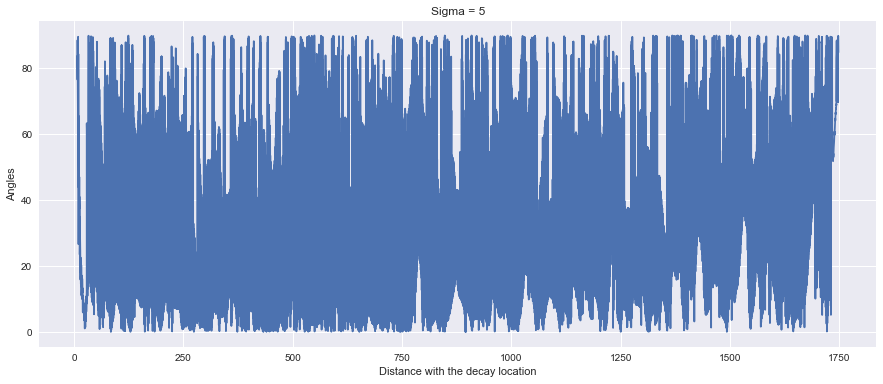

In [48]:
plt.style.use('seaborn')
plt.figure(figsize=(15,6))
# plt.subplot(1,3,1)
# plt.plot(dist_sorted, angles_sorted)
# plt.title("Sigma = 2")
# plt.xlabel("Distance with the decay location")
# plt.ylabel("Angles")
# plt.subplot(1,3,2)
plt.plot(dist_sorted_4, angles_sorted_4)
plt.title("Sigma = 5")
plt.xlabel("Distance with the decay location")
plt.ylabel("Angles")
# plt.subplot(1,3,3)
# plt.plot(dist_sorted_5, angles_sorted_5)
# plt.title("Sigma = 7")
# plt.xlabel("Distance with the decay location")
# plt.ylabel("Angles")
plt.show()

In [18]:
print(lin_ves, lin_ves.max())

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] 898791381.1056223


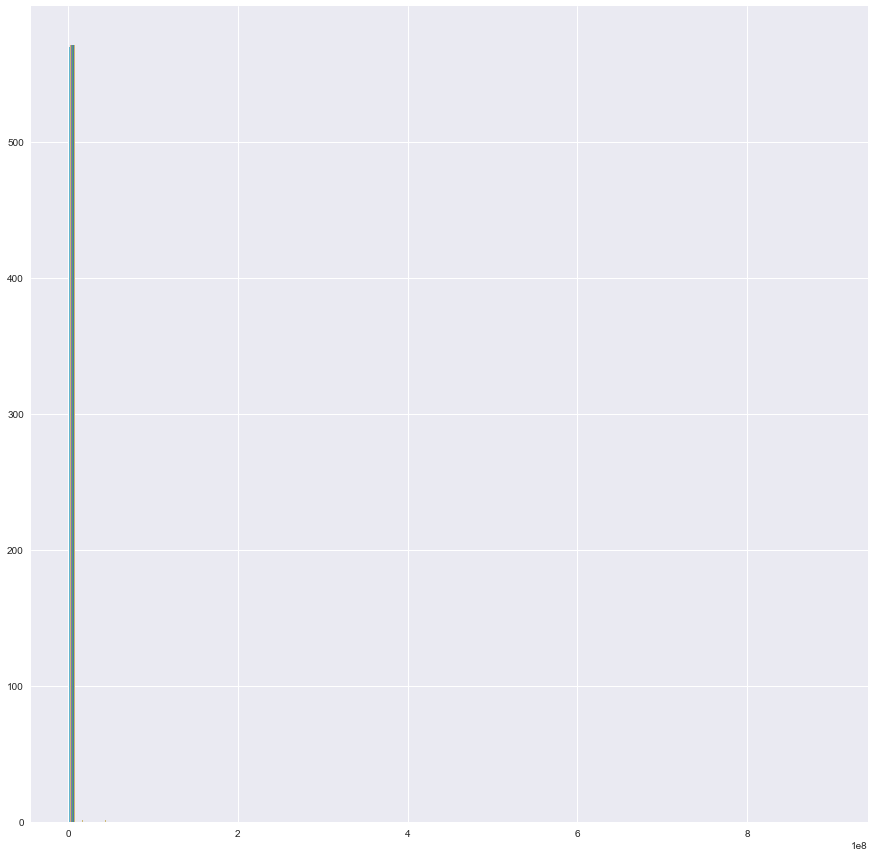

In [19]:
plt.figure(figsize=(15,15))
plt.hist(lin_ves, 100)
plt.show()

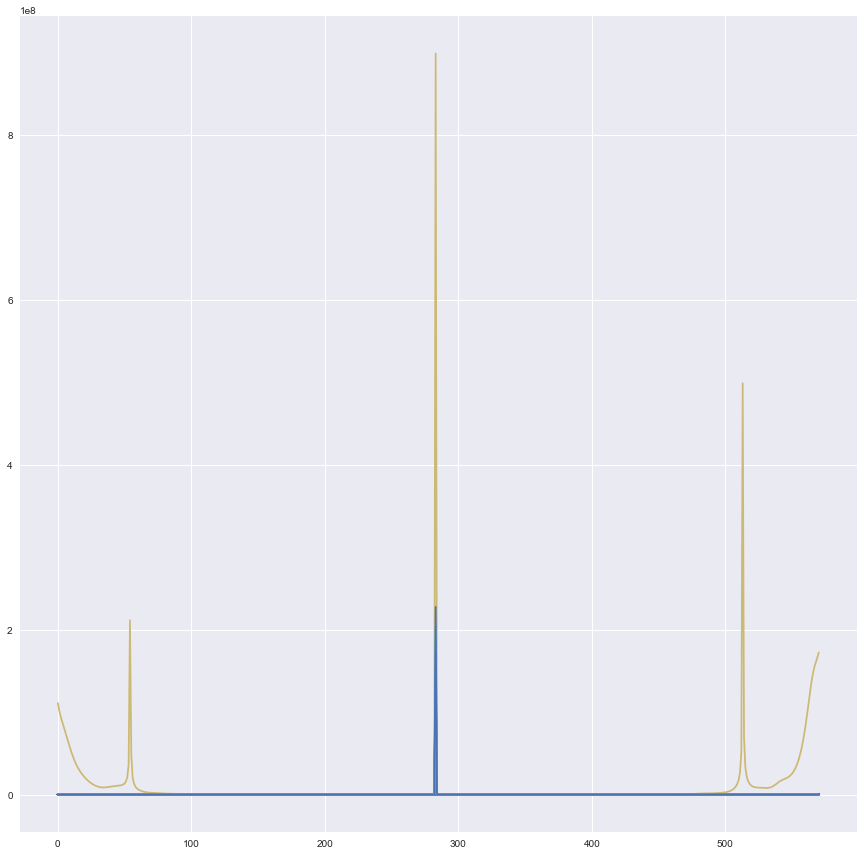

In [20]:
plt.figure(figsize=(15,15))
plt.plot(lin_ves)
plt.show()

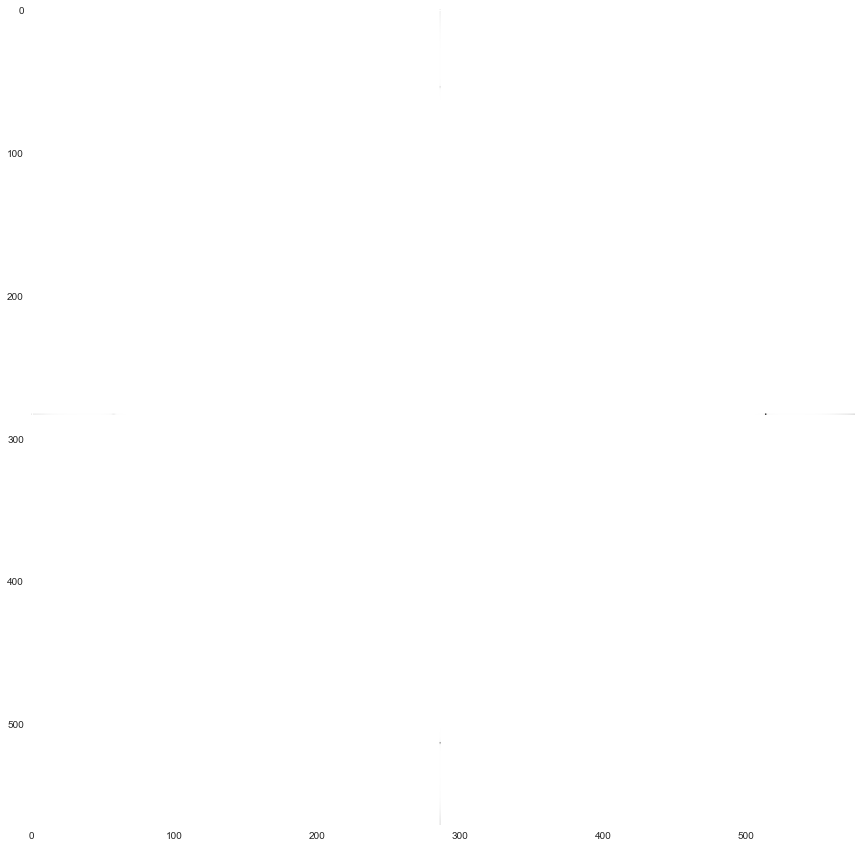

In [21]:
plt.figure(figsize=(15,15))
plt.imshow(lin_ves)
plt.show()

In [22]:
lin_ves_list = []
for y in range(height):
    for x in range(width):
            if lin_ves[y,x] != 0:
                lin_ves_list.append(lin_ves[y,x])
print(len(lin_ves_list), max(lin_ves_list))


7651 898791381.1056223


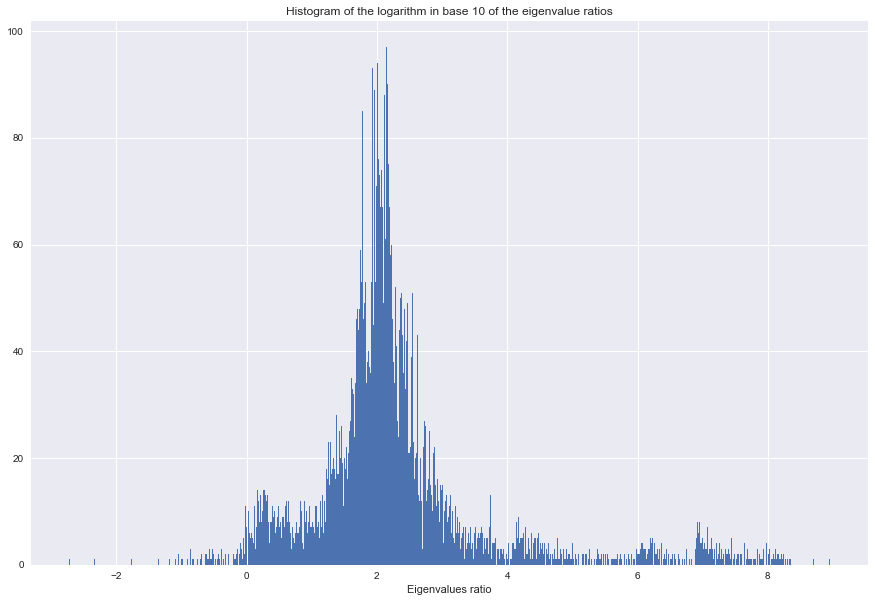

In [29]:
plt.figure(figsize=(15,10))
plt.hist(np.log10(lin_ves_list), 1000)
plt.title('Histogram of the logarithm in base 10 of the eigenvalue ratios')
plt.xlabel("Eigenvalues ratio")
plt.show()

In [27]:
lin_ves_mask = np.zeros((height, width))

for y in range(height):
    for x in range(width):
            lin = lin_ves[y,x]
            if lin != 0:
                if np.log10(lin) > 2:
                    lin_ves_mask[y,x] = 1


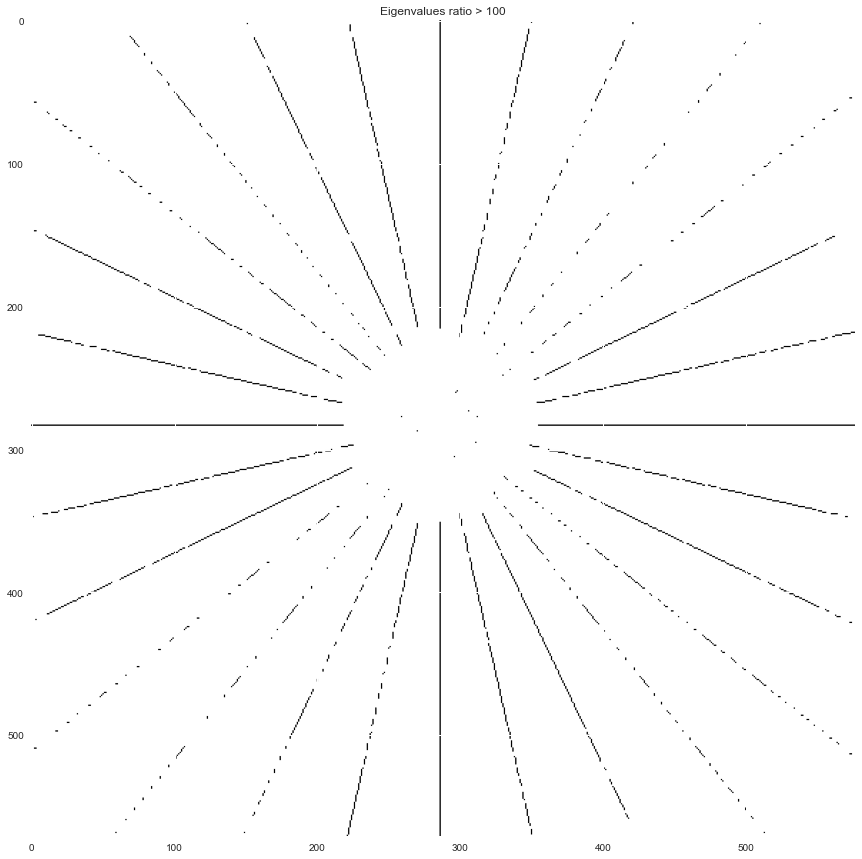

In [30]:
plt.figure(figsize=(15,15))
plt.imshow(lin_ves_mask)
plt.title('Eigenvalues ratio > 100')
plt.show()